In [2]:
import torch
import torch.nn as nn
from torch.nn import functional as fn
from torch.autograd import Variable
import matplotlib
import torch.nn.functional as F 
import numpy as np
import pickle

import matplotlib.pyplot as plt

In [3]:
import torch
import sys
print('__Python VERSION:', sys.version)
print('__pyTorch VERSION:', torch.__version__)
print('__CUDA VERSION')
from subprocess import call
# call(["nvcc", "--version"]) does not work
! nvcc --version
print('__CUDNN VERSION:', torch.backends.cudnn.version())
print('__Number CUDA Devices:', torch.cuda.device_count())
print('__Devices')
call(["nvidia-smi", "--format=csv", "--query-gpu=index,name,driver_version,memory.total,memory.used,memory.free"])
print('Active CUDA Device: GPU', torch.cuda.current_device())

print ('Available devices ', torch.cuda.device_count())
print ('Current cuda device ', torch.cuda.current_device())


__Python VERSION: 3.6.5 |Anaconda, Inc.| (default, Mar 29 2018, 18:21:58) 
[GCC 7.2.0]
__pyTorch VERSION: 0.4.0
__CUDA VERSION
nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2015 NVIDIA Corporation
Built on Tue_Aug_11_14:27:32_CDT_2015
Cuda compilation tools, release 7.5, V7.5.17
__CUDNN VERSION: 7102
__Number CUDA Devices: 1
__Devices
Active CUDA Device: GPU 0
Available devices  1
Current cuda device  0


In [4]:
train_xyz = []

with open('training/8v/data.pickle', 'rb') as f:
    data = pickle.load(f)

for i in range(len(data)):
    obj = np.asarray(data[i])
    #print("obj: ", obj)
    nv = 8
    dim = 36
    #print(obj.shape)
    train_xyz.append((obj))
    #print(train_xyz)
train_xyz = torch.Tensor(train_xyz)
train_xyz.shape  

torch.Size([10000, 3, 36])

In [5]:
train_xy = []

with open('training/8v/data.pickle', 'rb') as f:
    data = pickle.load(f)
    
for i in range(len(data)):
    obj = np.asarray(data[i])
    obj.T.reshape(1,3,36)[0][2]=np.random.rand(36)
    train_xy.append(obj)
    #print(train_xyz)
train_xy = torch.Tensor(train_xy)
train_xy.shape        

torch.Size([10000, 3, 36])

In [6]:
# new version
import torch.nn.functional as F 

from functools import reduce
def num_edges(n):
    return int(n*(n-1)/2)

class DepthEstNet(nn.Module):    
    def __init__(self, vertices, nonlinearity = fn.tanh, additional_hidden_wide=0):
        super(DepthEstNet, self).__init__()
        self.vertices = vertices
        input_dim = vertices * 3
        self.edges = int(num_edges(vertices))
        edge_dim = self.edges * 3
        edges = self.edges
        self.conv_edge_vec = nn.ModuleList()
        self.conv_edge_num = vertices-1
        
        self.fc0 = nn.Linear(vertices, vertices)
        #self.conv_edge_vec.append(fc0)
        
#torch.nn.Conv1d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True)

        for i in range(1,vertices):
            m = nn.Conv1d(3, 3, 2, stride=1, dilation=i)
            m.weight = torch.nn.Parameter(torch.from_numpy(np.array(
            [[[1, -1],
             [0, 0],
             [0, 0]],
    
            [[0, 0],
             [1,-1],
             [0,0]],

            [[0,  0],
             [0, 0],
             [1, -1]]], dtype=np.float32)))
            m.bias = torch.nn.Parameter(torch.from_numpy(np.array([0,0,0], dtype=np.float32)))
            m.requires_grad = False
            self.conv_edge_vec.append(m)
        
#torch.nn.ConvTranspose1d(in_channels, out_channels, kernel_size, stride=1, padding=0, output_padding=0, 
#groups=1, bias=True, dilation=1)
        
        self.deconv_edge_vec = nn.ModuleList()
        self.deconv_edge_num = vertices-1
        for i in range(1,vertices):
            m = nn.Conv1d(3, 3, 2, stride=1, dilation=vertices-i)
            m.requires_grad = True
            self.deconv_edge_vec.append(m)        
        
        
        self.reverse_learn_params = nn.ModuleList()
        fc1 = nn.Linear(edges, edges*10)
        self.reverse_learn_params.append(fc1)
        fc2 = nn.Linear(edges*10, edges*20)
        self.reverse_learn_params.append(fc2)
        fc3 = nn.Linear(edges*20, vertices*20)
        self.reverse_learn_params.append(fc3)        
        fc4 = nn.Linear(vertices*20, vertices*10)
        self.reverse_learn_params.append(fc4)
        fc5 = nn.Linear(vertices*10, vertices)
        self.reverse_learn_params.append(fc5)
        
        self.layernorm = nn.LayerNorm(edges)
        self.nonlinearity = nonlinearity
        self.cos = nn.CosineSimilarity(dim=0, eps=1e-6)


    def forward(self, x, extract_x=False, extract_y=False, extract_z=False):
        #print("initial x", x)
        n,d,t = x.size()
        #print(n,d,v)
        x,conn = torch.Tensor.split(x,[self.vertices,t-self.vertices],dim=2)
        
        #x_mod = F.sigmoid(self.fc0(x))
        #new_x = torch.tensor(x_mod.data)
        
        for i in range(self.conv_edge_num):
            y = self.conv_edge_vec[i](x)
            if (i==0):
                output = y
            else:
                output = torch.cat((output,y), dim=2)
        
        #print("connections:", conn)
        #print("bitwise and:", conn*output)
        
        
        
        #for i in range(self.deconv_edge_num):
        #    y = self.deconv_edge_vec[i](output)
        #    y = self.nonlinearity(y)
            #print("deconv output:",y, "shape:", y.shape)
            
            
        x_vec =  output[:,0,:] 

        temp = (self.reverse_learn_params[0](x_vec))
        temp = (self.reverse_learn_params[1](temp))
        temp = (self.reverse_learn_params[2](temp))
        temp = (self.reverse_learn_params[3](temp))
        vertexs_recovered = (self.reverse_learn_params[4](temp))
        optimizer = torch.optim.SGD(self.reverse_learn_params.parameters(), lr = 1e-1 , momentum=0.8)
        criterion = nn.MSELoss()
        optimizer.zero_grad()
        print(" vertexs_recovered:", vertexs_recovered)
        print(" x[:,0,:]:", x[:,0,:])
        loss = criterion(vertexs_recovered, x[:,0,:])
        print("loss", loss)
        loss.backward(retain_graph=True)
        optimizer.step()
          

        y=output
        output = output*conn
        
        
        
        if (extract_x):
            vec = output[:,0,:] #y[i,0,:]
            print("x output vec:", vec)
            temp = (self.reverse_learn_params[0](vec))
            temp = (self.reverse_learn_params[1](temp))
            temp = (self.reverse_learn_params[2](temp))
            temp = (self.reverse_learn_params[3](temp))
            vertexs_recovered = (self.reverse_learn_params[4](temp))
            return vertexs_recovered        
        
        if (extract_y):
            vec = output[:,1,:] #y[i,0,:]
            print("y output vec:", vec)
            temp = (self.reverse_learn_params[0](vec))
            temp = (self.reverse_learn_params[1](temp))
            temp = (self.reverse_learn_params[2](temp))
            temp = (self.reverse_learn_params[3](temp))
            vertexs_recovered = (self.reverse_learn_params[4](temp))
            return vertexs_recovered          
            
        if (extract_z):
            vec = output[:,2,:] #y[i,0,:]
            print("z output vec:", vec)
            temp = (self.reverse_learn_params[0](vec))
            temp = (self.reverse_learn_params[1](temp))
            temp = (self.reverse_learn_params[2](temp))
            temp = (self.reverse_learn_params[3](temp))
            vertexs_recovered = (self.reverse_learn_params[4](temp))
            return vertexs_recovered  
        
                
        #print("output: ",output)
        n,d,e = output.size()            
        output = F.normalize(output, p=2, dim=1)
        #print("normalized output",output)
        #pool all dimensions for Gram Matrix
        n,d,e = output.size()
        output = [torch.mm(mat.transpose(1,0),mat) for mat in output[:]]
        #print(type(output))
        return torch.stack(output)

In [7]:
#cuboid object

data = [[
         [0.60555981397628784, 1.019606590270996, 0.9311475157737732], 
         [0.7988362312316895, 0.14085637032985687, 1.1584558486938477], 
         [0.83646029531955719, 0.9592991471290588, 1.0384680032730103], 
         [1.040856385231018, 0.20116375386714935, 0.8111595511436462]]]

obj = np.asarray(data,dtype=np.float32)
obj.shape
nv = obj.shape[1]
obj = obj.T.reshape(1,3,nv)
obj = torch.tensor(obj)

print(type(obj))
print(obj.shape)

conn = torch.from_numpy(np.asarray([[[1,1,1,0,0,1],[1,1,1,0,0,1],[1,1,1,0,0,1]]],dtype=np.float32))

print(type(conn))
print(conn.shape)

input =  torch.cat((obj,conn), dim=2)

print(input)

<class 'torch.Tensor'>
torch.Size([1, 3, 4])
<class 'torch.Tensor'>
torch.Size([1, 3, 6])
tensor([[[ 0.6056,  0.7988,  0.8365,  1.0409,  1.0000,  1.0000,  1.0000,
           0.0000,  0.0000,  1.0000],
         [ 1.0196,  0.1409,  0.9593,  0.2012,  1.0000,  1.0000,  1.0000,
           0.0000,  0.0000,  1.0000],
         [ 0.9311,  1.1585,  1.0385,  0.8112,  1.0000,  1.0000,  1.0000,
           0.0000,  0.0000,  1.0000]]])


In [8]:
model = DepthEstNet(nv, nonlinearity=fn.sigmoid, additional_hidden_wide=1)
criterion = nn.L1Loss()

#print(model)
#print(list(model.parameters())[:])
model.forward(torch.Tensor(input))

 vertexs_recovered: tensor([[ 0.0060, -0.0912,  0.2117,  0.0744]])
 x[:,0,:]: tensor([[ 0.6056,  0.7988,  0.8365,  1.0409]])
loss tensor(0.6190)


tensor([[[ 1.0000, -0.9620,  0.8622,  0.0000,  0.0000,  0.8946],
         [-0.9620,  1.0000, -0.8650,  0.0000,  0.0000, -0.8257],
         [ 0.8622, -0.8650,  1.0000,  0.0000,  0.0000,  0.9642],
         [ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000],
         [ 0.8946, -0.8257,  0.9642,  0.0000,  0.0000,  1.0000]]])

In [9]:
model = DepthEstNet(8, nonlinearity=fn.relu, additional_hidden_wide=1)
criterion = nn.L1Loss()
print(model)

DepthEstNet(
  (conv_edge_vec): ModuleList(
    (0): Conv1d(3, 3, kernel_size=(2,), stride=(1,))
    (1): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(2,))
    (2): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(3,))
    (3): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(4,))
    (4): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(5,))
    (5): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(6,))
    (6): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(7,))
  )
  (fc0): Linear(in_features=8, out_features=8, bias=True)
  (deconv_edge_vec): ModuleList(
    (0): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(7,))
    (1): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(6,))
    (2): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(5,))
    (3): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(4,))
    (4): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilation=(3,))
    (5): Conv1d(3, 3, kernel_size=(2,), stride=(1,), dilatio

In [10]:
train_xyz[1000,:,:]

tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265,  1.0000,  1.0000,  1.0000,  0.0000,  1.0000,  1.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  1.0000,  1.0000,  1.0000,
          1.0000,  1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000],
        [ 0.1290, -0.0706, -0.1290,  0.1504, -0.8558, -1.0554, -1.1139,
         -0.8344,  1.0000,  1.0000,  1.0000,  0.0000,  1.0000,  1.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  1.0000,  1.0000,  1.0000,
          1.0000,  1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000],
        [ 0.6691,  0.9135, -0.6691, -0.5000,  0.6691,  0.9135, -0.6691,
         -0.5000,  1.0000,  1.0000,  1.0000,  0.0000,  1.0000,  1.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          1.0000,  0.0000,

In [11]:
import torch.utils.data
dataset = torch.utils.data.TensorDataset(train_xy[:,:,:], train_xyz[:,:,:])
loader = torch.utils.data.DataLoader(dataset, batch_size=5, shuffle=True)

In [12]:
#print(list(model.parameters())[:])

Trial #1

cuda:0
 vertexs_recovered: tensor([[-0.0751, -0.0262, -0.1323,  0.2143,  0.0977,  0.1497, -0.0342,
         -0.0514],
        [-0.0731, -0.0205, -0.1448,  0.2177,  0.0926,  0.1451, -0.0311,
         -0.0484],
        [-0.0508, -0.0338, -0.1150,  0.2009,  0.0987,  0.1660, -0.0324,
         -0.0630],
        [-0.0543, -0.0170, -0.1524,  0.2177,  0.0852,  0.1493, -0.0297,
         -0.0543],
        [-0.0279, -0.0387, -0.1045,  0.1829,  0.0980,  0.1781, -0.0206,
         -0.0669]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(0.51

/home/mishra/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:28: UserWarning: invalid index of a 0-dim tensor. This will be an error in PyTorch 0.5. Use tensor.item() to convert a 0-dim tensor to a Python number


loss tensor(1.00000e-02 *
       1.5911, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5663, -0.8408, -0.4777,  0.8972,  0.7396, -0.6791, -0.3107,
          1.1063],
        [ 0.8655, -0.5022, -0.7406,  0.8066,  0.9535, -0.3628, -0.6374,
          0.9083],
        [ 0.7239, -0.7980, -0.5156,  0.8694,  0.8973, -0.6383, -0.3921,
          1.0996],
        [ 0.8958, -0.5776, -0.7540,  0.8647,  0.9929, -0.4427, -0.6456,
          0.9991],
        [ 0.5667, -0.8343, -0.4711,  0.8877,  0.7410, -0.6715, -0.3071,
          1.0965]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
  

 vertexs_recovered: tensor([[ 0.6858, -0.7532, -0.5059,  0.8053,  0.8788, -0.5757, -0.3621,
          1.0088],
        [ 0.8298, -0.6705, -0.7598,  0.8804,  1.0090, -0.5025, -0.6049,
          1.0701],
        [ 0.1364, -1.0501,  0.0277,  0.7763,  0.3411, -0.8627,  0.2017,
          0.9832],
        [ 0.6858, -0.7532, -0.5059,  0.8053,  0.8788, -0.5757, -0.3621,
          1.0088],
        [ 0.6716, -0.7811, -0.6220,  0.8995,  0.8540, -0.6129, -0.4532,
          1.0957]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.2247, -0.8958, -0.2163,  0.8187,  0.3943, -0.7188, -0.0455,
          0.9811],
        [-0.0055, -0.9431, -0.0494,  0.7941,  0.1586, -0.7630,  0.1255,
          0.9348],
        [ 0.6809, -0.4252, -0.7861,  0.7100,  0.8382, -0.2369, -0.6244,
          0.8042],
        [ 0.2432, -0.7741, -0.6827,  0.9435,  0.3914, -0.6082, -0.4714,
          1.0654],
        [ 0.8917, -0.6352, -0.8581,  0.8748,  1.0667, -0.4651, -0.6907,
          1.0622]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.9696, -0.6378, -0.6831,  0.8790,  1.1433, -0.4671, -0.5220,
          1.0859],
        [ 0.5655, -0.9688,  0.0567,  0.8034,  0.7486, -0.7896,  0.2055,
          1.0121],
        [ 0.6148, -0.8653, -0.3677,  0.9130,  0.7885, -0.6979, -0.1995,
          1.1259],
        [ 1.0004, -0.6990, -0.6974,  0.9298,  1.1769, -0.5336, -0.5320,
          1.1581],
        [ 0.3848, -0.9282, -0.0813,  0.8369,  0.5574, -0.7526,  0.0800,
          1.0245]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.8737, -0.5056, -0.8560,  0.8289,  1.0420, -0.3321, -0.6908,
          1.0019],
        [ 0.4820, -0.8581, -0.5079,  0.9015,  0.6524, -0.6925, -0.3338,
          1.0984],
        [ 0.7685, -0.7692, -0.5846,  0.8851,  0.9429, -0.6013, -0.4153,
          1.0890],
        [ 0.6709, -0.5934, -0.6959,  0.8151,  0.8371, -0.4185, -0.5309,
          0.9784],
        [ 0.2014, -0.8987, -0.2374,  0.8126,  0.3661, -0.7235, -0.0706,
          0.9705]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.3364, -0.9792, -0.1382,  0.8072,  0.5097, -0.8030,  0.0279,
          0.9765],
        [ 0.3947, -0.9559, -0.2220,  0.8263,  0.5693, -0.7818, -0.0539,
          1.0032],
        [ 0.8836, -0.8586, -0.5209,  0.8964,  1.0676, -0.6916, -0.3468,
          1.1125],
        [ 0.2308, -1.0696,  0.0671,  0.7813,  0.4028, -0.8904,  0.2304,
          0.9417],
        [ 0.8535, -0.7580, -0.4316,  0.8041,  1.0321, -0.5809, -0.2668,
          0.9835]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.5264, -0.6246, -0.4219,  0.7144,  0.6982, -0.4366, -0.2577,
          0.8359],
        [-0.0073, -0.9509, -0.3296,  0.8739,  0.1695, -0.7796, -0.1495,
          1.0481],
        [ 0.7973, -0.6355, -0.9086,  0.8866,  0.9823, -0.4668, -0.7248,
          1.0765],
        [ 0.3855, -0.9479, -0.1006,  0.7973,  0.5640, -0.7676,  0.0725,
          0.9535],
        [ 0.6050, -0.6259, -0.8618,  0.8640,  0.7858, -0.4549, -0.6812,
          1.0409]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5191, -0.6363, -0.4337,  0.7094,  0.6889, -0.4477, -0.2700,
          0.8258],
        [ 0.1910, -0.8229, -0.7238,  0.8830,  0.3722, -0.6541, -0.5405,
          1.0639],
        [ 0.5818, -0.4263, -0.8439,  0.7080,  0.7516, -0.2387, -0.6797,
          0.8219],
        [ 0.4497, -0.8614, -0.5184,  0.8565,  0.6306, -0.6887, -0.3381,
          1.0309],
        [-0.0102, -0.9548, -0.4824,  0.8828,  0.1700, -0.7855, -0.2998,
          1.0628]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4910, -0.9939, -0.0067,  0.8394,  0.6657, -0.8205,  0.1644,
          1.0156],
        [ 0.9348, -0.7471, -0.7589,  0.9109,  1.1168, -0.5835, -0.5790,
          1.1185],
        [ 0.2259, -0.9605, -0.1854,  0.8579,  0.4009, -0.7897, -0.0128,
          1.0392],
        [ 0.3258, -0.9438, -0.2538,  0.8699,  0.5021, -0.7745, -0.0797,
          1.0568],
        [ 0.8151, -0.9065, -0.0480,  0.8106,  0.9891, -0.7299,  0.1207,
          0.9773]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6985, -0.8166, -0.6410,  0.9388,  0.8750, -0.6485, -0.4584,
          1.1424],
        [ 0.7306, -0.7788, -0.1800,  0.7939,  0.8977, -0.5952, -0.0124,
          0.9398],
        [ 0.2246, -0.9555, -0.1815,  0.8740,  0.3971, -0.7807, -0.0053,
          1.0503],
        [ 0.2871, -0.8618, -0.2954,  0.8525,  0.4579, -0.6849, -0.1218,
          1.0203],
        [ 0.7362, -0.7766, -0.5958,  0.9049,  0.9103, -0.6049, -0.4169,
          1.0950]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.6373, -0.3833, -0.7911,  0.7322,  0.8032, -0.1969, -0.6288,
          0.8546],
        [ 0.7648, -0.5857, -0.5824,  0.7985,  0.9362, -0.4064, -0.4124,
          0.9484],
        [ 0.8718, -0.8012, -0.4535,  0.8911,  1.0509, -0.6319, -0.2727,
          1.0794],
        [ 0.7867, -0.4240, -0.8701,  0.7869,  0.9569, -0.2435, -0.7014,
          0.9314],
        [ 0.5446, -0.7506, -0.4285,  0.8311,  0.7188, -0.5752, -0.2550,
          0.9952]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-02

 vertexs_recovered: tensor([[ 0.6346, -0.6390, -0.7007,  0.9070,  0.8119, -0.4681, -0.5193,
          1.0962],
        [ 0.0529, -0.9091, -0.4249,  0.9063,  0.2294, -0.7382, -0.2445,
          1.0963],
        [ 0.5521, -0.9836,  0.0414,  0.8327,  0.7251, -0.8060,  0.2151,
          0.9955],
        [ 0.5521, -0.9836,  0.0414,  0.8327,  0.7251, -0.8060,  0.2151,
          0.9955],
        [ 0.7529, -0.6875, -0.5416,  0.8894,  0.9295, -0.5150, -0.3617,
          1.0723]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2990, -0.8632, -0.2917,  0.8375,  0.4694, -0.6877, -0.1226,
          1.0073],
        [ 0.2990, -0.8632, -0.2917,  0.8375,  0.4694, -0.6877, -0.1226,
          1.0073],
        [ 0.9586, -0.7260, -0.7348,  0.9234,  1.1377, -0.5619, -0.5546,
          1.1314],
        [ 0.6905, -0.9115, -0.2781,  0.8802,  0.8652, -0.7415, -0.1037,
          1.0691],
        [ 0.7440, -0.7707, -0.5905,  0.8955,  0.9203, -0.6029, -0.4140,
          1.0910]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.1749, -0.8953, -0.2421,  0.8286,  0.3457, -0.7174, -0.0712,
          0.9898],
        [ 0.1881, -0.6778, -0.7304,  0.8764,  0.3611, -0.5036, -0.5551,
          1.0552],
        [ 0.7362, -0.1647, -0.9958,  0.7510,  0.8982,  0.0245, -0.8353,
          0.8767],
        [ 0.8608, -0.4846, -0.8440,  0.8618,  1.0330, -0.3086, -0.6697,
          1.0343],
        [ 0.1047, -1.0342,  0.0154,  0.8108,  0.2749, -0.8552,  0.1849,
          0.9659]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.2124, -0.9911, -0.1240,  0.8317, -0.0403, -0.8151,  0.0468,
          0.9962],
        [ 0.5898, -0.6913, -0.7530,  0.8678,  0.7684, -0.5222, -0.5750,
          1.0495],
        [ 0.7759, -0.9716, -0.1139,  0.8464,  0.9527, -0.8000,  0.0617,
          1.0194],
        [ 0.7626, -0.7858, -0.6807,  0.8988,  0.9444, -0.6208, -0.4984,
          1.0940],
        [ 0.7116, -0.7373, -0.5908,  0.8525,  0.8891, -0.5666, -0.4143,
          1.0281]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.4647, -0.9860, -0.0134,  0.8574,  0.6431, -0.8161,  0.1645,
          1.0330],
        [ 0.8904, -0.5670, -0.6865,  0.8487,  1.0662, -0.3945, -0.5108,
          1.0200],
        [ 0.7317, -0.7042, -0.5620,  0.8749,  0.9103, -0.5352, -0.3828,
          1.0573],
        [ 0.7837, -0.5644, -0.5618,  0.8107,  0.9561, -0.3875, -0.3908,
          0.9661],
        [ 0.5036, -0.8070, -0.4607,  0.8871,  0.6836, -0.6398, -0.2798,
          1.0746]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
    

loss tensor(1.00000e-03 *
       8.0944, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4726, -1.0514, -0.0306,  0.7928,  0.6527, -0.8829,  0.1438,
          0.9508],
        [ 0.3533, -0.6583, -0.9185,  0.8735,  0.5352, -0.4940, -0.7380,
          1.0599],
        [-0.2899, -1.0543, -0.1914,  0.7960, -0.1115, -0.8849, -0.0178,
          0.9548],
        [ 0.1299, -1.0292, -0.2627,  0.8275,  0.3118, -0.8638, -0.0850,
          0.9993],
        [-0.1102, -1.0857, -0.1033,  0.7940,  0.0689, -0.9167,  0.0705,
          0.9525]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e

 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03 *
       1.6566, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5180, -0.8178, -0.4623,  0.8755,  0.6944, -0.6475, -0.2855,
          1.0597],
        [ 0.0327, -0.9358, -0.4514,  0.8850,  0.2102, -0.7671, -0.2728,
          1.0733],
        [ 0.8073, -0.9464, -0.0867,  0.8600,  0.9829, -0.7745,  0.0885,
          1.0378],
        [ 0.4274, -0.8709, -0.5343,  0.9080,  0.6067, -0.7047, -0.3534,
          1.1061],
        [ 0.7419, -0.7638, -0.1687,  0.7993,  0.9115, -0.5842, -0.0013,
  

 x[:,0,:]: tensor([[ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03 *
       3.4309, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4886, -0.5174, -0.8647,  0.8330,  0.6566, -0.3370, -0.6963,
          0.9956],
        [ 0.3799, -0.6830, -0.5998,  0.8477,  0.5484, -0.5033, -0.4300,
          1.0153],
        [ 0.7814, -0.9294, -0.1505,  0.8825,  0.9530, -0.7534,  0.0239,
          1.0642],
        [ 0.7631, -0.7538, -0.1490,  0.8037,  0.9282, -0.5691,  0.0159,
          0.9527],
        [ 0.8348, -0.9314, -0.0607,  0.8674,  1.0052, -0.7537,  0.1119,
  

 vertexs_recovered: tensor([[ 0.8343, -0.5110, -0.8707,  0.8425,  1.0080, -0.3363, -0.6972,
          1.0117],
        [ 0.2501, -0.7883, -0.6739,  0.8950,  0.4277, -0.6193, -0.4947,
          1.0862],
        [ 0.2560, -0.6030, -0.7106,  0.8229,  0.4269, -0.4252, -0.5406,
          0.9834],
        [ 0.5739, -0.7350, -0.4061,  0.8385,  0.7462, -0.5586, -0.2342,
          1.0052],
        [ 0.4164, -0.9163, -0.1847,  0.8668,  0.5908, -0.7430, -0.0096,
          1.0453]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

loss tensor(1.00000e-03 *
       1.7594, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3631, -0.8819, -0.5794,  0.9167,  0.5414, -0.7141, -0.3983,
          1.1158],
        [ 0.2919, -0.8561, -0.2896,  0.8511,  0.4639, -0.6800, -0.1169,
          1.0219],
        [ 0.5860, -0.9574,  0.0714,  0.8464,  0.7577, -0.7804,  0.2434,
          1.0149],
        [ 0.1882, -0.9082, -0.3495,  0.8770,  0.3627, -0.7354, -0.1736,
          1.0591],
        [ 0.6786, -0.9080, -0.2801,  0.8932,  0.8547, -0.7369, -0.1019,
          1.0817]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
  

 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03 *
       1.9979, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8214, -0.9434, -0.0770,  0.8552,  0.9935, -0.7680,  0.0949,
          1.0302],
        [ 0.9419, -0.7422, -0.7503,  0.9151,  1.1192, -0.5744, -0.5712,
          1.1160],
        [ 0.0377, -0.9476, -0.4543,  0.8688,  0.2109, -0.7743, -0.2804,
          1.0503],
        [ 0.3657, -0.6984, -0.6186,  0.8334,  0.5352, -0.5202, -0.4497,
          0.9992],
        [-0.2177, -0.9898, -0.1407,  0.8080, -0.0501, -0.8087,  0.0256,
  

 vertexs_recovered: tensor([[ 0.3137, -0.5580, -0.6618,  0.8409,  0.4801, -0.3764, -0.4944,
          1.0070],
        [ 0.6793, -0.5109, -0.2907,  0.7728,  0.8398, -0.3211, -0.1321,
          0.9101],
        [ 0.7983, -0.7208, -0.1199,  0.8156,  0.9635, -0.5373,  0.0444,
          0.9724],
        [ 0.9225, -0.5469, -0.8043,  0.9248,  1.0964, -0.3755, -0.6269,
          1.1270],
        [ 0.2210, -0.6571, -0.7059,  0.8762,  0.3909, -0.4802, -0.5338,
          1.0579]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.9028, -0.5698, -0.6852,  0.8439,  1.0770, -0.3972, -0.5115,
          1.0152],
        [ 0.9028, -0.5698, -0.6852,  0.8439,  1.0770, -0.3972, -0.5115,
          1.0152],
        [ 0.2074, -0.8687, -0.6985,  0.9030,  0.3871, -0.7035, -0.5172,
          1.0996],
        [ 0.9161, -0.6644, -0.7265,  0.8830,  1.0946, -0.4975, -0.5473,
          1.0718],
        [ 0.6546, -0.8451, -0.6796,  0.9184,  0.8367, -0.6829, -0.4957,
          1.1225]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.2078, -0.9121, -0.3301,  0.8795,  0.3799, -0.7369, -0.1563,
          1.0626],
        [ 0.3392, -0.9325, -0.2367,  0.8771,  0.5112, -0.7571, -0.0634,
          1.0595],
        [ 0.5398, -0.8052, -0.4408,  0.8761,  0.7121, -0.6304, -0.2672,
          1.0585],
        [ 0.1907, -0.6821, -0.7286,  0.8652,  0.3619, -0.5056, -0.5561,
          1.0422],
        [ 0.5398, -0.8052, -0.4408,  0.8761,  0.7121, -0.6304, -0.2672,
          1.0585]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.8688, -0.8571, -0.5217,  0.9173,  1.0486, -0.6918, -0.3396,
          1.1185],
        [ 0.4766, -0.8846, -0.0230,  0.8323,  0.6461, -0.7049,  0.1460,
          0.9946],
        [ 0.3340, -0.7939, -0.6152,  0.8911,  0.5098, -0.6231, -0.4377,
          1.0795],
        [ 0.3776, -0.9478, -0.0812,  0.8586,  0.5496, -0.7716,  0.0913,
          1.0322],
        [ 0.2827, -1.0025,  0.1337,  0.8388,  0.4523, -0.8229,  0.3030,
          1.0034]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8869, -0.5871, -0.7007,  0.8375,  1.0598, -0.4117, -0.5279,
          1.0029],
        [ 0.5173, -0.9310, -0.4511,  0.8943,  0.6964, -0.7636, -0.2701,
          1.0844],
        [-0.0496, -0.9205, -0.0598,  0.8158,  0.1195, -0.7399,  0.1090,
          0.9697],
        [ 0.6303, -0.5459, -0.3307,  0.7644,  0.7943, -0.3585, -0.1691,
          0.8965],
        [ 0.5838, -0.6972, -0.3941,  0.8175,  0.7540, -0.5180, -0.2246,
          0.9733]], device='cuda:0')
 x[:,0,:]: tensor([[ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3390, -0.9555, -0.1215,  0.8345,  0.5141, -0.7846,  0.0514,
          1.0044],
        [ 0.2698, -0.8736, -0.3124,  0.8382,  0.4448, -0.7029, -0.1392,
          1.0092],
        [ 0.7201, -0.4085, -0.9905,  0.8482,  0.8943, -0.2362, -0.8171,
          1.0204],
        [ 0.5600, -0.9802,  0.0437,  0.8290,  0.7348, -0.8087,  0.2158,
          0.9964],
        [ 0.4750, -0.5106, -0.8714,  0.8415,  0.6487, -0.3378, -0.6988,
          1.0115]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.6350, -0.6243, -0.8476,  0.8567,  0.8108, -0.4538, -0.6727,
          1.0344],
        [ 0.3904, -0.7445, -0.5903,  0.8435,  0.5643, -0.5713, -0.4175,
          1.0149],
        [-0.0487, -0.9283, -0.0640,  0.8029,  0.1199, -0.7479,  0.1024,
          0.9550],
        [ 0.6442, -0.5353, -0.3183,  0.7649,  0.8083, -0.3486, -0.1580,
          0.8997],
        [ 0.7649, -0.7956, -0.6855,  0.8879,  0.9445, -0.6303, -0.5058,
          1.0800]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1819, -0.9130, -0.3560,  0.8719,  0.3571, -0.7421, -0.1807,
          1.0543],
        [-0.0044, -0.9983, -0.0090,  0.8395,  0.1668, -0.8219,  0.1610,
          1.0074],
        [ 0.1484, -0.9849,  0.0642,  0.8348,  0.3190, -0.8077,  0.2332,
          1.0005],
        [ 0.7657, -0.9282, -0.1599,  0.8828,  0.9422, -0.7587,  0.0167,
          1.0700],
        [ 0.3666, -0.6810, -0.6081,  0.8523,  0.5396, -0.5066, -0.4354,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.2358, -1.0116, -0.1480,  0.8230, -0.0620, -0.8386,  0.0242,
          0.9850],
        [ 0.4938, -0.8208, -0.8368,  0.8799,  0.6754, -0.6581, -0.6551,
          1.0686],
        [-0.2010, -0.9543, -0.6155,  0.8605, -0.0225, -0.7881, -0.4370,
          1.0400],
        [ 0.2380, -1.0367,  0.0901,  0.8229,  0.4123, -0.8640,  0.2622,
          0.9850],
        [ 0.5458, -0.9899,  0.0316,  0.8304,  0.7213, -0.8186,  0.2051,
          0.9959]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.2417, -0.6098, -0.7225,  0.8232,  0.4151, -0.4358, -0.5508,
          0.9845],
        [ 0.5731, -0.7087, -0.7723,  0.8610,  0.7530, -0.5435, -0.5934,
          1.0409],
        [ 0.8737, -0.7009, -0.7673,  0.8668,  1.0550, -0.5378, -0.5868,
          1.0499],
        [-0.2331, -0.9757, -0.1411,  0.8292, -0.0586, -0.8035,  0.0320,
          0.9935],
        [ 0.7458, -0.1507, -0.9842,  0.7597,  0.9102,  0.0360, -0.8234,
          0.8907]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3677, -0.9697, -0.2385,  0.8363,  0.5431, -0.7981, -0.0643,
          1.0045],
        [ 0.4770, -0.8615, -0.5039,  0.8521,  0.6535, -0.6913, -0.3277,
          1.0269],
        [-0.4389, -1.0276, -0.2484,  0.8247, -0.2668, -0.8520, -0.0768,
          0.9864],
        [ 0.1460, -0.7220, -0.7735,  0.8489,  0.3200, -0.5484, -0.5992,
          1.0204],
        [ 0.1733, -1.0090, -0.2360,  0.8379,  0.3487, -0.8374, -0.0616,
          1.0068]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.0200, -0.8349, -0.4723,  0.8640,  0.1930, -0.6603, -0.2980,
          1.0413],
        [ 0.7410, -0.8452, -0.1962,  0.8587,  0.9148, -0.6711, -0.0220,
          1.0343],
        [ 0.0523, -0.7857, -0.7914,  0.8939,  0.2284, -0.6156, -0.6129,
          1.0851],
        [ 0.0200, -0.8349, -0.4723,  0.8640,  0.1930, -0.6603, -0.2980,
          1.0413],
        [ 0.2178, -0.8633, -0.6896,  0.9045,  0.3959, -0.6958, -0.5090,
          1.1012]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.2193, -1.0033, -0.1348,  0.8256, -0.0478, -0.8271,  0.0364,
          0.9875],
        [-0.4279, -1.0152, -0.2373,  0.8320, -0.2559, -0.8400, -0.0650,
          0.9968],
        [ 0.3383, -0.9619, -0.1249,  0.8352,  0.5116, -0.7878,  0.0478,
          1.0020],
        [ 0.6209, -0.8877, -0.7197,  0.8938,  0.8022, -0.7249, -0.5370,
          1.0887],
        [-0.2193, -1.0033, -0.1348,  0.8256, -0.0478, -0.8271,  0.0364,
          0.9875]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.4033, -0.9394, -0.2056,  0.8460,  0.5763, -0.7656, -0.0335,
          1.0186],
        [ 0.7433, -0.9631, -0.1915,  0.8574,  0.9184, -0.7923, -0.0171,
          1.0362],
        [ 0.8083, -0.9529, -0.0893,  0.8496,  0.9822, -0.7802,  0.0835,
          1.0243],
        [ 0.5089, -0.8215, -0.8312,  0.8686,  0.6874, -0.6559, -0.6534,
          1.0545],
        [ 0.7694, -0.7396, -0.1418,  0.8098,  0.9378, -0.5589,  0.0243,
          0.9646]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.6392, -0.8848, -0.3247,  0.8365,  0.8153, -0.7152, -0.1505,
          1.0060],
        [ 0.6900, -0.4579, -1.0337,  0.8165,  0.8617, -0.2817, -0.8642,
          0.9754],
        [-0.0285, -0.8859, -0.5260,  0.8353,  0.1467, -0.7153, -0.3522,
          1.0040],
        [-0.2342, -0.9878, -0.1495,  0.8194, -0.0612, -0.8142,  0.0217,
          0.9802],
        [ 0.4705, -0.8719, -0.5157,  0.8445,  0.6475, -0.7037, -0.3402,
          1.0180]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8075, -0.9511, -0.0891,  0.8537,  0.9820, -0.7786,  0.0850,
          1.0293],
        [ 0.5232, -0.9391, -0.4541,  0.8781,  0.7002, -0.7707, -0.2762,
          1.0655],
        [ 0.6829, -0.4922, -0.2761,  0.7921,  0.8468, -0.3042, -0.1141,
          0.9352],
        [ 0.7199, -0.4328, -0.7541,  0.8289,  0.8885, -0.2519, -0.5859,
          0.9902],
        [ 0.8616, -0.4889, -0.8470,  0.8512,  1.0337, -0.3132, -0.6746,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[-0.1973, -0.9594, -0.6178,  0.8544, -0.0199, -0.7925, -0.4405,
          1.0322],
        [-0.0104, -0.8500, -0.8603,  0.8575,  0.1686, -0.6855, -0.6819,
          1.0378],
        [-0.0490, -0.9178, -0.0597,  0.8129,  0.1213, -0.7396,  0.1088,
          0.9686],
        [-0.0247, -0.8798, -0.5210,  0.8388,  0.1506, -0.7095, -0.3467,
          1.0087],
        [ 0.4498, -0.9076, -0.0529,  0.8198,  0.6230, -0.7340,  0.1178,
          0.9808]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1394, -0.9949,  0.0525,  0.8320,  0.3110, -0.8185,  0.2231,
          0.9968],
        [ 0.8291, -0.5179, -0.8811,  0.8370,  1.0040, -0.3472, -0.7074,
          1.0063],
        [-0.2025, -0.9604, -0.1177,  0.8322, -0.0322, -0.7823,  0.0524,
          0.9960],
        [ 0.6020, -0.6804, -0.3788,  0.8231,  0.7736, -0.5043, -0.2087,
          0.9843],
        [ 0.3509, -0.9485, -0.1123,  0.8401,  0.5246, -0.7754,  0.0604,
          1.0100]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.3407, -0.7969, -0.6137,  0.8846,  0.5141, -0.6221, -0.4380,
          1.0706],
        [ 0.8687, -0.8695, -0.5284,  0.9043,  1.0458, -0.6998, -0.3485,
          1.1010],
        [ 0.6817, -0.9122, -0.2808,  0.8855,  0.8562, -0.7384, -0.1045,
          1.0726],
        [ 0.0558, -0.7890, -0.7905,  0.8888,  0.2295, -0.6148, -0.6142,
          1.0767],
        [ 0.6765, -0.5869, -0.8057,  0.8785,  0.8491, -0.4106, -0.6311,
          1.0612]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 6.3302e-01, -9.6985e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7964, -0.9605, -0.0999,  0.8520,  0.9712, -0.7886,  0.0749,
          1.0260],
        [-0.0321, -0.8993, -0.0398,  0.8256,  0.1368, -0.7182,  0.1288,
          0.9839],
        [ 0.5945, -0.7026, -0.7590,  0.8589,  0.7696, -0.5314, -0.5833,
          1.0361],
        [ 0.8584, -0.8389, -0.4839,  0.8629,  1.0347, -0.6696, -0.3068,
          1.0428],
        [ 0.4934, -0.8481, -0.4906,  0.8578,  0.6684, -0.6768, -0.3149,
          1.0344]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5490, -0.7489, -0.8088,  0.8366,  0.7273, -0.5830, -0.6320,
          1.0074],
        [ 0.2538, -0.8834, -0.7081,  0.8418,  0.4324, -0.7180, -0.5306,
          1.0149],
        [ 0.2460, -0.9053, -0.3427,  0.8265,  0.4207, -0.7337, -0.1696,
          0.9901],
        [ 0.4431, -0.9177, -0.0614,  0.8166,  0.6157, -0.7426,  0.1090,
          0.9748],
        [ 0.3169, -0.7360, -0.6659,  0.8255,  0.4922, -0.5652, -0.4923,
          0.9891]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5743, -0.7386, -0.4107,  0.8353,  0.7464, -0.5630, -0.2396,
          1.0010],
        [ 0.8521, -0.8474, -0.4920,  0.8557,  1.0285, -0.6789, -0.3159,
          1.0337],
        [ 0.1281, -1.0066,  0.0410,  0.8271,  0.2993, -0.8293,  0.2109,
          0.9885],
        [ 0.1504, -0.9551, -0.3962,  0.8475,  0.3247, -0.7831, -0.2222,
          1.0201],
        [ 0.6320, -0.6331, -0.8558,  0.8513,  0.8066, -0.4615, -0.6817,
          1.0259]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.4924, -0.5083, -0.4989,  0.8423,  0.6611, -0.3268, -0.3297,
          1.0073],
        [ 0.3986, -0.6359, -0.8923,  0.8781,  0.5736, -0.4645, -0.7156,
          1.0631],
        [ 0.5351, -0.7893, -0.7992,  0.8903,  0.7128, -0.6223, -0.6194,
          1.0829],
        [ 0.6374, -0.8749, -0.7035,  0.8948,  0.8162, -0.7096, -0.5225,
          1.0904],
        [ 0.6613, -0.9295, -0.3016,  0.8755,  0.8370, -0.7593, -0.1245,
          1.0607]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.5712, -0.9636, -0.4076,  0.8437,  0.7483, -0.7959, -0.2318,
          1.0177],
        [ 0.2714, -0.8709, -0.6908,  0.8432,  0.4479, -0.7025, -0.5155,
          1.0166],
        [ 0.7900, -0.9568, -0.6174,  0.8539,  0.9696, -0.7933, -0.4388,
          1.0347],
        [ 0.8869, -0.5948, -0.7065,  0.8287,  1.0605, -0.4215, -0.5346,
          0.9937],
        [ 0.1723, -0.8985, -0.2461,  0.8271,  0.3452, -0.7240, -0.0749,
          0.9901]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.7518, -0.9449, -0.1770,  0.8743,  0.9280, -0.7754,  0.0004,
          1.0587],
        [ 0.4258, -0.8952, -0.5451,  0.8796,  0.6032, -0.7277, -0.3664,
          1.0672],
        [ 0.8269, -0.6385, -0.8989,  0.8779,  1.0040, -0.4707, -0.7206,
          1.0646],
        [ 0.1857, -0.8985, -0.7253,  0.8833,  0.3639, -0.7323, -0.5456,
          1.0731],
        [ 0.8012, -0.6904, -0.0991,  0.8472,  0.9722, -0.5123,  0.0720,
          1.0154]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.7801, -0.9568, -0.6229,  0.8617,  0.9627, -0.7977, -0.4404,
          1.0460],
        [ 0.6455, -0.8616, -0.6895,  0.8563,  0.8264, -0.6997, -0.5089,
          1.0367],
        [ 0.3359, -0.9853, -0.1256,  0.8418,  0.5125, -0.8160,  0.0500,
          1.0125],
        [-0.0235, -0.8747, -0.5168,  0.8466,  0.1530, -0.7055, -0.3407,
          1.0188],
        [ 0.5562, -0.9823,  0.0398,  0.8365,  0.7321, -0.8120,  0.2145,
          1.0045]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1098, -0.9946, -0.4396,  0.8306,  0.2876, -0.8284, -0.2633,
          0.9989],
        [ 0.2505, -1.0095, -0.7093,  0.8429,  0.4313, -0.8482, -0.5297,
          1.0192],
        [ 0.1041, -0.7780, -0.4509,  0.8189,  0.2781, -0.6055, -0.2787,
          0.9785],
        [ 0.7413, -0.2730, -0.6845,  0.8057,  0.9104, -0.0917, -0.5176,
          0.9548],
        [ 0.1144, -0.7566, -0.8125,  0.8313,  0.2912, -0.5884, -0.6373,
          0.9986]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.2191, -0.8428, -0.1909,  0.8558,  0.3909, -0.6660, -0.0186,
          1.0293],
        [ 0.6627, -0.9291, -0.3000,  0.8726,  0.8379, -0.7581, -0.1235,
          1.0569],
        [ 0.9293, -0.6610, -0.7163,  0.8769,  1.1037, -0.4887, -0.5399,
          1.0622],
        [ 0.5390, -0.7893, -0.7964,  0.8852,  0.7151, -0.6196, -0.6185,
          1.0755],
        [ 0.8839, -0.4603, -0.8192,  0.8669,  1.0558, -0.2834, -0.6458,
          1.0452]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03

 vertexs_recovered: tensor([[ 0.7418, -0.4012, -0.7255,  0.8492,  0.9115, -0.2207, -0.5556,
          1.0178],
        [ 0.9177, -0.6763, -0.7311,  0.8686,  1.0920, -0.5039, -0.5557,
          1.0502],
        [-0.0054, -0.8744, -0.0138,  0.8385,  0.1648, -0.6948,  0.1557,
          1.0030],
        [ 0.4177, -0.7178, -0.5623,  0.8582,  0.5902, -0.5422, -0.3894,
          1.0336],
        [ 0.5273, -0.8055, -0.8118,  0.8761,  0.7032, -0.6356, -0.6349,
          1.0625]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8027, -0.0759, -0.9164,  0.8113,  0.9698,  0.1091, -0.7508,
          0.9603],
        [ 0.4553, -1.0237, -0.0421,  0.8365,  0.6310, -0.8531,  0.1326,
          1.0044],
        [ 0.1261, -0.9928, -0.4192,  0.8430,  0.3028, -0.8241, -0.2429,
          1.0148],
        [-0.0312, -1.0023, -0.3719,  0.8410,  0.1449, -0.8329, -0.1962,
          1.0112],
        [-0.0392, -1.0305, -0.0464,  0.8330,  0.1354, -0.8582,  0.1273,
          0.9982]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5336, -0.4543, -0.8085,  0.8659,  0.7027, -0.2728, -0.6380,
          1.0416],
        [ 0.8192, -0.1888, -0.5954,  0.8446,  0.9843, -0.0004, -0.4296,
          1.0068],
        [ 0.0565, -0.9206, -0.4263,  0.8797,  0.2276, -0.7429, -0.2528,
          1.0635],
        [ 0.6403, -0.6653, -0.3332,  0.8695,  0.8092, -0.4835, -0.1625,
          1.0465],
        [ 0.9034, -0.4405, -0.7962,  0.8727,  1.0730, -0.2601, -0.6245,
          1.0517]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1509, -0.9537, -0.3931,  0.8486,  0.3250, -0.7807, -0.2194,
          1.0212],
        [ 0.4894, -0.8479, -0.8532,  0.8550,  0.6659, -0.6788, -0.6772,
          1.0329],
        [ 0.4781, -0.8765, -0.0194,  0.8392,  0.6501, -0.6995,  0.1516,
          1.0054],
        [ 0.7951, -0.9630, -0.1004,  0.8487,  0.9693, -0.7902,  0.0735,
          1.0215],
        [ 0.3445, -0.7181, -0.1235,  0.8313,  0.5147, -0.5381,  0.0454,
          0.9921]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2727, -1.0039,  0.1253,  0.8402,  0.4460, -0.8292,  0.2973,
          1.0080],
        [-0.1905, -0.9591, -0.6112,  0.8525, -0.0155, -0.7880, -0.4362,
          1.0274],
        [ 0.4853, -0.9817, -0.4947,  0.8557,  0.6624, -0.8138, -0.3179,
          1.0344],
        [ 0.8988, -0.5752, -0.6884,  0.8437,  1.0731, -0.4026, -0.5147,
          1.0139],
        [ 0.1903, -0.8744, -0.2229,  0.8418,  0.3635, -0.6997, -0.0506,
          1.0101]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

loss tensor(1.00000e-04 *
       1.9501, device='cuda:0')
 vertexs_recovered: tensor([[-0.1926, -0.9708, -0.1043,  0.8466, -0.0206, -0.7946,  0.0680,
          1.0155],
        [ 0.6374, -0.9598, -0.3302,  0.8592,  0.8126, -0.7888, -0.1545,
          1.0372],
        [ 0.5885, -0.9520,  0.0732,  0.8497,  0.7616, -0.7770,  0.2460,
          1.0211],
        [ 0.7393, -0.8375, -0.7215,  0.8621,  0.9153, -0.6680, -0.5447,
          1.0423],
        [ 0.5959, -0.9372, -0.3801,  0.8587,  0.7709, -0.7660, -0.2045,
          1.0363]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
  

 x[:,0,:]: tensor([[ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       4.5937, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3811, -0.9342, -0.5905,  0.8648,  0.5570, -0.7647, -0.4140,
          1.0464],
        [ 0.6427, -0.6209, -0.8431,  0.8587,  0.8171, -0.4486, -0.6685,
          1.0358],
        [ 0.2871, -0.9907,  0.1387,  0.8465,  0.4598, -0.8152,  0.3107,
          1.0167],
        [ 0.6724, -0.5571, -0.6698,  0.8514,  0.8451, -0.3819, -0.4971,
          1.0235],
        [ 0.2871, -0.9907,  0.1387,  0.8465,  0.4598, -0.8152,  0.3107,
  

 vertexs_recovered: tensor([[ 0.0133, -0.8302, -0.8348,  0.8659,  0.1891, -0.6607, -0.6582,
          1.0474],
        [-0.0074, -0.8690, -0.0115,  0.8443,  0.1642, -0.6919,  0.1597,
          1.0117],
        [ 0.5073, -0.8241, -0.8314,  0.8691,  0.6843, -0.6565, -0.6537,
          1.0534],
        [-0.1943, -0.9384, -0.1005,  0.8479, -0.0221, -0.7626,  0.0718,
          1.0180],
        [ 0.1718, -0.9194, -0.7424,  0.8679,  0.3484, -0.7512, -0.5649,
          1.0514]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7151, -0.9913, -0.2205,  0.8466,  0.8906, -0.8211, -0.0457,
          1.0201],
        [ 0.7799, -0.7121, -0.1219,  0.8362,  0.9524, -0.5363,  0.0493,
          1.0012],
        [ 0.6607, -0.8573, -0.6779,  0.8513,  0.8370, -0.6884, -0.5021,
          1.0274],
        [ 0.4798, -0.8660, -0.5063,  0.8470,  0.6550, -0.6950, -0.3318,
          1.0200],
        [ 0.3841, -0.9557, -0.2240,  0.8435,  0.5587, -0.7837, -0.0504,
          1.0143]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.8186, -0.0518, -0.8950,  0.8254,  0.9876,  0.1303, -0.7276,
          0.9821],
        [ 0.7726, -0.2337, -0.6457,  0.8282,  0.9422, -0.0527, -0.4776,
          0.9868],
        [ 0.7902, -0.9687, -0.1060,  0.8451,  0.9646, -0.7966,  0.0677,
          1.0171],
        [ 0.7196, -0.7469, -0.5923,  0.8445,  0.8938, -0.5742, -0.4188,
          1.0158],
        [ 0.6583, -0.8673, -0.3033,  0.8444,  0.8323, -0.6944, -0.1301,
          1.0155]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1482, -0.9596,  0.0664,  0.8459,  0.3213, -0.7849,  0.2388,
          1.0158],
        [ 0.7352, -0.3914, -0.9747,  0.8569,  0.9090, -0.2175, -0.8013,
          1.0318],
        [ 0.4095, -0.9181, -0.5648,  0.8633,  0.5854, -0.7483, -0.3886,
          1.0439],
        [ 0.3972, -0.9379, -0.2074,  0.8529,  0.5719, -0.7659, -0.0331,
          1.0277],
        [ 0.4049, -0.7256, -0.5726,  0.8573,  0.5791, -0.5526, -0.3985,
          1.0330]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7378, -0.9618, -0.1914,  0.8605,  0.9126, -0.7903, -0.0161,
          1.0392],
        [ 0.4971, -0.9733,  0.0091,  0.8574,  0.6710, -0.7999,  0.1830,
          1.0334],
        [ 0.1610, -0.9571,  0.0859,  0.8554,  0.3338, -0.7817,  0.2586,
          1.0290],
        [ 0.0128, -0.8374, -0.4757,  0.8608,  0.1860, -0.6631, -0.3019,
          1.0370],
        [ 0.3013, -0.9626, -0.2730,  0.8622,  0.4755, -0.7900, -0.0983,
          1.0405]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2751, -0.9976, -0.3069,  0.8431,  0.4495, -0.8258, -0.1334,
          1.0144],
        [ 0.6565, -0.8650, -0.6839,  0.8449,  0.8320, -0.6952, -0.5093,
          1.0184],
        [ 0.7839, -0.7024, -0.6300,  0.8398,  0.9581, -0.5302, -0.4569,
          1.0094],
        [ 0.7729, -0.2256, -0.9662,  0.8309,  0.9447, -0.0489, -0.7963,
          0.9935],
        [-0.0127, -0.8716, -0.5085,  0.8426,  0.1607, -0.6983, -0.3356,
          1.0123]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5984, -0.7065, -0.3786,  0.8547,  0.7712, -0.5310, -0.2059,
          1.0281],
        [-0.1839, -0.9597, -0.0924,  0.8512, -0.0114, -0.7841,  0.0800,
          1.0229],
        [ 0.3822, -0.6583, -0.9117,  0.8625,  0.5562, -0.4847, -0.7377,
          1.0404],
        [-0.3978, -0.9790, -0.2011,  0.8526, -0.2254, -0.8036, -0.0283,
          1.0249],
        [ 0.5052, -0.8379, -0.4764,  0.8602,  0.6791, -0.6645, -0.3023,
          1.0376]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.6487, -0.5840, -0.6964,  0.8390,  0.8226, -0.4107, -0.5238,
          1.0072],
        [ 0.2784, -0.8666, -0.6843,  0.8466,  0.4537, -0.6960, -0.5097,
          1.0200],
        [ 0.2784, -0.8666, -0.6843,  0.8466,  0.4537, -0.6960, -0.5097,
          1.0200],
        [ 0.3838, -0.9578, -0.2256,  0.8425,  0.5585, -0.7861, -0.0520,
          1.0134],
        [-0.0236, -0.8785, -0.0256,  0.8387,  0.1491, -0.7032,  0.1459,
          1.0056]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3424, -0.9837, -0.1219,  0.8389,  0.5168, -0.8117,  0.0514,
          1.0077],
        [ 0.1796, -1.0046, -0.2326,  0.8393,  0.3541, -0.8330, -0.0590,
          1.0087],
        [ 0.4725, -0.8688, -0.8748,  0.8432,  0.6486, -0.7003, -0.6995,
          1.0166],
        [ 0.7795, -0.7046, -0.6348,  0.8396,  0.9542, -0.5332, -0.4610,
          1.0091],
        [ 0.4725, -0.8688, -0.8748,  0.8432,  0.6486, -0.7003, -0.6995,
          1.0166]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 x[:,0,:]: tensor([[ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-04 *
       1.9923, device='cuda:0')
 vertexs_recovered: tensor([[-0.1783, -0.9200, -0.0820,  0.8568, -0.0064, -0.7429,  0.0903,
          1.0297],
        [ 0.7339, -0.3950, -0.9783,  0.8533,  0.9076, -0.2208, -0.8055,
          1.0268],
        [ 0.4971, -0.4881, -0.8484,  0.8543,  0.6703, -0.3131, -0.6757,
          1.0277],
     

 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-04 *
       1.4244, device='cuda:0')
 vertexs_recovered: tensor([[-0.0083, -0.8703, -0.0132,  0.8445,  0.1644, -0.6947,  0.1583,
          1.0131],
        [ 0.7099, -0.4366, -0.2337,  0.8353,  0.8814, -0.2592, -0.0636,
          0.9990],
        [ 0.0005, -0.8502, -0.8514,  0.8541,  0.1754, -0.6785, -0.6773,
          1.0296],
     

 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       8.4784, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4120, -0.9187, -0.5627,  0.8610,  0.5865, -0.7465, -0.3880,
          1.0395],
        [ 0.1607, -0.9446,  0.0812,  0.8527,  0.3337, -0.7692,  0.2535,
          1.0250],
        [ 0.8518, -0.4969, -0.4935,  0.8500,  1.0243, -0.3212, -0.3213,
          1.0211],
        [ 0.0031, -0.9805,  0.0044,  0.8542,  0.1762, -0.8053,  0.1770,
          1.0273],
        [-0.1865, -0.9279, -0.0907,  0.8533, -0.0139, -0.7521,  0.0816,
  

 vertexs_recovered: tensor([[ 0.6426, -0.5921, -0.7054,  0.8361,  0.8161, -0.4184, -0.5327,
          1.0023],
        [ 0.3415, -0.9885, -0.1250,  0.8386,  0.5156, -0.8155,  0.0482,
          1.0065],
        [ 0.3429, -0.7074, -0.9616,  0.8395,  0.5176, -0.5355, -0.7879,
          1.0085],
        [ 0.1797, -1.0083, -0.2344,  0.8397,  0.3537, -0.8354, -0.0609,
          1.0083],
        [ 0.7021, -0.4415, -0.7704,  0.8341,  0.8750, -0.2668, -0.5985,
          0.9987]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

loss tensor(1.00000e-05 *
       4.3097, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8574, -0.4880, -0.8483,  0.8552,  1.0305, -0.3131, -0.6746,
          1.0288],
        [ 0.4918, -0.5006, -0.4961,  0.8501,  0.6638, -0.3235, -0.3242,
          1.0199],
        [ 0.8055, -0.9531, -0.0902,  0.8546,  0.9791, -0.7790,  0.0839,
          1.0287],
        [ 0.3710, -0.6784, -0.6050,  0.8546,  0.5440, -0.5030, -0.4318,
          1.0277],
        [ 0.5983, -0.9377, -0.3780,  0.8573,  0.7722, -0.7641, -0.2034,
          1.0332]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
  

 vertexs_recovered: tensor([[ 0.5841, -0.7215, -0.3954,  0.8475,  0.7579, -0.5478, -0.2226,
          1.0189],
        [ 0.8836, -0.7182, -0.3926,  0.8488,  1.0574, -0.5449, -0.2191,
          1.0209],
        [-0.1963, -0.9717, -0.1066,  0.8452, -0.0230, -0.7977,  0.0659,
          1.0152],
        [ 0.5863, -0.9490, -0.3903,  0.8509,  0.7610, -0.7773, -0.2160,
          1.0254],
        [ 0.2853, -0.9809, -0.6719,  0.8525,  0.4603, -0.8102, -0.4971,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-03 *
       7.2147, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5039, -1.0542, -0.4942,  0.7980,  0.6802, -0.8859, -0.3222,
          0.9529],
        [ 0.4185, -0.9493, -0.0949,  0.8038,  0.5934, -0.7780,  0.0757,
          0.9584],
        [ 0.6990, -0.8045, -1.0583,  0.7889,  0.8759, -0.6377, -0.8864,
          0.9407],
        [ 0.2087, -0.9546, -0.7711,  0.8017,  0.3848, -0.7859, -0.5992,
          0.9575],
        [ 0.1314, -1.0680, -0.2940,  0.8074,  0.3067, -0.8976, -0.1225,
  

 vertexs_recovered: tensor([[ 0.2923, -0.9734, -0.6631,  0.8567,  0.4669, -0.8018, -0.4882,
          1.0340],
        [ 0.3638, -0.6798, -0.9328,  0.8519,  0.5380, -0.5072, -0.7591,
          1.0260],
        [ 0.4889, -0.9852, -0.0022,  0.8516,  0.6628, -0.8121,  0.1714,
          1.0255],
        [ 0.5868, -0.7190, -0.3918,  0.8489,  0.7602, -0.5452, -0.2187,
          1.0209],
        [ 0.3623, -0.6868, -0.6131,  0.8498,  0.5358, -0.5130, -0.4400,
          1.0222]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3722, -0.6783, -0.0881,  0.8533,  0.5449, -0.5021,  0.0838,
          1.0253],
        [ 0.5104, -0.8308, -0.4689,  0.8631,  0.6842, -0.6568, -0.2949,
          1.0413],
        [ 0.1697, -0.7011, -0.3724,  0.8575,  0.3425, -0.5254, -0.1998,
          1.0317],
        [ 0.1705, -0.9436, -0.3658,  0.8620,  0.3441, -0.7695, -0.1918,
          1.0398],
        [ 0.5104, -0.8308, -0.4689,  0.8631,  0.6842, -0.6568, -0.2949,
          1.0413]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

loss tensor(1.00000e-04 *
       1.9243, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3568, -0.9684, -0.1046,  0.8473,  0.5308, -0.7952,  0.0685,
          1.0191],
        [ 0.2813, -0.8663, -0.3017,  0.8468,  0.4551, -0.6930, -0.1286,
          1.0182],
        [ 0.5853, -0.9462, -0.7669,  0.8519,  0.7604, -0.7753, -0.5921,
          1.0275],
        [ 0.8743, -0.3308, -0.7802,  0.8433,  1.0472, -0.1560, -0.6080,
          1.0118],
        [ 0.1457, -0.9733, -0.3961,  0.8482,  0.3198, -0.8007, -0.2224,
          1.0212]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
  

loss tensor(1.00000e-04 *
       1.0136, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8452, -0.5065, -0.5027,  0.8477,  1.0183, -0.3320, -0.3295,
          1.0182],
        [ 0.7879, -0.2091, -0.6265,  0.8436,  0.9603, -0.0330, -0.4548,
          1.0112],
        [ 0.7984, -0.6862, -0.6138,  0.8512,  0.9723, -0.5131, -0.4395,
          1.0244],
        [ 0.3627, -0.6822, -0.9363,  0.8520,  0.5371, -0.5098, -0.7620,
          1.0260],
        [ 0.4854, -0.5026, -0.8627,  0.8490,  0.6591, -0.3288, -0.6894,
          1.0208]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
  

 vertexs_recovered: tensor([[-0.4061, -0.9841, -0.2089,  0.8498, -0.2330, -0.8102, -0.0355,
          1.0215],
        [ 0.3932, -0.9440, -0.2127,  0.8488,  0.5672, -0.7712, -0.0391,
          1.0214],
        [ 0.5830, -0.7222, -0.3963,  0.8471,  0.7567, -0.5488, -0.2232,
          1.0186],
        [ 0.8430, -0.8646, -0.0122,  0.8463,  1.0168, -0.6916,  0.1611,
          1.0173],
        [ 0.1513, -0.7223, -0.3949,  0.8474,  0.3245, -0.5482, -0.2222,
          1.0183]], device='cuda:0')
 x[:,0,:]: tensor([[-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5862, -0.3232, -0.7713,  0.8488,  0.7589, -0.1474, -0.5991,
          1.0190],
        [ 0.2871, -0.9861,  0.1409,  0.8508,  0.4604, -0.8114,  0.3138,
          1.0226],
        [ 0.7999, -0.9607, -0.0978,  0.8517,  0.9735, -0.7869,  0.0761,
          1.0247],
        [ 0.8496, -0.8611, -0.0073,  0.8496,  1.0228, -0.6868,  0.1660,
          1.0211],
        [ 0.6339, -0.6334, -0.8538,  0.8535,  0.8077, -0.4597, -0.6800,
          1.0274]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

loss tensor(1.00000e-04 *
       1.6525, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3031, -0.8396, -0.2753,  0.8605,  0.4764, -0.6650, -0.1012,
          1.0364],
        [ 0.6009, -0.9338,  0.0900,  0.8587,  0.7743, -0.7593,  0.2639,
          1.0340],
        [ 0.1673, -0.9363,  0.0888,  0.8578,  0.3405, -0.7614,  0.2622,
          1.0322],
        [ 0.5004, -0.4867, -0.4832,  0.8572,  0.6731, -0.3110, -0.3101,
          1.0309],
        [ 0.0099, -0.8463,  0.0089,  0.8569,  0.1827, -0.6709,  0.1821,
          1.0304]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e

 vertexs_recovered: tensor([[ 0.7245, -0.4098, -0.7396,  0.8478,  0.8975, -0.2353, -0.5671,
          1.0184],
        [ 0.4927, -0.8476, -0.8510,  0.8538,  0.6670, -0.6753, -0.6767,
          1.0291],
        [ 0.7303, -0.7333, -0.5795,  0.8516,  0.9040, -0.5600, -0.4058,
          1.0249],
        [ 0.3642, -0.6783, -0.9330,  0.8516,  0.5382, -0.5054, -0.7594,
          1.0253],
        [-0.0015, -0.9848, -0.0015,  0.8517,  0.1719, -0.8108,  0.1715,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04 *
       4.8644, device='cuda:0')
 vertexs_recovered: tensor([[-0.4131, -0.9932, -0.2183,  0.8446, -0.2400, -0.8195, -0.0453,
          1.0144],
        [ 0.7736, -0.2200, -0.9656,  0.8347,  0.9472, -0.0465, -0.7940,
          1.0007],
        [ 0.8290, -0.5255, -0.5221,  0.8364,  1.0024, -0.3522, -0.3498,
          1.0032],
        [ 0.7793, -0.9812, -0.6344,  0.8395,  0.9539, -0.8102, -0.4604,
          1.0099],
        [ 0.7057, -0.4288, -1.0128,  0.8362,  0.8801, -0.2566, -0.8406,
  

 x[:,0,:]: tensor([[ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-04 *
       4.1702, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1735, -0.6966, -0.3700,  0.8607,  0.3464, -0.5213, -0.1965,
          1.0361],
        [ 0.8944, -0.3057, -0.7570,  0.8555,  1.0669, -0.1307, -0.5836,
          1.0285],
        [ 0.6471, -0.6138, -0.8367,  0.8616,  0.8207, -0.4398, -0.6624,
          1.0385],
     

 vertexs_recovered: tensor([[ 0.8073, -0.1768, -0.9239,  0.8572,  0.9801, -0.0013, -0.7509,
          1.0309],
        [ 0.2974, -0.8489, -0.2839,  0.8565,  0.4709, -0.6745, -0.1100,
          1.0311],
        [ 0.6825, -0.8403, -0.2762,  0.8605,  0.8559, -0.6660, -0.1019,
          1.0368],
        [-0.4047, -0.9864, -0.2098,  0.8503, -0.2316, -0.8123, -0.0360,
          1.0220],
        [-0.1865, -0.9627, -0.0967,  0.8513, -0.0133, -0.7885,  0.0769,
          1.0235]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[-0.1849, -0.9529, -0.6051,  0.8542, -0.0111, -0.7798, -0.4311,
          1.0284],
        [ 0.2882, -0.5577, -0.6719,  0.8512,  0.4615, -0.3835, -0.4990,
          1.0234],
        [ 0.2899, -0.9749, -0.6662,  0.8550,  0.4640, -0.8022, -0.4920,
          1.0304],
        [ 0.4897, -0.9803, -0.4911,  0.8537,  0.6638, -0.8075, -0.3170,
          1.0286],
        [ 0.8024, -0.9500, -0.6047,  0.8548,  0.9765, -0.7775, -0.4302,
          1.0302]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2063, -0.9749, -0.2021,  0.8554,  0.3798, -0.8009, -0.0281,
          1.0299],
        [ 0.5953, -0.9415, -0.3820,  0.8558,  0.7691, -0.7681, -0.2076,
          1.0309],
        [ 0.0024, -0.9821,  0.0013,  0.8544,  0.1757, -0.8079,  0.1749,
          1.0278],
        [ 0.6343, -0.6363, -0.3379,  0.8525,  0.8074, -0.4619, -0.1645,
          1.0252],
        [ 0.1600, -0.9578, -0.3812,  0.8567,  0.3336, -0.7839, -0.2069,
          1.0319]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4130, -0.9201, -0.1883,  0.8593,  0.5865, -0.7457, -0.0149,
          1.0353],
        [ 0.5064, -0.8349, -0.4738,  0.8603,  0.6800, -0.6607, -0.3002,
          1.0369],
        [ 0.6052, -0.6916, -0.7448,  0.8602,  0.7789, -0.5176, -0.5712,
          1.0369],
        [ 0.6468, -0.9484, -0.3166,  0.8613,  0.8204, -0.7743, -0.1427,
          1.0386],
        [ 0.5002, -0.4854, -0.4826,  0.8556,  0.6733, -0.3102, -0.3101,
          1.0294]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.1720, -0.9309, -0.3695,  0.8617,  0.3454, -0.7566, -0.1950,
          1.0386],
        [ 0.7448, -0.8397, -0.1902,  0.8605,  0.9182, -0.6655, -0.0158,
          1.0367],
        [ 0.0096, -0.9735,  0.0109,  0.8590,  0.1828, -0.7988,  0.1847,
          1.0341],
        [ 0.6021, -0.9342,  0.0901,  0.8591,  0.7757, -0.7598,  0.2639,
          1.0345],
        [ 0.3776, -0.9443, -0.0807,  0.8600,  0.5511, -0.7699,  0.0934,
          1.0361]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
    

loss tensor(1.00000e-04 *
       2.2753, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8541,  0.0063, -0.8481,  0.8554,  1.0266,  0.1820, -0.6752,
          1.0279],
        [ 0.2132, -0.9623, -0.1906,  0.8610,  0.3866, -0.7879, -0.0163,
          1.0373],
        [-0.1726, -0.9408, -0.0772,  0.8614,  0.0005, -0.7661,  0.0970,
          1.0368],
        [ 0.5083, -0.8275, -0.8316,  0.8648,  0.6821, -0.6538, -0.6566,
          1.0432],
        [ 0.1674, -0.9444, -0.3689,  0.8626,  0.3408, -0.7700, -0.1943,
          1.0397]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e

 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       3.7963, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8076, -0.6761, -0.6024,  0.8543,  0.9813, -0.5025, -0.4288,
          1.0290],
        [ 0.4947, -0.4953, -0.4907,  0.8520,  0.6681, -0.3207, -0.3180,
          1.0250],
        [ 0.4991, -0.8484, -0.4854,  0.8552,  0.6730, -0.6749, -0.3117,
          1.0305],
        [-0.1801, -0.9558, -0.0896,  0.8539, -0.0067, -0.7818,  0.0837,
          1.0274],
        [ 0.7377, -0.7280, -0.5723,  0.8546,  0.9115, -0.5545, -0.3986,
  

loss tensor(1.00000e-04 *
       1.4572, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3788, -0.6625, -0.9181,  0.8605,  0.5528, -0.4888, -0.7441,
          1.0373],
        [ 0.8641, -0.8418,  0.0110,  0.8588,  1.0375, -0.6677,  0.1852,
          1.0341],
        [ 0.8675, -0.8358, -0.4752,  0.8620,  1.0411, -0.6619, -0.3004,
          1.0392],
        [ 0.7450, -0.7177, -0.5643,  0.8607,  0.9186, -0.5436, -0.3900,
          1.0373],
        [ 0.1719, -0.9284, -0.7470,  0.8618,  0.3458, -0.7548, -0.5724,
          1.0394]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e

loss tensor(1.00000e-06 *
       5.0686, device='cuda:0')
 vertexs_recovered: tensor([[-0.0010, -0.8552, -0.4921,  0.8516,  0.1725, -0.6817, -0.3186,
          1.0249],
        [ 0.7322, -0.8509, -0.2021,  0.8532,  0.9059, -0.6774, -0.0285,
          1.0272],
        [ 0.1559, -0.7153, -0.3880,  0.8505,  0.3293, -0.5415, -0.2149,
          1.0230],
        [ 0.1568, -0.9454, -0.3845,  0.8526,  0.3305, -0.7720, -0.2108,
          1.0266],
        [ 0.7315, -0.7312, -0.5768,  0.8529,  0.9052, -0.5578, -0.4031,
          1.0269]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e

 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-04 *
       5.0552, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1774, -0.9237,  0.1006,  0.8636,  0.3507, -0.7490,  0.2746,
          1.0405],
        [ 0.5150, -0.8246, -0.4642,  0.8669,  0.6882, -0.6499, -0.2896,
          1.0454],
        [ 0.0242, -0.8206, -0.8231,  0.8681,  0.1975, -0.6461, -0.6482,
          1.0471],
     

loss tensor(1.00000e-05 *
       7.2953, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7924, -0.9695, -0.1058,  0.8457,  0.9664, -0.7967,  0.0674,
          1.0174],
        [ 0.5835, -0.9565, -0.3958,  0.8473,  0.7576, -0.7837, -0.2224,
          1.0198],
        [ 0.2846, -0.5655, -0.6786,  0.8478,  0.4584, -0.3919, -0.5059,
          1.0197],
        [ 0.9106, -0.5643, -0.6776,  0.8477,  1.0842, -0.3911, -0.5042,
          1.0195],
        [ 0.4824, -0.9936, -0.5021,  0.8477,  0.6566, -0.8208, -0.3286,
          1.0207]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
  

 vertexs_recovered: tensor([[ 0.8214, -0.9284, -0.5826,  0.8666,  0.9949, -0.7545, -0.4074,
          1.0458],
        [ 0.3055, -0.9600, -0.2699,  0.8638,  0.4789, -0.7857, -0.0953,
          1.0416],
        [ 0.7462, -0.9539, -0.1830,  0.8648,  0.9197, -0.7795, -0.0082,
          1.0430],
        [ 0.4170, -0.9157, -0.1848,  0.8635,  0.5904, -0.7414, -0.0103,
          1.0409],
        [ 0.4170, -0.9157, -0.1848,  0.8635,  0.5904, -0.7414, -0.0103,
          1.0409]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04 *
       1.6913, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6807, -0.5438, -0.6570,  0.8594,  0.8540, -0.3691, -0.4831,
          1.0351],
        [-0.3854, -0.9593, -0.1849,  0.8630, -0.2126, -0.7845, -0.0104,
          1.0392],
        [ 0.6450, -0.6182, -0.8389,  0.8605,  0.8186, -0.4439, -0.6648,
          1.0369],
        [ 0.5063, -0.9648,  0.0176,  0.8626,  0.6798, -0.7902,  0.1917,
          1.0397],
        [ 0.3792, -0.6685, -0.0807,  0.8595,  0.5525, -0.4936,  0.0929,
  

 vertexs_recovered: tensor([[ 0.7350, -0.3977, -0.7272,  0.8549,  0.9084, -0.2234, -0.5538,
          1.0290],
        [ 0.2034, -0.8574, -0.2068,  0.8509,  0.3770, -0.6839, -0.0335,
          1.0238],
        [ 0.1988, -0.9816, -0.2076,  0.8510,  0.3725, -0.8081, -0.0340,
          1.0245],
        [ 0.8075, -0.6745, -0.6012,  0.8559,  0.9811, -0.5007, -0.4273,
          1.0309],
        [ 0.8936, -0.3071, -0.7566,  0.8555,  1.0668, -0.1327, -0.5831,
          1.0296]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       8.2266, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2788, -0.9921, -0.6812,  0.8470,  0.4528, -0.8192, -0.5080,
          1.0192],
        [ 0.6229, -0.6485, -0.3503,  0.8453,  0.7966, -0.4751, -0.1777,
          1.0159],
        [ 0.1966, -0.8635, -0.7424,  0.8471,  0.3706, -0.6905, -0.5692,
          1.0190],
        [ 0.3563, -0.6892, -0.9440,  0.8461,  0.5306, -0.5165, -0.7712,
          1.0177],
        [ 0.3572, -0.6929, -0.6206,  0.8462,  0.5311, -0.5197, -0.4478,
          1.0175]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
  

 vertexs_recovered: tensor([[ 0.5015, -0.8441, -0.4812,  0.8589,  0.6751, -0.6698, -0.3069,
          1.0347],
        [ 0.2974, -0.5491, -0.6618,  0.8573,  0.4708, -0.3746, -0.4879,
          1.0320],
        [ 0.0107, -0.8397, -0.8400,  0.8601,  0.1844, -0.6657, -0.6655,
          1.0362],
        [ 0.8618, -0.8393, -0.8408,  0.8596,  1.0355, -0.6656, -0.6660,
          1.0360],
        [ 0.7358, -0.3962, -0.7264,  0.8560,  0.9092, -0.2217, -0.5527,
          1.0302]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.4646, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8949, -0.3070, -0.7567,  0.8564,  1.0681, -0.1327, -0.5826,
          1.0307],
        [ 0.7355, -0.4017, -0.2027,  0.8542,  0.9088, -0.2271, -0.0293,
          1.0273],
        [ 0.0080, -0.8495, -0.4857,  0.8567,  0.1814, -0.6755, -0.3114,
          1.0314],
     

loss tensor(1.00000e-05 *
       1.9511, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3972, -0.7381, -0.5840,  0.8494,  0.5709, -0.5647, -0.4109,
          1.0218],
        [ 0.3604, -0.9647, -0.1016,  0.8482,  0.5342, -0.7915,  0.0715,
          1.0202],
        [ 0.3956, -0.9439, -0.2117,  0.8486,  0.5694, -0.7707, -0.0385,
          1.0209],
        [-0.1977, -0.9393, -0.1042,  0.8467, -0.0242, -0.7659,  0.0688,
          1.0180],
        [ 0.4850, -0.9889, -0.4982,  0.8496,  0.6588, -0.8157, -0.3247,
          1.0226]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
  

 vertexs_recovered: tensor([[ 0.8552, -0.4895, -0.8506,  0.8550,  1.0288, -0.3156, -0.6766,
          1.0292],
        [ 0.0025, -0.9670, -0.3332,  0.8553,  0.1759, -0.7931, -0.1592,
          1.0296],
        [ 0.8559, -0.4920, -0.4893,  0.8548,  1.0292, -0.3177, -0.3154,
          1.0286],
        [ 0.8582, -0.8473,  0.0049,  0.8562,  1.0318, -0.6734,  0.1790,
          1.0306],
        [ 0.2042, -0.9751, -0.2025,  0.8553,  0.3777, -0.8011, -0.0286,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

loss tensor(1.00000e-04 *
       2.8277, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8641, -0.8391, -0.4779,  0.8599,  1.0376, -0.6653, -0.3034,
          1.0364],
        [ 0.6023, -0.6996, -0.3738,  0.8588,  0.7758, -0.5255, -0.1999,
          1.0347],
        [ 0.7419, -0.8387, -0.7188,  0.8597,  0.9156, -0.6650, -0.5444,
          1.0364],
        [ 0.7419, -0.8387, -0.7188,  0.8597,  0.9156, -0.6650, -0.5444,
          1.0364],
        [ 0.6052, -0.9284,  0.0947,  0.8609,  0.7790, -0.7544,  0.2687,
          1.0378]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
  

 vertexs_recovered: tensor([[ 0.4873, -0.8557, -0.8584,  0.8499,  0.6613, -0.6828, -0.6849,
          1.0230],
        [ 0.4883, -0.8587, -0.4972,  0.8497,  0.6620, -0.6855, -0.3238,
          1.0224],
        [ 0.4845, -0.9892, -0.4982,  0.8497,  0.6583, -0.8159, -0.3247,
          1.0227],
        [ 0.4887, -0.8594, -0.0067,  0.8488,  0.6625, -0.6862,  0.1664,
          1.0209],
        [ 0.4865, -0.4972, -0.8597,  0.8492,  0.6603, -0.3240, -0.6865,
          1.0215]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04 *
       1.0386, device='cuda:0')
 vertexs_recovered: tensor([[-0.0115, -0.9843, -0.3501,  0.8455,  0.1620, -0.8112, -0.1768,
          1.0163],
        [ 0.4762, -0.9997, -0.5086,  0.8449,  0.6499, -0.8266, -0.3354,
          1.0161],
        [ 0.7910, -0.6956, -0.1084,  0.8447,  0.9646, -0.5224,  0.0645,
          1.0150],
        [ 0.3530, -0.9723, -0.1093,  0.8447,  0.5267, -0.7993,  0.0636,
          1.0154],
        [ 0.8407, -0.5059, -0.8674,  0.8454,  1.0144, -0.3327, -0.6943,
  

 vertexs_recovered: tensor([[ 0.1712, -0.6967, -0.3703,  0.8604,  0.3445, -0.5223, -0.1963,
          1.0363],
        [ 0.5049, -0.8371, -0.4760,  0.8611,  0.6783, -0.6628, -0.3018,
          1.0377],
        [ 0.7384, -0.3913, -0.7227,  0.8574,  0.9117, -0.2170, -0.5489,
          1.0323],
        [ 0.2185, -0.8371, -0.1881,  0.8611,  0.3919, -0.6627, -0.0140,
          1.0374],
        [ 0.2144, -0.9604, -0.1882,  0.8617,  0.3878, -0.7859, -0.0140,
          1.0385]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.1525, -0.9525, -0.7691,  0.8495,  0.3263, -0.7793, -0.5956,
          1.0224],
        [-0.0065, -0.9791, -0.3444,  0.8484,  0.1671, -0.8057, -0.1710,
          1.0206],
        [ 0.2827, -0.9890, -0.6769,  0.8493,  0.4564, -0.8156, -0.5034,
          1.0223],
        [-0.4089, -0.9882, -0.2128,  0.8477, -0.2358, -0.8149, -0.0392,
          1.0191],
        [ 0.7215, -0.9872, -0.2141,  0.8482,  0.8952, -0.8139, -0.0408,
          1.0207]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       6.0835, device='cuda:0')
 vertexs_recovered: tensor([[ 0.0029, -0.9798,  0.0036,  0.8553,  0.1765, -0.8058,  0.1774,
          1.0296],
        [ 0.8055, -0.6792, -0.0916,  0.8538,  0.9790, -0.5052,  0.0822,
          1.0274],
        [ 0.7989, -0.1900, -0.6109,  0.8518,  0.9721, -0.0157, -0.4373,
          1.0243],
        [ 0.8530, -0.4909, -0.8523,  0.8535,  1.0265, -0.3171, -0.6783,
          1.0269],
        [ 0.6730, -0.8494, -0.6657,  0.8554,  0.8467, -0.6756, -0.4916,
          1.0300]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e

 vertexs_recovered: tensor([[ 0.3513, -0.9771, -0.6256,  0.8443,  0.5252, -0.8040, -0.4523,
          1.0153],
        [ 0.3516, -0.6985, -0.9499,  0.8436,  0.5259, -0.5257, -0.7769,
          1.0143],
        [ 0.7145, -0.4181, -1.0013,  0.8428,  0.8889, -0.2453, -0.8286,
          1.0129],
        [ 0.3864, -0.9569, -0.5954,  0.8443,  0.5604, -0.7838, -0.4221,
          1.0153],
        [ 0.1462, -0.7304, -0.7789,  0.8444,  0.3202, -0.5572, -0.6057,
          1.0151]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 vertexs_recovered: tensor([[ 0.8828, -0.7180, -0.7702,  0.8483,  1.0562, -0.5449, -0.5966,
          1.0203],
        [ 0.7249, -0.4114, -0.2134,  0.8478,  0.8984, -0.2378, -0.0405,
          1.0192],
        [ 0.4842, -0.5017, -0.8633,  0.8475,  0.6580, -0.3285, -0.6904,
          1.0193],
        [ 0.3588, -0.9636, -0.6154,  0.8494,  0.5324, -0.7903, -0.4419,
          1.0223],
        [ 0.7958, -0.6886, -0.6159,  0.8485,  0.9692, -0.5153, -0.4425,
          1.0205]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2861, -0.9842, -0.6718,  0.8517,  0.4600, -0.8106, -0.4983,
          1.0256],
        [-0.0003, -0.9834, -0.0002,  0.8526,  0.1734, -0.8099,  0.1732,
          1.0261],
        [ 0.2030, -0.8572, -0.7341,  0.8511,  0.3769, -0.6837, -0.5606,
          1.0245],
        [ 0.2030, -0.8572, -0.7341,  0.8511,  0.3769, -0.6837, -0.5606,
          1.0245],
        [-0.4008, -0.9791, -0.2036,  0.8524, -0.2275, -0.8054, -0.0297,
          1.0254]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       2.6382, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1574, -0.9471, -0.3860,  0.8525,  0.3312, -0.7735, -0.2125,
          1.0262],
        [ 0.7287, -0.7366, -0.5820,  0.8507,  0.9024, -0.5632, -0.4085,
          1.0238],
        [ 0.4889, -0.4948, -0.8565,  0.8511,  0.6629, -0.3213, -0.6833,
          1.0243],
        [ 0.2896, -0.8540, -0.6702,  0.8525,  0.4635, -0.6805, -0.4967,
          1.0263],
        [ 0.0014, -0.8501, -0.8514,  0.8536,  0.1752, -0.6767, -0.6777,
          1.0276]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e

 x[:,0,:]: tensor([[ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       6.3928, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2851, -0.8648, -0.2991,  0.8477,  0.4590, -0.6915, -0.1260,
          1.0197],
        [-0.1977, -0.9396, -0.1042,  0.8472, -0.0242, -0.7663,  0.0690,
          1.0187],
        [ 0.1519, -0.9536, -0.7707,  0.8487,  0.3258, -0.7805, -0.5974,
          1.0214],
     

 vertexs_recovered: tensor([[ 0.8468, -0.0018, -0.8564,  0.8507,  1.0203,  0.1719, -0.6831,
          1.0236],
        [ 0.8530, -0.8493, -0.8512,  0.8530,  1.0266, -0.6763, -0.6772,
          1.0272],
        [ 0.7295, -0.3968, -0.9829,  0.8515,  0.9037, -0.2240, -0.8097,
          1.0251],
        [ 0.0024, -0.8507, -0.8512,  0.8529,  0.1761, -0.6776, -0.6775,
          1.0270],
        [ 0.7318, -0.8544, -0.2050,  0.8518,  0.9055, -0.6811, -0.0313,
          1.0253]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1388, -0.9858, -0.4073,  0.8426,  0.3126, -0.8127, -0.2344,
          1.0129],
        [ 0.6582, -0.8704, -0.6862,  0.8448,  0.8321, -0.6974, -0.5130,
          1.0158],
        [ 0.5788, -0.9647, -0.4034,  0.8443,  0.7527, -0.7917, -0.2303,
          1.0151],
        [ 0.8413, -0.8670, -0.8685,  0.8453,  1.0152, -0.6943, -0.6952,
          1.0163],
        [ 0.4808, -0.8723, -0.5096,  0.8443,  0.6548, -0.6994, -0.3365,
          1.0150]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0813, device='cuda:0')
 vertexs_recovered: tensor([[-0.0025, -0.9851, -0.4929,  0.8517,  0.1711, -0.8116, -0.3196,
          1.0253],
        [ 0.5920, -0.7125, -0.3865,  0.8516,  0.7657, -0.5391, -0.2132,
          1.0251],
        [ 0.4930, -0.8535, -0.4919,  0.8522,  0.6668, -0.6802, -0.3186,
          1.0261],
     

loss tensor(1.00000e-05 *
       1.6652, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1562, -0.7182, -0.3906,  0.8491,  0.3301, -0.5448, -0.2176,
          1.0216],
        [ 0.4855, -0.9891, -0.4974,  0.8497,  0.6592, -0.8157, -0.3242,
          1.0229],
        [ 0.4895, -0.8589, -0.4966,  0.8496,  0.6633, -0.6856, -0.3234,
          1.0225],
        [ 0.7939, -0.1957, -0.6168,  0.8475,  0.9676, -0.0221, -0.4439,
          1.0193],
        [-0.4051, -0.9843, -0.2084,  0.8494, -0.2318, -0.8109, -0.0348,
          1.0215]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
  

 vertexs_recovered: tensor([[ 0.7180, -0.9914, -0.2182,  0.8459,  0.8917, -0.8183, -0.0450,
          1.0172],
        [ 0.3918, -0.7468, -0.5912,  0.8457,  0.5656, -0.5737, -0.4181,
          1.0168],
        [-0.1938, -0.9699, -0.6188,  0.8462, -0.0203, -0.7968, -0.4453,
          1.0173],
        [ 0.8805, -0.7245, -0.3975,  0.8457,  1.0540, -0.5515, -0.2240,
          1.0165],
        [-0.0089, -0.8656, -0.8656,  0.8454,  0.1650, -0.6928, -0.6924,
          1.0164]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7273, -0.8590, -0.7371,  0.8490,  0.9012, -0.6859, -0.5638,
          1.0218],
        [ 0.4888, -0.8606, -0.4978,  0.8489,  0.6626, -0.6874, -0.3246,
          1.0216],
        [ 0.1968, -0.9860, -0.2121,  0.8485,  0.3705, -0.8127, -0.0390,
          1.0210],
        [ 0.4846, -0.9913, -0.4989,  0.8488,  0.6583, -0.8180, -0.3257,
          1.0217],
        [-0.0057, -0.9909, -0.0073,  0.8483,  0.1681, -0.8178,  0.1658,
          1.0205]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       6.1659, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3744, -0.6739, -0.6012,  0.8574,  0.5481, -0.4997, -0.4274,
          1.0327],
        [ 0.2993, -0.8450, -0.6612,  0.8583,  0.4730, -0.6708, -0.4873,
          1.0339],
        [ 0.8101, -0.9460, -0.5987,  0.8592,  0.9835, -0.7717, -0.4245,
          1.0352],
        [ 0.7411, -0.8424, -0.7219,  0.8591,  0.9147, -0.6682, -0.5479,
          1.0351],
        [ 0.0056, -0.9770, -0.4850,  0.8576,  0.1790, -0.8027, -0.3110,
          1.0328]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e

 vertexs_recovered: tensor([[ 0.2957, -0.9752, -0.2827,  0.8574,  0.4693, -0.8011, -0.1086,
          1.0327],
        [ 0.8623, -0.8441, -0.4811,  0.8587,  1.0356, -0.6699, -0.3065,
          1.0342],
        [ 0.6409, -0.6244, -0.8446,  0.8580,  0.8147, -0.4504, -0.6706,
          1.0334],
        [ 0.8623, -0.8441, -0.4811,  0.8587,  1.0356, -0.6699, -0.3065,
          1.0342],
        [ 0.6783, -0.8463, -0.2814,  0.8577,  0.8519, -0.6722, -0.1072,
          1.0329]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       8.7040, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4855, -0.8650, -0.0122,  0.8462,  0.6596, -0.6920,  0.1606,
          1.0175],
        [ 0.7943, -0.6937, -0.1062,  0.8455,  0.9681, -0.5207,  0.0668,
          1.0163],
        [ 0.4796, -0.9969, -0.5057,  0.8460,  0.6534, -0.8237, -0.3327,
          1.0175],
     

 vertexs_recovered: tensor([[ 0.1592, -0.7120, -0.7635,  0.8516,  0.3330, -0.5387, -0.5901,
          1.0249],
        [ 0.0014, -0.8570, -0.0025,  0.8502,  0.1753, -0.6839,  0.1708,
          1.0228],
        [ 0.8030, -0.6830, -0.0950,  0.8507,  0.9768, -0.5097,  0.0783,
          1.0236],
        [ 0.7309, -0.4053, -0.2070,  0.8503,  0.9046, -0.2318, -0.0338,
          1.0231],
        [ 0.5925, -0.7137, -0.3866,  0.8513,  0.7663, -0.5402, -0.2133,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8503, -0.4979, -0.4946,  0.8505,  1.0237, -0.3245, -0.3211,
          1.0232],
        [-0.0005, -0.8589, -0.4943,  0.8507,  0.1731, -0.6854, -0.3208,
          1.0236],
        [ 0.3989, -0.7377, -0.5816,  0.8507,  0.5727, -0.5642, -0.4083,
          1.0239],
        [ 0.4893, -0.8554, -0.8569,  0.8509,  0.6633, -0.6821, -0.6836,
          1.0244],
        [ 0.3622, -0.9611, -0.6118,  0.8510,  0.5359, -0.7875, -0.4384,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       8.1810, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1680, -0.9372,  0.0883,  0.8579,  0.3418, -0.7633,  0.2622,
          1.0333],
        [ 0.8627, -0.8433,  0.0101,  0.8580,  1.0362, -0.6693,  0.1844,
          1.0331],
        [ 0.1621, -0.9548,  0.0862,  0.8575,  0.3358, -0.7806,  0.2601,
          1.0330],
        [ 0.2973, -0.9702, -0.6587,  0.8593,  0.4708, -0.7959, -0.4845,
          1.0355],
        [ 0.3671, -0.9201, -0.0869,  0.8576,  0.5407, -0.7458,  0.0870,
  

loss tensor(1.00000e-05 *
       1.2864, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8011, -0.1879, -0.6083,  0.8533,  0.9744, -0.0138, -0.4344,
          1.0269],
        [ 0.7348, -0.4012, -0.2027,  0.8540,  0.9083, -0.2273, -0.0289,
          1.0278],
        [ 0.8068, -0.6770, -0.6036,  0.8556,  0.9801, -0.5031, -0.4294,
          1.0300],
        [ 0.3688, -0.6752, -0.9297,  0.8546,  0.5428, -0.5017, -0.7560,
          1.0291],
        [ 0.2953, -0.8502, -0.6652,  0.8557,  0.4688, -0.6763, -0.4911,
          1.0304]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
  

loss tensor(1.00000e-06 *
       2.2944, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1571, -0.9475, -0.3866,  0.8527,  0.3307, -0.7738, -0.2130,
          1.0261],
        [ 0.8015, -0.9552, -0.0929,  0.8537,  0.9750, -0.7815,  0.0810,
          1.0273],
        [ 0.4890, -0.9835, -0.0021,  0.8530,  0.6628, -0.8098,  0.1715,
          1.0267],
        [ 0.8015, -0.9552, -0.0929,  0.8537,  0.9750, -0.7815,  0.0810,
          1.0273],
        [ 0.2873, -0.9825, -0.2915,  0.8528,  0.4609, -0.8087, -0.1179,
          1.0265]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e

 vertexs_recovered: tensor([[ 0.8067, -0.1832, -0.6024,  0.8558,  0.9802, -0.0089, -0.4286,
          1.0305],
        [ 0.3767, -0.9469, -0.0831,  0.8588,  0.5506, -0.7728,  0.0908,
          1.0349],
        [ 0.8121, -0.6674, -0.9210,  0.8584,  0.9861, -0.4936, -0.7471,
          1.0342],
        [ 0.5012, -0.4882, -0.4840,  0.8570,  0.6750, -0.3139, -0.3102,
          1.0323],
        [ 0.2113, -0.9690, -0.1955,  0.8585,  0.3851, -0.7948, -0.0216,
          1.0344]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.3687, -0.6739, -0.9291,  0.8537,  0.5429, -0.5006, -0.7560,
          1.0282],
        [ 0.3689, -0.9523, -0.6038,  0.8549,  0.5427, -0.7786, -0.4302,
          1.0299],
        [ 0.2924, -0.9771,  0.1485,  0.8538,  0.4666, -0.8036,  0.3218,
          1.0283],
        [ 0.7340, -0.4006, -0.2025,  0.8531,  0.9077, -0.2269, -0.0291,
          1.0268],
        [-0.3979, -0.9756, -0.2000,  0.8539, -0.2245, -0.8020, -0.0261,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       7.7615, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4983, -0.9726, -0.4818,  0.8588,  0.6718, -0.7984, -0.3077,
          1.0348],
        [-0.3919, -0.9674, -0.1925,  0.8583, -0.2187, -0.7934, -0.0180,
          1.0332],
        [ 0.5015, -0.8445,  0.0080,  0.8570,  0.6753, -0.6707,  0.1818,
          1.0321],
        [ 0.7382, -0.3951, -0.1983,  0.8559,  0.9118, -0.2212, -0.0246,
          1.0305],
        [ 0.8607, -0.4800, -0.8433,  0.8579,  1.0343, -0.3061, -0.6692,
  

loss tensor(1.00000e-05 *
       3.4328, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7385, -0.3930, -0.7233,  0.8574,  0.9121, -0.2189, -0.5492,
          1.0327],
        [ 0.0055, -0.9642, -0.3301,  0.8562,  0.1790, -0.7903, -0.1560,
          1.0308],
        [ 0.0093, -0.8425, -0.8431,  0.8580,  0.1830, -0.6687, -0.6690,
          1.0334],
        [ 0.4069, -0.9290, -0.5705,  0.8574,  0.5805, -0.7550, -0.3964,
          1.0328],
        [-0.1882, -0.9250, -0.0914,  0.8544, -0.0149, -0.7512,  0.0826,
          1.0283]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e

 vertexs_recovered: tensor([[-0.0071, -0.9930, -0.0098,  0.8474,  0.1669, -0.8200,  0.1632,
          1.0194],
        [ 0.3518, -0.9383, -0.1060,  0.8469,  0.5257, -0.7651,  0.0667,
          1.0191],
        [ 0.2829, -0.9899,  0.1354,  0.8470,  0.4572, -0.8170,  0.3081,
          1.0191],
        [ 0.5821, -0.9533, -0.7727,  0.8476,  0.7559, -0.7802, -0.5996,
          1.0198],
        [ 0.6641, -0.8623, -0.2986,  0.8477,  0.8380, -0.6892, -0.1255,
          1.0198]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       9.2138, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5876, -0.9458, -0.7644,  0.8522,  0.7612, -0.7721, -0.5908,
          1.0257],
        [ 0.5876, -0.9458, -0.7644,  0.8522,  0.7612, -0.7721, -0.5908,
          1.0257],
        [ 0.8516, -0.8534, -0.0012,  0.8515,  1.0251, -0.6799,  0.1725,
          1.0242],
        [-0.0040, -0.9735, -0.3394,  0.8508,  0.1694, -0.7999, -0.1658,
          1.0236],
        [ 0.4906, -0.8556, -0.4935,  0.8518,  0.6641, -0.6819, -0.3200,
          1.0251]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[ 0.5943, -0.9384, -0.7578,  0.8569,  0.7677, -0.7643, -0.5835,
          1.0319],
        [ 0.6743, -0.8466, -0.6640,  0.8569,  0.8477, -0.6725, -0.4897,
          1.0318],
        [ 0.0019, -0.9671, -0.3330,  0.8550,  0.1752, -0.7931, -0.1587,
          1.0291],
        [ 0.4963, -0.8489,  0.0030,  0.8553,  0.6700, -0.6751,  0.1770,
          1.0294],
        [ 0.8066, -0.6697, -0.9266,  0.8567,  0.9802, -0.4960, -0.7524,
          1.0314]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5016, -0.9686, -0.4772,  0.8613,  0.6750, -0.7940, -0.3030,
          1.0384],
        [ 0.0075, -0.9737,  0.0096,  0.8581,  0.1811, -0.7996,  0.1836,
          1.0337],
        [ 0.1681, -0.9351,  0.0889,  0.8581,  0.3420, -0.7612,  0.2627,
          1.0338],
        [ 0.5039, -0.4763, -0.8391,  0.8606,  0.6777, -0.3022, -0.6652,
          1.0372],
        [ 0.2114, -0.9665, -0.1933,  0.8594,  0.3849, -0.7921, -0.0193,
          1.0356]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.8165, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4896, -0.8586, -0.4960,  0.8503,  0.6635, -0.6852, -0.3226,
          1.0234],
        [ 0.8513, -0.8560, -0.0035,  0.8503,  1.0251, -0.6829,  0.1701,
          1.0229],
        [ 0.1479, -0.9693, -0.3924,  0.8496,  0.3215, -0.7958, -0.2190,
          1.0225],
        [ 0.2031, -0.8587, -0.2087,  0.8500,  0.3770, -0.6854, -0.0353,
          1.0228],
        [ 0.4844, -0.9892, -0.4978,  0.8500,  0.6581, -0.8157, -0.3244,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e

 vertexs_recovered: tensor([[ 0.6809, -0.5413, -0.6555,  0.8599,  0.8544, -0.3671, -0.4813,
          1.0361],
        [ 0.6028, -0.9272, -0.7460,  0.8616,  0.7763, -0.7529, -0.5718,
          1.0386],
        [ 0.6028, -0.9272, -0.7460,  0.8616,  0.7763, -0.7529, -0.5718,
          1.0386],
        [ 0.7414, -0.3899, -0.1930,  0.8585,  0.9150, -0.2159, -0.0190,
          1.0341],
        [ 0.8150, -0.6642, -0.5920,  0.8609,  0.9883, -0.4900, -0.4176,
          1.0373]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-04

 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.1583, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1628, -0.9411, -0.3800,  0.8561,  0.3363, -0.7671, -0.2061,
          1.0306],
        [ 0.8901, -0.3088, -0.7601,  0.8541,  1.0635, -0.1349, -0.5862,
          1.0278],
        [ 0.5947, -0.9406, -0.3807,  0.8560,  0.7682, -0.7665, -0.2068,
          1.0306],
        [ 0.5947, -0.9406, -0.3807,  0.8560,  0.7682, -0.7665, -0.2068,
          1.0306],
        [ 0.7364, -0.8478, -0.1994,  0.8557,  0.9100, -0.6739, -0.0255,
  

 vertexs_recovered: tensor([[ 0.3995, -0.9418, -0.2076,  0.8505,  0.5733, -0.7684, -0.0343,
          1.0237],
        [ 0.1579, -0.7164, -0.7652,  0.8504,  0.3317, -0.5431, -0.5918,
          1.0234],
        [ 0.7249, -0.9832, -0.2095,  0.8500,  0.8984, -0.8097, -0.0361,
          1.0231],
        [ 0.5871, -0.3191, -0.7674,  0.8496,  0.7608, -0.1457, -0.5942,
          1.0224],
        [ 0.1996, -0.9833, -0.2088,  0.8503,  0.3733, -0.8098, -0.0355,
          1.0235]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-06 *
       8.9019, device='cuda:0')
network loss ->  tensor(1.00000e-02 *
       6.7753, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4954, -0.8532, -0.4901,  0.8534,  0.6693, -0.6794, -0.3167,
          1.0277],
        [ 0.8544, -0.8512, -0.8525,  0.8528,  1.0282, -0.6778, -0.6789,
          1.0268],
        [ 0.8024, -0.9563, -0.6075,  0.8531,  0.9760, -0.7826, -0.4339,
          1.0272],
        [ 0.2902, -0.9803, -0.2887,  0.8535,  0.4641, -0.8065, -0.1153,
          1.0278],
        [ 0.4024, -0.9358, -0.5768,  0.8536,  0.5762, -0.7620, -0.4034,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
    

 vertexs_recovered: tensor([[ 0.6406, -0.6247, -0.8454,  0.8574,  0.8144, -0.4508, -0.6714,
          1.0327],
        [ 0.5019, -0.8457, -0.4824,  0.8581,  0.6755, -0.6716, -0.3084,
          1.0337],
        [ 0.7408, -0.8437, -0.7217,  0.8584,  0.9143, -0.6696, -0.5476,
          1.0341],
        [ 0.2993, -0.8454, -0.6603,  0.8580,  0.4729, -0.6713, -0.4862,
          1.0335],
        [-0.0032, -0.8430,  0.0033,  0.8559,  0.1704, -0.6689,  0.1772,
          1.0308]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       8.4643, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8383, -0.8671, -0.8705,  0.8438,  1.0119, -0.6944, -0.6973,
          1.0140],
        [ 0.6578, -0.8674, -0.6843,  0.8452,  0.8315, -0.6944, -0.5112,
          1.0160],
        [ 0.6606, -0.8663, -0.3022,  0.8460,  0.8344, -0.6932, -0.1291,
          1.0171],
        [ 0.4774, -0.9971, -0.5068,  0.8457,  0.6510, -0.8239, -0.3338,
          1.0169],
        [ 0.6207, -0.6466, -0.8689,  0.8448,  0.7947, -0.4738, -0.6960,
          1.0156]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
  

 vertexs_recovered: tensor([[ 0.6747, -0.8450, -0.6623,  0.8573,  0.8483, -0.6708, -0.4882,
          1.0322],
        [ 0.5967, -0.7029, -0.7562,  0.8569,  0.7704, -0.5288, -0.5822,
          1.0318],
        [ 0.3702, -0.6699, -0.9266,  0.8564,  0.5443, -0.4961, -0.7529,
          1.0312],
        [ 0.8041, -0.1824, -0.6036,  0.8554,  0.9775, -0.0082, -0.4296,
          1.0297],
        [ 0.7333, -0.3891, -0.9785,  0.8554,  0.9077, -0.2157, -0.8050,
          1.0299]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       3.9790, device='cuda:0')
 vertexs_recovered: tensor([[ 0.9236, -0.5473, -0.6605,  0.8574,  1.0967, -0.3731, -0.4860,
          1.0321],
        [ 0.4983, -0.8477,  0.0046,  0.8558,  0.6722, -0.6739,  0.1783,
          1.0302],
        [ 0.0027, -0.9784,  0.0038,  0.8554,  0.1763, -0.8046,  0.1777,
          1.0297],
     

 vertexs_recovered: tensor([[-0.0034, -0.9871, -0.0044,  0.8501,  0.1705, -0.8139,  0.1689,
          1.0231],
        [ 0.2872, -0.5638, -0.6756,  0.8486,  0.4611, -0.3905, -0.5026,
          1.0211],
        [ 0.9125, -0.5624, -0.6748,  0.8486,  1.0859, -0.3892, -0.5012,
          1.0205],
        [ 0.5869, -0.7181, -0.7700,  0.8484,  0.7608, -0.5449, -0.5969,
          1.0208],
        [-0.1858, -0.9607, -0.0955,  0.8504, -0.0121, -0.7876,  0.0781,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       2.4669, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3981, -0.9414, -0.2087,  0.8503,  0.5720, -0.7680, -0.0355,
          1.0232],
        [ 0.7979, -0.6864, -0.6133,  0.8493,  0.9714, -0.5130, -0.4398,
          1.0215],
        [ 0.8512, -0.8568, -0.0040,  0.8499,  1.0250, -0.6836,  0.1694,
          1.0223],
        [ 0.3606, -0.9622, -0.6138,  0.8498,  0.5344, -0.7888, -0.4405,
          1.0226],
        [ 0.3981, -0.9414, -0.2087,  0.8503,  0.5720, -0.7680, -0.0355,
          1.0232]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e

 vertexs_recovered: tensor([[ 0.4035, -0.9354, -0.5761,  0.8548,  0.5770, -0.7613, -0.4021,
          1.0290],
        [ 0.2904, -0.9798, -0.6684,  0.8546,  0.4639, -0.8058, -0.4944,
          1.0287],
        [ 0.2112, -0.8524, -0.2011,  0.8548,  0.3848, -0.6785, -0.0271,
          1.0288],
        [ 0.2112, -0.8524, -0.2011,  0.8548,  0.3848, -0.6785, -0.0271,
          1.0288],
        [ 0.2090, -0.8524, -0.7294,  0.8545,  0.3826, -0.6784, -0.5554,
          1.0285]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.5657, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8099, -0.6750, -0.0879,  0.8563,  0.9836, -0.5011,  0.0861,
          1.0310],
        [ 0.7325, -0.9711, -0.2007,  0.8567,  0.9060, -0.7970, -0.0268,
          1.0320],
        [ 0.4066, -0.9300, -0.5723,  0.8575,  0.5801, -0.7558, -0.3983,
          1.0330],
     

 vertexs_recovered: tensor([[ 0.7252, -0.4013, -0.9889,  0.8491,  0.8996, -0.2284, -0.8161,
          1.0218],
        [ 0.8867, -0.7150, -0.7660,  0.8501,  1.0601, -0.5415, -0.5923,
          1.0225],
        [ 0.7962, -0.9617, -0.6132,  0.8498,  0.9695, -0.7883, -0.4397,
          1.0225],
        [ 0.2844, -0.9874, -0.2954,  0.8498,  0.4580, -0.8139, -0.1222,
          1.0225],
        [ 0.5899, -0.7176, -0.3891,  0.8502,  0.7636, -0.5440, -0.2159,
          1.0229]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.5202, device='cuda:0')
 vertexs_recovered: tensor([[-0.1925, -0.9313, -0.0973,  0.8514, -0.0191, -0.7577,  0.0762,
          1.0245],
        [ 0.3651, -0.6851, -0.6114,  0.8512,  0.5387, -0.5115, -0.4380,
          1.0244],
        [ 0.2886, -0.5608, -0.6731,  0.8509,  0.4623, -0.3872, -0.4998,
          1.0238],
     

 vertexs_recovered: tensor([[ 0.1637, -0.9341, -0.7533,  0.8578,  0.3370, -0.7601, -0.5791,
          1.0330],
        [ 0.4967, -0.8414, -0.8459,  0.8570,  0.6702, -0.6675, -0.6719,
          1.0320],
        [ 0.2975, -0.8431, -0.6599,  0.8577,  0.4708, -0.6690, -0.4858,
          1.0328],
        [ 0.0105, -0.8437, -0.4799,  0.8582,  0.1837, -0.6696, -0.3056,
          1.0332],
        [ 0.3764, -0.6711, -0.0833,  0.8576,  0.5500, -0.4971,  0.0905,
          1.0327]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.8051, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2055, -0.8599, -0.2086,  0.8502,  0.3795, -0.6866, -0.0355,
          1.0231],
        [-0.0045, -0.9900, -0.4971,  0.8501,  0.1691, -0.8165, -0.3238,
          1.0230],
        [-0.0031, -0.9902, -0.0064,  0.8495,  0.1708, -0.8171,  0.1667,
          1.0222],
        [-0.0127, -0.8563, -0.0100,  0.8487,  0.1611, -0.6830,  0.1629,
          1.0215],
        [ 0.8873, -0.7131, -0.7659,  0.8505,  1.0608, -0.5398, -0.5923,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[ 0.6769, -0.8440, -0.6609,  0.8576,  0.8503, -0.6699, -0.4870,
          1.0332],
        [ 0.6758, -0.5488, -0.6628,  0.8566,  0.8492, -0.3748, -0.4890,
          1.0316],
        [ 0.8575, -0.4839, -0.8470,  0.8561,  1.0308, -0.3101, -0.6732,
          1.0310],
        [ 0.8928, -0.3056, -0.7573,  0.8556,  1.0658, -0.1318, -0.5834,
          1.0300],
        [-0.0046, -0.8425,  0.0028,  0.8559,  0.1689, -0.6684,  0.1766,
          1.0309]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8611, -0.8498, -0.4838,  0.8572,  1.0345, -0.6756, -0.3094,
          1.0325],
        [ 0.0050, -0.9833, -0.4868,  0.8561,  0.1786, -0.8091, -0.3126,
          1.0313],
        [-0.0043, -0.8491, -0.0005,  0.8544,  0.1694, -0.6751,  0.1733,
          1.0292],
        [ 0.1658, -0.9452, -0.3796,  0.8564,  0.3395, -0.7711, -0.2056,
          1.0316],
        [ 0.1590, -0.9626, -0.3823,  0.8559,  0.3327, -0.7883, -0.2083,
          1.0312]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1623, -0.9404,  0.0832,  0.8557,  0.3360, -0.7667,  0.2573,
          1.0299],
        [ 0.2891, -0.9758, -0.6661,  0.8560,  0.4625, -0.8016, -0.4919,
          1.0305],
        [ 0.8925, -0.7035, -0.7569,  0.8562,  1.0656, -0.5295, -0.5824,
          1.0303],
        [ 0.1612, -0.7062, -0.7587,  0.8555,  0.3347, -0.5324, -0.5845,
          1.0295],
        [ 0.1542, -0.9590, -0.3831,  0.8556,  0.3276, -0.7847, -0.2089,
          1.0300]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-06 *
       5.2276, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1526, -0.9642, -0.3876,  0.8518,  0.3262, -0.7906, -0.2142,
          1.0255],
        [ 0.8888, -0.7112, -0.7633,  0.8512,  1.0623, -0.5378, -0.5897,
          1.0241],
        [ 0.7288, -0.4034, -0.7342,  0.8506,  0.9026, -0.2300, -0.5609,
          1.0236],
        [ 0.1613, -0.7130, -0.3843,  0.8522,  0.3350, -0.5395, -0.2108,
          1.0255],
        [ 0.0055, -0.8529,  0.0021,  0.8527,  0.1793, -0.6797,  0.1756,
          1.0261]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e

 vertexs_recovered: tensor([[ 0.7316, -0.3891, -0.9796,  0.8544,  0.9059, -0.2160, -0.8061,
          1.0288],
        [ 0.2104, -0.8488, -0.2003,  0.8553,  0.3840, -0.6751, -0.0265,
          1.0294],
        [ 0.8002, -0.1776, -0.9296,  0.8543,  0.9741, -0.0042, -0.7559,
          1.0286],
        [ 0.2950, -0.5502, -0.6648,  0.8555,  0.4687, -0.3765, -0.4910,
          1.0300],
        [ 0.2950, -0.5502, -0.6648,  0.8555,  0.4687, -0.3765, -0.4910,
          1.0300]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4942, -0.9764,  0.0038,  0.8559,  0.6678, -0.8025,  0.1776,
          1.0306],
        [ 0.2124, -0.8476, -0.1977,  0.8564,  0.3859, -0.6737, -0.0237,
          1.0309],
        [ 0.8927, -0.3040, -0.7564,  0.8562,  1.0658, -0.1301, -0.5822,
          1.0305],
        [-0.0061, -0.8442,  0.0005,  0.8546,  0.1674, -0.6702,  0.1742,
          1.0290],
        [ 0.2124, -0.8476, -0.1977,  0.8564,  0.3859, -0.6737, -0.0237,
          1.0309]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4952, -0.8541, -0.0003,  0.8517,  0.6694, -0.6809,  0.1728,
          1.0257],
        [ 0.8919, -0.3089, -0.7597,  0.8536,  1.0654, -0.1353, -0.5861,
          1.0276],
        [ 0.3668, -0.9562, -0.6076,  0.8529,  0.5407, -0.7826, -0.4344,
          1.0273],
        [ 0.8556, -0.4885, -0.8506,  0.8536,  1.0294, -0.3151, -0.6772,
          1.0277],
        [ 0.1534, -0.9637, -0.3872,  0.8519,  0.3272, -0.7901, -0.2141,
          1.0261]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       4.7115, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7287, -0.4077, -0.2096,  0.8494,  0.9024, -0.2345, -0.0363,
          1.0219],
        [ 0.4878, -0.8615, -0.4990,  0.8489,  0.6616, -0.6881, -0.3258,
          1.0213],
        [ 0.3940, -0.9449, -0.5867,  0.8486,  0.5678, -0.7715, -0.4135,
          1.0210],
        [ 0.1531, -0.9529,  0.0701,  0.8481,  0.3271, -0.7800,  0.2431,
          1.0202],
        [ 0.5851, -0.9538, -0.3935,  0.8487,  0.7588, -0.7804, -0.2203,
          1.0211]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
  

 vertexs_recovered: tensor([[ 0.8601, -0.8503, -0.4856,  0.8561,  1.0332, -0.6762, -0.3112,
          1.0307],
        [ 0.4056, -0.9346, -0.5743,  0.8559,  0.5791, -0.7605, -0.4003,
          1.0308],
        [ 0.1651, -0.9431,  0.0831,  0.8553,  0.3388, -0.7694,  0.2570,
          1.0299],
        [ 0.0042, -0.9814,  0.0035,  0.8552,  0.1778, -0.8075,  0.1775,
          1.0298],
        [-0.0059, -0.8476, -0.0008,  0.8542,  0.1676, -0.6735,  0.1730,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3527, -0.9785, -0.6261,  0.8442,  0.5266, -0.8053, -0.4531,
          1.0152],
        [ 0.4821, -0.8748, -0.5079,  0.8446,  0.6560, -0.7015, -0.3348,
          1.0157],
        [-0.1917, -0.9743, -0.1050,  0.8459, -0.0181, -0.8013,  0.0685,
          1.0169],
        [ 0.8440, -0.8731, -0.0159,  0.8442,  1.0178, -0.7002,  0.1573,
          1.0147],
        [ 0.4808, -0.5105, -0.8692,  0.8450,  0.6550, -0.3374, -0.6964,
          1.0164]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2881, -0.5596, -0.6716,  0.8507,  0.4618, -0.3862, -0.4983,
          1.0238],
        [ 0.2827, -0.9846, -0.6738,  0.8504,  0.4563, -0.8110, -0.5005,
          1.0236],
        [ 0.4858, -0.9866, -0.0046,  0.8504,  0.6597, -0.8132,  0.1686,
          1.0235],
        [ 0.6655, -0.8572, -0.6728,  0.8503,  0.8390, -0.6838, -0.4994,
          1.0232],
        [ 0.8858, -0.7140, -0.7654,  0.8499,  1.0591, -0.5408, -0.5917,
          1.0224]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8498, -0.4995, -0.4947,  0.8500,  1.0231, -0.3260, -0.3210,
          1.0224],
        [ 0.7959, -0.9639, -0.1005,  0.8487,  0.9695, -0.7907,  0.0730,
          1.0208],
        [ 0.7264, -0.4068, -0.7362,  0.8498,  0.9000, -0.2333, -0.5628,
          1.0225],
        [-0.0093, -0.9922, -0.4998,  0.8485,  0.1641, -0.8188, -0.3264,
          1.0206],
        [ 0.8843, -0.3166, -0.7661,  0.8500,  1.0577, -0.1432, -0.5924,
          1.0225]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0140, -0.9559, -0.3198,  0.8610,  0.1874, -0.7814, -0.1456,
          1.0375],
        [ 0.5029, -0.4786, -0.8401,  0.8597,  0.6768, -0.3043, -0.6663,
          1.0362],
        [ 0.3018, -0.9666,  0.1585,  0.8597,  0.4758, -0.7926,  0.3322,
          1.0361],
        [ 0.8156, -0.9405, -0.0775,  0.8610,  0.9891, -0.7662,  0.0967,
          1.0375],
        [ 0.7420, -0.3880, -0.7179,  0.8596,  0.9157, -0.2136, -0.5438,
          1.0359]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6675, -0.8608, -0.6750,  0.8494,  0.8414, -0.6874, -0.5018,
          1.0223],
        [ 0.4890, -0.4989, -0.8599,  0.8492,  0.6633, -0.3257, -0.6869,
          1.0222],
        [ 0.3627, -0.9647, -0.6141,  0.8497,  0.5366, -0.7912, -0.4410,
          1.0228],
        [ 0.7971, -0.1937, -0.6136,  0.8493,  0.9708, -0.0203, -0.4403,
          1.0220],
        [ 0.5919, -0.7193, -0.3895,  0.8499,  0.7658, -0.5459, -0.2162,
          1.0229]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.6833, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6724, -0.8565, -0.2904,  0.8521,  0.8461, -0.6829, -0.1170,
          1.0257],
        [ 0.7991, -0.1830, -0.9336,  0.8520,  0.9731, -0.0098, -0.7604,
          1.0257],
        [ 0.5921, -0.9487,  0.0752,  0.8510,  0.7662, -0.7755,  0.2484,
          1.0245],
        [ 0.1528, -0.9664,  0.0728,  0.8505,  0.3269, -0.7931,  0.2458,
          1.0239],
        [ 0.4949, -0.8565, -0.4923,  0.8523,  0.6687, -0.6829, -0.3189,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
  

 vertexs_recovered: tensor([[ 0.1705, -0.7035, -0.3753,  0.8577,  0.3442, -0.5295, -0.2013,
          1.0329],
        [ 0.2166, -0.8446, -0.1949,  0.8577,  0.3903, -0.6707, -0.0210,
          1.0330],
        [ 0.3652, -0.9182, -0.0894,  0.8568,  0.5389, -0.7442,  0.0842,
          1.0323],
        [ 0.2092, -0.9682, -0.1975,  0.8575,  0.3828, -0.7942, -0.0237,
          1.0329],
        [ 0.7420, -0.8420, -0.7211,  0.8583,  0.9156, -0.6680, -0.5471,
          1.0340]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.4847, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5958, -0.9362, -0.7558,  0.8575,  0.7694, -0.7620, -0.5818,
          1.0327],
        [ 0.3743, -0.6740, -0.6002,  0.8574,  0.5479, -0.4996, -0.4262,
          1.0324],
        [ 0.3737, -0.9482, -0.0858,  0.8579,  0.5475, -0.7740,  0.0880,
          1.0332],
        [ 0.2154, -0.8458, -0.1952,  0.8581,  0.3890, -0.6716, -0.0212,
          1.0332],
        [ 0.8039, -0.1832, -0.6039,  0.8554,  0.9774, -0.0088, -0.4299,
  

 vertexs_recovered: tensor([[-0.0141, -0.8503, -0.0065,  0.8508,  0.1596, -0.6768,  0.1667,
          1.0243],
        [ 0.4865, -0.8573, -0.8583,  0.8498,  0.6605, -0.6841, -0.6850,
          1.0228],
        [ 0.7921, -0.1914, -0.9397,  0.8481,  0.9662, -0.0183, -0.7665,
          1.0206],
        [-0.1870, -0.9590, -0.6073,  0.8522, -0.0136, -0.7854, -0.4333,
          1.0254],
        [ 0.3954, -0.9416, -0.5818,  0.8507,  0.5691, -0.7680, -0.4084,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.5517, device='cuda:0')
 vertexs_recovered: tensor([[-0.4042, -0.9842, -0.2069,  0.8501, -0.2311, -0.8109, -0.0328,
          1.0225],
        [ 0.7963, -0.1922, -0.6122,  0.8502,  0.9698, -0.0185, -0.4386,
          1.0228],
        [-0.4042, -0.9842, -0.2069,  0.8501, -0.2311, -0.8109, -0.0328,
          1.0225],
        [ 0.7287, -0.7378, -0.5815,  0.8503,  0.9022, -0.5643, -0.4078,
          1.0231],
        [ 0.8876, -0.7150, -0.3870,  0.8506,  1.0608, -0.5416, -0.2130,
  

 vertexs_recovered: tensor([[ 0.8976, -0.3003, -0.7515,  0.8583,  1.0708, -0.1261, -0.5772,
          1.0337],
        [ 0.0020, -0.9775, -0.4863,  0.8561,  0.1752, -0.8035, -0.3121,
          1.0308],
        [ 0.2908, -0.9751,  0.1467,  0.8543,  0.4649, -0.8016,  0.3202,
          1.0286],
        [ 0.8107, -0.6639, -0.9213,  0.8585,  0.9844, -0.4902, -0.7473,
          1.0342],
        [ 0.8071, -0.1723, -0.9234,  0.8576,  0.9809,  0.0016, -0.7496,
          1.0332]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6780, -0.8481, -0.6630,  0.8568,  0.8516, -0.6742, -0.4890,
          1.0320],
        [ 0.6777, -0.5514, -0.6637,  0.8564,  0.8513, -0.3775, -0.4897,
          1.0313],
        [ 0.7399, -0.8472, -0.7251,  0.8569,  0.9135, -0.6733, -0.5510,
          1.0321],
        [ 0.2141, -0.8512, -0.1988,  0.8558,  0.3879, -0.6774, -0.0248,
          1.0305],
        [ 0.8061, -0.1835, -0.6041,  0.8558,  0.9794, -0.0095, -0.4300,
          1.0303]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-06 *
       4.0559, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7306, -0.7328, -0.5785,  0.8523,  0.9040, -0.5592, -0.4049,
          1.0257],
        [ 0.5869, -0.9445, -0.7647,  0.8521,  0.7605, -0.7710, -0.5914,
          1.0256],
        [ 0.7277, -0.4016, -0.7338,  0.8516,  0.9012, -0.2282, -0.5603,
          1.0247],
        [ 0.8870, -0.7092, -0.7630,  0.8519,  1.0602, -0.5359, -0.5892,
          1.0248],
        [ 0.4922, -0.8540, -0.4917,  0.8527,  0.6658, -0.6803, -0.3182,
          1.0263]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
  

 vertexs_recovered: tensor([[ 0.6021, -0.7061, -0.7539,  0.8573,  0.7757, -0.5318, -0.5800,
          1.0328],
        [ 0.5994, -0.9408,  0.0834,  0.8559,  0.7732, -0.7670,  0.2571,
          1.0307],
        [ 0.6025, -0.7080, -0.3772,  0.8570,  0.7761, -0.5337, -0.2032,
          1.0321],
        [ 0.2974, -0.9767, -0.2829,  0.8571,  0.4709, -0.8025, -0.1090,
          1.0324],
        [ 0.3746, -0.9522, -0.0873,  0.8566,  0.5483, -0.7781,  0.0865,
          1.0317]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       3.3916, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2120, -0.8457, -0.7249,  0.8567,  0.3856, -0.6717, -0.5511,
          1.0316],
        [ 0.3714, -0.9507, -0.0887,  0.8560,  0.5452, -0.7768,  0.0851,
          1.0308],
        [ 0.4999, -0.8468,  0.0050,  0.8560,  0.6737, -0.6732,  0.1788,
          1.0307],
        [ 0.5959, -0.9356, -0.7565,  0.8572,  0.7696, -0.7615, -0.5827,
          1.0324],
        [ 0.6372, -0.9617, -0.3303,  0.8569,  0.8108, -0.7875, -0.1564,
  

 vertexs_recovered: tensor([[ 0.5931, -0.7130, -0.3855,  0.8522,  0.7669, -0.5394, -0.2122,
          1.0259],
        [ 0.8525, -0.4957, -0.4923,  0.8516,  1.0260, -0.3222, -0.3186,
          1.0248],
        [ 0.0056, -0.8520,  0.0025,  0.8530,  0.1794, -0.6787,  0.1761,
          1.0266],
        [ 0.4931, -0.8551, -0.4923,  0.8522,  0.6669, -0.6815, -0.3189,
          1.0260],
        [ 0.4015, -0.7354, -0.5791,  0.8518,  0.5753, -0.5618, -0.4058,
          1.0254]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.4135, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7945, -0.1860, -0.9377,  0.8501,  0.9684, -0.0130, -0.7645,
          1.0231],
        [ 0.0008, -0.8577, -0.4925,  0.8516,  0.1743, -0.6842, -0.3187,
          1.0246],
        [ 0.3963, -0.9415, -0.5825,  0.8508,  0.5700, -0.7679, -0.4091,
          1.0241],
     

 vertexs_recovered: tensor([[ 0.5011, -0.4874, -0.4840,  0.8570,  0.6747, -0.3131, -0.3101,
          1.0322],
        [ 0.2995, -0.5493, -0.6615,  0.8570,  0.4730, -0.3752, -0.4877,
          1.0321],
        [ 0.1596, -0.9551, -0.3794,  0.8571,  0.3329, -0.7808, -0.2056,
          1.0324],
        [ 0.1591, -0.9537,  0.0830,  0.8563,  0.3329, -0.7798,  0.2566,
          1.0313],
        [ 0.9270, -0.5460, -0.6583,  0.8579,  1.1000, -0.3718, -0.4839,
          1.0328]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.4857, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4984, -0.8500,  0.0026,  0.8551,  0.6725, -0.6762,  0.1762,
          1.0297],
        [ 0.4971, -0.8509, -0.4881,  0.8554,  0.6708, -0.6769, -0.3143,
          1.0301],
        [ 0.4049, -0.9339, -0.2015,  0.8553,  0.5788, -0.7600, -0.0278,
          1.0300],
        [ 0.8588, -0.8484,  0.0040,  0.8552,  1.0325, -0.6747,  0.1780,
          1.0296],
        [ 0.8588, -0.8484,  0.0040,  0.8552,  1.0325, -0.6747,  0.1780,
          1.0296]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e

 vertexs_recovered: tensor([[ 0.7269, -0.8576, -0.7368,  0.8501,  0.9004, -0.6842, -0.5633,
          1.0227],
        [ 0.7945, -0.9636, -0.1014,  0.8486,  0.9680, -0.7904,  0.0722,
          1.0206],
        [ 0.8487, -0.8588, -0.4961,  0.8500,  1.0218, -0.6853, -0.3223,
          1.0222],
        [ 0.9144, -0.5583, -0.6714,  0.8510,  1.0874, -0.3849, -0.4973,
          1.0233],
        [ 0.3590, -0.9651, -0.1019,  0.8486,  0.5328, -0.7919,  0.0715,
          1.0207]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       2.2845, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7927, -0.1886, -0.9394,  0.8493,  0.9668, -0.0153, -0.7663,
          1.0221],
        [ 0.2885, -0.8583, -0.2930,  0.8508,  0.4622, -0.6847, -0.1197,
          1.0238],
        [ 0.6660, -0.5604, -0.6735,  0.8506,  0.8397, -0.3868, -0.5002,
          1.0235],
        [ 0.2036, -0.8581, -0.2074,  0.8508,  0.3774, -0.6845, -0.0340,
          1.0237],
        [ 0.5873, -0.7153, -0.7675,  0.8504,  0.7612, -0.5417, -0.5943,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
  

 vertexs_recovered: tensor([[ 0.7359, -0.3987, -0.2001,  0.8548,  0.9096, -0.2247, -0.0262,
          1.0291],
        [ 0.1653, -0.9391,  0.0843,  0.8560,  0.3394, -0.7654,  0.2580,
          1.0308],
        [ 0.6360, -0.6280, -0.8492,  0.8550,  0.8100, -0.4543, -0.6755,
          1.0296],
        [ 0.5957, -0.9403, -0.3796,  0.8561,  0.7693, -0.7663, -0.2057,
          1.0311],
        [ 0.8938, -0.7047, -0.7563,  0.8554,  1.0671, -0.5309, -0.5819,
          1.0296]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       3.6086, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8078, -0.6675, -0.9263,  0.8565,  0.9817, -0.4940, -0.7525,
          1.0313],
        [ 0.8529,  0.0099, -0.8493,  0.8562,  1.0264,  0.1839, -0.6754,
          1.0308],
        [-0.1902, -0.9242, -0.0922,  0.8541, -0.0170, -0.7503,  0.0819,
          1.0278],
        [-0.1805, -0.9532, -0.0883,  0.8548, -0.0071, -0.7795,  0.0861,
          1.0285],
        [ 0.4985, -0.8479, -0.4861,  0.8562,  0.6721, -0.6739, -0.3122,
          1.0309]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e

 vertexs_recovered: tensor([[ 0.2863, -0.8602, -0.6752,  0.8498,  0.4598, -0.6867, -0.5018,
          1.0224],
        [ 0.2837, -0.9868, -0.2961,  0.8501,  0.4573, -0.8132, -0.1228,
          1.0228],
        [ 0.8878, -0.7174, -0.3886,  0.8501,  1.0609, -0.5439, -0.2147,
          1.0222],
        [ 0.8878, -0.7174, -0.3886,  0.8501,  1.0609, -0.5439, -0.2147,
          1.0222],
        [ 0.2813, -0.9875, -0.6774,  0.8495,  0.4548, -0.8140, -0.5040,
          1.0221]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.5391, device='cuda:0')
 vertexs_recovered: tensor([[ 0.9135, -0.5595, -0.6714,  0.8508,  1.0865, -0.3858, -0.4973,
          1.0229],
        [ 0.8858, -0.7140, -0.7657,  0.8506,  1.0589, -0.5405, -0.5917,
          1.0228],
        [ 0.7956, -0.6816, -0.9382,  0.8495,  0.9694, -0.5086, -0.7648,
          1.0218],
        [ 0.6674, -0.8571, -0.2930,  0.8512,  0.8408, -0.6834, -0.1194,
          1.0239],
        [-0.1879, -0.9602, -0.0965,  0.8508, -0.0146, -0.7869,  0.0773,
          1.0230]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
  

 vertexs_recovered: tensor([[-0.1815, -0.9538, -0.6031,  0.8550, -0.0085, -0.7800, -0.4286,
          1.0288],
        [ 0.1601, -0.9420, -0.7603,  0.8547,  0.3336, -0.7682, -0.5863,
          1.0289],
        [ 0.6729, -0.8498, -0.6665,  0.8549,  0.8463, -0.6760, -0.4925,
          1.0292],
        [ 0.2959, -0.8511, -0.2860,  0.8550,  0.4695, -0.6772, -0.1120,
          1.0292],
        [ 0.4044, -0.9334, -0.2015,  0.8550,  0.5781, -0.7596, -0.0276,
          1.0293]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.2533, device='cuda:0')
 vertexs_recovered: tensor([[ 1.4751e-01, -9.6734e-01, -3.9181e-01,  8.4978e-01,  3.2115e-01,
         -7.9387e-01, -2.1853e-01,  1.0228e+00],
        [ 6.3019e-01, -6.3635e-01, -8.5730e-01,  8.5009e-01,  8.0426e-01,
         -4.6317e-01, -6.8411e-01,  1.0231e+00],
        [ 4.9171e-01, -8.5638e-01, -3.8306e-03,  8.5024e-01,  6.6593e-01,
         -6.8328e-01,  1.6930e-01,  1.0232e+00],
        [ 3.9795e-01, -9.4060e-01, -2.0814e-01,  8.5033e-01,  5.7191e-01,
         -7.6730e-01, -3.4896e-02,  1.0233e+00],
        [-2.9400e-05, -8.5840e-01, -4.9352e-01,  8.5056e-01,  1.7356e-01,
         -6.8504e-01, -3.1990e-01,  1.0232e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-0

 vertexs_recovered: tensor([[ 0.4935, -0.9805, -0.4880,  0.8565,  0.6670, -0.8062, -0.3141,
          1.0318],
        [ 0.8603, -0.8498, -0.4843,  0.8569,  1.0334, -0.6755, -0.3099,
          1.0317],
        [ 0.1634, -0.9423,  0.0820,  0.8553,  0.3373, -0.7686,  0.2558,
          1.0299],
        [ 0.4995, -0.8509, -0.4856,  0.8568,  0.6731, -0.6766, -0.3116,
          1.0319],
        [ 0.8597, -0.8493,  0.0050,  0.8557,  1.0332, -0.6755,  0.1791,
          1.0300]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       6.0090, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5912, -0.7142, -0.3874,  0.8513,  0.7650, -0.5406, -0.2140,
          1.0245],
        [ 0.3539, -0.9290, -0.1011,  0.8504,  0.5278, -0.7555,  0.0720,
          1.0238],
        [-0.1951, -0.9290, -0.0981,  0.8507, -0.0217, -0.7557,  0.0756,
          1.0235],
        [ 0.3637, -0.9581, -0.0970,  0.8512,  0.5377, -0.7847,  0.0763,
          1.0244],
        [ 0.4908, -0.8565, -0.4944,  0.8512,  0.6646, -0.6829, -0.3211,
  

 vertexs_recovered: tensor([[ 0.6746, -0.8490, -0.6657,  0.8556,  0.8482, -0.6751, -0.4919,
          1.0302],
        [ 0.3719, -0.6786, -0.6048,  0.8551,  0.5456, -0.5047, -0.4311,
          1.0297],
        [ 0.8051, -0.9512, -0.6041,  0.8558,  0.9785, -0.7772, -0.4301,
          1.0305],
        [ 0.6365, -0.6293, -0.8518,  0.8545,  0.8105, -0.4557, -0.6783,
          1.0290],
        [ 0.6743, -0.5530, -0.6665,  0.8549,  0.8480, -0.3792, -0.4928,
          1.0293]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.2795, device='cuda:0')
 vertexs_recovered: tensor([[-0.1792, -0.9534, -0.6012,  0.8559, -0.0061, -0.7794, -0.4268,
          1.0303],
        [ 0.4049, -0.9324, -0.5733,  0.8562,  0.5785, -0.7582, -0.3994,
          1.0310],
        [ 0.8060, -0.9508, -0.0884,  0.8561,  0.9793, -0.7768,  0.0858,
          1.0305],
        [ 0.0056, -0.9666, -0.3306,  0.8558,  0.1789, -0.7925, -0.1564,
          1.0303],
        [ 0.8561, -0.4858, -0.8491,  0.8555,  1.0296, -0.3120, -0.6750,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[ 0.1605, -0.7187, -0.3883,  0.8501,  0.3344, -0.5454, -0.2150,
          1.0229],
        [ 0.8001, -0.6832, -0.9380,  0.8491,  0.9744, -0.5104, -0.7650,
          1.0220],
        [ 0.0001, -0.8596, -0.8583,  0.8490,  0.1742, -0.6867, -0.6851,
          1.0216],
        [ 0.3681, -0.6863, -0.0974,  0.8501,  0.5422, -0.5132,  0.0757,
          1.0230],
        [ 0.6695, -0.5621, -0.6733,  0.8501,  0.8435, -0.3887, -0.5002,
          1.0232]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       3.8165, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3666, -0.6864, -0.0973,  0.8502,  0.5405, -0.5132,  0.0758,
          1.0230],
        [ 0.2048, -0.8599, -0.2081,  0.8502,  0.3786, -0.6865, -0.0348,
          1.0229],
        [ 0.1551, -0.9532, -0.3904,  0.8499,  0.3286, -0.7797, -0.2171,
          1.0224],
        [ 0.2865, -0.8616, -0.6762,  0.8491,  0.4602, -0.6883, -0.5030,
          1.0215],
        [ 0.7215, -0.9839, -0.2127,  0.8492,  0.8951, -0.8104, -0.0395,
          1.0218]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
  

 vertexs_recovered: tensor([[ 0.2123, -0.8465, -0.7255,  0.8569,  0.3860, -0.6726, -0.5515,
          1.0319],
        [-0.1754, -0.9511, -0.0849,  0.8571, -0.0019, -0.7773,  0.0896,
          1.0317],
        [ 0.4985, -0.4887, -0.4867,  0.8562,  0.6721, -0.3148, -0.3127,
          1.0310],
        [ 0.2069, -0.9720, -0.2001,  0.8567,  0.3806, -0.7979, -0.0262,
          1.0318],
        [ 0.6375, -0.9627, -0.3307,  0.8571,  0.8111, -0.7886, -0.1566,
          1.0322]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4936, -0.9796,  0.0012,  0.8548,  0.6673, -0.8057,  0.1748,
          1.0293],
        [ 0.8603, -0.8488,  0.0049,  0.8552,  1.0338, -0.6751,  0.1791,
          1.0292],
        [ 0.2130, -0.8512, -0.1992,  0.8555,  0.3865, -0.6773, -0.0253,
          1.0298],
        [ 0.4964, -0.8493, -0.8503,  0.8551,  0.6702, -0.6754, -0.6766,
          1.0298],
        [-0.1883, -0.9240, -0.0916,  0.8547, -0.0152, -0.7502,  0.0825,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8578, -0.8444, -0.8474,  0.8567,  1.0311, -0.6705, -0.6733,
          1.0316],
        [ 0.5002, -0.8490,  0.0047,  0.8561,  0.6742, -0.6751,  0.1784,
          1.0310],
        [ 0.4069, -0.9328, -0.1991,  0.8565,  0.5806, -0.7586, -0.0253,
          1.0316],
        [ 0.4961, -0.4870, -0.8499,  0.8558,  0.6700, -0.3131, -0.6764,
          1.0307],
        [ 0.5973, -0.9405,  0.0827,  0.8559,  0.7713, -0.7666,  0.2564,
          1.0309]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       5.1562, device='cuda:0')
 vertexs_recovered: tensor([[-0.1888, -0.9648, -0.0984,  0.8492, -0.0153, -0.7916,  0.0754,
          1.0209],
        [ 0.8433, -0.8620, -0.8630,  0.8472,  1.0171, -0.6889, -0.6896,
          1.0187],
        [ 0.4865, -0.8641, -0.4993,  0.8485,  0.6604, -0.6906, -0.3261,
          1.0207],
        [ 0.1984, -0.8639, -0.7400,  0.8481,  0.3723, -0.6906, -0.5667,
          1.0201],
        [ 0.7272, -0.4097, -0.2102,  0.8491,  0.9011, -0.2362, -0.0369,
          1.0214]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
  

 vertexs_recovered: tensor([[ 0.6729, -0.5546, -0.6680,  0.8542,  0.8465, -0.3806, -0.4942,
          1.0281],
        [ 0.2909, -0.9806, -0.2899,  0.8542,  0.4645, -0.8067, -0.1162,
          1.0284],
        [ 0.0037, -0.9689, -0.3344,  0.8545,  0.1772, -0.7950, -0.1604,
          1.0284],
        [ 0.4054, -0.7323, -0.5764,  0.8545,  0.5791, -0.5583, -0.4026,
          1.0286],
        [ 0.1540, -0.9622, -0.3869,  0.8540,  0.3275, -0.7882, -0.2132,
          1.0281]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       2.1493, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8109, -0.6764, -0.6004,  0.8567,  0.9844, -0.5022, -0.4262,
          1.0317],
        [ 0.1573, -0.9595, -0.3822,  0.8559,  0.3309, -0.7853, -0.2084,
          1.0312],
        [ 0.4076, -0.9330, -0.1986,  0.8564,  0.5816, -0.7589, -0.0249,
          1.0317],
        [ 0.8030, -0.1803, -0.9300,  0.8545,  0.9771, -0.0066, -0.7564,
          1.0290],
        [ 0.2939, -0.9758,  0.1488,  0.8554,  0.4683, -0.8021,  0.3222,
          1.0305]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
  

 vertexs_recovered: tensor([[ 0.7967, -0.9597, -0.0985,  0.8498,  0.9700, -0.7865,  0.0750,
          1.0221],
        [ 0.7948, -0.9600, -0.6136,  0.8498,  0.9678, -0.7867, -0.4400,
          1.0221],
        [ 0.1955, -0.9825, -0.2110,  0.8497,  0.3691, -0.8090, -0.0378,
          1.0225],
        [ 0.2014, -0.8574, -0.7362,  0.8501,  0.3749, -0.6841, -0.5628,
          1.0226],
        [ 0.5860, -0.9503, -0.3905,  0.8500,  0.7594, -0.7769, -0.2172,
          1.0226]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.2812, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7975, -0.6795, -0.9384,  0.8500,  0.9716, -0.5065, -0.7654,
          1.0227],
        [ 0.3657, -0.6850, -0.6115,  0.8511,  0.5396, -0.5115, -0.4384,
          1.0243],
        [ 0.7975, -0.6795, -0.9384,  0.8500,  0.9716, -0.5065, -0.7654,
          1.0227],
        [ 0.1514, -0.9659,  0.0724,  0.8503,  0.3257, -0.7926,  0.2452,
          1.0240],
        [ 0.7292, -0.8559, -0.7358,  0.8509,  0.9030, -0.6825, -0.5626,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
  

 vertexs_recovered: tensor([[ 0.1609, -0.7080, -0.7609,  0.8547,  0.3345, -0.5342, -0.5870,
          1.0284],
        [ 0.6363, -0.6330, -0.3341,  0.8545,  0.8099, -0.4590, -0.1603,
          1.0283],
        [ 0.7975, -0.1794, -0.9339,  0.8537,  0.9713, -0.0059, -0.7603,
          1.0274],
        [ 0.8062, -0.6787, -0.0912,  0.8540,  0.9797, -0.5050,  0.0827,
          1.0276],
        [ 0.1626, -0.7109, -0.3828,  0.8545,  0.3361, -0.5369, -0.2088,
          1.0282]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4001, -0.9347, -0.5787,  0.8542,  0.5736, -0.7609, -0.4048,
          1.0279],
        [-0.1937, -0.9268, -0.0967,  0.8528, -0.0204, -0.7531,  0.0773,
          1.0260],
        [ 0.5923, -0.7078, -0.7627,  0.8542,  0.7658, -0.5341, -0.5889,
          1.0278],
        [ 0.5942, -0.7103, -0.3845,  0.8542,  0.7678, -0.5363, -0.2106,
          1.0278],
        [ 0.4939, -0.4930, -0.4911,  0.8542,  0.6675, -0.3190, -0.3173,
          1.0279]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.5975, -0.7088, -0.3810,  0.8558,  0.7709, -0.5346, -0.2070,
          1.0301],
        [ 0.4909, -0.9802, -0.0006,  0.8544,  0.6647, -0.8063,  0.1730,
          1.0287],
        [ 0.3688, -0.9541, -0.0917,  0.8549,  0.5425, -0.7802,  0.0820,
          1.0292],
        [ 0.7283, -0.9738, -0.2038,  0.8549,  0.9015, -0.7998, -0.0299,
          1.0291],
        [ 0.9221, -0.5505, -0.6629,  0.8560,  1.0948, -0.3764, -0.4883,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4935, -0.4988, -0.4940,  0.8514,  0.6674, -0.3251, -0.3208,
          1.0248],
        [ 0.7258, -0.4003, -0.9909,  0.8488,  0.9005, -0.2277, -0.8183,
          1.0215],
        [-0.3988, -0.9789, -0.2029,  0.8527, -0.2259, -0.8054, -0.0286,
          1.0256],
        [ 0.6716, -0.8584, -0.2923,  0.8513,  0.8454, -0.6848, -0.1190,
          1.0246],
        [ 0.3649, -0.6815, -0.9374,  0.8503,  0.5393, -0.5085, -0.7646,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.1612, -0.7126, -0.7611,  0.8524,  0.3349, -0.5390, -0.5876,
          1.0261],
        [ 0.1624, -0.7147, -0.3834,  0.8523,  0.3361, -0.5411, -0.2098,
          1.0259],
        [ 0.1612, -0.7126, -0.7611,  0.8524,  0.3349, -0.5390, -0.5876,
          1.0261],
        [ 0.6721, -0.5566, -0.6673,  0.8531,  0.8457, -0.3828, -0.4937,
          1.0270],
        [ 0.7989, -0.1829, -0.9325,  0.8526,  0.9729, -0.0094, -0.7591,
          1.0265]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-05 *
       1.3506, device='cuda:0')
 vertexs_recovered: tensor([[ 0.0053, -0.8482, -0.8493,  0.8548,  0.1789, -0.6745, -0.6753,
          1.0285],
        [ 0.4026, -0.9345, -0.5754,  0.8546,  0.5761, -0.7605, -0.4015,
          1.0286],
        [ 0.2907, -0.9798, -0.2878,  0.8543,  0.4642, -0.8058, -0.1140,
          1.0282],
        [ 0.7269, -0.9757, -0.2045,  0.8535,  0.9002, -0.8017, -0.0307,
          1.0272],
        [ 0.2945, -0.8509, -0.6657,  0.8548,  0.4680, -0.6769, -0.4918,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e

loss tensor(1.00000e-05 *
       2.6837, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4824, -0.9871, -0.0089,  0.8494,  0.6562, -0.8139,  0.1642,
          1.0219],
        [ 0.2820, -0.9864, -0.2968,  0.8498,  0.4555, -0.8130, -0.1234,
          1.0223],
        [ 0.3953, -0.9418, -0.2105,  0.8500,  0.5689, -0.7684, -0.0372,
          1.0224],
        [ 0.2820, -0.9864, -0.2968,  0.8498,  0.4555, -0.8130, -0.1234,
          1.0223],
        [ 0.4812, -0.9896, -0.5006,  0.8493,  0.6546, -0.8161, -0.3273,
          1.0217]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e

 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       6.5695, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8894, -0.3092, -0.7606,  0.8536,  1.0625, -0.1356, -0.5864,
          1.0271],
        [ 0.4886, -0.9809, -0.4921,  0.8539,  0.6621, -0.8071, -0.3184,
          1.0282],
        [ 0.7331, -0.4012, -0.2035,  0.8533,  0.9066, -0.2275, -0.0297,
          1.0269],
     

 vertexs_recovered: tensor([[ 0.2910, -0.8575, -0.2907,  0.8520,  0.4647, -0.6837, -0.1172,
          1.0254],
        [ 0.6294, -0.6376, -0.8581,  0.8505,  0.8033, -0.4642, -0.6850,
          1.0237],
        [ 0.8511, -0.4985, -0.4935,  0.8512,  1.0243, -0.3247, -0.3197,
          1.0241],
        [-0.4019, -0.9789, -0.2026,  0.8523, -0.2292, -0.8053, -0.0283,
          1.0250],
        [ 0.7993, -0.9587, -0.0962,  0.8517,  0.9729, -0.7852,  0.0774,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.3705, -0.9554, -0.0913,  0.8545,  0.5442, -0.7817,  0.0824,
          1.0288],
        [ 0.4957, -0.8506, -0.8521,  0.8540,  0.6696, -0.6770, -0.6784,
          1.0281],
        [ 0.6754, -0.8522, -0.2863,  0.8548,  0.8489, -0.6783, -0.1123,
          1.0289],
        [ 0.7297, -0.9755, -0.2037,  0.8544,  0.9030, -0.8015, -0.0298,
          1.0287],
        [ 0.1563, -0.9606,  0.0780,  0.8537,  0.3301, -0.7869,  0.2516,
          1.0279]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.6783, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1577, -0.9425, -0.7621,  0.8545,  0.3313, -0.7685, -0.5882,
          1.0284],
        [ 0.6712, -0.8514, -0.2883,  0.8545,  0.8448, -0.6774, -0.1144,
          1.0283],
        [ 0.0040, -0.8510,  0.0023,  0.8543,  0.1775, -0.6774,  0.1764,
          1.0276],
        [ 0.5906, -0.9422,  0.0780,  0.8538,  0.7644, -0.7685,  0.2517,
          1.0275],
        [ 0.4939, -0.8508,  0.0003,  0.8540,  0.6678, -0.6771,  0.1741,
  

 vertexs_recovered: tensor([[ 0.8053, -0.6697, -0.9284,  0.8554,  0.9793, -0.4963, -0.7547,
          1.0300],
        [ 0.3696, -0.6714, -0.9295,  0.8553,  0.5439, -0.4979, -0.7561,
          1.0301],
        [ 0.0055, -0.8463, -0.8488,  0.8558,  0.1792, -0.6727, -0.6749,
          1.0303],
        [ 0.4972, -0.4902, -0.4875,  0.8557,  0.6710, -0.3160, -0.3138,
          1.0303],
        [ 0.4910, -0.9787, -0.0005,  0.8546,  0.6649, -0.8049,  0.1729,
          1.0291]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2056, -0.8577, -0.2065,  0.8513,  0.3793, -0.6842, -0.0331,
          1.0243],
        [-0.0046, -0.9873, -0.4947,  0.8514,  0.1687, -0.8136, -0.3211,
          1.0243],
        [ 0.8480, -0.4971, -0.8587,  0.8497,  1.0216, -0.3238, -0.6853,
          1.0220],
        [ 0.2849, -0.9859, -0.2946,  0.8508,  0.4585, -0.8123, -0.1214,
          1.0238],
        [ 0.7955, -0.9626, -0.6140,  0.8499,  0.9687, -0.7891, -0.4405,
          1.0223]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0083, -0.8519,  0.0033,  0.8549,  0.1821, -0.6783,  0.1773,
          1.0289],
        [ 0.2113, -0.8508, -0.7280,  0.8555,  0.3851, -0.6769, -0.5541,
          1.0301],
        [-0.1791, -0.9551, -0.0891,  0.8552, -0.0057, -0.7813,  0.0852,
          1.0292],
        [ 0.7322, -0.3926, -0.9839,  0.8532,  0.9068, -0.2197, -0.8107,
          1.0274],
        [ 0.2972, -0.8528, -0.2863,  0.8553,  0.4709, -0.6789, -0.1124,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1445, -0.9687, -0.3942,  0.8490,  0.3179, -0.7953, -0.2207,
          1.0215],
        [ 0.5879, -0.7171, -0.3903,  0.8500,  0.7615, -0.5436, -0.2167,
          1.0224],
        [ 0.3936, -0.9423, -0.5846,  0.8496,  0.5672, -0.7690, -0.4110,
          1.0220],
        [-0.0054, -0.9754, -0.3413,  0.8496,  0.1679, -0.8021, -0.1675,
          1.0218],
        [ 0.7951, -0.6809, -0.9389,  0.8491,  0.9689, -0.5082, -0.7654,
          1.0213]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.9228, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3696, -0.9506, -0.0906,  0.8554,  0.5433, -0.7770,  0.0830,
          1.0298],
        [ 0.6749, -0.8450, -0.6630,  0.8566,  0.8483, -0.6711, -0.4891,
          1.0315],
        [ 0.8025, -0.1817, -0.6039,  0.8553,  0.9757, -0.0077, -0.4299,
          1.0297],
     

 vertexs_recovered: tensor([[ 0.6747, -0.8509, -0.2869,  0.8549,  0.8483, -0.6771, -0.1131,
          1.0293],
        [ 0.2111, -0.8520, -0.2018,  0.8548,  0.3850, -0.6783, -0.0281,
          1.0291],
        [ 0.4043, -0.9343, -0.2028,  0.8548,  0.5782, -0.7606, -0.0292,
          1.0293],
        [ 0.8546, -0.4893, -0.8516,  0.8538,  1.0282, -0.3158, -0.6777,
          1.0276],
        [ 0.5942, -0.9433, -0.3834,  0.8550,  0.7678, -0.7695, -0.2097,
          1.0295]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-05 *
       2.1592, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1559, -0.9513, -0.7656,  0.8514,  0.3298, -0.7776, -0.5923,
          1.0252],
        [ 0.3552, -0.9314, -0.0998,  0.8512,  0.5292, -0.7577,  0.0731,
          1.0254],
        [ 0.8505, -0.4982, -0.8560,  0.8508,  1.0244, -0.3246, -0.6825,
          1.0241],
        [ 0.8020, -0.9598, -0.0942,  0.8521,  0.9759, -0.7862,  0.0793,
          1.0259],
        [ 0.3994, -0.9428, -0.5802,  0.8519,  0.5733, -0.7689, -0.4069,
          1.0259]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
  

 vertexs_recovered: tensor([[ 0.0059, -0.8465, -0.8484,  0.8556,  0.1795, -0.6729, -0.6745,
          1.0299],
        [ 0.3738, -0.6773, -0.0888,  0.8554,  0.5477, -0.5034,  0.0849,
          1.0300],
        [ 0.3600, -0.9226, -0.0938,  0.8549,  0.5337, -0.7487,  0.0797,
          1.0300],
        [ 0.0090, -0.8488,  0.0056,  0.8555,  0.1827, -0.6751,  0.1795,
          1.0298],
        [ 0.7307, -0.9718, -0.2014,  0.8558,  0.9041, -0.7978, -0.0275,
          1.0308]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8820, -0.3176, -0.7699,  0.8494,  1.0553, -0.1444, -0.5963,
          1.0215],
        [ 0.1544, -0.9544, -0.3918,  0.8500,  0.3282, -0.7809, -0.2185,
          1.0227],
        [-0.0043, -0.8595, -0.8615,  0.8492,  0.1697, -0.6864, -0.6882,
          1.0216],
        [ 0.3591, -0.9651, -0.6167,  0.8496,  0.5329, -0.7916, -0.4436,
          1.0224],
        [ 0.6309, -0.6417, -0.3419,  0.8502,  0.8047, -0.4683, -0.1686,
          1.0229]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8548, -0.4903, -0.4890,  0.8542,  1.0280, -0.3165, -0.3150,
          1.0277],
        [ 0.8003, -0.6722, -0.9336,  0.8530,  0.9744, -0.4990, -0.7601,
          1.0265],
        [ 0.7274, -0.9728, -0.2044,  0.8546,  0.9009, -0.7990, -0.0306,
          1.0288],
        [ 0.8512, -0.4874, -0.8537,  0.8532,  1.0249, -0.3140, -0.6799,
          1.0266],
        [ 0.4883, -0.9802, -0.4923,  0.8544,  0.6618, -0.8063, -0.3186,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.6280, -0.6347, -0.8586,  0.8501,  0.8018, -0.4615, -0.6854,
          1.0227],
        [ 0.8896, -0.7131, -0.3856,  0.8513,  1.0625, -0.5396, -0.2115,
          1.0235],
        [ 0.6687, -0.8566, -0.2921,  0.8510,  0.8421, -0.6831, -0.1186,
          1.0237],
        [ 0.4869, -0.4948, -0.8591,  0.8500,  0.6608, -0.3216, -0.6860,
          1.0228],
        [ 0.4869, -0.8543, -0.8592,  0.8499,  0.6608, -0.6811, -0.6861,
          1.0226]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4905, -0.8573, -0.4957,  0.8509,  0.6643, -0.6839, -0.3225,
          1.0242],
        [ 0.3624, -0.9602, -0.0990,  0.8502,  0.5364, -0.7871,  0.0739,
          1.0234],
        [ 0.5870, -0.3143, -0.7676,  0.8511,  0.7609, -0.1409, -0.5945,
          1.0244],
        [ 0.8521, -0.8547, -0.0037,  0.8504,  1.0257, -0.6818,  0.1697,
          1.0229],
        [ 0.8877, -0.7115, -0.7657,  0.8510,  1.0610, -0.5384, -0.5920,
          1.0237]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4972, -0.8524, -0.4886,  0.8555,  0.6708, -0.6783, -0.3147,
          1.0301],
        [ 0.4034, -0.9358, -0.2030,  0.8547,  0.5772, -0.7618, -0.0292,
          1.0291],
        [ 0.4972, -0.8524, -0.4886,  0.8555,  0.6708, -0.6783, -0.3147,
          1.0301],
        [ 0.2953, -0.8519, -0.6662,  0.8553,  0.4690, -0.6779, -0.4923,
          1.0299],
        [ 0.7364, -0.8516, -0.2016,  0.8552,  0.9100, -0.6776, -0.0275,
          1.0295]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7333, -0.8516, -0.7302,  0.8546,  0.9067, -0.6776, -0.5561,
          1.0287],
        [ 0.7360, -0.8531, -0.2020,  0.8546,  0.9095, -0.6792, -0.0280,
          1.0287],
        [ 0.5908, -0.9439, -0.7627,  0.8545,  0.7644, -0.7700, -0.5888,
          1.0288],
        [ 0.2115, -0.8545, -0.2015,  0.8548,  0.3851, -0.6805, -0.0275,
          1.0289],
        [ 0.3705, -0.6812, -0.6061,  0.8548,  0.5441, -0.5072, -0.4322,
          1.0290]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.2711, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8519, -0.8562, -0.0037,  0.8504,  1.0256, -0.6832,  0.1699,
          1.0230],
        [ 0.4901, -0.8590, -0.4958,  0.8509,  0.6638, -0.6855, -0.3225,
          1.0240],
        [ 0.7956, -0.9607, -0.6133,  0.8504,  0.9690, -0.7873, -0.4397,
          1.0233],
     

 vertexs_recovered: tensor([[ 0.7299, -0.9726, -0.2021,  0.8555,  0.9034, -0.7984, -0.0282,
          1.0301],
        [ 0.6764, -0.8493, -0.2841,  0.8561,  0.8500, -0.6752, -0.1101,
          1.0305],
        [ 0.1546, -0.9582,  0.0775,  0.8540,  0.3285, -0.7845,  0.2510,
          1.0281],
        [ 0.4986, -0.8496, -0.4862,  0.8563,  0.6722, -0.6754, -0.3122,
          1.0309],
        [ 0.4923, -0.9789,  0.0006,  0.8548,  0.6663, -0.8050,  0.1742,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0531, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5926, -0.7153, -0.3863,  0.8514,  0.7663, -0.5416, -0.2129,
          1.0247],
        [ 0.8897, -0.7120, -0.7629,  0.8514,  1.0630, -0.5385, -0.5891,
          1.0242],
        [ 0.8871, -0.3134, -0.7636,  0.8514,  1.0603, -0.1399, -0.5899,
          1.0244],
     

 vertexs_recovered: tensor([[ 0.4950, -0.8535, -0.0003,  0.8532,  0.6687, -0.6799,  0.1735,
          1.0265],
        [ 0.1509, -0.9628,  0.0741,  0.8519,  0.3246, -0.7892,  0.2477,
          1.0251],
        [ 0.8531, -0.4881, -0.8502,  0.8546,  1.0264, -0.3143, -0.6759,
          1.0284],
        [ 0.0053, -0.8545,  0.0012,  0.8529,  0.1788, -0.6811,  0.1753,
          1.0258],
        [-0.0021, -0.9847, -0.4908,  0.8535,  0.1710, -0.8106, -0.3166,
          1.0269]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1478, -0.9654,  0.0709,  0.8492,  0.3221, -0.7922,  0.2437,
          1.0222],
        [ 0.0021, -0.8583, -0.4918,  0.8509,  0.1757, -0.6848, -0.3183,
          1.0238],
        [ 0.4929, -0.4973, -0.4924,  0.8515,  0.6668, -0.3235, -0.3192,
          1.0249],
        [ 0.8518, -0.4920, -0.8542,  0.8514,  1.0256, -0.3185, -0.6808,
          1.0245],
        [ 0.6289, -0.9724, -0.3394,  0.8509,  0.8028, -0.7987, -0.1662,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8033, -0.6835, -0.6083,  0.8523,  0.9767, -0.5097, -0.4345,
          1.0255],
        [ 0.6706, -0.5586, -0.6699,  0.8524,  0.8442, -0.3847, -0.4963,
          1.0260],
        [ 0.2861, -0.9858, -0.2936,  0.8512,  0.4598, -0.8122, -0.1202,
          1.0247],
        [ 0.4916, -0.8541, -0.8560,  0.8519,  0.6656, -0.6807, -0.6827,
          1.0255],
        [ 0.4930, -0.8578, -0.4931,  0.8520,  0.6667, -0.6840, -0.3196,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.7635, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8496, -0.4988, -0.4939,  0.8502,  1.0227, -0.3251, -0.3201,
          1.0225],
        [ 0.6313, -0.6400, -0.3392,  0.8503,  0.8049, -0.4665, -0.1658,
          1.0230],
        [ 0.7910, -0.1882, -0.9396,  0.8488,  0.9650, -0.0151, -0.7665,
          1.0212],
     

 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       9.4343, device='cuda:0')
 vertexs_recovered: tensor([[-0.1868, -0.9590, -0.6082,  0.8510, -0.0136, -0.7858, -0.4342,
          1.0236],
        [-0.0040, -0.9849, -0.0037,  0.8504,  0.1700, -0.8119,  0.1696,
          1.0234],
        [ 0.6319, -0.6365, -0.3382,  0.8509,  0.8057, -0.4631, -0.1648,
          1.0238],
        [ 0.2890, -0.5584, -0.6715,  0.8509,  0.4628, -0.3850, -0.4982,
          1.0239],
        [ 0.1561, -0.9486, -0.3873,  0.8509,  0.3298, -0.7753, -0.2138,
  

 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       6.0537, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7308, -0.8553, -0.2057,  0.8523,  0.9041, -0.6816, -0.0316,
          1.0250],
        [ 0.6704, -0.5559, -0.6687,  0.8537,  0.8438, -0.3819, -0.4947,
          1.0271],
        [ 0.8523, -0.4896, -0.8527,  0.8536,  1.0256, -0.3160, -0.6784,
          1.0266],
        [ 0.8886, -0.3104, -0.7612,  0.8539,  1.0617, -0.1364, -0.5869,
          1.0269],
        [ 0.3626, -0.9593, -0.0971,  0.8517,  0.5362, -0.7857,  0.0766,
  

 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0926, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3663, -0.6840, -0.6105,  0.8510,  0.5401, -0.5104, -0.4373,
          1.0239],
        [ 0.8521, -0.8530, -0.0027,  0.8508,  1.0257, -0.6798,  0.1707,
          1.0230],
        [ 0.7308, -0.8550, -0.2070,  0.8509,  0.9045, -0.6815, -0.0336,
          1.0236],
     

 vertexs_recovered: tensor([[-0.4042, -0.9803, -0.2048,  0.8508, -0.2315, -0.8070, -0.0304,
          1.0228],
        [ 0.3989, -0.7360, -0.5800,  0.8510,  0.5725, -0.5625, -0.4065,
          1.0241],
        [ 0.7290, -0.7348, -0.5798,  0.8510,  0.9024, -0.5614, -0.4061,
          1.0238],
        [ 0.2018, -0.8555, -0.7341,  0.8507,  0.3754, -0.6823, -0.5605,
          1.0235],
        [ 0.4903, -0.4973, -0.4936,  0.8511,  0.6641, -0.3236, -0.3203,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.1892, -0.9614, -0.6112,  0.8506, -0.0162, -0.7879, -0.4373,
          1.0229],
        [ 0.1577, -0.7168, -0.3886,  0.8508,  0.3313, -0.5432, -0.2152,
          1.0234],
        [ 0.4894, -0.8569, -0.0065,  0.8498,  0.6635, -0.6837,  0.1665,
          1.0224],
        [ 0.4851, -0.8559, -0.8618,  0.8492,  0.6590, -0.6829, -0.6888,
          1.0216],
        [ 0.7941, -0.6803, -0.9411,  0.8486,  0.9679, -0.5076, -0.7679,
          1.0204]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8475, -0.4957, -0.8574,  0.8499,  1.0211, -0.3222, -0.6839,
          1.0225],
        [-0.0048, -0.9758, -0.3398,  0.8501,  0.1686, -0.8022, -0.1663,
          1.0227],
        [-0.1883, -0.9621, -0.0959,  0.8500, -0.0148, -0.7887,  0.0778,
          1.0223],
        [ 0.4822, -0.9874, -0.0079,  0.8493,  0.6563, -0.8140,  0.1650,
          1.0224],
        [ 0.3492, -0.9325, -0.1034,  0.8490,  0.5230, -0.7589,  0.0694,
          1.0223]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8908, -0.7092, -0.3819,  0.8525,  1.0639, -0.5357, -0.2079,
          1.0255],
        [ 0.1487, -0.9598,  0.0753,  0.8515,  0.3227, -0.7864,  0.2482,
          1.0253],
        [ 0.7316, -0.4013, -0.2037,  0.8521,  0.9053, -0.2276, -0.0304,
          1.0255],
        [ 0.4859, -0.9808, -0.0024,  0.8518,  0.6599, -0.8074,  0.1707,
          1.0257],
        [ 0.1487, -0.9598,  0.0753,  0.8515,  0.3227, -0.7864,  0.2482,
          1.0253]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4888, -0.8565, -0.8586,  0.8500,  0.6630, -0.6833, -0.6857,
          1.0233],
        [ 0.7307, -0.4065, -0.2073,  0.8506,  0.9047, -0.2329, -0.0342,
          1.0237],
        [ 0.5894, -0.9491,  0.0735,  0.8499,  0.7637, -0.7760,  0.2464,
          1.0230],
        [ 0.1980, -0.9825, -0.2093,  0.8505,  0.3717, -0.8089, -0.0362,
          1.0239],
        [ 0.5895, -0.7156, -0.7667,  0.8504,  0.7635, -0.5422, -0.5937,
          1.0236]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8063, -0.6776, -0.6043,  0.8553,  0.9796, -0.5035, -0.4301,
          1.0295],
        [ 0.4963, -0.4930, -0.4891,  0.8549,  0.6700, -0.3188, -0.3155,
          1.0292],
        [ 0.8566, -0.8503, -0.4876,  0.8553,  1.0297, -0.6763, -0.3132,
          1.0292],
        [ 0.8476,  0.0054, -0.8535,  0.8544,  1.0212,  0.1794, -0.6799,
          1.0287],
        [ 0.4941, -0.4892, -0.8524,  0.8547,  0.6682, -0.3153, -0.6789,
          1.0291]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4976, -0.4845, -0.8490,  0.8558,  0.6715, -0.3109, -0.6755,
          1.0306],
        [ 0.0023, -0.9774, -0.4865,  0.8562,  0.1754, -0.8034, -0.3123,
          1.0307],
        [ 0.2132, -0.8481, -0.1983,  0.8561,  0.3867, -0.6743, -0.0243,
          1.0305],
        [ 0.0056, -0.9636, -0.3301,  0.8562,  0.1788, -0.7897, -0.1559,
          1.0306],
        [ 0.8064, -0.9487, -0.0882,  0.8558,  0.9798, -0.7750,  0.0859,
          1.0303]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.1793, -0.9520, -0.0870,  0.8556, -0.0064, -0.7781,  0.0875,
          1.0291],
        [ 0.4975, -0.8487,  0.0031,  0.8550,  0.6711, -0.6749,  0.1769,
          1.0290],
        [ 0.3572, -0.9233, -0.0952,  0.8543,  0.5306, -0.7492,  0.0784,
          1.0286],
        [ 0.0084, -0.8487,  0.0054,  0.8553,  0.1818, -0.6750,  0.1795,
          1.0290],
        [ 0.8549, -0.4913, -0.4880,  0.8544,  1.0278, -0.3173, -0.3136,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7287, -0.8612, -0.7344,  0.8498,  0.9024, -0.6875, -0.5610,
          1.0230],
        [ 0.3991, -0.9426, -0.2066,  0.8508,  0.5731, -0.7690, -0.0333,
          1.0243],
        [ 0.7925, -0.1921, -0.9388,  0.8481,  0.9667, -0.0189, -0.7660,
          1.0209],
        [ 0.7308, -0.7411, -0.5796,  0.8503,  0.9044, -0.5673, -0.4061,
          1.0235],
        [ 0.0013, -0.8599, -0.4912,  0.8512,  0.1747, -0.6862, -0.3173,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8838, -0.3152, -0.7675,  0.8505,  1.0571, -0.1417, -0.5937,
          1.0227],
        [ 0.7197, -0.9834, -0.2143,  0.8495,  0.8934, -0.8098, -0.0411,
          1.0220],
        [ 0.8509, -0.8572, -0.0056,  0.8500,  1.0247, -0.6841,  0.1680,
          1.0221],
        [ 0.8859, -0.7147, -0.7677,  0.8503,  1.0592, -0.5413, -0.5939,
          1.0223],
        [ 0.3962, -0.9434, -0.2118,  0.8500,  0.5702, -0.7699, -0.0386,
          1.0225]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.0023, -0.9763, -0.3394,  0.8508,  0.1714, -0.8027, -0.1659,
          1.0238],
        [-0.0023, -0.9763, -0.3394,  0.8508,  0.1714, -0.8027, -0.1659,
          1.0238],
        [ 0.4923, -0.8584, -0.0042,  0.8505,  0.6667, -0.6851,  0.1689,
          1.0237],
        [ 0.4923, -0.8584, -0.0042,  0.8505,  0.6667, -0.6851,  0.1689,
          1.0237],
        [ 0.7281, -0.8602, -0.7360,  0.8501,  0.9020, -0.6866, -0.5626,
          1.0232]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.9205, -0.5514, -0.6625,  0.8553,  1.0934, -0.3774, -0.4877,
          1.0289],
        [-0.1789, -0.9516, -0.0861,  0.8560, -0.0057, -0.7778,  0.0884,
          1.0299],
        [ 0.5943, -0.9396,  0.0816,  0.8551,  0.7683, -0.7659,  0.2554,
          1.0294],
        [ 0.4971, -0.8502, -0.4860,  0.8560,  0.6707, -0.6760, -0.3119,
          1.0305],
        [ 0.2965, -0.8502, -0.2837,  0.8559,  0.4702, -0.6761, -0.1097,
          1.0303]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.3464, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8573, -0.4915, -0.4877,  0.8549,  1.0304, -0.3176, -0.3134,
          1.0286],
        [ 0.8041, -0.9545, -0.0922,  0.8539,  0.9775, -0.7807,  0.0818,
          1.0275],
        [ 0.0070, -0.8482, -0.8490,  0.8556,  0.1808, -0.6745, -0.6751,
          1.0298],
        [ 0.5963, -0.7078, -0.7599,  0.8552,  0.7701, -0.5338, -0.5861,
          1.0296],
        [ 0.3691, -0.9555, -0.0925,  0.8541,  0.5429, -0.7817,  0.0812,
  

 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.4024, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2846, -0.9857, -0.2951,  0.8507,  0.4584, -0.8121, -0.1220,
          1.0241],
        [ 0.8518, -0.8565, -0.0041,  0.8500,  1.0255, -0.6835,  0.1694,
          1.0226],
        [ 0.4908, -0.8588, -0.4953,  0.8509,  0.6646, -0.6852, -0.3220,
          1.0242],
     

 vertexs_recovered: tensor([[ 0.5877, -0.9469, -0.3879,  0.8514,  0.7611, -0.7733, -0.2146,
          1.0244],
        [ 0.7980, -0.9560, -0.0962,  0.8512,  0.9714, -0.7827,  0.0774,
          1.0239],
        [ 0.3629, -0.9576, -0.0967,  0.8510,  0.5367, -0.7842,  0.0766,
          1.0240],
        [ 0.7305, -0.7333, -0.5794,  0.8516,  0.9037, -0.5597, -0.4058,
          1.0244],
        [ 0.3657, -0.6822, -0.6095,  0.8515,  0.5392, -0.5087, -0.4361,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-06 *
       4.5153, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4921, -0.8566, -0.4926,  0.8523,  0.6661, -0.6828, -0.3194,
          1.0261],
        [-0.1846, -0.9586, -0.0929,  0.8523, -0.0110, -0.7851,  0.0810,
          1.0253],
        [ 0.3635, -0.6796, -0.9365,  0.8509,  0.5383, -0.5065, -0.7638,
          1.0245],
        [ 0.6307, -0.6345, -0.8563,  0.8513,  0.8051, -0.4611, -0.6834,
          1.0250],
        [-0.0157, -0.8499, -0.0077,  0.8509,  0.1581, -0.6763,  0.1654,
          1.0247]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e

 vertexs_recovered: tensor([[ 0.2987, -0.8497, -0.6626,  0.8565,  0.4723, -0.6756, -0.4887,
          1.0316],
        [ 0.4939, -0.9783,  0.0026,  0.8554,  0.6677, -0.8044,  0.1762,
          1.0304],
        [ 0.7396, -0.7293, -0.5713,  0.8562,  0.9130, -0.5552, -0.3972,
          1.0311],
        [-0.1765, -0.9518, -0.0854,  0.8563, -0.0033, -0.7781,  0.0891,
          1.0304],
        [ 0.1645, -0.9407, -0.7564,  0.8564,  0.3382, -0.7667, -0.5825,
          1.0316]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1641, -0.7068, -0.7572,  0.8558,  0.3379, -0.5328, -0.5833,
          1.0304],
        [ 0.4903, -0.9813, -0.4893,  0.8553,  0.6640, -0.8069, -0.3156,
          1.0302],
        [ 0.2913, -0.9796, -0.2868,  0.8550,  0.4651, -0.8054, -0.1130,
          1.0297],
        [ 0.0049, -0.9676, -0.3309,  0.8554,  0.1784, -0.7935, -0.1567,
          1.0297],
        [ 0.1658, -0.7098, -0.3795,  0.8555,  0.3395, -0.5358, -0.2055,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

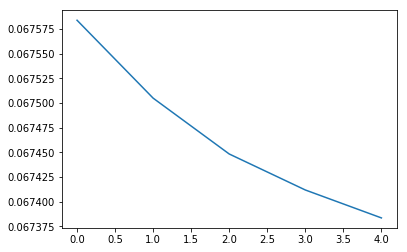

In [14]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Assume that we are on a CUDA machine, then this should print a CUDA device:
print(device)
model.to(device)

lr, epochs, batch_size = 1e-1 , 5 , 10
optimizer = torch.optim.SGD(model.parameters(), lr = lr )
accum=[]
i = 0
for k in range(epochs):
    localaccum = []
    for xy, xyz in iter(loader):
        i =  i+1
        local_xy = Variable(xy)
        #print(local_xy)
        local_xyz = Variable(xyz)
        local_xy = local_xy.to(device)
        output = model.forward(local_xy)
        output = output.to(device)
        #print(output)
        loss = criterion(output, torch.Tensor.new_zeros(output, output.size()))
        #print(local_xy, local_xyz)
        if (i%500 == 0): print("network loss -> ", loss)
        model.zero_grad()
        loss.backward()
        optimizer.step()
        localaccum.append(loss.data[0])
    accum.append(np.mean(localaccum))
plt.plot(accum);                      

In [15]:
orig_obj = [[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265 ],
        [ 0.1290, -0.0706, -0.1290,  0.1504, -0.8558, -1.0554, -1.1139,
         -0.8344 ],
        [ 0.6691,  0.9135, -0.6691, -0.5000,  0.6691,  0.9135, -0.6691,
         -0.5000 ]]

In [16]:
obj = [[[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265,  1.0000,  1.0000,  1.0000,  0.0000,  1.0000,  1.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  1.0000,  1.0000,  1.0000,
          1.0000,  1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000],
        [ 0.1290, -0.0706, -0.1290,  0.1504, -0.8558, -1.0554, -1.1139,
         -0.8344,  1.0000,  1.0000,  1.0000,  0.0000,  1.0000,  1.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  1.0000,  1.0000,  1.0000,
          1.0000,  1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000],
        [ 0.6691,  0.9135, -0.6691, -0.5000,  0.6691,  0.9135, -0.6691,
         -0.5000,  1.0000,  1.0000,  1.0000,  0.0000,  1.0000,  1.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          1.0000,  0.0000,  0.0000,  0.0000,  1.0000,  1.0000,  1.0000,
          1.0000,  1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000]]]

model.forward(torch.Tensor(obj).to(device), extract_x=True)


 vertexs_recovered: tensor([[ 0.7317, -0.4008, -0.7316,  0.8540,  0.9052, -0.2270, -0.5576,
          1.0279]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-07 *
       4.8034, device='cuda:0')
x output vec: tensor([[ 1.5411,  0.4764, -1.3679,  0.0000,  1.5539,  0.4893, -1.3549,
          0.0000, -0.0000, -0.0000,  0.0000,  0.0000, -0.0000, -0.0244,
         -0.0000, -0.0000,  0.0000, -0.0391, -0.2386, -0.2388, -0.2382,
         -0.2382,  0.0000,  0.0000, -0.0000,  0.0000, -0.0000, -0.0000]], device='cuda:0')


tensor([[ 0.6672,  0.4800,  0.3117,  0.7023,  0.8184,  0.6521,  0.4605,
          0.8292]], device='cuda:0')

In [17]:
model.forward(torch.Tensor(obj).to(device), extract_y=True)


 vertexs_recovered: tensor([[ 0.7317, -0.4008, -0.7321,  0.8527,  0.9052, -0.2271, -0.5584,
          1.0263]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-08 *
       5.3748, device='cuda:0')
y output vec: tensor([[ 0.2691,  0.0851, -0.2378,  0.0000,  0.2718,  0.0878, -0.2352,
          0.0000, -0.0000,  0.0000,  0.0000,  0.0000, -0.0000, -0.0040,
          0.0000,  0.0000,  0.0000, -0.0063,  1.3383,  1.3271,  1.3325,
          1.3454,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000]], device='cuda:0')


tensor([[ 0.3931,  0.4622,  0.4379,  0.4768,  0.5700,  0.5992,  0.5184,
          0.6012]], device='cuda:0')

In [18]:
model.forward(torch.Tensor(obj).to(device), extract_z=True)


 vertexs_recovered: tensor([[ 0.7321, -0.4004, -0.7317,  0.8530,  0.9057, -0.2267, -0.5580,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-08 *
       4.0572, device='cuda:0')
z output vec: tensor([[-0.3046,  1.6687,  0.0294, -0.0000, -0.3047,  1.6687,  0.0293,
          0.0000,  0.0000, -0.0000, -0.0000,  0.0000,  0.0000,  1.2987,
          0.0000, -0.0000,  0.0000,  1.3341,  0.0025,  0.0039,  0.0023,
          0.0010, -0.0000,  0.0000, -0.0000,  0.0000,  0.0000,  0.0000]], device='cuda:0')


tensor([[ 0.8963,  1.1620,  0.6965,  0.7597,  1.1284,  1.3382,  0.8146,
          0.9276]], device='cuda:0')

In [169]:
obj[:,2,:]

array([[-0.05366024,  0.17364818,  0.05366024, -0.17364818,  0.93114752,
         1.15845585,  1.038468  ,  0.81115955]])

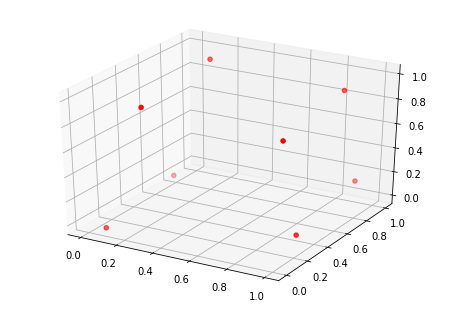

In [266]:
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.pyplot as plt
fig = plt.figure()
ax = Axes3D(fig)
x = [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265 ]
y =  [ 0.1290, -0.0706, -0.1290,  0.1504, -0.8558, -1.0554, -1.1139,
         -0.8344 ]
z =  [ 0.6691,  0.9135, -0.6691, -0.5000,  0.6691,  0.9135, -0.6691,
         -0.5000 ]
x=[(i-min(x))/(max(x)-min(x)) for i in x]
y=[(i-min(y))/(max(y)-min(y)) for i in y]
z=[(i-min(z))/(max(z)-min(z)) for i in z]

verts = [list(zip(x, y,z))]
#ax.add_collection3d(Poly3DCollection(verts))
ax.scatter(x, y, z, c='r', marker='o')
plt.show()

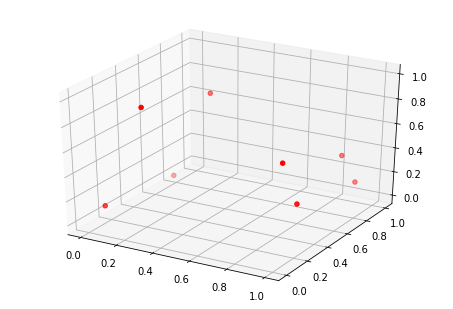

In [19]:
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.pyplot as plt
fig = plt.figure()
ax = Axes3D(fig)
x = [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265 ]
y =  [ 0.1290, -0.0706, -0.1290,  0.1504, -0.8558, -1.0554, -1.1139,
         -0.8344 ]
z = [ 0.8963,  1.1620,  0.6965,  0.7597,  1.1284,  1.3382,  0.8146,
          0.9276]
x=[(i-min(x))/(max(x)-min(x)) for i in x]
y=[(i-min(y))/(max(y)-min(y)) for i in y]
z=[(i-min(z))/(max(z)-min(z)) for i in z]

verts = [list(zip(x, y,z))]
#ax.add_collection3d(Poly3DCollection(verts))
ax.scatter(x, y, z, c='r', marker='o')
plt.show()

Trial #2

cuda:0
 vertexs_recovered: tensor([[-0.1809, -0.9567, -0.0912,  0.8534, -0.0075, -0.7832,  0.0831,
          1.0262],
        [ 0.1606, -0.9474, -0.3847,  0.8534,  0.3342, -0.7735, -0.2108,
          1.0268],
        [ 0.5936, -0.7106, -0.7630,  0.8530,  0.7674, -0.5368, -0.5894,
          1.0266],
        [ 0.8054, -0.6810, -0.0936,  0.8521,  0.9789, -0.5076,  0.0803,
          1.0249],
        [ 0.1626, -0.7104, -0.7614,  0.8537,  0.3364, -0.5367, -0.5876,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00

/home/mishra/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:28: UserWarning: invalid index of a 0-dim tensor. This will be an error in PyTorch 0.5. Use tensor.item() to convert a 0-dim tensor to a Python number


loss tensor(1.00000e-05 *
       2.0091, device='cuda:0')
 vertexs_recovered: tensor([[-0.1820, -0.9603, -0.6073,  0.8520, -0.0086, -0.7868, -0.4335,
          1.0252],
        [ 0.9183, -0.5586, -0.6701,  0.8509,  1.0914, -0.3854, -0.4962,
          1.0237],
        [ 0.6363, -0.6385, -0.3377,  0.8513,  0.8100, -0.4652, -0.1645,
          1.0248],
        [ 0.2949, -0.8579, -0.2906,  0.8516,  0.4688, -0.6845, -0.1174,
          1.0253],
        [ 0.0007, -0.9854, -0.0023,  0.8513,  0.1747, -0.8123,  0.1710,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e

 vertexs_recovered: tensor([[ 0.1656, -0.9382, -0.7549,  0.8571,  0.3394, -0.7640, -0.5812,
          1.0324],
        [ 0.4969, -0.9752,  0.0057,  0.8567,  0.6710, -0.8012,  0.1792,
          1.0323],
        [ 0.3775, -0.6746, -0.0855,  0.8566,  0.5514, -0.5009,  0.0883,
          1.0317],
        [ 0.8009, -0.1755, -0.9301,  0.8547,  0.9746, -0.0021, -0.7565,
          1.0290],
        [ 0.5994, -0.9387, -0.3767,  0.8575,  0.7730, -0.7644, -0.2029,
          1.0329]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       5.4670, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4991, -0.4865, -0.4844,  0.8569,  0.6725, -0.3126, -0.3104,
          1.0318],
        [ 0.4088, -0.7244, -0.5697,  0.8575,  0.5822, -0.5505, -0.3957,
          1.0325],
        [ 0.2925, -0.9709, -0.6626,  0.8575,  0.4659, -0.7967, -0.4887,
          1.0328],
        [ 0.7378, -0.3939, -0.1976,  0.8565,  0.9111, -0.2202, -0.0234,
          1.0311],
        [ 0.8493,  0.0104, -0.8504,  0.8553,  1.0225,  0.1840, -0.6764,
  

loss tensor(1.00000e-05 *
       1.0862, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8001, -0.9549, -0.6075,  0.8522,  0.9736, -0.7812, -0.4339,
          1.0258],
        [ 0.0010, -0.9709, -0.3361,  0.8516,  0.1746, -0.7975, -0.1626,
          1.0250],
        [ 0.6711, -0.5548, -0.6682,  0.8526,  0.8449, -0.3811, -0.4947,
          1.0262],
        [ 0.4943, -0.8539, -0.4910,  0.8523,  0.6682, -0.6804, -0.3177,
          1.0260],
        [ 0.0046, -0.8550, -0.4898,  0.8521,  0.1782, -0.6816, -0.3161,
          1.0254]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e

 vertexs_recovered: tensor([[ 0.7965, -0.1901, -0.6099,  0.8518,  0.9696, -0.0161, -0.4361,
          1.0248],
        [ 0.4902, -0.8577, -0.4934,  0.8514,  0.6635, -0.6839, -0.3198,
          1.0241],
        [ 0.4916, -0.8558, -0.0030,  0.8507,  0.6654, -0.6825,  0.1703,
          1.0233],
        [ 0.3669, -0.6839, -0.0951,  0.8512,  0.5406, -0.5105,  0.0783,
          1.0239],
        [ 0.4826, -0.9876, -0.4963,  0.8507,  0.6558, -0.8137, -0.3228,
          1.0236]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.0008, -0.9743, -0.3375,  0.8517,  0.1727, -0.8006, -0.1638,
          1.0248],
        [ 0.1976, -0.9827, -0.2093,  0.8509,  0.3714, -0.8090, -0.0360,
          1.0244],
        [-0.0008, -0.9743, -0.3375,  0.8517,  0.1727, -0.8006, -0.1638,
          1.0248],
        [ 0.8464, -0.8590, -0.8600,  0.8487,  1.0200, -0.6859, -0.6862,
          1.0207],
        [-0.1946, -0.9295, -0.0968,  0.8515, -0.0212, -0.7559,  0.0768,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4922, -0.9837, -0.0024,  0.8531,  0.6661, -0.8100,  0.1711,
          1.0268],
        [ 0.8924, -0.7108, -0.7617,  0.8529,  1.0653, -0.5371, -0.5873,
          1.0255],
        [ 0.7281, -0.9786, -0.2065,  0.8530,  0.9014, -0.8047, -0.0327,
          1.0265],
        [ 0.7315, -0.4029, -0.7330,  0.8527,  0.9049, -0.2291, -0.5592,
          1.0259],
        [ 0.4922, -0.9837, -0.0024,  0.8531,  0.6661, -0.8100,  0.1711,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2011, -0.8583, -0.7368,  0.8495,  0.3750, -0.6851, -0.5635,
          1.0220],
        [-0.1868, -0.9610, -0.0964,  0.8496, -0.0133, -0.7881,  0.0774,
          1.0214],
        [ 0.1945, -0.9830, -0.2122,  0.8490,  0.3682, -0.8097, -0.0391,
          1.0216],
        [ 0.3591, -0.9626, -0.6147,  0.8493,  0.5328, -0.7892, -0.4414,
          1.0219],
        [ 0.7265, -0.4047, -0.7360,  0.8501,  0.9002, -0.2314, -0.5627,
          1.0229]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0065, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3680, -0.9600, -0.6067,  0.8546,  0.5417, -0.7857, -0.4329,
          1.0295],
        [ 0.4066, -0.7362, -0.5751,  0.8549,  0.5804, -0.5620, -0.4012,
          1.0296],
        [-0.1802, -0.9589, -0.0899,  0.8540, -0.0067, -0.7851,  0.0844,
          1.0278],
     

 vertexs_recovered: tensor([[ 0.4901, -0.4910, -0.8550,  0.8533,  0.6641, -0.3174, -0.6814,
          1.0272],
        [ 0.4024, -0.7334, -0.5767,  0.8543,  0.5761, -0.5594, -0.4027,
          1.0282],
        [ 0.8530, -0.8527, -0.4890,  0.8542,  1.0260, -0.6788, -0.3144,
          1.0275],
        [ 0.7937, -0.1813, -0.9363,  0.8522,  0.9676, -0.0080, -0.7628,
          1.0258],
        [ 0.3706, -0.6806, -0.0917,  0.8542,  0.5446, -0.5068,  0.0821,
          1.0281]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 8.0033e-01, -1.8470e-01, -6.0621e-01,  8.5483e-01,  9.7355e-01,
         -1.0392e-02, -4.3215e-01,  1.0290e+00],
        [ 8.5352e-01, -8.4925e-01, -1.3076e-05,  8.5373e-01,  1.0268e+00,
         -6.7574e-01,  1.7421e-01,  1.0266e+00],
        [-1.9468e-01, -9.2476e-01, -9.5483e-02,  8.5349e-01, -2.1711e-02,
         -7.5097e-01,  7.8628e-02,  1.0269e+00],
        [ 4.9313e-01, -4.8828e-01, -8.5227e-01,  8.5476e-01,  6.6707e-01,
         -3.1447e-01, -6.7862e-01,  1.0291e+00],
        [-2.6966e-03, -9.8032e-01, -1.7563e-03,  8.5356e-01,  1.7076e-01,
         -8.0677e-01,  1.7213e-01,  1.0269e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700

loss tensor(1.00000e-05 *
       1.9428, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8557, -0.8581, -0.4927,  0.8509,  1.0293, -0.6848, -0.3192,
          1.0242],
        [ 0.1636, -0.7174, -0.3859,  0.8511,  0.3376, -0.5440, -0.2126,
          1.0245],
        [ 0.0055, -0.8597, -0.4918,  0.8509,  0.1793, -0.6864, -0.3184,
          1.0242],
        [ 0.2008, -0.9829, -0.2091,  0.8504,  0.3749, -0.8094, -0.0362,
          1.0243],
        [ 0.4952, -0.8596, -0.4940,  0.8508,  0.6693, -0.6862, -0.3210,
          1.0245]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e

 vertexs_recovered: tensor([[ 0.6286, -0.9761, -0.3393,  0.8503,  0.8024, -0.8025, -0.1660,
          1.0238],
        [-0.0010, -0.8577, -0.8557,  0.8500,  0.1729, -0.6845, -0.6823,
          1.0229],
        [ 0.6676, -0.8597, -0.6716,  0.8503,  0.8414, -0.6861, -0.4982,
          1.0236],
        [ 0.6681, -0.5615, -0.6713,  0.8506,  0.8419, -0.3880, -0.4979,
          1.0239],
        [ 0.1476, -0.9699, -0.3904,  0.8500,  0.3213, -0.7961, -0.2172,
          1.0236]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -9.6985e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8905, -0.7134, -0.3852,  0.8508,  1.0636, -0.5401, -0.2112,
          1.0230],
        [ 0.4918, -0.8572, -0.4939,  0.8507,  0.6654, -0.6838, -0.3206,
          1.0235],
        [ 0.2892, -0.8567, -0.6720,  0.8504,  0.4628, -0.6833, -0.4986,
          1.0232],
        [-0.0147, -0.8499, -0.0077,  0.8500,  0.1589, -0.6765,  0.1654,
          1.0233],
        [-0.0046, -0.9870, -0.4943,  0.8506,  0.1686, -0.8135, -0.3207,
          1.0233]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7331, -0.8546, -0.7317,  0.8518,  0.9071, -0.6812, -0.5584,
          1.0256],
        [ 0.2070, -0.8557, -0.7320,  0.8517,  0.3811, -0.6824, -0.5587,
          1.0254],
        [ 0.5926, -0.9455,  0.0753,  0.8513,  0.7673, -0.7726,  0.2481,
          1.0251],
        [-0.0145, -0.8496, -0.0084,  0.8503,  0.1595, -0.6763,  0.1644,
          1.0242],
        [ 0.3549, -0.9292, -0.1007,  0.8508,  0.5291, -0.7557,  0.0720,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.8119, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7973, -0.1903, -0.6088,  0.8531,  0.9707, -0.0160, -0.4345,
          1.0265],
        [ 0.4942, -0.8587, -0.4908,  0.8532,  0.6680, -0.6847, -0.3167,
          1.0269],
        [ 0.8558, -0.8549,  0.0011,  0.8529,  1.0295, -0.6813,  0.1755,
          1.0259],
        [ 0.9166, -0.5581, -0.6669,  0.8533,  1.0896, -0.3841, -0.4919,
          1.0261],
        [ 0.2007, -0.9826, -0.2061,  0.8524,  0.3745, -0.8086, -0.0323,
  

 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.3126, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7329, -0.4037, -0.2048,  0.8529,  0.9063, -0.2298, -0.0310,
          1.0263],
        [ 0.6302, -0.9721, -0.3386,  0.8525,  0.8035, -0.7982, -0.1649,
          1.0260],
        [ 0.2922, -0.8558, -0.6696,  0.8531,  0.4657, -0.6820, -0.4958,
          1.0267],
        [ 0.4925, -0.4929, -0.8544,  0.8528,  0.6663, -0.3193, -0.6809,
          1.0267],
        [ 0.7236, -0.9797, -0.2089,  0.8520,  0.8968, -0.8058, -0.0353,
  

 vertexs_recovered: tensor([[ 0.6309, -0.6400, -0.3394,  0.8507,  0.8048, -0.4664, -0.1661,
          1.0235],
        [ 0.2808, -0.9867, -0.6755,  0.8501,  0.4546, -0.8130, -0.5023,
          1.0232],
        [ 0.8494, -0.4986, -0.4940,  0.8506,  1.0227, -0.3249, -0.3202,
          1.0230],
        [ 0.8458, -0.8556, -0.8587,  0.8493,  1.0194, -0.6825, -0.6851,
          1.0216],
        [ 0.4823, -0.9879, -0.0083,  0.8494,  0.6565, -0.8146,  0.1646,
          1.0225]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       6.9742, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4863, -0.9807, -0.4932,  0.8542,  0.6597, -0.8066, -0.3196,
          1.0285],
        [ 0.3688, -0.6788, -0.6065,  0.8546,  0.5424, -0.5048, -0.4327,
          1.0286],
        [ 0.8548, -0.4901, -0.4884,  0.8548,  1.0278, -0.3160, -0.3142,
          1.0284],
     

 vertexs_recovered: tensor([[ 0.7370, -0.7381, -0.5752,  0.8528,  0.9109, -0.5642, -0.4015,
          1.0271],
        [ 0.4974, -0.4995, -0.4892,  0.8530,  0.6715, -0.3255, -0.3158,
          1.0275],
        [ 0.7368, -0.8580, -0.2026,  0.8524,  0.9108, -0.6843, -0.0290,
          1.0265],
        [ 0.7355, -0.4062, -0.2028,  0.8526,  0.9094, -0.2324, -0.0293,
          1.0266],
        [ 0.6741, -0.5609, -0.6669,  0.8528,  0.8482, -0.3870, -0.4934,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.4264, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4975, -0.8534, -0.4868,  0.8547,  0.6714, -0.6795, -0.3130,
          1.0296],
        [-0.1809, -0.9570, -0.0888,  0.8533, -0.0074, -0.7835,  0.0855,
          1.0268],
        [ 0.2896, -0.9784,  0.1453,  0.8527,  0.4642, -0.8052,  0.3185,
          1.0270],
        [ 0.6339, -0.9684, -0.3328,  0.8544,  0.8077, -0.7945, -0.1591,
          1.0293],
        [ 0.8031, -0.1858, -0.6040,  0.8549,  0.9766, -0.0116, -0.4301,
          1.0296]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
  

 vertexs_recovered: tensor([[ 0.8857, -0.3135, -0.7659,  0.8509,  1.0590, -0.1402, -0.5921,
          1.0234],
        [ 0.9160, -0.5582, -0.6711,  0.8508,  1.0891, -0.3849, -0.4970,
          1.0230],
        [ 0.8538, -0.8567, -0.0042,  0.8497,  1.0277, -0.6838,  0.1693,
          1.0220],
        [ 0.5902, -0.9494,  0.0721,  0.8494,  0.7647, -0.7766,  0.2450,
          1.0223],
        [ 0.4923, -0.8590, -0.4954,  0.8507,  0.6661, -0.6855, -0.3221,
          1.0238]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.3430, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7360, -0.8480, -0.7277,  0.8551,  0.9096, -0.6742, -0.5538,
          1.0294],
        [ 0.8584, -0.8485,  0.0034,  0.8542,  1.0319, -0.6751,  0.1775,
          1.0278],
        [ 0.5968, -0.7058, -0.7590,  0.8551,  0.7705, -0.5321, -0.5853,
          1.0296],
        [ 0.4072, -0.7296, -0.5736,  0.8553,  0.5808, -0.5557, -0.3998,
          1.0297],
        [ 0.8057, -0.6700, -0.9298,  0.8544,  0.9797, -0.4968, -0.7562,
  

 vertexs_recovered: tensor([[ 0.7423, -0.8495, -0.1985,  0.8560,  0.9160, -0.6757, -0.0247,
          1.0309],
        [ 0.9226, -0.5546, -0.6660,  0.8542,  1.0957, -0.3810, -0.4917,
          1.0279],
        [ 0.8646, -0.8463,  0.0068,  0.8562,  1.0383, -0.6728,  0.1808,
          1.0310],
        [ 0.5958, -0.9437, -0.7615,  0.8546,  0.7697, -0.7699, -0.5881,
          1.0295],
        [ 0.8590, -0.4929, -0.4883,  0.8544,  1.0323, -0.3191, -0.3142,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.4235, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8489, -0.4939, -0.8586,  0.8500,  1.0225, -0.3208, -0.6852,
          1.0225],
        [-0.3994, -0.9799, -0.2034,  0.8519, -0.2268, -0.8066, -0.0288,
          1.0241],
        [ 0.4898, -0.8551, -0.8597,  0.8503,  0.6638, -0.6820, -0.6866,
          1.0233],
        [ 0.1625, -0.7158, -0.3862,  0.8518,  0.3361, -0.5423, -0.2126,
          1.0247],
        [ 0.8532, -0.8563, -0.4936,  0.8513,  1.0263, -0.6828, -0.3198,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
  

 vertexs_recovered: tensor([[ 0.5935, -0.9466, -0.3840,  0.8548,  0.7670, -0.7726, -0.2100,
          1.0290],
        [ 0.1609, -0.9444,  0.0783,  0.8536,  0.3350, -0.7711,  0.2520,
          1.0272],
        [ 0.6736, -0.8530, -0.6671,  0.8551,  0.8471, -0.6791, -0.4930,
          1.0293],
        [-0.0010, -0.9840, -0.4908,  0.8546,  0.1722, -0.8100, -0.3165,
          1.0284],
        [ 0.5926, -0.3116, -0.7622,  0.8546,  0.7663, -0.1377, -0.5884,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       2.6268, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4982, -0.8495, -0.4862,  0.8561,  0.6719, -0.6754, -0.3124,
          1.0308],
        [ 0.2938, -0.9738,  0.1487,  0.8551,  0.4681, -0.8003,  0.3221,
          1.0299],
        [ 0.3685, -0.6710, -0.9306,  0.8548,  0.5430, -0.4977, -0.7573,
          1.0293],
        [ 0.2133, -0.8492, -0.1980,  0.8560,  0.3870, -0.6753, -0.0241,
          1.0305],
        [ 0.8586, -0.8483, -0.4849,  0.8561,  1.0318, -0.6743, -0.3107,
          1.0304]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
  

loss tensor(1.00000e-06 *
       4.3163, device='cuda:0')
 vertexs_recovered: tensor([[-0.1904, -0.9258, -0.0925,  0.8539, -0.0174, -0.7519,  0.0817,
          1.0277],
        [ 0.4046, -0.9355, -0.2019,  0.8546,  0.5781, -0.7617, -0.0280,
          1.0287],
        [ 0.8063, -0.6778, -0.6044,  0.8549,  0.9793, -0.5039, -0.4300,
          1.0286],
        [ 0.8004, -0.1842, -0.6070,  0.8543,  0.9734, -0.0102, -0.4329,
          1.0282],
        [ 0.6729, -0.8508, -0.6668,  0.8548,  0.8462, -0.6769, -0.4927,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
  

 vertexs_recovered: tensor([[ 0.5911, -0.7165, -0.3886,  0.8514,  0.7648, -0.5429, -0.2151,
          1.0243],
        [ 0.9143, -0.5576, -0.6713,  0.8513,  1.0873, -0.3841, -0.4972,
          1.0235],
        [ 0.3632, -0.9619, -0.0986,  0.8507,  0.5372, -0.7885,  0.0746,
          1.0237],
        [ 0.4922, -0.8574, -0.0048,  0.8508,  0.6663, -0.6842,  0.1684,
          1.0236],
        [ 0.8483, -0.4930, -0.8580,  0.8508,  1.0218, -0.3198, -0.6844,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.9364, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7324, -0.3910, -0.9819,  0.8535,  0.9076, -0.2181, -0.8087,
          1.0282],
        [ 0.8954, -0.7066, -0.7554,  0.8554,  1.0689, -0.5327, -0.5808,
          1.0297],
        [ 0.1617, -0.9420,  0.0814,  0.8546,  0.3359, -0.7685,  0.2551,
          1.0290],
        [ 0.4975, -0.8524, -0.4862,  0.8555,  0.6713, -0.6782, -0.3123,
          1.0304],
        [ 0.3563, -0.9254, -0.0949,  0.8542,  0.5302, -0.7513,  0.0785,
          1.0294]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
  

 vertexs_recovered: tensor([[ 0.2980, -0.8517, -0.6636,  0.8553,  0.4718, -0.6778, -0.4897,
          1.0300],
        [ 0.3744, -0.6796, -0.6023,  0.8553,  0.5481, -0.5057, -0.4284,
          1.0300],
        [ 0.3744, -0.6796, -0.6023,  0.8553,  0.5481, -0.5057, -0.4284,
          1.0300],
        [ 0.7317, -0.9731, -0.1998,  0.8555,  0.9052, -0.7991, -0.0259,
          1.0306],
        [ 0.3722, -0.9531, -0.0890,  0.8551,  0.5462, -0.7795,  0.0847,
          1.0299]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0698, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7211, -0.3954, -0.9927,  0.8482,  0.8958, -0.2231, -0.8203,
          1.0206],
        [-0.0025, -0.8531, -0.8576,  0.8504,  0.1714, -0.6801, -0.6843,
          1.0228],
        [-0.0025, -0.8531, -0.8576,  0.8504,  0.1714, -0.6801, -0.6843,
          1.0228],
     

 vertexs_recovered: tensor([[ 0.7293, -0.8522, -0.7339,  0.8511,  0.9028, -0.6789, -0.5606,
          1.0241],
        [ 0.8491, -0.8492, -0.8562,  0.8507,  1.0226, -0.6762, -0.6827,
          1.0233],
        [ 0.8489, -0.4896, -0.8563,  0.8507,  1.0224, -0.3165, -0.6830,
          1.0233],
        [-0.1854, -0.9577, -0.6072,  0.8518, -0.0124, -0.7843, -0.4333,
          1.0245],
        [ 0.7281, -0.4008, -0.7345,  0.8512,  0.9017, -0.2273, -0.5613,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.5877, -0.9524, -0.3893,  0.8508,  0.7616, -0.7787, -0.2160,
          1.0243],
        [ 0.3989, -0.9426, -0.2080,  0.8508,  0.5731, -0.7691, -0.0348,
          1.0242],
        [ 0.8521, -0.8569, -0.0030,  0.8504,  1.0261, -0.6837,  0.1707,
          1.0231],
        [ 0.1572, -0.9521, -0.3877,  0.8512,  0.3311, -0.7786, -0.2143,
          1.0245],
        [ 0.8001, -0.6859, -0.6104,  0.8510,  0.9738, -0.5123, -0.4368,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       3.8848, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2893, -0.5589, -0.6710,  0.8515,  0.4630, -0.3853, -0.4976,
          1.0248],
        [ 0.8025, -0.6812, -0.0942,  0.8514,  0.9758, -0.5079,  0.0796,
          1.0242],
        [-0.0174, -0.8492, -0.0080,  0.8506,  0.1559, -0.6755,  0.1652,
          1.0239],
        [ 0.8511, -0.8554, -0.4914,  0.8517,  1.0239, -0.6816, -0.3173,
          1.0244],
        [ 0.3655, -0.6838, -0.6095,  0.8517,  0.5391, -0.5102, -0.4360,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e

 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.3155, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1501, -0.9639,  0.0733,  0.8520,  0.3241, -0.7903,  0.2465,
          1.0259],
        [ 0.4023, -0.7361, -0.5790,  0.8532,  0.5759, -0.5622, -0.4054,
          1.0268],
        [ 0.8547, -0.8549, -0.4901,  0.8535,  1.0276, -0.6810, -0.3159,
          1.0269],
     

 vertexs_recovered: tensor([[ 0.1635, -0.9468, -0.3809,  0.8553,  0.3368, -0.7726, -0.2067,
          1.0298],
        [-0.0112, -0.8484, -0.0028,  0.8537,  0.1622, -0.6742,  0.1709,
          1.0284],
        [ 0.3697, -0.9566, -0.0913,  0.8547,  0.5434, -0.7827,  0.0825,
          1.0292],
        [ 0.3575, -0.9281, -0.0955,  0.8540,  0.5310, -0.7539,  0.0780,
          1.0290],
        [ 0.8573, -0.4942, -0.4871,  0.8547,  1.0303, -0.3200, -0.3127,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.2434, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5965, -0.7124, -0.3814,  0.8545,  0.7701, -0.5384, -0.2072,
          1.0285],
        [ 0.2900, -0.9816, -0.2874,  0.8544,  0.4635, -0.8075, -0.1134,
          1.0287],
        [ 0.6352, -0.6320, -0.8509,  0.8538,  0.8093, -0.4583, -0.6770,
          1.0278],
        [ 0.7342, -0.8527, -0.7274,  0.8544,  0.9078, -0.6787, -0.5531,
          1.0284],
        [ 0.9200, -0.5553, -0.6635,  0.8543,  1.0929, -0.3813, -0.4885,
          1.0275]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
  

 vertexs_recovered: tensor([[ 0.2030, -0.8564, -0.7337,  0.8512,  0.3768, -0.6829, -0.5603,
          1.0245],
        [ 0.8525, -0.8528, -0.0014,  0.8512,  1.0262, -0.6797,  0.1724,
          1.0239],
        [ 0.5866, -0.3156, -0.7664,  0.8512,  0.7605, -0.1419, -0.5933,
          1.0248],
        [ 0.7983, -0.6775, -0.9354,  0.8507,  0.9724, -0.5045, -0.7622,
          1.0238],
        [ 0.8492, -0.4929, -0.8553,  0.8512,  1.0228, -0.3195, -0.6817,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4871, -0.9838, -0.0057,  0.8503,  0.6613, -0.8107,  0.1671,
          1.0237],
        [ 0.8030, -0.6813, -0.6086,  0.8516,  0.9764, -0.5078, -0.4351,
          1.0247],
        [ 0.8534, -0.8540, -0.4917,  0.8515,  1.0266, -0.6805, -0.3180,
          1.0244],
        [ 0.4858, -0.9859, -0.4959,  0.8510,  0.6594, -0.8122, -0.3229,
          1.0247],
        [ 0.8512, -0.8500, -0.8550,  0.8511,  1.0248, -0.6769, -0.6816,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5898, -0.7190, -0.3908,  0.8505,  0.7637, -0.5453, -0.2177,
          1.0234],
        [ 0.7285, -0.8604, -0.2109,  0.8499,  0.9024, -0.6870, -0.0377,
          1.0225],
        [ 0.1540, -0.9521, -0.3905,  0.8508,  0.3277, -0.7785, -0.2173,
          1.0238],
        [ 0.2890, -0.5621, -0.6736,  0.8511,  0.4630, -0.3884, -0.5005,
          1.0244],
        [ 0.6250, -0.9771, -0.3442,  0.8499,  0.7988, -0.8035, -0.1712,
          1.0228]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-06 *
       7.4797, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4977, -0.8525, -0.4891,  0.8552,  0.6714, -0.6784, -0.3153,
          1.0296],
        [ 0.4958, -0.8492, -0.8526,  0.8546,  0.6700, -0.6756, -0.6790,
          1.0290],
        [ 0.5944, -0.9442, -0.3834,  0.8552,  0.7680, -0.7701, -0.2096,
          1.0296],
        [ 0.6739, -0.8514, -0.6670,  0.8551,  0.8475, -0.6774, -0.4931,
          1.0294],
        [ 0.4952, -0.4909, -0.8533,  0.8541,  0.6694, -0.3172, -0.6799,
          1.0285]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
  

 vertexs_recovered: tensor([[ 0.8524, -0.8529, -0.0025,  0.8511,  1.0262, -0.6798,  0.1711,
          1.0239],
        [ 0.7288, -0.4042, -0.7347,  0.8509,  0.9026, -0.2307, -0.5614,
          1.0241],
        [ 0.7262, -0.3953, -0.9895,  0.8493,  0.9012, -0.2230, -0.8169,
          1.0224],
        [ 0.3663, -0.6851, -0.6106,  0.8512,  0.5402, -0.5116, -0.4372,
          1.0243],
        [ 0.4913, -0.8579, -0.4946,  0.8512,  0.6651, -0.6843, -0.3212,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6365, -0.6363, -0.3350,  0.8540,  0.8101, -0.4623, -0.1611,
          1.0278],
        [ 0.2884, -0.9827, -0.2902,  0.8540,  0.4619, -0.8085, -0.1164,
          1.0281],
        [ 0.5900, -0.9460, -0.7634,  0.8537,  0.7635, -0.7720, -0.5897,
          1.0278],
        [ 0.5922, -0.9434,  0.0773,  0.8534,  0.7663, -0.7700,  0.2508,
          1.0273],
        [ 0.8549, -0.8542, -0.4892,  0.8541,  1.0279, -0.6802, -0.3148,
          1.0275]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4886, -0.4926, -0.8568,  0.8523,  0.6624, -0.3190, -0.6833,
          1.0256],
        [ 0.7965, -0.1888, -0.6098,  0.8529,  0.9696, -0.0145, -0.4360,
          1.0262],
        [ 0.2834, -0.9847, -0.2943,  0.8518,  0.4568, -0.8110, -0.1207,
          1.0249],
        [-0.0032, -0.9729, -0.3383,  0.8520,  0.1699, -0.7992, -0.1642,
          1.0246],
        [ 0.3623, -0.6770, -0.9367,  0.8518,  0.5364, -0.5040, -0.7633,
          1.0248]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2167, -0.8477, -0.1963,  0.8567,  0.3907, -0.6738, -0.0225,
          1.0318],
        [ 0.8581, -0.8429, -0.8478,  0.8558,  1.0316, -0.6695, -0.6738,
          1.0304],
        [ 0.0091, -0.8441, -0.8462,  0.8561,  0.1828, -0.6706, -0.6723,
          1.0307],
        [ 0.7356, -0.3969, -0.7275,  0.8553,  0.9094, -0.2229, -0.5539,
          1.0300],
        [ 0.4074, -0.9307, -0.5718,  0.8566,  0.5811, -0.7567, -0.3981,
          1.0320]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.3882, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1629, -0.9450, -0.3825,  0.8552,  0.3365, -0.7710, -0.2086,
          1.0295],
        [ 0.8565, -0.8514, -0.4878,  0.8550,  1.0297, -0.6774, -0.3136,
          1.0288],
        [ 0.4948, -0.8486, -0.8532,  0.8547,  0.6690, -0.6750, -0.6798,
          1.0292],
     

 vertexs_recovered: tensor([[ 0.8890, -0.7161, -0.7632,  0.8517,  1.0624, -0.5423, -0.5891,
          1.0248],
        [ 0.4893, -0.8579, -0.8582,  0.8511,  0.6636, -0.6844, -0.6850,
          1.0248],
        [ 0.8546, -0.8553, -0.0010,  0.8519,  1.0283, -0.6820,  0.1729,
          1.0250],
        [ 0.4861, -0.9862, -0.0060,  0.8514,  0.6602, -0.8127,  0.1671,
          1.0252],
        [ 0.2919, -0.8593, -0.2915,  0.8521,  0.4658, -0.6856, -0.1180,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       4.5237, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3604, -0.6804, -0.9411,  0.8494,  0.5349, -0.5076, -0.7683,
          1.0220],
        [ 0.5869, -0.9480,  0.0716,  0.8497,  0.7611, -0.7750,  0.2448,
          1.0223],
        [ 0.7288, -0.4062, -0.2083,  0.8507,  0.9024, -0.2327, -0.0348,
          1.0235],
     

 vertexs_recovered: tensor([[ 0.5881, -0.3161, -0.7668,  0.8511,  0.7619, -0.1424, -0.5939,
          1.0245],
        [ 0.6270, -0.9745, -0.3412,  0.8506,  0.8005, -0.8007, -0.1680,
          1.0236],
        [ 0.3509, -0.9313, -0.1020,  0.8502,  0.5247, -0.7575,  0.0707,
          1.0239],
        [ 0.6334, -0.6392, -0.3386,  0.8512,  0.8070, -0.4656, -0.1653,
          1.0242],
        [ 0.6306, -0.6355, -0.8583,  0.8506,  0.8046, -0.4622, -0.6853,
          1.0236]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.3665, -0.9541, -0.6057,  0.8550,  0.5401, -0.7800, -0.4319,
          1.0296],
        [-0.4000, -0.9743, -0.1987,  0.8547, -0.2275, -0.8004, -0.0237,
          1.0278],
        [ 0.4964, -0.8500,  0.0010,  0.8543,  0.6706, -0.6764,  0.1746,
          1.0283],
        [ 0.5924, -0.9436, -0.3831,  0.8549,  0.7659, -0.7695, -0.2093,
          1.0293],
        [-0.1819, -0.9536, -0.6019,  0.8553, -0.0090, -0.7796, -0.4273,
          1.0290]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2900, -0.5595, -0.6719,  0.8513,  0.4637, -0.3859, -0.4987,
          1.0242],
        [ 0.1968, -0.9813, -0.2099,  0.8508,  0.3706, -0.8076, -0.0369,
          1.0241],
        [ 0.2039, -0.8559, -0.7346,  0.8511,  0.3777, -0.6824, -0.5613,
          1.0239],
        [ 0.3660, -0.6846, -0.6109,  0.8513,  0.5397, -0.5111, -0.4377,
          1.0242],
        [ 0.2039, -0.8559, -0.7346,  0.8511,  0.3777, -0.6824, -0.5613,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[-0.1893, -0.9223, -0.0910,  0.8552, -0.0164, -0.7483,  0.0831,
          1.0294],
        [ 0.2144, -0.8490, -0.1986,  0.8560,  0.3879, -0.6752, -0.0247,
          1.0303],
        [ 0.5967, -0.9408, -0.3802,  0.8563,  0.7700, -0.7667, -0.2063,
          1.0310],
        [ 0.4980, -0.8446, -0.8483,  0.8563,  0.6718, -0.6708, -0.6746,
          1.0312],
        [ 0.8594, -0.4891, -0.4843,  0.8561,  1.0323, -0.3149, -0.3098,
          1.0302]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8016, -0.6780, -0.9348,  0.8511,  0.9756, -0.5051, -0.7614,
          1.0240],
        [ 0.0058, -0.8583, -0.4903,  0.8519,  0.1790, -0.6848, -0.3163,
          1.0246],
        [ 0.8443, -0.0011, -0.8564,  0.8515,  1.0177,  0.1727, -0.6829,
          1.0251],
        [ 0.1618, -0.7146, -0.7629,  0.8518,  0.3354, -0.5412, -0.5892,
          1.0249],
        [ 0.4923, -0.4952, -0.8558,  0.8515,  0.6662, -0.3218, -0.6825,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0036, -0.8503, -0.8510,  0.8545,  0.1771, -0.6767, -0.6768,
          1.0282],
        [ 0.7987, -0.1877, -0.6070,  0.8543,  0.9718, -0.0132, -0.4330,
          1.0283],
        [ 0.8907, -0.7074, -0.7589,  0.8550,  1.0636, -0.5334, -0.5843,
          1.0285],
        [ 0.6331, -0.6305, -0.8527,  0.8545,  0.8069, -0.4567, -0.6789,
          1.0286],
        [ 0.8873, -0.3103, -0.7604,  0.8545,  1.0603, -0.1362, -0.5859,
          1.0281]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8033, -0.6841, -0.6086,  0.8516,  0.9769, -0.5105, -0.4349,
          1.0248],
        [ 0.0056, -0.8555, -0.0014,  0.8513,  0.1798, -0.6825,  0.1720,
          1.0241],
        [ 0.8513, -0.4933, -0.8550,  0.8510,  1.0252, -0.3201, -0.6815,
          1.0241],
        [ 0.0056, -0.8555, -0.0014,  0.8513,  0.1798, -0.6825,  0.1720,
          1.0241],
        [ 0.8872, -0.3144, -0.7634,  0.8512,  1.0606, -0.1408, -0.5897,
          1.0243]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.1848, -0.9595, -0.0949,  0.8510, -0.0114, -0.7863,  0.0790,
          1.0236],
        [ 0.8525, -0.8562, -0.0042,  0.8501,  1.0263, -0.6831,  0.1694,
          1.0225],
        [ 0.3606, -0.9624, -0.6138,  0.8504,  0.5344, -0.7888, -0.4406,
          1.0238],
        [ 0.1461, -0.9687, -0.3925,  0.8503,  0.3195, -0.7949, -0.2194,
          1.0239],
        [ 0.4906, -0.8595, -0.4961,  0.8507,  0.6643, -0.6860, -0.3228,
          1.0238]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       9.0567, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1552, -0.7133, -0.7662,  0.8508,  0.3288, -0.5399, -0.5928,
          1.0236],
        [ 0.7943, -0.1900, -0.6113,  0.8510,  0.9673, -0.0161, -0.4378,
          1.0239],
        [ 0.1455, -0.9634,  0.0711,  0.8502,  0.3195, -0.7900,  0.2441,
          1.0237],
        [ 0.1437, -0.9668, -0.3920,  0.8506,  0.3169, -0.7929, -0.2187,
          1.0241],
        [ 0.5893, -0.7148, -0.3878,  0.8513,  0.7627, -0.5412, -0.2143,
          1.0243]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
  

 vertexs_recovered: tensor([[ 1.5052e-01, -9.6746e-01, -3.8857e-01,  8.5243e-01,  3.2434e-01,
         -7.9331e-01, -2.1547e-01,  1.0271e+00],
        [ 8.4732e-01, -6.0678e-05, -8.5579e-01,  8.5161e-01,  1.0213e+00,
          1.7347e-01, -6.8279e-01,  1.0261e+00],
        [ 4.9638e-01, -8.5484e-01, -1.0318e-03,  8.5255e-01,  6.7082e-01,
         -6.8160e-01,  1.7211e-01,  1.0266e+00],
        [ 8.5533e-01, -8.5215e-01, -8.5249e-01,  8.5264e-01,  1.0295e+00,
         -6.7876e-01, -6.7908e-01,  1.0269e+00],
        [ 4.9601e-01, -8.5771e-01, -4.9136e-01,  8.5304e-01,  6.7009e-01,
         -6.8393e-01, -3.1813e-01,  1.0275e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922

loss tensor(1.00000e-05 *
       1.8208, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7968, -0.1887, -0.9357,  0.8506,  0.9713, -0.0152, -0.7626,
          1.0244],
        [ 0.8030, -0.6816, -0.9341,  0.8510,  0.9777, -0.5084, -0.7609,
          1.0247],
        [ 0.7349, -0.4069, -0.2045,  0.8521,  0.9090, -0.2331, -0.0312,
          1.0259],
        [ 0.0083, -0.8601, -0.4900,  0.8525,  0.1822, -0.6864, -0.3164,
          1.0261],
        [ 0.2923, -0.9818,  0.1418,  0.8516,  0.4672, -0.8087,  0.3145,
          1.0257]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[ 0.8007, -0.9571, -0.0942,  0.8528,  0.9739, -0.7834,  0.0800,
          1.0261],
        [ 0.8551, -0.8524,  0.0004,  0.8529,  1.0284, -0.6790,  0.1747,
          1.0257],
        [ 0.2883, -0.9785,  0.1433,  0.8526,  0.4624, -0.8053,  0.3168,
          1.0262],
        [ 0.7327, -0.4038, -0.2045,  0.8530,  0.9061, -0.2300, -0.0306,
          1.0265],
        [ 0.4938, -0.8564, -0.4915,  0.8534,  0.6672, -0.6825, -0.3176,
          1.0270]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8042, -0.6854, -0.0949,  0.8527,  0.9779, -0.5117,  0.0793,
          1.0259],
        [ 0.8854, -0.3173, -0.7653,  0.8519,  1.0586, -0.1434, -0.5910,
          1.0248],
        [ 0.0062, -0.8576, -0.0010,  0.8529,  0.1802, -0.6843,  0.1730,
          1.0262],
        [ 0.5869, -0.9527, -0.7679,  0.8521,  0.7608, -0.7787, -0.5941,
          1.0258],
        [ 0.4019, -0.7409, -0.5809,  0.8526,  0.5757, -0.5669, -0.4070,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5902, -0.7141, -0.7642,  0.8512,  0.7640, -0.5406, -0.5908,
          1.0245],
        [ 0.8011, -0.6825, -0.0948,  0.8510,  0.9748, -0.5092,  0.0789,
          1.0236],
        [ 0.7300, -0.4051, -0.2056,  0.8513,  0.9037, -0.2315, -0.0322,
          1.0244],
        [ 0.8501, -0.8538, -0.0023,  0.8506,  1.0236, -0.6806,  0.1716,
          1.0229],
        [ 0.1594, -0.7161, -0.3854,  0.8512,  0.3329, -0.5426, -0.2118,
          1.0240]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4954, -0.4947, -0.4895,  0.8546,  0.6691, -0.3207, -0.3156,
          1.0289],
        [ 0.8449,  0.0040, -0.8532,  0.8539,  1.0184,  0.1779, -0.6792,
          1.0283],
        [ 0.8025, -0.6733, -0.9307,  0.8541,  0.9767, -0.4999, -0.7568,
          1.0283],
        [ 0.1646, -0.7126, -0.3821,  0.8546,  0.3383, -0.5388, -0.2080,
          1.0285],
        [ 0.8449,  0.0040, -0.8532,  0.8539,  1.0184,  0.1779, -0.6792,
          1.0283]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       9.5168, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7992, -0.9572, -0.0970,  0.8511,  0.9730, -0.7838,  0.0764,
          1.0242],
        [ 0.6284, -0.9725, -0.3404,  0.8511,  0.8022, -0.7987, -0.1672,
          1.0247],
        [ 0.7320, -0.8551, -0.2068,  0.8514,  0.9059, -0.6817, -0.0334,
          1.0246],
        [ 0.5927, -0.7144, -0.3874,  0.8516,  0.7666, -0.5408, -0.2141,
          1.0250],
        [ 0.4016, -0.7363, -0.5804,  0.8515,  0.5756, -0.5627, -0.4072,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
  

 vertexs_recovered: tensor([[ 0.3696, -0.6847, -0.6094,  0.8517,  0.5436, -0.5111, -0.4364,
          1.0253],
        [ 0.8545, -0.4927, -0.8549,  0.8511,  1.0285, -0.3195, -0.6817,
          1.0245],
        [ 0.6306, -0.9730, -0.3393,  0.8515,  0.8044, -0.7993, -0.1664,
          1.0254],
        [ 0.8939, -0.7138, -0.3842,  0.8520,  1.0672, -0.5402, -0.2104,
          1.0250],
        [ 0.0044, -0.8571, -0.4912,  0.8519,  0.1780, -0.6837, -0.3177,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 6.3302e-01, -9.6985e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.1813, -0.9553, -0.6029,  0.8555, -0.0085, -0.7812, -0.4283,
          1.0294],
        [ 0.2121, -0.8532, -0.2007,  0.8553,  0.3858, -0.6792, -0.0268,
          1.0297],
        [ 0.4962, -0.4946, -0.4902,  0.8547,  0.6699, -0.3205, -0.3165,
          1.0290],
        [ 0.7324, -0.4001, -0.7314,  0.8541,  0.9059, -0.2261, -0.5577,
          1.0281],
        [ 0.1598, -0.9430, -0.7612,  0.8549,  0.3333, -0.7691, -0.5874,
          1.0294]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-06 *
       5.0019, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8560, -0.8492,  0.0015,  0.8540,  1.0293, -0.6757,  0.1758,
          1.0272],
        [ 0.2876, -0.9816, -0.2903,  0.8540,  0.4609, -0.8074, -0.1165,
          1.0281],
        [ 0.5915, -0.9426,  0.0771,  0.8533,  0.7654, -0.7692,  0.2506,
          1.0270],
        [ 0.4873, -0.9818, -0.0032,  0.8532,  0.6611, -0.8080,  0.1703,
          1.0273],
        [-0.4014, -0.9777, -0.2008,  0.8534, -0.2291, -0.8037, -0.0258,
          1.0261]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e

 vertexs_recovered: tensor([[ 0.0073, -0.8531,  0.0011,  0.8524,  0.1812, -0.6801,  0.1747,
          1.0254],
        [ 0.3999, -0.9396, -0.5790,  0.8522,  0.5736, -0.7659, -0.4056,
          1.0258],
        [ 0.7977, -0.1914, -0.6090,  0.8516,  0.9711, -0.0174, -0.4354,
          1.0252],
        [ 0.8535, -0.8553, -0.4902,  0.8521,  1.0266, -0.6816, -0.3162,
          1.0250],
        [ 0.8005, -0.6765, -0.9340,  0.8509,  0.9748, -0.5037, -0.7607,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       5.9035, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4948, -0.4877, -0.8531,  0.8541,  0.6689, -0.3142, -0.6797,
          1.0283],
        [ 0.7273, -0.9749, -0.2041,  0.8540,  0.9006, -0.8008, -0.0304,
          1.0283],
        [ 0.8453,  0.0058, -0.8554,  0.8531,  1.0188,  0.1796, -0.6819,
          1.0271],
        [ 0.3723, -0.6789, -0.6051,  0.8548,  0.5459, -0.5051, -0.4313,
          1.0289],
        [ 0.3684, -0.9544, -0.6059,  0.8548,  0.5419, -0.7804, -0.4321,
  

 vertexs_recovered: tensor([[ 0.7279, -0.4043, -0.7340,  0.8509,  0.9015, -0.2307, -0.5606,
          1.0239],
        [ 0.7978, -0.6775, -0.9364,  0.8498,  0.9719, -0.5048, -0.7631,
          1.0223],
        [ 0.3615, -0.9607, -0.0990,  0.8496,  0.5355, -0.7877,  0.0742,
          1.0221],
        [-0.0079, -0.9885, -0.4957,  0.8502,  0.1653, -0.8149, -0.3220,
          1.0226],
        [-0.1868, -0.9593, -0.0951,  0.8502, -0.0134, -0.7863,  0.0789,
          1.0218]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5930, -0.9419,  0.0787,  0.8546,  0.7673, -0.7684,  0.2523,
          1.0291],
        [-0.0018, -0.9837, -0.4894,  0.8550,  0.1715, -0.8093, -0.3154,
          1.0294],
        [-0.0151, -0.8475, -0.0045,  0.8534,  0.1586, -0.6732,  0.1690,
          1.0282],
        [ 0.0020, -0.9693, -0.3330,  0.8550,  0.1754, -0.7951, -0.1589,
          1.0291],
        [ 0.0020, -0.9693, -0.3330,  0.8550,  0.1754, -0.7951, -0.1589,
          1.0291]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.7857, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1662, -0.9423,  0.0800,  0.8542,  0.3405, -0.7691,  0.2535,
          1.0283],
        [-0.0101, -0.8473, -0.0039,  0.8534,  0.1636, -0.6731,  0.1694,
          1.0283],
        [ 0.8590, -0.8473, -0.8498,  0.8552,  1.0326, -0.6735, -0.6758,
          1.0293],
        [ 0.5014, -0.8508,  0.0016,  0.8545,  0.6756, -0.6774,  0.1750,
          1.0288],
        [-0.1892, -0.9263, -0.0931,  0.8540, -0.0159, -0.7522,  0.0807,
          1.0282]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e

 vertexs_recovered: tensor([[ 0.5953, -0.9372,  0.0804,  0.8553,  0.7694, -0.7638,  0.2540,
          1.0297],
        [-0.1900, -0.9221, -0.0912,  0.8557, -0.0168, -0.7480,  0.0828,
          1.0301],
        [ 0.4968, -0.8490, -0.4878,  0.8560,  0.6704, -0.6750, -0.3139,
          1.0304],
        [ 0.7316, -0.3968, -0.7294,  0.8548,  0.9051, -0.2229, -0.5555,
          1.0289],
        [ 0.5953, -0.9372,  0.0804,  0.8553,  0.7694, -0.7638,  0.2540,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.5859, -0.9475, -0.7673,  0.8519,  0.7597, -0.7737, -0.5937,
          1.0253],
        [ 0.7267, -0.3932, -0.9884,  0.8509,  0.9017, -0.2206, -0.8156,
          1.0245],
        [ 0.2911, -0.8571, -0.2917,  0.8523,  0.4648, -0.6835, -0.1179,
          1.0253],
        [ 0.2065, -0.8565, -0.2061,  0.8523,  0.3802, -0.6831, -0.0322,
          1.0251],
        [ 0.2065, -0.8565, -0.2061,  0.8523,  0.3802, -0.6831, -0.0322,
          1.0251]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.1206, device='cuda:0')
 vertexs_recovered: tensor([[-0.0178, -0.8495, -0.0079,  0.8503,  0.1558, -0.6757,  0.1649,
          1.0240],
        [ 0.4849, -0.9835, -0.0062,  0.8503,  0.6590, -0.8101,  0.1666,
          1.0236],
        [ 0.3992, -0.9383, -0.2073,  0.8511,  0.5731, -0.7649, -0.0342,
          1.0242],
        [-0.0041, -0.9831, -0.0036,  0.8509,  0.1697, -0.8098,  0.1697,
          1.0237],
        [ 0.4023, -0.7353, -0.5794,  0.8517,  0.5761, -0.5617, -0.4062,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[ 0.5006, -0.8527, -0.4850,  0.8561,  0.6744, -0.6786, -0.3110,
          1.0312],
        [ 0.4068, -0.9355, -0.5719,  0.8562,  0.5806, -0.7613, -0.3979,
          1.0315],
        [ 0.3764, -0.6795, -0.0884,  0.8552,  0.5505, -0.5061,  0.0854,
          1.0298],
        [ 0.5006, -0.8527, -0.4850,  0.8561,  0.6744, -0.6786, -0.3110,
          1.0312],
        [ 0.6781, -0.8522, -0.2831,  0.8559,  0.8518, -0.6782, -0.1090,
          1.0307]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2063, -0.8551, -0.7327,  0.8519,  0.3800, -0.6817, -0.5592,
          1.0251],
        [ 0.2916, -0.8561, -0.6707,  0.8519,  0.4652, -0.6826, -0.4972,
          1.0251],
        [ 0.8887, -0.3124, -0.7625,  0.8520,  1.0617, -0.1389, -0.5885,
          1.0251],
        [ 0.4857, -0.9857, -0.0062,  0.8504,  0.6597, -0.8124,  0.1668,
          1.0238],
        [ 0.3644, -0.9597, -0.0973,  0.8509,  0.5383, -0.7864,  0.0759,
          1.0240]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.6343, device='cuda:0')
 vertexs_recovered: tensor([[-0.1968, -0.9316, -0.0966,  0.8501, -0.0237, -0.7579,  0.0773,
          1.0228],
        [ 0.0019, -0.8599, -0.4914,  0.8504,  0.1753, -0.6865, -0.3174,
          1.0225],
        [ 0.8514, -0.8587, -0.4912,  0.8505,  1.0246, -0.6850, -0.3171,
          1.0226],
     

loss tensor(1.00000e-06 *
       8.7714, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8033, -0.6821, -0.6070,  0.8523,  0.9768, -0.5084, -0.4333,
          1.0257],
        [ 0.1478, -0.9656, -0.3883,  0.8521,  0.3213, -0.7914, -0.2150,
          1.0263],
        [ 0.7329, -0.7348, -0.5776,  0.8523,  0.9065, -0.5611, -0.4040,
          1.0259],
        [ 0.9180, -0.5559, -0.6667,  0.8523,  1.0911, -0.3823, -0.4926,
          1.0253],
        [ 0.6351, -0.6367, -0.3358,  0.8524,  0.8088, -0.4631, -0.1623,
          1.0260]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
  

 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       4.0431, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7896, -0.1860, -0.9419,  0.8490,  0.9636, -0.0130, -0.7689,
          1.0216],
        [ 0.7933, -0.9636, -0.6154,  0.8495,  0.9664, -0.7897, -0.4418,
          1.0214],
        [ 0.5825, -0.9517, -0.7720,  0.8492,  0.7562, -0.7781, -0.5989,
          1.0215],
        [ 0.1444, -0.9720, -0.3948,  0.8495,  0.3177, -0.7979, -0.2216,
          1.0223],
        [ 0.7256, -0.8591, -0.7390,  0.8495,  0.8990, -0.6855, -0.5656,
  

 vertexs_recovered: tensor([[ 0.5903, -0.7121, -0.7644,  0.8513,  0.7643, -0.5386, -0.5913,
          1.0249],
        [ 0.1610, -0.7142, -0.3849,  0.8520,  0.3347, -0.5408, -0.2114,
          1.0253],
        [ 0.5883, -0.9479, -0.3866,  0.8518,  0.7619, -0.7741, -0.2133,
          1.0254],
        [-0.0179, -0.8493, -0.0063,  0.8510,  0.1558, -0.6753,  0.1666,
          1.0253],
        [ 0.2917, -0.8556, -0.2900,  0.8520,  0.4655, -0.6821, -0.1167,
          1.0254]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       6.4215, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8504, -0.8548, -0.0061,  0.8498,  1.0239, -0.6819,  0.1676,
          1.0215],
        [-0.1907, -0.9632, -0.6128,  0.8496, -0.0178, -0.7898, -0.4387,
          1.0211],
        [ 0.3952, -0.9422, -0.2122,  0.8497,  0.5690, -0.7689, -0.0390,
          1.0221],
        [ 0.6628, -0.8618, -0.6781,  0.8489,  0.8363, -0.6883, -0.5048,
          1.0209],
        [-0.1907, -0.9632, -0.6128,  0.8496, -0.0178, -0.7898, -0.4387,
          1.0211]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e

 vertexs_recovered: tensor([[ 0.4891, -0.9851, -0.4908,  0.8541,  0.6627, -0.8107, -0.3170,
          1.0288],
        [ 0.3684, -0.6737, -0.9320,  0.8535,  0.5431, -0.5007, -0.7585,
          1.0276],
        [ 0.6723, -0.5551, -0.6669,  0.8544,  0.8459, -0.3813, -0.4928,
          1.0284],
        [ 0.3567, -0.9290, -0.0958,  0.8532,  0.5306, -0.7547,  0.0776,
          1.0282],
        [ 0.0026, -0.9834,  0.0016,  0.8533,  0.1766, -0.8099,  0.1755,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3682, -0.6767, -0.9342,  0.8531,  0.5431, -0.5035, -0.7610,
          1.0272],
        [ 0.7347, -0.4036, -0.2033,  0.8540,  0.9084, -0.2297, -0.0294,
          1.0278],
        [ 0.6725, -0.8551, -0.6683,  0.8542,  0.8462, -0.6810, -0.4944,
          1.0283],
        [ 0.7341, -0.8541, -0.7305,  0.8542,  0.9079, -0.6800, -0.5566,
          1.0282],
        [ 0.8036, -0.6752, -0.9326,  0.8534,  0.9780, -0.5019, -0.7589,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7250, -0.4051, -0.7361,  0.8504,  0.8986, -0.2313, -0.5627,
          1.0232],
        [ 0.2861, -0.9801,  0.1396,  0.8502,  0.4607, -0.8072,  0.3125,
          1.0231],
        [ 0.8462, -0.8519, -0.8578,  0.8499,  1.0197, -0.6787, -0.6842,
          1.0220],
        [ 0.3500, -0.9311, -0.1023,  0.8501,  0.5238, -0.7572,  0.0705,
          1.0237],
        [ 0.4896, -0.8581, -0.4955,  0.8508,  0.6633, -0.6845, -0.3221,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.3453, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8062, -0.6773, -0.0913,  0.8542,  0.9796, -0.5037,  0.0829,
          1.0275],
        [ 0.8540, -0.4876, -0.8517,  0.8542,  1.0272, -0.3140, -0.6776,
          1.0277],
        [ 0.1485, -0.9636, -0.3874,  0.8537,  0.3216, -0.7891, -0.2136,
          1.0280],
        [ 0.4037, -0.7330, -0.5767,  0.8544,  0.5771, -0.5590, -0.4029,
          1.0281],
        [ 0.2086, -0.8531, -0.2028,  0.8541,  0.3821, -0.6794, -0.0288,
  

 vertexs_recovered: tensor([[ 0.7312, -0.3878, -0.9812,  0.8539,  0.9062, -0.2149, -0.8080,
          1.0287],
        [ 0.4971, -0.4931, -0.4864,  0.8554,  0.6706, -0.3188, -0.3126,
          1.0301],
        [ 0.4046, -0.9340, -0.2003,  0.8551,  0.5783, -0.7601, -0.0267,
          1.0298],
        [ 0.8072, -0.6780, -0.6014,  0.8554,  0.9803, -0.5038, -0.4271,
          1.0296],
        [ 0.2913, -0.9746,  0.1466,  0.8540,  0.4657, -0.8012,  0.3198,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.2480, device='cuda:0')
 vertexs_recovered: tensor([[-0.1964, -0.9302, -0.0979,  0.8515, -0.0229, -0.7563,  0.0755,
          1.0254],
        [ 0.1570, -0.9510, -0.3877,  0.8518,  0.3307, -0.7772, -0.2143,
          1.0255],
        [ 0.6670, -0.8576, -0.6721,  0.8513,  0.8406, -0.6839, -0.4987,
          1.0248],
     

 vertexs_recovered: tensor([[ 0.3983, -0.9378, -0.5782,  0.8524,  0.5718, -0.7641, -0.4047,
          1.0264],
        [ 0.2074, -0.8546, -0.2030,  0.8523,  0.3811, -0.6811, -0.0294,
          1.0259],
        [ 0.8000, -0.9551, -0.0935,  0.8520,  0.9735, -0.7817,  0.0802,
          1.0256],
        [ 0.8004, -0.6732, -0.9328,  0.8519,  0.9744, -0.5003, -0.7593,
          1.0254],
        [ 0.5883, -0.3131, -0.7630,  0.8526,  0.7620, -0.1392, -0.5897,
          1.0266]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       7.2992, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1501, -0.9599,  0.0739,  0.8517,  0.3242, -0.7865,  0.2468,
          1.0258],
        [ 0.3639, -0.9561, -0.6097,  0.8529,  0.5373, -0.7824, -0.4364,
          1.0268],
        [ 0.2852, -0.9799, -0.6719,  0.8527,  0.4586, -0.8062, -0.4987,
          1.0268],
        [ 0.1568, -0.9432, -0.7640,  0.8528,  0.3303, -0.7697, -0.5907,
          1.0265],
        [ 0.0044, -0.8536, -0.4897,  0.8533,  0.1776, -0.6800, -0.3158,
  

 vertexs_recovered: tensor([[ 0.4902, -0.8532, -0.8584,  0.8508,  0.6645, -0.6801, -0.6855,
          1.0243],
        [ 0.8014, -0.6835, -0.6104,  0.8513,  0.9748, -0.5099, -0.4368,
          1.0242],
        [ 0.2914, -0.5597, -0.6714,  0.8517,  0.4654, -0.3860, -0.4983,
          1.0252],
        [ 0.4016, -0.7371, -0.5806,  0.8516,  0.5755, -0.5635, -0.4074,
          1.0249],
        [-0.0030, -0.9852, -0.0035,  0.8510,  0.1708, -0.8119,  0.1698,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4026, -0.9342, -0.2032,  0.8545,  0.5764, -0.7604, -0.0296,
          1.0285],
        [ 0.5938, -0.7072, -0.7607,  0.8544,  0.7675, -0.5335, -0.5870,
          1.0284],
        [ 0.9194, -0.5513, -0.6637,  0.8547,  1.0921, -0.3773, -0.4889,
          1.0279],
        [ 0.3675, -0.6717, -0.9324,  0.8535,  0.5421, -0.4987, -0.7591,
          1.0276],
        [ 0.4954, -0.8518, -0.4893,  0.8547,  0.6689, -0.6778, -0.3155,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.5929, -0.9478, -0.3858,  0.8522,  0.7664, -0.7742, -0.2125,
          1.0261],
        [ 0.2961, -0.8553, -0.2889,  0.8527,  0.4698, -0.6819, -0.1155,
          1.0263],
        [ 0.4947, -0.8506, -0.8545,  0.8519,  0.6689, -0.6777, -0.6815,
          1.0259],
        [ 0.4056, -0.7348, -0.5773,  0.8526,  0.5793, -0.5613, -0.4040,
          1.0264],
        [ 0.2885, -0.9820, -0.6706,  0.8523,  0.4621, -0.8085, -0.4974,
          1.0266]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.2935, -0.9790, -0.2866,  0.8555,  0.4670, -0.8049, -0.1128,
          1.0301],
        [ 0.7300, -0.9744, -0.2023,  0.8552,  0.9033, -0.8002, -0.0286,
          1.0302],
        [ 0.5967, -0.9434, -0.3814,  0.8556,  0.7701, -0.7694, -0.2075,
          1.0303],
        [ 0.2935, -0.9790, -0.2866,  0.8555,  0.4670, -0.8049, -0.1128,
          1.0301],
        [ 0.4978, -0.4929, -0.4884,  0.8551,  0.6713, -0.3189, -0.3146,
          1.0293]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.6302, -0.6404, -0.3397,  0.8496,  0.8037, -0.4670, -0.1661,
          1.0218],
        [ 0.8865, -0.7158, -0.3865,  0.8495,  1.0593, -0.5425, -0.2123,
          1.0208],
        [ 0.3592, -0.6799, -0.9397,  0.8484,  0.5337, -0.5073, -0.7667,
          1.0206],
        [ 0.7244, -0.8580, -0.7367,  0.8488,  0.8979, -0.6846, -0.5631,
          1.0206],
        [ 0.6302, -0.6404, -0.3397,  0.8496,  0.8037, -0.4670, -0.1661,
          1.0218]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7363, -0.3988, -0.2007,  0.8549,  0.9097, -0.2250, -0.0269,
          1.0292],
        [ 0.5934, -0.9400, -0.7599,  0.8553,  0.7671, -0.7661, -0.5865,
          1.0304],
        [ 0.7977, -0.1784, -0.9334,  0.8532,  0.9717, -0.0051, -0.7601,
          1.0276],
        [ 0.0012, -0.9803, -0.4875,  0.8558,  0.1743, -0.8060, -0.3137,
          1.0307],
        [ 0.8106, -0.6748, -0.0876,  0.8554,  0.9840, -0.5012,  0.0864,
          1.0296]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5946, -0.7081, -0.7601,  0.8542,  0.7681, -0.5342, -0.5864,
          1.0281],
        [ 0.8549, -0.4876, -0.8490,  0.8542,  1.0281, -0.3138, -0.6748,
          1.0279],
        [ 0.4941, -0.8479, -0.8520,  0.8539,  0.6680, -0.6742, -0.6786,
          1.0280],
        [ 0.8902, -0.3095, -0.7577,  0.8543,  1.0629, -0.1353, -0.5832,
          1.0280],
        [ 0.1587, -0.9423, -0.7614,  0.8539,  0.3322, -0.7684, -0.5878,
          1.0277]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7321, -0.3928, -0.9854,  0.8513,  0.9074, -0.2204, -0.8128,
          1.0257],
        [ 0.8572, -0.4967, -0.4891,  0.8526,  1.0304, -0.3229, -0.3152,
          1.0261],
        [ 0.6339, -0.9736, -0.3371,  0.8519,  0.8076, -0.7998, -0.1639,
          1.0260],
        [ 0.7995, -0.1833, -0.9338,  0.8519,  0.9738, -0.0100, -0.7608,
          1.0264],
        [ 0.1633, -0.9458,  0.0771,  0.8512,  0.3377, -0.7730,  0.2502,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8531, -0.8528, -0.4914,  0.8534,  1.0261, -0.6789, -0.3171,
          1.0263],
        [ 0.1617, -0.7100, -0.7630,  0.8535,  0.3354, -0.5364, -0.5893,
          1.0269],
        [ 0.6347, -0.6351, -0.3372,  0.8533,  0.8083, -0.4613, -0.1635,
          1.0266],
        [ 0.3993, -0.9375, -0.5804,  0.8533,  0.5729, -0.7636, -0.4068,
          1.0270],
        [ 0.4853, -0.9823, -0.0060,  0.8522,  0.6594, -0.8087,  0.1672,
          1.0260]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4871, -0.4926, -0.8588,  0.8507,  0.6611, -0.3195, -0.6855,
          1.0235],
        [ 0.2881, -0.8567, -0.6730,  0.8510,  0.4618, -0.6834, -0.4994,
          1.0237],
        [ 0.7201, -0.9814, -0.2108,  0.8503,  0.8936, -0.8077, -0.0375,
          1.0235],
        [ 0.7272, -0.8546, -0.7356,  0.8507,  0.9007, -0.6813, -0.5620,
          1.0232],
        [ 0.8825, -0.3120, -0.7654,  0.8510,  1.0553, -0.1386, -0.5913,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.0024, -0.9697, -0.3317,  0.8549,  0.1756, -0.7955, -0.1573,
          1.0286],
        [ 0.2081, -0.8519, -0.7275,  0.8551,  0.3818, -0.6779, -0.5534,
          1.0292],
        [ 0.0063, -0.8538, -0.4859,  0.8552,  0.1796, -0.6797, -0.3113,
          1.0287],
        [ 0.7342, -0.7320, -0.5736,  0.8553,  0.9076, -0.5578, -0.3992,
          1.0292],
        [ 0.6311, -0.9692, -0.3335,  0.8549,  0.8046, -0.7949, -0.1594,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.0086, -0.9930, -0.4963,  0.8501,  0.1647, -0.8190, -0.3226,
          1.0229],
        [ 0.3971, -0.7426, -0.5836,  0.8498,  0.5709, -0.5689, -0.4103,
          1.0224],
        [ 0.8806, -0.3195, -0.7687,  0.8492,  1.0538, -0.1458, -0.5950,
          1.0213],
        [ 0.2035, -0.8619, -0.2085,  0.8501,  0.3774, -0.6884, -0.0349,
          1.0226],
        [ 0.4857, -0.4992, -0.8612,  0.8492,  0.6601, -0.3258, -0.6883,
          1.0220]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.2377, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2835, -0.9816,  0.1377,  0.8494,  0.4584, -0.8090,  0.3104,
          1.0224],
        [-0.1862, -0.9595, -0.6080,  0.8515, -0.0130, -0.7861, -0.4339,
          1.0241],
        [ 0.8517, -0.8560, -0.4922,  0.8517,  1.0251, -0.6824, -0.3184,
          1.0247],
        [ 0.2906, -0.8577, -0.2925,  0.8512,  0.4647, -0.6843, -0.1192,
          1.0243],
        [ 0.8023, -0.6827, -0.6084,  0.8521,  0.9759, -0.5091, -0.4347,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
  

 vertexs_recovered: tensor([[ 0.6396, -0.6298, -0.3316,  0.8557,  0.8132, -0.4558, -0.1579,
          1.0299],
        [ 0.2962, -0.5518, -0.6656,  0.8555,  0.4698, -0.3778, -0.4920,
          1.0297],
        [ 0.8001, -0.1745, -0.9309,  0.8547,  0.9741, -0.0008, -0.7577,
          1.0292],
        [ 0.2960, -0.8481, -0.6653,  0.8556,  0.4696, -0.6742, -0.4917,
          1.0300],
        [ 0.2974, -0.8496, -0.2856,  0.8555,  0.4711, -0.6758, -0.1120,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2859, -0.9897, -0.2975,  0.8504,  0.4596, -0.8161, -0.1245,
          1.0237],
        [ 0.5934, -0.7187, -0.3902,  0.8512,  0.7672, -0.5452, -0.2170,
          1.0242],
        [ 0.4019, -0.7406, -0.5834,  0.8511,  0.5757, -0.5671, -0.4102,
          1.0241],
        [ 0.8005, -0.6791, -0.9389,  0.8503,  0.9748, -0.5065, -0.7658,
          1.0231],
        [ 0.7332, -0.8594, -0.2097,  0.8509,  0.9069, -0.6861, -0.0364,
          1.0237]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8587, -0.8467,  0.0021,  0.8541,  1.0325, -0.6736,  0.1761,
          1.0274],
        [ 0.1619, -0.9399,  0.0787,  0.8540,  0.3364, -0.7668,  0.2522,
          1.0277],
        [ 0.2888, -0.9799, -0.2902,  0.8542,  0.4626, -0.8060, -0.1166,
          1.0285],
        [ 0.4959, -0.8526, -0.4905,  0.8544,  0.6696, -0.6788, -0.3169,
          1.0283],
        [ 0.0032, -0.8485, -0.8521,  0.8539,  0.1771, -0.6752, -0.6782,
          1.0274]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8006, -0.6858, -0.6120,  0.8507,  0.9738, -0.5123, -0.4384,
          1.0231],
        [ 0.7302, -0.4062, -0.2081,  0.8509,  0.9038, -0.2327, -0.0347,
          1.0237],
        [ 0.8006, -0.6858, -0.6120,  0.8507,  0.9738, -0.5123, -0.4384,
          1.0231],
        [ 0.3602, -0.9631, -0.6148,  0.8503,  0.5338, -0.7894, -0.4417,
          1.0233],
        [ 0.7984, -0.6782, -0.9389,  0.8499,  0.9726, -0.5055, -0.7658,
          1.0225]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4821, -0.9885, -0.4986,  0.8504,  0.6557, -0.8146, -0.3257,
          1.0240],
        [ 0.5866, -0.3157, -0.7666,  0.8511,  0.7604, -0.1419, -0.5936,
          1.0246],
        [ 0.4904, -0.8578, -0.4958,  0.8509,  0.6641, -0.6842, -0.3226,
          1.0239],
        [ 0.2815, -0.9853, -0.6759,  0.8504,  0.4552, -0.8115, -0.5029,
          1.0238],
        [ 0.4920, -0.8540, -0.0056,  0.8505,  0.6664, -0.6810,  0.1673,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8004, -0.9566, -0.0942,  0.8528,  0.9740, -0.7831,  0.0799,
          1.0260],
        [ 0.7947, -0.1826, -0.9367,  0.8516,  0.9690, -0.0094, -0.7632,
          1.0250],
        [ 0.3533, -0.9303, -0.0988,  0.8522,  0.5272, -0.7561,  0.0743,
          1.0268],
        [ 0.9166, -0.5562, -0.6677,  0.8530,  1.0894, -0.3825, -0.4929,
          1.0253],
        [ 0.2920, -0.8563, -0.6702,  0.8527,  0.4659, -0.6827, -0.4965,
          1.0260]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8039, -0.6826, -0.6080,  0.8520,  0.9770, -0.5088, -0.4344,
          1.0249],
        [ 0.2892, -0.9839, -0.2924,  0.8518,  0.4627, -0.8103, -0.1194,
          1.0253],
        [ 0.7247, -0.9798, -0.2088,  0.8513,  0.8980, -0.8060, -0.0358,
          1.0250],
        [ 0.5931, -0.7122, -0.7641,  0.8519,  0.7668, -0.5387, -0.5909,
          1.0251],
        [ 0.0032, -0.9715, -0.3361,  0.8521,  0.1764, -0.7980, -0.1626,
          1.0251]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.4020, -0.9806, -0.2030,  0.8528, -0.2293, -0.8068, -0.0281,
          1.0252],
        [ 0.5925, -0.7129, -0.7627,  0.8534,  0.7666, -0.5390, -0.5889,
          1.0273],
        [ 0.2065, -0.8560, -0.7316,  0.8534,  0.3804, -0.6823, -0.5576,
          1.0270],
        [ 0.2936, -0.8581, -0.2903,  0.8530,  0.4677, -0.6843, -0.1165,
          1.0265],
        [ 0.1987, -0.9829, -0.2082,  0.8523,  0.3727, -0.8089, -0.0347,
          1.0264]], device='cuda:0')
 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.1853, -0.9576, -0.0936,  0.8512, -0.0121, -0.7845,  0.0807,
          1.0231],
        [ 0.2826, -0.9854, -0.6745,  0.8503,  0.4563, -0.8118, -0.5012,
          1.0234],
        [ 0.7953, -0.1916, -0.6119,  0.8506,  0.9687, -0.0177, -0.4384,
          1.0236],
        [ 0.7208, -0.9823, -0.2101,  0.8501,  0.8944, -0.8086, -0.0368,
          1.0233],
        [-0.0046, -0.9846, -0.0038,  0.8507,  0.1691, -0.8114,  0.1699,
          1.0233]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7280, -0.4062, -0.7339,  0.8513,  0.9017, -0.2322, -0.5605,
          1.0249],
        [ 0.8508, -0.4990, -0.4921,  0.8514,  1.0239, -0.3250, -0.3182,
          1.0243],
        [ 0.9147, -0.5597, -0.6688,  0.8513,  1.0876, -0.3858, -0.4945,
          1.0239],
        [-0.0055, -0.9860, -0.0043,  0.8502,  0.1683, -0.8127,  0.1690,
          1.0231],
        [ 0.3641, -0.6790, -0.9364,  0.8504,  0.5388, -0.5062, -0.7636,
          1.0240]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7335, -0.8503, -0.7293,  0.8548,  0.9067, -0.6764, -0.5553,
          1.0288],
        [ 0.1625, -0.7095, -0.7613,  0.8543,  0.3362, -0.5358, -0.5874,
          1.0280],
        [ 0.8571, -0.8475,  0.0025,  0.8544,  1.0304, -0.6740,  0.1768,
          1.0276],
        [ 0.4956, -0.8533, -0.4902,  0.8547,  0.6690, -0.6793, -0.3163,
          1.0286],
        [ 0.8052, -0.6788, -0.6048,  0.8550,  0.9781, -0.5047, -0.4304,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4901, -0.8597, -0.4965,  0.8500,  0.6640, -0.6863, -0.3233,
          1.0228],
        [ 0.7974, -0.9599, -0.0982,  0.8496,  0.9712, -0.7867,  0.0753,
          1.0220],
        [ 0.5866, -0.9521, -0.3907,  0.8498,  0.7605, -0.7786, -0.2175,
          1.0226],
        [ 0.7197, -0.9834, -0.2113,  0.8494,  0.8933, -0.8096, -0.0382,
          1.0226],
        [-0.1957, -0.9309, -0.0982,  0.8508, -0.0222, -0.7572,  0.0752,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8550, -0.4866, -0.8495,  0.8552,  1.0285, -0.3129, -0.6753,
          1.0293],
        [ 0.4029, -0.9378, -0.5771,  0.8544,  0.5765, -0.7637, -0.4033,
          1.0286],
        [ 0.4959, -0.4946, -0.4901,  0.8546,  0.6695, -0.3206, -0.3163,
          1.0288],
        [ 0.8942, -0.7064, -0.7574,  0.8553,  1.0672, -0.5325, -0.5828,
          1.0289],
        [ 0.8456,  0.0058, -0.8518,  0.8551,  1.0189,  0.1800, -0.6779,
          1.0300]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.9262, -0.5506, -0.6587,  0.8565,  1.0989, -0.3764, -0.4838,
          1.0307],
        [ 0.1678, -0.9423, -0.3770,  0.8568,  0.3412, -0.7681, -0.2031,
          1.0319],
        [ 0.7431, -0.8478, -0.1951,  0.8568,  0.9165, -0.6738, -0.0210,
          1.0318],
        [ 0.1577, -0.9606, -0.3797,  0.8565,  0.3309, -0.7858, -0.2060,
          1.0324],
        [ 0.3750, -0.6702, -0.9269,  0.8554,  0.5497, -0.4970, -0.7535,
          1.0306]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2024, -0.8588, -0.2104,  0.8498,  0.3762, -0.6858, -0.0369,
          1.0218],
        [ 0.1506, -0.9502, -0.7703,  0.8494,  0.3244, -0.7769, -0.5970,
          1.0216],
        [ 0.6267, -0.6358, -0.8616,  0.8491,  0.8008, -0.4629, -0.6885,
          1.0214],
        [ 0.2870, -0.8597, -0.2962,  0.8498,  0.4607, -0.6865, -0.1227,
          1.0218],
        [ 0.5853, -0.9481,  0.0701,  0.8490,  0.7596, -0.7754,  0.2433,
          1.0210]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7244, -0.3925, -0.9913,  0.8488,  0.8997, -0.2205, -0.8188,
          1.0218],
        [ 0.5873, -0.9473,  0.0715,  0.8492,  0.7616, -0.7745,  0.2445,
          1.0216],
        [ 0.5840, -0.9496, -0.7701,  0.8494,  0.7579, -0.7762, -0.5971,
          1.0220],
        [ 0.4892, -0.8595, -0.4973,  0.8499,  0.6629, -0.6861, -0.3241,
          1.0223],
        [ 0.1562, -0.9469,  0.0730,  0.8495,  0.3304, -0.7742,  0.2462,
          1.0218]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8912, -0.7123, -0.7596,  0.8537,  1.0643, -0.5383, -0.5847,
          1.0265],
        [ 0.8024, -0.9596, -0.0917,  0.8536,  0.9759, -0.7856,  0.0828,
          1.0272],
        [ 0.1626, -0.7161, -0.3834,  0.8536,  0.3361, -0.5423, -0.2090,
          1.0269],
        [ 0.1992, -0.9835, -0.2049,  0.8533,  0.3727, -0.8090, -0.0310,
          1.0275],
        [-0.1837, -0.9605, -0.6041,  0.8536, -0.0108, -0.7864, -0.4293,
          1.0266]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.1988, -0.9827, -0.2097,  0.8507,  0.3725, -0.8088, -0.0368,
          1.0243],
        [ 0.4938, -0.8590, -0.4947,  0.8510,  0.6675, -0.6853, -0.3217,
          1.0241],
        [ 0.4015, -0.9409, -0.2082,  0.8509,  0.5754, -0.7674, -0.0353,
          1.0240],
        [ 0.8418, -0.0016, -0.8571,  0.8507,  1.0152,  0.1724, -0.6839,
          1.0245],
        [ 0.3664, -0.9599, -0.0980,  0.8507,  0.5406, -0.7866,  0.0749,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7253, -0.9741, -0.2040,  0.8549,  0.8987, -0.7998, -0.0301,
          1.0295],
        [ 0.5940, -0.7060, -0.7603,  0.8551,  0.7678, -0.5322, -0.5865,
          1.0291],
        [ 0.4938, -0.8455, -0.8517,  0.8549,  0.6680, -0.6719, -0.6781,
          1.0292],
        [ 0.6733, -0.8499, -0.2868,  0.8552,  0.8468, -0.6760, -0.1127,
          1.0291],
        [ 0.7315, -0.3978, -0.7294,  0.8548,  0.9049, -0.2238, -0.5554,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2112, -0.8549, -0.2019,  0.8532,  0.3852, -0.6815, -0.0281,
          1.0270],
        [ 0.5900, -0.3141, -0.7625,  0.8529,  0.7637, -0.1402, -0.5889,
          1.0271],
        [ 0.7259, -0.9792, -0.2044,  0.8528,  0.8994, -0.8051, -0.0308,
          1.0273],
        [ 0.8943, -0.7116, -0.3801,  0.8533,  1.0673, -0.5379, -0.2054,
          1.0264],
        [ 0.7968, -0.1817, -0.9329,  0.8522,  0.9709, -0.0084, -0.7594,
          1.0263]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[-0.1829, -0.9551, -0.6026,  0.8549, -0.0103, -0.7811, -0.4277,
          1.0282],
        [ 0.8889, -0.3097, -0.7588,  0.8550,  1.0616, -0.1356, -0.5841,
          1.0286],
        [ 0.4953, -0.8533, -0.4888,  0.8551,  0.6687, -0.6793, -0.3147,
          1.0292],
        [ 0.7350, -0.7317, -0.5744,  0.8552,  0.9081, -0.5577, -0.3999,
          1.0291],
        [ 0.1622, -0.7088, -0.7596,  0.8548,  0.3357, -0.5351, -0.5854,
          1.0285]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.3764, -0.6808, -0.0910,  0.8531,  0.5506, -0.5077,  0.0823,
          1.0270],
        [ 0.0117, -0.8554, -0.4867,  0.8536,  0.1851, -0.6820, -0.3128,
          1.0271],
        [ 0.8913, -0.3125, -0.7588,  0.8530,  1.0644, -0.1387, -0.5848,
          1.0265],
        [ 0.8913, -0.3125, -0.7588,  0.8530,  1.0644, -0.1387, -0.5848,
          1.0265],
        [ 0.4091, -0.7352, -0.5751,  0.8534,  0.5830, -0.5617, -0.4016,
          1.0274]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3668, -0.9530, -0.6055,  0.8551,  0.5403, -0.7789, -0.4318,
          1.0296],
        [ 0.4956, -0.4918, -0.4888,  0.8548,  0.6691, -0.3178, -0.3151,
          1.0291],
        [ 0.2948, -0.8491, -0.6658,  0.8551,  0.4683, -0.6753, -0.4920,
          1.0293],
        [ 0.5905, -0.3082, -0.7610,  0.8546,  0.7641, -0.1342, -0.5875,
          1.0293],
        [ 0.0061, -0.8449, -0.8492,  0.8550,  0.1798, -0.6716, -0.6752,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0042, -0.8518, -0.0007,  0.8513,  0.1780, -0.6790,  0.1729,
          1.0236],
        [ 0.7962, -0.1907, -0.6096,  0.8522,  0.9694, -0.0165, -0.4361,
          1.0259],
        [ 0.5903, -0.7118, -0.7648,  0.8518,  0.7642, -0.5383, -0.5916,
          1.0253],
        [ 0.4855, -0.9827, -0.0050,  0.8513,  0.6595, -0.8092,  0.1679,
          1.0250],
        [ 0.2848, -0.9838, -0.2929,  0.8516,  0.4584, -0.8100, -0.1197,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.0139, -0.8527, -0.0068,  0.8517,  0.1597, -0.6785,  0.1663,
          1.0264],
        [-0.1928, -0.9311, -0.0961,  0.8521, -0.0197, -0.7572,  0.0777,
          1.0260],
        [ 0.4883, -0.9896, -0.4960,  0.8526,  0.6619, -0.8154, -0.3228,
          1.0272],
        [ 0.5934, -0.9466,  0.0740,  0.8518,  0.7679, -0.7736,  0.2471,
          1.0255],
        [ 0.8554, -0.8514, -0.8545,  0.8530,  1.0290, -0.6780, -0.6808,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6263, -0.9729, -0.3395,  0.8512,  0.7998, -0.7989, -0.1663,
          1.0247],
        [ 0.3979, -0.9395, -0.2073,  0.8512,  0.5716, -0.7659, -0.0342,
          1.0246],
        [ 0.3629, -0.6762, -0.9366,  0.8505,  0.5376, -0.5034, -0.7639,
          1.0239],
        [ 0.6659, -0.8557, -0.6717,  0.8512,  0.8395, -0.6819, -0.4984,
          1.0245],
        [ 0.1953, -0.9817, -0.2089,  0.8511,  0.3687, -0.8077, -0.0358,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4086, -0.9379, -0.2025,  0.8544,  0.5825, -0.7642, -0.0288,
          1.0285],
        [ 0.8943, -0.7094, -0.7592,  0.8540,  1.0673, -0.5356, -0.5846,
          1.0271],
        [ 0.7997, -0.1904, -0.6079,  0.8537,  0.9728, -0.0160, -0.4339,
          1.0275],
        [ 0.8619, -0.8499,  0.0029,  0.8539,  1.0357, -0.6767,  0.1772,
          1.0271],
        [ 0.8589, -0.8541, -0.4879,  0.8543,  1.0319, -0.6802, -0.3134,
          1.0276]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6325, -0.6345, -0.8560,  0.8514,  0.8067, -0.4611, -0.6830,
          1.0250],
        [ 0.2939, -0.8569, -0.2904,  0.8519,  0.4677, -0.6833, -0.1170,
          1.0251],
        [ 0.3663, -0.6775, -0.9355,  0.8512,  0.5410, -0.5045, -0.7628,
          1.0247],
        [ 0.6303, -0.9734, -0.3385,  0.8516,  0.8039, -0.7994, -0.1653,
          1.0252],
        [ 0.0071, -0.8523,  0.0005,  0.8519,  0.1812, -0.6794,  0.1742,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 6.3302e-01, -9.6985e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4948, -0.5007, -0.4934,  0.8517,  0.6686, -0.3269, -0.3202,
          1.0255],
        [ 0.8030, -0.9583, -0.0941,  0.8518,  0.9768, -0.7848,  0.0794,
          1.0254],
        [ 0.8534, -0.4954, -0.8553,  0.8507,  1.0270, -0.3221, -0.6818,
          1.0238],
        [ 0.1617, -0.7154, -0.7639,  0.8516,  0.3356, -0.5421, -0.5906,
          1.0251],
        [ 0.1581, -0.9498, -0.7647,  0.8516,  0.3319, -0.7763, -0.5914,
          1.0254]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.5895, -0.9422, -0.7637,  0.8533,  0.7632, -0.7686, -0.5902,
          1.0274],
        [ 0.8529, -0.8455, -0.8525,  0.8533,  1.0265, -0.6722, -0.6785,
          1.0266],
        [ 0.7338, -0.8523, -0.2037,  0.8534,  0.9074, -0.6787, -0.0297,
          1.0268],
        [ 0.8927, -0.7094, -0.3822,  0.8538,  1.0655, -0.5356, -0.2076,
          1.0266],
        [ 0.2883, -0.9773,  0.1435,  0.8525,  0.4628, -0.8041,  0.3168,
          1.0264]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.8444,  0.0003, -0.8566,  0.8519,  1.0179,  0.1741, -0.6833,
          1.0258],
        [ 0.8880, -0.3123, -0.7620,  0.8526,  1.0611, -0.1386, -0.5879,
          1.0259],
        [ 0.7345, -0.7338, -0.5763,  0.8534,  0.9079, -0.5602, -0.4024,
          1.0271],
        [ 0.8029, -0.6730, -0.9327,  0.8523,  0.9772, -0.5004, -0.7592,
          1.0260],
        [-0.3991, -0.9759, -0.1974,  0.8542, -0.2265, -0.8020, -0.0226,
          1.0277]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5956, -0.3081, -0.7610,  0.8546,  0.7694, -0.1345, -0.5878,
          1.0293],
        [ 0.0108, -0.9623, -0.3280,  0.8568,  0.1840, -0.7885, -0.1539,
          1.0314],
        [ 0.3014, -0.8462, -0.6632,  0.8562,  0.4750, -0.6727, -0.4896,
          1.0309],
        [ 0.6432, -0.6295, -0.3307,  0.8557,  0.8168, -0.4559, -0.1570,
          1.0301],
        [-0.1851, -0.9200, -0.0870,  0.8564, -0.0121, -0.7458,  0.0870,
          1.0315]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8842, -0.3135, -0.7630,  0.8520,  1.0573, -0.1396, -0.5890,
          1.0252],
        [ 0.3663, -0.6843, -0.0958,  0.8516,  0.5405, -0.5109,  0.0775,
          1.0248],
        [ 0.5900, -0.7164, -0.3869,  0.8519,  0.7636, -0.5426, -0.2133,
          1.0253],
        [ 0.1568, -0.7131, -0.7652,  0.8517,  0.3308, -0.5397, -0.5917,
          1.0250],
        [ 0.4809, -0.9898, -0.4958,  0.8516,  0.6544, -0.8155, -0.3225,
          1.0258]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 7.9905e-01, -9.5615e-01, -6.0674e-01,  8.5270e-01,  9.7197e-01,
         -7.8222e-01, -4.3295e-01,  1.0264e+00],
        [ 1.6185e-01, -9.4045e-01,  8.0096e-02,  8.5254e-01,  3.3598e-01,
         -7.6754e-01,  2.5342e-01,  1.0260e+00],
        [ 4.8639e-01, -9.8461e-01, -4.9190e-01,  8.5284e-01,  6.5967e-01,
         -8.1045e-01, -3.1868e-01,  1.0273e+00],
        [ 4.9385e-01, -4.9528e-01, -4.9091e-01,  8.5287e-01,  6.6751e-01,
         -3.2151e-01, -3.1758e-01,  1.0268e+00],
        [-7.7769e-05, -9.7928e-01,  1.8735e-03,  8.5287e-01,  1.7352e-01,
         -8.0590e-01,  1.7539e-01,  1.0265e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116

 vertexs_recovered: tensor([[ 0.3979, -0.9381, -0.2076,  0.8513,  0.5718, -0.7647, -0.0344,
          1.0243],
        [ 0.5912, -0.7132, -0.3871,  0.8516,  0.7649, -0.5397, -0.2137,
          1.0244],
        [ 0.4905, -0.8555, -0.4941,  0.8515,  0.6642, -0.6819, -0.3207,
          1.0244],
        [ 0.6302, -0.6305, -0.8563,  0.8511,  0.8042, -0.4574, -0.6831,
          1.0240],
        [ 0.5912, -0.7132, -0.3871,  0.8516,  0.7649, -0.5397, -0.2137,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.3570, -0.9265, -0.0952,  0.8544,  0.5305, -0.7520,  0.0779,
          1.0298],
        [ 0.7404, -0.8487, -0.1993,  0.8557,  0.9139, -0.6749, -0.0253,
          1.0299],
        [ 0.3570, -0.9265, -0.0952,  0.8544,  0.5305, -0.7520,  0.0779,
          1.0298],
        [ 0.1636, -0.9403,  0.0802,  0.8541,  0.3377, -0.7671,  0.2539,
          1.0279],
        [ 0.7379, -0.8479, -0.7275,  0.8555,  0.9113, -0.6741, -0.5536,
          1.0299]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8033, -0.6812, -0.0952,  0.8512,  0.9768, -0.5081,  0.0785,
          1.0238],
        [ 0.2858, -0.9795,  0.1394,  0.8503,  0.4603, -0.8067,  0.3122,
          1.0236],
        [ 0.6312, -0.6327, -0.8569,  0.8511,  0.8053, -0.4596, -0.6837,
          1.0245],
        [ 0.0024, -0.8570, -0.4927,  0.8516,  0.1756, -0.6836, -0.3188,
          1.0242],
        [ 0.5863, -0.9467, -0.7671,  0.8511,  0.7600, -0.7733, -0.5939,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5926, -0.7149, -0.7676,  0.8508,  0.7671, -0.5418, -0.5946,
          1.0241],
        [ 0.1608, -0.9519, -0.3885,  0.8513,  0.3349, -0.7786, -0.2152,
          1.0245],
        [ 0.7318, -0.8569, -0.7359,  0.8509,  0.9059, -0.6837, -0.5625,
          1.0240],
        [ 0.7970, -0.1940, -0.6128,  0.8510,  0.9706, -0.0200, -0.4395,
          1.0243],
        [ 0.7949, -0.1854, -0.9394,  0.8501,  0.9696, -0.0124, -0.7666,
          1.0236]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2960, -0.8530, -0.2867,  0.8546,  0.4695, -0.6792, -0.1126,
          1.0284],
        [ 0.4886, -0.9839, -0.4906,  0.8547,  0.6617, -0.8095, -0.3168,
          1.0295],
        [ 0.8566, -0.8509, -0.4867,  0.8550,  1.0292, -0.6768, -0.3120,
          1.0286],
        [ 0.8046, -0.6694, -0.9303,  0.8540,  0.9786, -0.4964, -0.7565,
          1.0280],
        [ 0.6727, -0.5548, -0.6674,  0.8545,  0.8460, -0.3808, -0.4934,
          1.0285]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4957, -0.8527, -0.4899,  0.8541,  0.6691, -0.6788, -0.3163,
          1.0280],
        [ 0.6720, -0.5550, -0.6678,  0.8536,  0.8453, -0.3810, -0.4941,
          1.0274],
        [ 0.1524, -0.9582,  0.0767,  0.8533,  0.3265, -0.7845,  0.2497,
          1.0280],
        [ 0.8541, -0.8455, -0.8500,  0.8537,  1.0272, -0.6720, -0.6760,
          1.0272],
        [ 0.7348, -0.7312, -0.5755,  0.8539,  0.9079, -0.5573, -0.4016,
          1.0276]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.3986, -0.9772, -0.2003,  0.8546, -0.2262, -0.8031, -0.0254,
          1.0278],
        [ 0.5978, -0.7120, -0.3833,  0.8557,  0.7714, -0.5380, -0.2095,
          1.0302],
        [ 0.4068, -0.7334, -0.5764,  0.8557,  0.5805, -0.5594, -0.4027,
          1.0304],
        [ 0.4978, -0.8543, -0.4899,  0.8558,  0.6714, -0.6802, -0.3161,
          1.0306],
        [ 0.0040, -0.9704, -0.3342,  0.8552,  0.1773, -0.7964, -0.1601,
          1.0294]], device='cuda:0')
 x[:,0,:]: tensor([[-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2936, -0.5537, -0.6682,  0.8543,  0.4673, -0.3799, -0.4946,
          1.0283],
        [ 0.3542, -0.9261, -0.0960,  0.8544,  0.5277, -0.7515,  0.0772,
          1.0298],
        [ 0.7360, -0.8493, -0.2015,  0.8550,  0.9095, -0.6755, -0.0276,
          1.0290],
        [ 0.4879, -0.9821, -0.4912,  0.8550,  0.6612, -0.8075, -0.3177,
          1.0300],
        [ 0.7329, -0.3984, -0.7304,  0.8541,  0.9064, -0.2246, -0.5567,
          1.0283]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2891, -0.9838, -0.6706,  0.8521,  0.4627, -0.8100, -0.4974,
          1.0261],
        [ 0.4973, -0.8565, -0.4912,  0.8524,  0.6710, -0.6830, -0.3178,
          1.0258],
        [ 0.6730, -0.8549, -0.6691,  0.8522,  0.8465, -0.6814, -0.4956,
          1.0256],
        [ 0.8531, -0.4907, -0.8536,  0.8516,  1.0266, -0.3175, -0.6799,
          1.0245],
        [ 0.5974, -0.9430,  0.0789,  0.8521,  0.7719, -0.7702,  0.2521,
          1.0258]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.1585, -0.9450,  0.0761,  0.8525,  0.3328, -0.7718,  0.2498,
          1.0257],
        [ 0.4849, -0.9897, -0.4945,  0.8539,  0.6584, -0.8150, -0.3209,
          1.0287],
        [ 0.3677, -0.6855, -0.6084,  0.8541,  0.5414, -0.5113, -0.4346,
          1.0283],
        [-0.1863, -0.9594, -0.6066,  0.8538, -0.0134, -0.7853, -0.4321,
          1.0269],
        [ 0.6351, -0.6391, -0.3361,  0.8540,  0.8087, -0.4650, -0.1621,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7309, -0.4055, -0.2063,  0.8517,  0.9046, -0.2320, -0.0329,
          1.0250],
        [ 0.1485, -0.9685, -0.3892,  0.8517,  0.3220, -0.7942, -0.2161,
          1.0261],
        [ 0.1507, -0.9629,  0.0741,  0.8512,  0.3250, -0.7895,  0.2470,
          1.0254],
        [ 0.4900, -0.4941, -0.8574,  0.8514,  0.6646, -0.3208, -0.6845,
          1.0253],
        [-0.0035, -0.9882, -0.4930,  0.8520,  0.1699, -0.8142, -0.3194,
          1.0257]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5006, -0.8496, -0.4849,  0.8559,  0.6740, -0.6756, -0.3109,
          1.0304],
        [ 0.6411, -0.6310, -0.3299,  0.8555,  0.8145, -0.4572, -0.1559,
          1.0297],
        [ 0.7384, -0.8460, -0.7241,  0.8561,  0.9116, -0.6720, -0.5499,
          1.0305],
        [ 0.6411, -0.6310, -0.3299,  0.8555,  0.8145, -0.4572, -0.1559,
          1.0297],
        [ 0.6411, -0.6310, -0.3299,  0.8555,  0.8145, -0.4572, -0.1559,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.1637, -0.9390, -0.7585,  0.8559,  0.3375, -0.7652, -0.5850,
          1.0309],
        [ 0.8025, -0.1851, -0.6045,  0.8554,  0.9755, -0.0106, -0.4308,
          1.0301],
        [ 0.4972, -0.4860, -0.8506,  0.8553,  0.6714, -0.3124, -0.6774,
          1.0304],
        [ 0.2921, -0.9762, -0.6665,  0.8559,  0.4658, -0.8021, -0.4932,
          1.0314],
        [ 0.8059, -0.9501, -0.6036,  0.8562,  0.9791, -0.7760, -0.4299,
          1.0311]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7303, -0.4059, -0.2074,  0.8510,  0.9040, -0.2324, -0.0339,
          1.0237],
        [ 0.0003, -0.8539, -0.8561,  0.8503,  0.1742, -0.6810, -0.6824,
          1.0225],
        [ 0.5877, -0.9507, -0.3895,  0.8507,  0.7614, -0.7771, -0.2161,
          1.0237],
        [ 0.2063, -0.8573, -0.2067,  0.8509,  0.3801, -0.6841, -0.0331,
          1.0234],
        [ 0.1547, -0.9491, -0.7667,  0.8504,  0.3284, -0.7758, -0.5933,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5941, -0.9452, -0.3844,  0.8545,  0.7676, -0.7714, -0.2106,
          1.0287],
        [ 0.8071, -0.6782, -0.6051,  0.8545,  0.9802, -0.5044, -0.4308,
          1.0281],
        [ 0.6386, -0.6338, -0.3347,  0.8543,  0.8122, -0.4601, -0.1608,
          1.0281],
        [ 0.4063, -0.7323, -0.5765,  0.8545,  0.5800, -0.5586, -0.4027,
          1.0285],
        [ 0.8577, -0.8507, -0.4879,  0.8546,  1.0306, -0.6769, -0.3134,
          1.0281]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.0103, -0.8500,  0.0039,  0.8544,  0.1842, -0.6767,  0.1780,
          1.0276],
        [ 0.6761, -0.8539, -0.2870,  0.8546,  0.8497, -0.6799, -0.1132,
          1.0287],
        [ 0.8058, -0.9546, -0.0914,  0.8543,  0.9794, -0.7808,  0.0825,
          1.0284],
        [ 0.0103, -0.8500,  0.0039,  0.8544,  0.1842, -0.6767,  0.1780,
          1.0276],
        [ 0.2031, -0.9789, -0.2035,  0.8545,  0.3766, -0.8045, -0.0299,
          1.0293]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3672, -0.9531, -0.6047,  0.8555,  0.5406, -0.7791, -0.4309,
          1.0302],
        [-0.0004, -0.9805, -0.4869,  0.8556,  0.1725, -0.8062, -0.3127,
          1.0300],
        [ 0.8071, -0.6759, -0.0906,  0.8544,  0.9807, -0.5025,  0.0835,
          1.0281],
        [ 0.4059, -0.7296, -0.5739,  0.8554,  0.5794, -0.5557, -0.4000,
          1.0297],
        [ 0.4965, -0.8506, -0.4880,  0.8553,  0.6699, -0.6767, -0.3142,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 4.0222e-01, -7.3747e-01, -5.7756e-01,  8.5218e-01,  5.7603e-01,
         -5.6385e-01, -4.0394e-01,  1.0259e+00],
        [ 8.5383e-01, -8.5290e-01, -4.0233e-05,  8.5129e-01,  1.0278e+00,
         -6.7992e-01,  1.7382e-01,  1.0244e+00],
        [ 7.3117e-01, -4.0542e-01, -2.0447e-01,  8.5175e-01,  9.0498e-01,
         -2.3182e-01, -3.0892e-02,  1.0253e+00],
        [ 6.2879e-01, -9.7437e-01, -3.3751e-01,  8.5173e-01,  8.0252e-01,
         -8.0054e-01, -1.6406e-01,  1.0259e+00],
        [ 8.8580e-01, -3.1442e-01, -7.6066e-01,  8.5197e-01,  1.0589e+00,
         -1.4054e-01, -5.8648e-01,  1.0253e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691

 vertexs_recovered: tensor([[ 0.7339, -0.4011, -0.2013,  0.8539,  0.9075, -0.2271, -0.0276,
          1.0280],
        [-0.1828, -0.9547, -0.6020,  0.8547, -0.0101, -0.7808, -0.4275,
          1.0282],
        [ 0.7339, -0.4011, -0.2013,  0.8539,  0.9075, -0.2271, -0.0276,
          1.0280],
        [-0.0131, -0.8472, -0.0009,  0.8538,  0.1604, -0.6727,  0.1722,
          1.0295],
        [ 0.8940, -0.7087, -0.3786,  0.8546,  1.0667, -0.5347, -0.2041,
          1.0282]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2074, -0.8564, -0.2030,  0.8533,  0.3811, -0.6828, -0.0286,
          1.0265],
        [ 0.4922, -0.8582, -0.4909,  0.8533,  0.6657, -0.6841, -0.3166,
          1.0269],
        [-0.0170, -0.8520, -0.0036,  0.8527,  0.1564, -0.6773,  0.1701,
          1.0275],
        [-0.4027, -0.9791, -0.1993,  0.8537, -0.2305, -0.8049, -0.0238,
          1.0261],
        [ 0.2050, -0.8560, -0.7305,  0.8533,  0.3787, -0.6822, -0.5562,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2912, -0.8588, -0.6723,  0.8514,  0.4650, -0.6853, -0.4990,
          1.0246],
        [ 0.2899, -0.9786,  0.1418,  0.8512,  0.4644, -0.8057,  0.3147,
          1.0247],
        [ 0.6313, -0.6368, -0.8584,  0.8506,  0.8057, -0.4636, -0.6853,
          1.0239],
        [ 0.8532, -0.8586, -0.4931,  0.8512,  1.0263, -0.6849, -0.3192,
          1.0238],
        [ 0.8499, -0.4959, -0.8571,  0.8505,  1.0236, -0.3225, -0.6835,
          1.0233]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7347, -0.3983, -0.2012,  0.8535,  0.9082, -0.2248, -0.0278,
          1.0274],
        [ 0.0069, -0.8518, -0.4874,  0.8536,  0.1802, -0.6783, -0.3137,
          1.0269],
        [ 0.3672, -0.9538, -0.6055,  0.8540,  0.5408, -0.7799, -0.4324,
          1.0285],
        [ 0.4957, -0.4924, -0.4890,  0.8537,  0.6693, -0.3186, -0.3158,
          1.0278],
        [ 0.4984, -0.8470,  0.0018,  0.8533,  0.6727, -0.6740,  0.1748,
          1.0272]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4973, -0.4942, -0.4875,  0.8552,  0.6709, -0.3200, -0.3137,
          1.0296],
        [-0.3972, -0.9751, -0.1969,  0.8553, -0.2249, -0.8010, -0.0218,
          1.0285],
        [ 0.2958, -0.5553, -0.6650,  0.8553,  0.4695, -0.3812, -0.4912,
          1.0296],
        [ 0.4932, -0.9796,  0.0017,  0.8549,  0.6673, -0.8057,  0.1751,
          1.0300],
        [ 0.1618, -0.9425, -0.7581,  0.8556,  0.3354, -0.7684, -0.5842,
          1.0303]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1645, -0.7093, -0.7615,  0.8538,  0.3383, -0.5358, -0.5880,
          1.0276],
        [ 0.2985, -0.8541, -0.2878,  0.8540,  0.4722, -0.6804, -0.1143,
          1.0279],
        [ 0.8978, -0.7100, -0.3800,  0.8544,  1.0706, -0.5361, -0.2056,
          1.0276],
        [ 0.5965, -0.7092, -0.7620,  0.8538,  0.7704, -0.5355, -0.5886,
          1.0281],
        [ 0.8594, -0.8525, -0.4874,  0.8544,  1.0324, -0.6785, -0.3132,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.7533, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8583, -0.8521,  0.0012,  0.8518,  1.0320, -0.6791,  0.1750,
          1.0248],
        [ 0.1590, -0.9466, -0.7633,  0.8519,  0.3328, -0.7732, -0.5901,
          1.0258],
        [ 0.7307, -0.4026, -0.7326,  0.8516,  0.9043, -0.2290, -0.5592,
          1.0252],
        [ 0.3726, -0.6825, -0.0938,  0.8518,  0.5469, -0.5094,  0.0794,
          1.0253],
        [ 0.4946, -0.4977, -0.4923,  0.8519,  0.6683, -0.3240, -0.3191,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e

 vertexs_recovered: tensor([[-0.1788, -0.9565, -0.0902,  0.8521, -0.0054, -0.7834,  0.0840,
          1.0244],
        [ 0.1613, -0.9462, -0.7633,  0.8518,  0.3351, -0.7728, -0.5900,
          1.0253],
        [ 0.6337, -0.9729, -0.3371,  0.8520,  0.8073, -0.7992, -0.1637,
          1.0257],
        [ 0.8959, -0.7126, -0.3825,  0.8522,  1.0687, -0.5391, -0.2083,
          1.0246],
        [ 0.8565, -0.8493, -0.8531,  0.8517,  1.0301, -0.6762, -0.6794,
          1.0247]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.2008, -0.9764, -0.2036,  0.8546,  0.3745, -0.8020, -0.0301,
          1.0297],
        [ 0.8598, -0.8453,  0.0052,  0.8553,  1.0336, -0.6718,  0.1794,
          1.0293],
        [ 0.1526, -0.9582,  0.0779,  0.8539,  0.3270, -0.7843,  0.2511,
          1.0291],
        [ 0.4891, -0.9821, -0.4900,  0.8552,  0.6627, -0.8075, -0.3166,
          1.0307],
        [ 0.8560, -0.4837, -0.8488,  0.8551,  1.0296, -0.3100, -0.6749,
          1.0293]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7229, -0.8643, -0.7420,  0.8482,  0.8964, -0.6910, -0.5683,
          1.0197],
        [ 0.9101, -0.5654, -0.6751,  0.8489,  1.0827, -0.3918, -0.5006,
          1.0198],
        [-0.0116, -0.9960, -0.5022,  0.8486,  0.1615, -0.8223, -0.3285,
          1.0204],
        [ 0.8455, -0.8650, -0.4999,  0.8485,  1.0183, -0.6915, -0.3257,
          1.0195],
        [ 0.8379, -0.0070, -0.8612,  0.8491,  1.0112,  0.1668, -0.6877,
          1.0220]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6365, -0.6306, -0.8531,  0.8535,  0.8104, -0.4571, -0.6795,
          1.0273],
        [ 0.6381, -0.6355, -0.3344,  0.8539,  0.8116, -0.4617, -0.1604,
          1.0274],
        [ 0.4959, -0.4966, -0.4909,  0.8536,  0.6694, -0.3226, -0.3171,
          1.0272],
        [ 0.8567, -0.8472, -0.8504,  0.8542,  1.0301, -0.6736, -0.6762,
          1.0277],
        [ 0.2887, -0.9837, -0.2905,  0.8533,  0.4622, -0.8096, -0.1167,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.5869, -0.9446,  0.0725,  0.8499,  0.7615, -0.7718,  0.2455,
          1.0227],
        [ 0.8505, -0.4928, -0.8541,  0.8513,  1.0243, -0.3195, -0.6803,
          1.0243],
        [ 0.4902, -0.8581, -0.4946,  0.8510,  0.6640, -0.6845, -0.3211,
          1.0240],
        [ 0.3962, -0.9410, -0.5816,  0.8510,  0.5700, -0.7674, -0.4082,
          1.0242],
        [ 0.7964, -0.9579, -0.0976,  0.8503,  0.9702, -0.7846,  0.0760,
          1.0230]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8029, -0.6847, -0.0967,  0.8510,  0.9768, -0.5116,  0.0770,
          1.0237],
        [ 0.9149, -0.5613, -0.6711,  0.8512,  1.0878, -0.3877, -0.4967,
          1.0234],
        [ 0.7934, -0.1872, -0.9392,  0.8501,  0.9678, -0.0141, -0.7661,
          1.0236],
        [-0.0038, -0.9872, -0.0043,  0.8512,  0.1703, -0.8139,  0.1693,
          1.0247],
        [ 0.4909, -0.8620, -0.4964,  0.8513,  0.6647, -0.6883, -0.3230,
          1.0245]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3680, -0.9540, -0.6055,  0.8556,  0.5415, -0.7798, -0.4318,
          1.0304],
        [ 0.1528, -0.9621, -0.3844,  0.8553,  0.3260, -0.7875, -0.2109,
          1.0307],
        [ 0.8946, -0.7035, -0.7561,  0.8556,  1.0675, -0.5296, -0.5815,
          1.0294],
        [-0.1785, -0.9516, -0.0886,  0.8551, -0.0051, -0.7782,  0.0858,
          1.0284],
        [ 0.7370, -0.7293, -0.5736,  0.8556,  0.9103, -0.5553, -0.3995,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.9161, -0.5632, -0.6687,  0.8510,  1.0887, -0.3892, -0.4941,
          1.0234],
        [ 0.4919, -0.5033, -0.4943,  0.8510,  0.6655, -0.3294, -0.3209,
          1.0242],
        [-0.1855, -0.9621, -0.6074,  0.8513, -0.0129, -0.7884, -0.4329,
          1.0234],
        [ 0.0009, -0.8560, -0.8552,  0.8506,  0.1747, -0.6829, -0.6814,
          1.0232],
        [ 0.3526, -0.9341, -0.1001,  0.8507,  0.5263, -0.7598,  0.0726,
          1.0252]], device='cuda:0')
 x[:,0,:]: tensor([[ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4938, -0.9791, -0.0003,  0.8531,  0.6680, -0.8057,  0.1724,
          1.0278],
        [ 0.0016, -0.9826, -0.4889,  0.8536,  0.1747, -0.8086, -0.3154,
          1.0278],
        [ 0.8489,  0.0026, -0.8524,  0.8528,  1.0224,  0.1767, -0.6794,
          1.0276],
        [ 0.4086, -0.7318, -0.5753,  0.8536,  0.5823, -0.5582, -0.4021,
          1.0277],
        [ 0.3717, -0.9532, -0.0922,  0.8533,  0.5458, -0.7799,  0.0809,
          1.0274]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8025, -0.9545, -0.6045,  0.8550,  0.9756, -0.7803, -0.4302,
          1.0292],
        [ 0.2961, -0.8532, -0.2872,  0.8544,  0.4698, -0.6795, -0.1133,
          1.0283],
        [ 0.8939, -0.7061, -0.7574,  0.8548,  1.0670, -0.5323, -0.5828,
          1.0283],
        [ 0.9206, -0.5528, -0.6635,  0.8549,  1.0933, -0.3788, -0.4886,
          1.0281],
        [ 0.5944, -0.9398,  0.0793,  0.8541,  0.7688, -0.7666,  0.2529,
          1.0283]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2058, -0.8577, -0.7353,  0.8508,  0.3798, -0.6845, -0.5621,
          1.0240],
        [-0.1826, -0.9583, -0.0934,  0.8512, -0.0091, -0.7853,  0.0806,
          1.0237],
        [ 0.5928, -0.7173, -0.3887,  0.8510,  0.7666, -0.5438, -0.2155,
          1.0242],
        [ 0.4926, -0.8599, -0.4956,  0.8509,  0.6664, -0.6864, -0.3224,
          1.0243],
        [ 0.8510, -0.4938, -0.8569,  0.8506,  1.0246, -0.3206, -0.6835,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.3735, -0.6758, -0.0898,  0.8551,  0.5475, -0.5023,  0.0839,
          1.0295],
        [ 0.0086, -0.8497, -0.4846,  0.8560,  0.1819, -0.6757, -0.3103,
          1.0302],
        [ 0.3731, -0.6669, -0.9276,  0.8555,  0.5481, -0.4939, -0.7544,
          1.0307],
        [ 0.0085, -0.8433, -0.8465,  0.8560,  0.1825, -0.6698, -0.6725,
          1.0306],
        [-0.1794, -0.9507, -0.0869,  0.8555, -0.0061, -0.7771,  0.0876,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3704, -0.6807, -0.0943,  0.8533,  0.5444, -0.5074,  0.0795,
          1.0265],
        [ 0.7990, -0.9575, -0.6079,  0.8537,  0.9718, -0.7832, -0.4338,
          1.0274],
        [ 0.7238, -0.9798, -0.2064,  0.8535,  0.8969, -0.8053, -0.0326,
          1.0279],
        [ 0.3665, -0.6730, -0.9345,  0.8528,  0.5411, -0.5001, -0.7612,
          1.0265],
        [ 0.8028, -0.6811, -0.6074,  0.8536,  0.9758, -0.5071, -0.4331,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.2890, -0.8568, -0.6725,  0.8515,  0.4628, -0.6833, -0.4993,
          1.0249],
        [-0.4013, -0.9778, -0.2000,  0.8527, -0.2290, -0.8040, -0.0251,
          1.0251],
        [ 0.3967, -0.9415, -0.5820,  0.8514,  0.5705, -0.7677, -0.4089,
          1.0251],
        [ 0.8882, -0.7146, -0.3868,  0.8512,  1.0611, -0.5411, -0.2128,
          1.0237],
        [ 0.4829, -0.9900, -0.4968,  0.8513,  0.6565, -0.8158, -0.3239,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2845, -0.9862, -0.6738,  0.8510,  0.4585, -0.8123, -0.5010,
          1.0250],
        [ 0.8915, -0.7139, -0.3847,  0.8516,  1.0646, -0.5404, -0.2107,
          1.0241],
        [ 0.2915, -0.8579, -0.2927,  0.8512,  0.4656, -0.6846, -0.1194,
          1.0243],
        [ 0.7314, -0.4053, -0.2070,  0.8513,  0.9052, -0.2320, -0.0337,
          1.0246],
        [ 0.4925, -0.8586, -0.4948,  0.8512,  0.6665, -0.6851, -0.3217,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2891, -0.8545, -0.6708,  0.8511,  0.4628, -0.6810, -0.4975,
          1.0242],
        [ 0.8506, -0.8543, -0.4913,  0.8511,  1.0236, -0.6805, -0.3175,
          1.0236],
        [ 0.4886, -0.4912, -0.8567,  0.8507,  0.6629, -0.3181, -0.6838,
          1.0241],
        [ 0.5874, -0.9484, -0.3875,  0.8510,  0.7610, -0.7746, -0.2143,
          1.0243],
        [ 0.8891, -0.7117, -0.3842,  0.8512,  1.0619, -0.5381, -0.2101,
          1.0233]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.6739, -0.8498, -0.6645,  0.8555,  0.8475, -0.6758, -0.4904,
          1.0299],
        [ 0.8947, -0.7044, -0.7557,  0.8553,  1.0677, -0.5306, -0.5809,
          1.0290],
        [ 0.8065, -0.6673, -0.9277,  0.8549,  0.9809, -0.4942, -0.7537,
          1.0293],
        [ 0.2959, -0.5538, -0.6657,  0.8553,  0.4696, -0.3800, -0.4917,
          1.0297],
        [ 0.8558, -0.4854, -0.8486,  0.8549,  1.0294, -0.3119, -0.6743,
          1.0290]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[-0.4053, -0.9776, -0.2035,  0.8513, -0.2331, -0.8039, -0.0290,
          1.0233],
        [ 0.5922, -0.7105, -0.7644,  0.8516,  0.7660, -0.5372, -0.5913,
          1.0250],
        [-0.0026, -0.9713, -0.3380,  0.8513,  0.1706, -0.7978, -0.1644,
          1.0241],
        [ 0.4923, -0.8516, -0.0039,  0.8509,  0.6664, -0.6788,  0.1691,
          1.0238],
        [-0.1864, -0.9573, -0.6076,  0.8516, -0.0136, -0.7838, -0.4336,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.3966, -0.9779, -0.1986,  0.8543, -0.2241, -0.8038, -0.0237,
          1.0273],
        [ 0.8056, -0.6717, -0.9304,  0.8536,  0.9803, -0.4986, -0.7568,
          1.0278],
        [ 0.6381, -0.6365, -0.3353,  0.8540,  0.8119, -0.4627, -0.1616,
          1.0279],
        [ 0.8561, -0.8478, -0.8499,  0.8542,  1.0300, -0.6741, -0.6760,
          1.0281],
        [ 0.8549, -0.4897, -0.8511,  0.8538,  1.0287, -0.3160, -0.6771,
          1.0277]], device='cuda:0')
 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.0018, -0.9820, -0.4865,  0.8552,  0.1746, -0.8075, -0.3125,
          1.0294],
        [ 0.7393, -0.7289, -0.5713,  0.8557,  0.9124, -0.5546, -0.3972,
          1.0299],
        [ 0.4986, -0.4863, -0.8491,  0.8550,  0.6726, -0.3126, -0.6757,
          1.0296],
        [ 0.4993, -0.8508, -0.4863,  0.8555,  0.6727, -0.6766, -0.3125,
          1.0298],
        [ 0.4086, -0.7303, -0.5730,  0.8553,  0.5820, -0.5563, -0.3992,
          1.0295]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1599, -0.9423,  0.0760,  0.8512,  0.3341, -0.7696,  0.2491,
          1.0241],
        [ 0.6319, -0.6326, -0.8568,  0.8512,  0.8061, -0.4594, -0.6838,
          1.0244],
        [ 0.4943, -0.8523, -0.0039,  0.8510,  0.6686, -0.6795,  0.1691,
          1.0239],
        [ 0.6685, -0.8557, -0.6722,  0.8514,  0.8420, -0.6820, -0.4990,
          1.0244],
        [ 0.3692, -0.6814, -0.0962,  0.8514,  0.5433, -0.5084,  0.0769,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0059, -0.8481, -0.8502,  0.8543,  0.1793, -0.6748, -0.6760,
          1.0275],
        [ 0.0059, -0.8481, -0.8502,  0.8543,  0.1793, -0.6748, -0.6760,
          1.0275],
        [ 0.6363, -0.6283, -0.8511,  0.8549,  0.8100, -0.4548, -0.6774,
          1.0288],
        [ 0.2921, -0.9758,  0.1452,  0.8536,  0.4665, -0.8027,  0.3188,
          1.0276],
        [ 0.3673, -0.9572, -0.6064,  0.8548,  0.5405, -0.7831, -0.4326,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.9189, -0.5574, -0.6672,  0.8519,  1.0918, -0.3836, -0.4927,
          1.0244],
        [ 0.4880, -0.9891, -0.4941,  0.8521,  0.6618, -0.8148, -0.3209,
          1.0265],
        [ 0.7337, -0.4047, -0.2052,  0.8521,  0.9075, -0.2311, -0.0315,
          1.0254],
        [ 0.3678, -0.6761, -0.9358,  0.8508,  0.5430, -0.5036, -0.7628,
          1.0243],
        [ 0.8541, -0.8508, -0.8532,  0.8514,  1.0280, -0.6775, -0.6794,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4948, -0.8495, -0.8538,  0.8542,  0.6689, -0.6760, -0.6803,
          1.0286],
        [ 0.3655, -0.9593, -0.6087,  0.8543,  0.5389, -0.7851, -0.4349,
          1.0287],
        [ 0.8565, -0.8503,  0.0015,  0.8541,  1.0298, -0.6768,  0.1760,
          1.0273],
        [ 0.5948, -0.7102, -0.7626,  0.8544,  0.7685, -0.5365, -0.5888,
          1.0285],
        [-0.4020, -0.9784, -0.2004,  0.8540, -0.2300, -0.8042, -0.0252,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4949, -0.8580, -0.4940,  0.8516,  0.6689, -0.6846, -0.3208,
          1.0252],
        [ 0.1509, -0.9642,  0.0735,  0.8509,  0.3253, -0.7907,  0.2462,
          1.0255],
        [ 0.5913, -0.9507, -0.3883,  0.8514,  0.7652, -0.7771, -0.2152,
          1.0252],
        [ 0.2942, -0.8575, -0.2917,  0.8516,  0.4682, -0.6843, -0.1185,
          1.0250],
        [ 0.0065, -0.8531, -0.0010,  0.8515,  0.1808, -0.6804,  0.1725,
          1.0243]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8016, -0.9549, -0.0954,  0.8533,  0.9749, -0.7813,  0.0786,
          1.0266],
        [ 0.8025, -0.6815, -0.6093,  0.8536,  0.9754, -0.5076, -0.4351,
          1.0265],
        [ 0.3538, -0.9309, -0.0994,  0.8530,  0.5274, -0.7564,  0.0735,
          1.0281],
        [ 0.5914, -0.7109, -0.7657,  0.8533,  0.7651, -0.5373, -0.5920,
          1.0267],
        [ 0.6692, -0.8541, -0.6718,  0.8534,  0.8426, -0.6804, -0.4980,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4928, -0.8524, -0.8565,  0.8509,  0.6671, -0.6794, -0.6836,
          1.0243],
        [ 0.1610, -0.7128, -0.7643,  0.8513,  0.3348, -0.5395, -0.5909,
          1.0242],
        [ 0.2870, -0.9865, -0.2938,  0.8510,  0.4604, -0.8127, -0.1208,
          1.0243],
        [-0.1956, -0.9315, -0.0964,  0.8510, -0.0229, -0.7573,  0.0771,
          1.0243],
        [ 0.7236, -0.9828, -0.2090,  0.8508,  0.8968, -0.8086, -0.0360,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7971, -0.6782, -0.9374,  0.8490,  0.9712, -0.5056, -0.7639,
          1.0212],
        [ 0.8490, -0.5007, -0.4946,  0.8504,  1.0218, -0.3267, -0.3205,
          1.0223],
        [ 0.0034, -0.8533, -0.0026,  0.8506,  0.1773, -0.6805,  0.1712,
          1.0221],
        [ 0.4894, -0.8607, -0.4965,  0.8501,  0.6628, -0.6872, -0.3230,
          1.0224],
        [ 0.7972, -0.9591, -0.0976,  0.8501,  0.9705, -0.7857,  0.0762,
          1.0223]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4942, -0.4872, -0.8509,  0.8546,  0.6684, -0.3136, -0.6775,
          1.0292],
        [ 0.5948, -0.9324,  0.0821,  0.8552,  0.7692, -0.7594,  0.2556,
          1.0296],
        [ 0.0025, -0.9635, -0.3306,  0.8551,  0.1756, -0.7898, -0.1562,
          1.0288],
        [ 0.2882, -0.9759, -0.6654,  0.8553,  0.4615, -0.8019, -0.4917,
          1.0302],
        [ 0.7361, -0.8449, -0.1990,  0.8557,  0.9097, -0.6713, -0.0250,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0055, -0.8534, -0.0028,  0.8504,  0.1798, -0.6807,  0.1707,
          1.0223],
        [-0.1865, -0.9617, -0.6097,  0.8504, -0.0137, -0.7883, -0.4355,
          1.0222],
        [ 0.5897, -0.7151, -0.7670,  0.8504,  0.7637, -0.5417, -0.5939,
          1.0233],
        [-0.4029, -0.9811, -0.2045,  0.8506, -0.2305, -0.8075, -0.0299,
          1.0220],
        [ 0.4916, -0.8597, -0.4957,  0.8505,  0.6654, -0.6862, -0.3224,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.9178, -0.5588, -0.6647,  0.8527,  1.0904, -0.3846, -0.4901,
          1.0256],
        [ 0.6705, -0.8571, -0.6680,  0.8524,  0.8440, -0.6833, -0.4944,
          1.0263],
        [ 0.5910, -0.9501, -0.3850,  0.8525,  0.7647, -0.7762, -0.2116,
          1.0265],
        [ 0.8872, -0.3166, -0.7597,  0.8525,  1.0602, -0.1422, -0.5855,
          1.0261],
        [ 0.2922, -0.8573, -0.6685,  0.8524,  0.4660, -0.6836, -0.4949,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7294, -0.4040, -0.7339,  0.8537,  0.9030, -0.2299, -0.5601,
          1.0277],
        [ 0.7978, -0.9607, -0.6097,  0.8536,  0.9710, -0.7864, -0.4356,
          1.0278],
        [ 0.7304, -0.8553, -0.7336,  0.8535,  0.9040, -0.6814, -0.5597,
          1.0275],
        [-0.0012, -0.9750, -0.3379,  0.8531,  0.1723, -0.8009, -0.1638,
          1.0267],
        [ 0.5876, -0.9483, -0.7662,  0.8533,  0.7615, -0.7743, -0.5926,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3610, -0.6846, -0.9393,  0.8489,  0.5362, -0.5120, -0.7662,
          1.0218],
        [ 0.7252, -0.8648, -0.7368,  0.8494,  0.8990, -0.6912, -0.5629,
          1.0221],
        [ 0.2039, -0.8629, -0.2089,  0.8499,  0.3781, -0.6896, -0.0352,
          1.0224],
        [ 0.8812, -0.3229, -0.7657,  0.8502,  1.0543, -0.1488, -0.5914,
          1.0227],
        [ 0.4879, -0.8664, -0.4972,  0.8498,  0.6619, -0.6927, -0.3235,
          1.0226]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8432, -0.0032, -0.8578,  0.8508,  1.0163,  0.1710, -0.6847,
          1.0242],
        [ 0.4928, -0.8592, -0.4961,  0.8505,  0.6665, -0.6858, -0.3229,
          1.0234],
        [ 0.8863, -0.3160, -0.7652,  0.8507,  1.0591, -0.1422, -0.5914,
          1.0231],
        [ 0.3698, -0.6826, -0.0971,  0.8509,  0.5442, -0.5096,  0.0760,
          1.0236],
        [ 0.8025, -0.6853, -0.6112,  0.8505,  0.9756, -0.5118, -0.4376,
          1.0228]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6377, -0.6322, -0.3332,  0.8548,  0.8110, -0.4582, -0.1593,
          1.0286],
        [ 0.6725, -0.8494, -0.6660,  0.8550,  0.8457, -0.6755, -0.4920,
          1.0291],
        [ 0.0051, -0.8452, -0.8495,  0.8546,  0.1787, -0.6720, -0.6755,
          1.0282],
        [ 0.4963, -0.8515, -0.4888,  0.8550,  0.6697, -0.6776, -0.3150,
          1.0290],
        [ 0.8452,  0.0040, -0.8517,  0.8545,  1.0183,  0.1787, -0.6781,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0061, -0.8471, -0.8504,  0.8544,  0.1802, -0.6739, -0.6763,
          1.0283],
        [ 0.5931, -0.9458, -0.3834,  0.8544,  0.7667, -0.7718, -0.2095,
          1.0289],
        [ 0.2958, -0.8532, -0.2875,  0.8544,  0.4698, -0.6796, -0.1135,
          1.0284],
        [ 0.2910, -0.9754,  0.1458,  0.8536,  0.4659, -0.8023,  0.3192,
          1.0283],
        [ 0.8907, -0.3084, -0.7585,  0.8546,  1.0636, -0.1345, -0.5840,
          1.0282]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6699, -0.5571, -0.6702,  0.8517,  0.8436, -0.3835, -0.4969,
          1.0252],
        [ 0.1572, -0.9401,  0.0762,  0.8508,  0.3315, -0.7675,  0.2493,
          1.0238],
        [ 0.8022, -0.6717, -0.9333,  0.8509,  0.9768, -0.4993, -0.7602,
          1.0244],
        [-0.4059, -0.9757, -0.2019,  0.8517, -0.2339, -0.8019, -0.0273,
          1.0239],
        [ 0.1957, -0.9789, -0.2078,  0.8512,  0.3692, -0.8050, -0.0349,
          1.0252]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.3737, -0.6745, -0.0870,  0.8561,  0.5478, -0.5009,  0.0871,
          1.0306],
        [ 0.4981, -0.8480, -0.4832,  0.8573,  0.6716, -0.6737, -0.3091,
          1.0325],
        [ 0.0067, -0.8418, -0.8441,  0.8572,  0.1805, -0.6681, -0.6698,
          1.0320],
        [ 0.8583, -0.8376, -0.8415,  0.8579,  1.0316, -0.6638, -0.6671,
          1.0331],
        [ 0.8085, -0.6722, -0.5972,  0.8576,  0.9814, -0.4979, -0.4227,
          1.0325]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8062, -0.6769, -0.0925,  0.8523,  0.9798, -0.5038,  0.0812,
          1.0252],
        [ 0.2943, -0.8536, -0.2896,  0.8523,  0.4680, -0.6803, -0.1162,
          1.0256],
        [ 0.1616, -0.7086, -0.7625,  0.8523,  0.3354, -0.5354, -0.5892,
          1.0255],
        [ 0.6358, -0.6341, -0.3363,  0.8524,  0.8094, -0.4607, -0.1629,
          1.0258],
        [-0.0021, -0.9854, -0.4911,  0.8525,  0.1709, -0.8114, -0.3176,
          1.0261]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1565, -0.9569,  0.0796,  0.8539,  0.3304, -0.7833,  0.2530,
          1.0284],
        [ 0.4986, -0.8494, -0.4876,  0.8552,  0.6719, -0.6756, -0.3137,
          1.0290],
        [ 0.3716, -0.6660, -0.9295,  0.8549,  0.5463, -0.4933, -0.7560,
          1.0292],
        [ 0.1660, -0.9375,  0.0816,  0.8540,  0.3401, -0.7648,  0.2553,
          1.0273],
        [-0.3961, -0.9740, -0.1970,  0.8548, -0.2241, -0.8000, -0.0218,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2951, -0.8559, -0.2890,  0.8526,  0.4688, -0.6825, -0.1155,
          1.0258],
        [ 0.4946, -0.8569, -0.4913,  0.8527,  0.6681, -0.6831, -0.3178,
          1.0261],
        [ 0.4008, -0.9403, -0.5782,  0.8527,  0.5743, -0.7664, -0.4048,
          1.0265],
        [ 0.8069, -0.6788, -0.0915,  0.8524,  0.9805, -0.5056,  0.0825,
          1.0251],
        [ 0.9168, -0.5562, -0.6656,  0.8529,  1.0892, -0.3822, -0.4909,
          1.0253]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7976, -0.9575, -0.0968,  0.8505,  0.9711, -0.7842,  0.0770,
          1.0230],
        [ 0.8469, -0.4933, -0.8574,  0.8499,  1.0204, -0.3201, -0.6838,
          1.0223],
        [ 0.4892, -0.8592, -0.4965,  0.8505,  0.6629, -0.6857, -0.3231,
          1.0231],
        [ 0.2052, -0.8569, -0.2080,  0.8507,  0.3790, -0.6838, -0.0344,
          1.0230],
        [ 0.6260, -0.9747, -0.3412,  0.8505,  0.7995, -0.8009, -0.1679,
          1.0235]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7379, -0.8466, -0.1963,  0.8564,  0.9112, -0.6728, -0.0217,
          1.0308],
        [ 0.4962, -0.8436, -0.8484,  0.8555,  0.6703, -0.6701, -0.6746,
          1.0302],
        [ 0.2950, -0.5523, -0.6647,  0.8551,  0.4685, -0.3785, -0.4907,
          1.0293],
        [ 0.8894, -0.3076, -0.7576,  0.8547,  1.0621, -0.1336, -0.5831,
          1.0285],
        [ 0.3709, -0.9493, -0.0863,  0.8564,  0.5447, -0.7755,  0.0878,
          1.0314]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2870, -0.9817,  0.1402,  0.8509,  0.4615, -0.8087,  0.3137,
          1.0240],
        [ 0.3519, -0.9360, -0.1007,  0.8514,  0.5255, -0.7614,  0.0725,
          1.0259],
        [ 0.2870, -0.9817,  0.1402,  0.8509,  0.4615, -0.8087,  0.3137,
          1.0240],
        [ 0.8893, -0.7138, -0.7629,  0.8526,  1.0624, -0.5399, -0.5882,
          1.0250],
        [ 0.0007, -0.8555, -0.8562,  0.8516,  0.1748, -0.6823, -0.6820,
          1.0240]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4978, -0.4868, -0.8511,  0.8547,  0.6718, -0.3132, -0.6777,
          1.0290],
        [ 0.4988, -0.8518, -0.4895,  0.8547,  0.6722, -0.6778, -0.3158,
          1.0285],
        [-0.1798, -0.9538, -0.6034,  0.8547, -0.0072, -0.7798, -0.4289,
          1.0276],
        [ 0.4056, -0.9341, -0.2037,  0.8541,  0.5793, -0.7605, -0.0302,
          1.0279],
        [ 0.8598, -0.8495, -0.4864,  0.8551,  1.0325, -0.6754, -0.3121,
          1.0283]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8501, -0.8476, -0.8535,  0.8507,  1.0236, -0.6745, -0.6796,
          1.0230],
        [ 0.3605, -0.9597, -0.6114,  0.8506,  0.5340, -0.7860, -0.4381,
          1.0236],
        [ 0.8008, -0.6811, -0.6083,  0.8511,  0.9739, -0.5076, -0.4343,
          1.0233],
        [ 0.8432,  0.0016, -0.8548,  0.8513,  1.0164,  0.1754, -0.6813,
          1.0249],
        [ 0.8503, -0.4885, -0.8534,  0.8510,  1.0238, -0.3154, -0.6796,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.3992, -0.9762, -0.1970,  0.8548, -0.2269, -0.8020, -0.0220,
          1.0281],
        [ 0.8967, -0.7049, -0.3752,  0.8560,  1.0693, -0.5307, -0.2003,
          1.0295],
        [ 0.5933, -0.9397, -0.7570,  0.8556,  0.7670, -0.7655, -0.5833,
          1.0307],
        [ 0.4975, -0.8509, -0.4860,  0.8555,  0.6710, -0.6767, -0.3121,
          1.0300],
        [ 0.8473,  0.0052, -0.8499,  0.8545,  1.0205,  0.1797, -0.6760,
          1.0295]], device='cuda:0')
 x[:,0,:]: tensor([[-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4912, -0.9813, -0.0006,  0.8538,  0.6653, -0.8075,  0.1727,
          1.0286],
        [ 0.4898, -0.9860, -0.4908,  0.8548,  0.6632, -0.8113, -0.3173,
          1.0299],
        [ 0.5970, -0.7118, -0.3831,  0.8546,  0.7706, -0.5379, -0.2092,
          1.0286],
        [ 0.4971, -0.8542, -0.4895,  0.8548,  0.6707, -0.6801, -0.3157,
          1.0290],
        [ 0.8479,  0.0025, -0.8514,  0.8548,  1.0212,  0.1770, -0.6777,
          1.0300]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1636, -0.9436,  0.0764,  0.8505,  0.3383, -0.7714,  0.2497,
          1.0231],
        [ 0.2017, -0.9824, -0.2079,  0.8508,  0.3755, -0.8089, -0.0348,
          1.0244],
        [ 0.4937, -0.4922, -0.8571,  0.8507,  0.6682, -0.3195, -0.6842,
          1.0239],
        [ 0.7336, -0.8551, -0.7340,  0.8506,  0.9074, -0.6820, -0.5606,
          1.0232],
        [ 0.0036, -0.9726, -0.3369,  0.8511,  0.1771, -0.7994, -0.1633,
          1.0237]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7324, -0.4031, -0.2048,  0.8531,  0.9058, -0.2293, -0.0310,
          1.0265],
        [ 0.1506, -0.9609,  0.0773,  0.8537,  0.3245, -0.7868,  0.2508,
          1.0284],
        [ 0.2930, -0.8544, -0.2891,  0.8539,  0.4666, -0.6806, -0.1151,
          1.0274],
        [ 0.8550, -0.8494,  0.0013,  0.8531,  1.0284, -0.6760,  0.1757,
          1.0258],
        [ 0.8913, -0.7079, -0.7603,  0.8534,  1.0642, -0.5341, -0.5858,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8495, -0.4918, -0.8543,  0.8509,  1.0233, -0.3185, -0.6807,
          1.0240],
        [ 0.3656, -0.9577, -0.0951,  0.8519,  0.5398, -0.7844,  0.0782,
          1.0255],
        [ 0.5922, -0.7152, -0.3866,  0.8517,  0.7660, -0.5417, -0.2131,
          1.0249],
        [-0.0045, -0.9881, -0.4916,  0.8525,  0.1686, -0.8140, -0.3179,
          1.0263],
        [ 0.3648, -0.6750, -0.9351,  0.8510,  0.5399, -0.5025, -0.7622,
          1.0247]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4084, -0.7311, -0.5725,  0.8556,  0.5820, -0.5573, -0.3984,
          1.0298],
        [ 0.2041, -0.9771, -0.2012,  0.8549,  0.3776, -0.8028, -0.0276,
          1.0299],
        [ 0.5954, -0.9407, -0.7565,  0.8559,  0.7691, -0.7668, -0.5825,
          1.0309],
        [-0.1772, -0.9515, -0.0870,  0.8547, -0.0039, -0.7782,  0.0876,
          1.0277],
        [ 0.7362, -0.3828, -0.9770,  0.8551,  0.9116, -0.2103, -0.8035,
          1.0303]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.7525, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4916, -0.8607, -0.4976,  0.8503,  0.6653, -0.6872, -0.3246,
          1.0232],
        [ 0.2917, -0.8590, -0.2947,  0.8506,  0.4655, -0.6858, -0.1215,
          1.0233],
        [ 0.7307, -0.7395, -0.5836,  0.8502,  0.9040, -0.5661, -0.4103,
          1.0227],
        [ 0.4916, -0.8607, -0.4976,  0.8503,  0.6653, -0.6872, -0.3246,
          1.0232],
        [ 0.2908, -0.5615, -0.6742,  0.8507,  0.4645, -0.3882, -0.5011,
          1.0236]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
  

 vertexs_recovered: tensor([[ 0.4069, -0.9333, -0.2012,  0.8551,  0.5809, -0.7596, -0.0277,
          1.0295],
        [ 0.2992, -0.8506, -0.2857,  0.8552,  0.4731, -0.6770, -0.1119,
          1.0292],
        [ 0.0044, -0.9781,  0.0030,  0.8546,  0.1783, -0.8046,  0.1768,
          1.0288],
        [ 0.1566, -0.9576,  0.0795,  0.8544,  0.3309, -0.7839,  0.2526,
          1.0295],
        [ 0.1652, -0.9399, -0.7573,  0.8558,  0.3390, -0.7661, -0.5836,
          1.0304]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       5.0563, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4864, -0.8629, -0.8625,  0.8491,  0.6609, -0.6897, -0.6892,
          1.0218],
        [ 0.7235, -0.3991, -0.9924,  0.8484,  0.8991, -0.2270, -0.8195,
          1.0216],
        [ 0.1550, -0.9593, -0.3913,  0.8501,  0.3285, -0.7856, -0.2175,
          1.0227],
        [ 0.4881, -0.8679, -0.4995,  0.8496,  0.6619, -0.6942, -0.3259,
          1.0222],
        [ 0.4911, -0.8614, -0.0075,  0.8496,  0.6657, -0.6885,  0.1659,
          1.0222]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e

 vertexs_recovered: tensor([[ 0.9150, -0.5569, -0.6691,  0.8513,  1.0878, -0.3832, -0.4948,
          1.0236],
        [ 0.3969, -0.9411, -0.5821,  0.8511,  0.5706, -0.7674, -0.4089,
          1.0246],
        [ 0.3629, -0.9584, -0.0982,  0.8508,  0.5371, -0.7852,  0.0749,
          1.0242],
        [ 0.4845, -0.9846, -0.0063,  0.8505,  0.6589, -0.8112,  0.1664,
          1.0245],
        [ 0.4912, -0.4989, -0.4949,  0.8514,  0.6649, -0.3253, -0.3216,
          1.0248]], device='cuda:0')
 x[:,0,:]: tensor([[ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4895, -0.9880, -0.4912,  0.8549,  0.6632, -0.8133, -0.3177,
          1.0302],
        [ 0.0047, -0.9711, -0.3333,  0.8546,  0.1782, -0.7972, -0.1592,
          1.0284],
        [ 0.5964, -0.7138, -0.3834,  0.8548,  0.7703, -0.5398, -0.2095,
          1.0289],
        [ 0.8924, -0.7094, -0.7579,  0.8552,  1.0656, -0.5353, -0.5832,
          1.0290],
        [ 0.7988, -0.1921, -0.6065,  0.8547,  0.9719, -0.0172, -0.4325,
          1.0293]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7954, -0.9651, -0.6122,  0.8498,  0.9688, -0.7912, -0.4384,
          1.0224],
        [ 0.2893, -0.5636, -0.6731,  0.8502,  0.4633, -0.3901, -0.4997,
          1.0227],
        [ 0.4933, -0.8553, -0.0046,  0.8502,  0.6679, -0.6826,  0.1686,
          1.0227],
        [ 0.7994, -0.6887, -0.6114,  0.8499,  0.9729, -0.5151, -0.4375,
          1.0221],
        [ 0.7265, -0.4101, -0.7362,  0.8498,  0.9004, -0.2363, -0.5628,
          1.0226]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4858, -0.9882, -0.4939,  0.8541,  0.6590, -0.8136, -0.3205,
          1.0290],
        [ 0.6324, -0.6308, -0.8541,  0.8538,  0.8064, -0.4572, -0.6806,
          1.0280],
        [ 0.4954, -0.8512, -0.0022,  0.8535,  0.6698, -0.6781,  0.1713,
          1.0272],
        [-0.0032, -0.9873, -0.4921,  0.8540,  0.1698, -0.8129, -0.3182,
          1.0280],
        [ 0.1990, -0.9812, -0.2069,  0.8537,  0.3725, -0.8069, -0.0336,
          1.0284]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5880, -0.9456,  0.0722,  0.8502,  0.7626, -0.7729,  0.2452,
          1.0231],
        [-0.0049, -0.9863, -0.0056,  0.8503,  0.1689, -0.8131,  0.1678,
          1.0230],
        [ 0.2833, -0.9887, -0.2959,  0.8505,  0.4569, -0.8149, -0.1227,
          1.0237],
        [ 0.4915, -0.8548, -0.0061,  0.8503,  0.6660, -0.6820,  0.1670,
          1.0229],
        [ 0.1477, -0.9656,  0.0712,  0.8502,  0.3219, -0.7922,  0.2440,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7278, -0.4052, -0.7379,  0.8503,  0.9017, -0.2318, -0.5650,
          1.0233],
        [ 0.7208, -0.9850, -0.2124,  0.8504,  0.8944, -0.8110, -0.0395,
          1.0243],
        [ 0.6668, -0.8579, -0.6763,  0.8502,  0.8407, -0.6846, -0.5032,
          1.0230],
        [ 0.2055, -0.8583, -0.2101,  0.8507,  0.3796, -0.6853, -0.0368,
          1.0232],
        [ 0.4905, -0.8599, -0.4986,  0.8504,  0.6644, -0.6866, -0.3256,
          1.0233]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7997, -0.1781, -0.9309,  0.8536,  0.9741, -0.0045, -0.7579,
          1.0287],
        [ 0.8003, -0.9538, -0.6058,  0.8537,  0.9734, -0.7798, -0.4321,
          1.0278],
        [ 0.1587, -0.9391,  0.0774,  0.8517,  0.3332, -0.7664,  0.2506,
          1.0248],
        [-0.0167, -0.8501, -0.0037,  0.8518,  0.1566, -0.6755,  0.1689,
          1.0268],
        [ 0.4932, -0.4883, -0.8532,  0.8532,  0.6677, -0.3150, -0.6802,
          1.0277]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1634, -0.7096, -0.3828,  0.8548,  0.3370, -0.5360, -0.2090,
          1.0287],
        [ 0.8969, -0.7044, -0.3776,  0.8565,  1.0697, -0.5305, -0.2031,
          1.0306],
        [ 0.4968, -0.8503, -0.4884,  0.8557,  0.6705, -0.6765, -0.3149,
          1.0306],
        [ 0.5971, -0.7079, -0.3819,  0.8557,  0.7708, -0.5342, -0.2083,
          1.0303],
        [ 0.0049, -0.8515, -0.4882,  0.8548,  0.1782, -0.6778, -0.3141,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8831, -0.3235, -0.7673,  0.8496,  1.0564, -0.1494, -0.5932,
          1.0221],
        [ 0.7261, -0.4136, -0.7383,  0.8495,  0.9000, -0.2397, -0.5649,
          1.0223],
        [ 0.3639, -0.6924, -0.6155,  0.8495,  0.5380, -0.5189, -0.4422,
          1.0220],
        [ 0.6316, -0.6442, -0.3426,  0.8499,  0.8056, -0.4708, -0.1692,
          1.0225],
        [ 0.4876, -0.5024, -0.8616,  0.8489,  0.6622, -0.3292, -0.6887,
          1.0219]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.1738, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4881, -0.9848, -0.4890,  0.8556,  0.6612, -0.8099, -0.3153,
          1.0311],
        [ 0.8451,  0.0035, -0.8503,  0.8555,  1.0178,  0.1782, -0.6764,
          1.0307],
        [ 0.7353, -0.8498, -0.1999,  0.8553,  0.9088, -0.6759, -0.0255,
          1.0295],
        [ 0.5942, -0.9386,  0.0811,  0.8545,  0.7687, -0.7653,  0.2549,
          1.0291],
        [ 0.8451,  0.0035, -0.8503,  0.8555,  1.0178,  0.1782, -0.6764,
          1.0307]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e

 vertexs_recovered: tensor([[ 0.8561, -0.8496,  0.0027,  0.8521,  1.0298, -0.6766,  0.1772,
          1.0246],
        [ 0.4933, -0.8560, -0.4916,  0.8521,  0.6669, -0.6825, -0.3179,
          1.0253],
        [ 0.5924, -0.7100, -0.7626,  0.8520,  0.7663, -0.5367, -0.5891,
          1.0252],
        [ 0.1984, -0.9818, -0.2056,  0.8521,  0.3719, -0.8077, -0.0321,
          1.0260],
        [ 0.1509, -0.9627,  0.0769,  0.8518,  0.3250, -0.7890,  0.2502,
          1.0259]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       6.6906, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2868, -0.9780,  0.1406,  0.8508,  0.4617, -0.8054,  0.3133,
          1.0247],
        [ 0.3993, -0.7370, -0.5831,  0.8510,  0.5733, -0.5637, -0.4101,
          1.0242],
        [ 0.7991, -0.6727, -0.9363,  0.8504,  0.9739, -0.5003, -0.7633,
          1.0236],
        [ 0.2035, -0.8552, -0.7363,  0.8509,  0.3777, -0.6821, -0.5633,
          1.0242],
        [-0.1843, -0.9561, -0.0946,  0.8514, -0.0107, -0.7832,  0.0792,
  

loss tensor(1.00000e-05 *
       1.2851, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8000, -0.1882, -0.6058,  0.8547,  0.9727, -0.0137, -0.4318,
          1.0292],
        [ 0.4055, -0.7319, -0.5758,  0.8547,  0.5792, -0.5582, -0.4018,
          1.0287],
        [ 0.5957, -0.7070, -0.7600,  0.8548,  0.7695, -0.5334, -0.5862,
          1.0291],
        [ 0.8081, -0.6761, -0.0895,  0.8546,  0.9816, -0.5027,  0.0850,
          1.0280],
        [ 0.8064, -0.6782, -0.6036,  0.8551,  0.9795, -0.5042, -0.4291,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
  

loss tensor(1.00000e-06 *
       5.8024, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2917, -0.8547, -0.2890,  0.8527,  0.4652, -0.6811, -0.1153,
          1.0259],
        [ 0.4910, -0.8508, -0.8529,  0.8526,  0.6652, -0.6772, -0.6797,
          1.0266],
        [ 0.4863, -0.9824, -0.0017,  0.8525,  0.6602, -0.8085,  0.1715,
          1.0267],
        [ 0.8511, -0.8552, -0.4886,  0.8530,  1.0238, -0.6809, -0.3144,
          1.0261],
        [ 0.3645, -0.9560, -0.0939,  0.8526,  0.5383, -0.7824,  0.0795,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e

 vertexs_recovered: tensor([[ 0.2117, -0.8508, -0.2038,  0.8538,  0.3855, -0.6777, -0.0300,
          1.0270],
        [ 0.8950, -0.7087, -0.3817,  0.8543,  1.0675, -0.5349, -0.2070,
          1.0270],
        [ 0.0002, -0.9839, -0.4908,  0.8542,  0.1731, -0.8097, -0.3169,
          1.0281],
        [ 0.1529, -0.9653, -0.3863,  0.8541,  0.3259, -0.7906, -0.2129,
          1.0289],
        [ 0.8570, -0.8514, -0.4888,  0.8544,  1.0297, -0.6774, -0.3143,
          1.0274]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0068, -0.8486,  0.0021,  0.8524,  0.1810, -0.6761,  0.1760,
          1.0255],
        [ 0.4930, -0.4879, -0.8536,  0.8523,  0.6673, -0.3149, -0.6806,
          1.0267],
        [ 0.6344, -0.6273, -0.8525,  0.8524,  0.8087, -0.4543, -0.6794,
          1.0266],
        [ 0.5944, -0.7115, -0.3842,  0.8526,  0.7681, -0.5381, -0.2108,
          1.0264],
        [ 0.5934, -0.7076, -0.7617,  0.8526,  0.7674, -0.5344, -0.5884,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.1148, device='cuda:0')
 vertexs_recovered: tensor([[-0.1913, -0.9255, -0.0906,  0.8552, -0.0186, -0.7509,  0.0835,
          1.0298],
        [ 0.5908, -0.3122, -0.7627,  0.8542,  0.7645, -0.1382, -0.5893,
          1.0287],
        [ 0.5945, -0.9378,  0.0799,  0.8546,  0.7689, -0.7647,  0.2534,
          1.0290],
        [ 0.5945, -0.9378,  0.0799,  0.8546,  0.7689, -0.7647,  0.2534,
          1.0290],
        [ 0.8458,  0.0013, -0.8528,  0.8539,  1.0190,  0.1759, -0.6792,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e

loss tensor(1.00000e-05 *
       1.5248, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6729, -0.8553, -0.6681,  0.8538,  0.8463, -0.6814, -0.4941,
          1.0276],
        [ 0.8028, -0.9590, -0.6057,  0.8541,  0.9757, -0.7846, -0.4314,
          1.0279],
        [-0.0066, -0.8509, -0.0002,  0.8539,  0.1666, -0.6761,  0.1729,
          1.0295],
        [ 0.1645, -0.9481, -0.3834,  0.8540,  0.3379, -0.7743, -0.2094,
          1.0276],
        [ 0.5892, -0.3166, -0.7641,  0.8534,  0.7629, -0.1423, -0.5904,
          1.0276]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e

 vertexs_recovered: tensor([[ 5.9873e-05, -8.5852e-01, -4.9247e-01,  8.5147e-01,  1.7315e-01,
         -6.8488e-01, -3.1842e-01,  1.0238e+00],
        [ 5.9035e-01, -7.1800e-01, -3.8754e-01,  8.5134e-01,  7.6385e-01,
         -5.4418e-01, -2.1399e-01,  1.0243e+00],
        [ 1.5777e-01, -9.4247e-01,  7.5954e-02,  8.5129e-01,  3.3226e-01,
         -7.6975e-01,  2.4927e-01,  1.0243e+00],
        [ 3.6439e-01, -6.8792e-01, -6.1066e-01,  8.5120e-01,  5.3792e-01,
         -5.1410e-01, -4.3717e-01,  1.0242e+00],
        [ 4.8533e-01, -9.8502e-01, -4.5517e-03,  8.5127e-01,  6.5946e-01,
         -8.1140e-01,  1.6835e-01,  1.0253e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228

 vertexs_recovered: tensor([[ 0.1520, -0.9600,  0.0763,  0.8533,  0.3262, -0.7861,  0.2495,
          1.0279],
        [ 0.8869, -0.7090, -0.7646,  0.8516,  1.0599, -0.5354, -0.5902,
          1.0232],
        [ 0.6695, -0.8543, -0.2923,  0.8525,  0.8432, -0.6807, -0.1185,
          1.0252],
        [-0.1824, -0.9528, -0.0909,  0.8538, -0.0091, -0.7793,  0.0838,
          1.0262],
        [ 0.7229, -0.9800, -0.2079,  0.8527,  0.8962, -0.8056, -0.0344,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.0025, -0.8511, -0.0009,  0.8514,  0.1767, -0.6784,  0.1728,
          1.0241],
        [ 0.7305, -0.7359, -0.5792,  0.8517,  0.9040, -0.5622, -0.4056,
          1.0251],
        [ 0.6672, -0.8558, -0.6711,  0.8516,  0.8409, -0.6822, -0.4978,
          1.0253],
        [ 0.8010, -0.6830, -0.6084,  0.8518,  0.9743, -0.5093, -0.4346,
          1.0249],
        [ 0.8010, -0.6830, -0.6084,  0.8518,  0.9743, -0.5093, -0.4346,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2000, -0.9804, -0.2037,  0.8540,  0.3736, -0.8058, -0.0303,
          1.0290],
        [ 0.1512, -0.9673, -0.3843,  0.8543,  0.3244, -0.7923, -0.2109,
          1.0297],
        [ 0.8033, -0.9529, -0.0899,  0.8544,  0.9768, -0.7791,  0.0842,
          1.0285],
        [ 0.6736, -0.8521, -0.2866,  0.8545,  0.8473, -0.6782, -0.1127,
          1.0286],
        [ 0.8501,  0.0051, -0.8498,  0.8551,  1.0235,  0.1796, -0.6762,
          1.0303]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7976, -0.9592, -0.0955,  0.8507,  0.9713, -0.7857,  0.0782,
          1.0236],
        [ 0.3631, -0.9604, -0.0973,  0.8504,  0.5373, -0.7872,  0.0760,
          1.0235],
        [ 0.4850, -0.9871, -0.0049,  0.8503,  0.6593, -0.8136,  0.1680,
          1.0240],
        [ 0.5904, -0.7166, -0.3881,  0.8511,  0.7641, -0.5431, -0.2146,
          1.0241],
        [ 0.5896, -0.7128, -0.7650,  0.8514,  0.7637, -0.5394, -0.5917,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4925, -0.8537, -0.4910,  0.8540,  0.6661, -0.6797, -0.3171,
          1.0274],
        [ 0.3670, -0.9537, -0.0928,  0.8539,  0.5410, -0.7801,  0.0809,
          1.0276],
        [ 0.3551, -0.9295, -0.0947,  0.8540,  0.5287, -0.7546,  0.0784,
          1.0293],
        [ 0.5857, -0.3136, -0.7645,  0.8533,  0.7596, -0.1395, -0.5909,
          1.0273],
        [ 0.4911, -0.4958, -0.4924,  0.8536,  0.6647, -0.3218, -0.3186,
          1.0270]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-05 *
       1.5465, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4956, -0.4866, -0.8523,  0.8544,  0.6700, -0.3133, -0.6790,
          1.0290],
        [ 0.4054, -0.9348, -0.2028,  0.8548,  0.5794, -0.7612, -0.0291,
          1.0292],
        [ 0.4062, -0.7315, -0.5764,  0.8548,  0.5800, -0.5579, -0.4027,
          1.0289],
        [ 0.0040, -0.9692, -0.3335,  0.8548,  0.1774, -0.7953, -0.1593,
          1.0289],
        [ 0.5966, -0.7060, -0.7604,  0.8548,  0.7706, -0.5325, -0.5867,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[ 0.8514, -0.8502, -0.8535,  0.8531,  1.0247, -0.6768, -0.6790,
          1.0262],
        [ 0.8429, -0.0026, -0.8565,  0.8529,  1.0160,  0.1719, -0.6827,
          1.0269],
        [ 0.7237, -0.9822, -0.2059,  0.8534,  0.8968, -0.8076, -0.0321,
          1.0280],
        [ 0.7316, -0.7364, -0.5792,  0.8533,  0.9048, -0.5624, -0.4050,
          1.0264],
        [-0.0144, -0.8531, -0.0022,  0.8534,  0.1589, -0.6780,  0.1710,
          1.0291]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4949, -0.4871, -0.8524,  0.8526,  0.6693, -0.3141, -0.6796,
          1.0268],
        [ 0.5926, -0.9436, -0.3832,  0.8531,  0.7661, -0.7699, -0.2101,
          1.0273],
        [ 0.6733, -0.8498, -0.2871,  0.8530,  0.8469, -0.6764, -0.1138,
          1.0267],
        [-0.1923, -0.9257, -0.0913,  0.8532, -0.0193, -0.7515,  0.0820,
          1.0278],
        [ 0.4954, -0.8449, -0.8515,  0.8527,  0.6697, -0.6720, -0.6787,
          1.0270]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.5945, -0.7075, -0.7622,  0.8526,  0.7685, -0.5343, -0.5892,
          1.0268],
        [ 0.8888, -0.3092, -0.7598,  0.8529,  1.0617, -0.1354, -0.5861,
          1.0266],
        [ 0.8032, -0.9544, -0.6047,  0.8534,  0.9762, -0.7804, -0.4313,
          1.0277],
        [-0.1917, -0.9286, -0.0926,  0.8528, -0.0185, -0.7544,  0.0807,
          1.0275],
        [ 0.5896, -0.3122, -0.7641,  0.8524,  0.7635, -0.1386, -0.5913,
          1.0269]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7360, -0.3999, -0.1992,  0.8547,  0.9096, -0.2262, -0.0254,
          1.0293],
        [ 0.7343, -0.3831, -0.9774,  0.8539,  0.9101, -0.2108, -0.8046,
          1.0297],
        [ 0.4965, -0.4945, -0.4874,  0.8546,  0.6702, -0.3207, -0.3139,
          1.0294],
        [ 0.8576, -0.4916, -0.4835,  0.8553,  1.0305, -0.3176, -0.3093,
          1.0297],
        [ 0.8567, -0.4854, -0.8453,  0.8550,  1.0303, -0.3118, -0.6714,
          1.0299]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7346, -0.4001, -0.2027,  0.8546,  0.9079, -0.2263, -0.0289,
          1.0288],
        [ 0.0087, -0.8456,  0.0036,  0.8546,  0.1827, -0.6729,  0.1779,
          1.0279],
        [ 0.7345, -0.3813, -0.9803,  0.8546,  0.9100, -0.2089, -0.8073,
          1.0300],
        [ 0.1618, -0.9441, -0.3821,  0.8553,  0.3352, -0.7701, -0.2081,
          1.0296],
        [ 0.1543, -0.9577,  0.0798,  0.8546,  0.3284, -0.7838,  0.2531,
          1.0301]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7315, -0.4055, -0.2081,  0.8507,  0.9052, -0.2322, -0.0347,
          1.0234],
        [ 0.9164, -0.5581, -0.6706,  0.8504,  1.0891, -0.3846, -0.4964,
          1.0219],
        [-0.1914, -0.9289, -0.0922,  0.8525, -0.0187, -0.7546,  0.0817,
          1.0263],
        [ 0.5934, -0.9423,  0.0754,  0.8509,  0.7680, -0.7697,  0.2485,
          1.0241],
        [ 0.4916, -0.4931, -0.8582,  0.8502,  0.6660, -0.3202, -0.6853,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4926, -0.4890, -0.8528,  0.8525,  0.6667, -0.3158, -0.6799,
          1.0269],
        [ 0.9177, -0.5541, -0.6639,  0.8532,  1.0901, -0.3800, -0.4896,
          1.0264],
        [ 0.4968, -0.8505,  0.0002,  0.8523,  0.6712, -0.6776,  0.1734,
          1.0260],
        [-0.3984, -0.9762, -0.1980,  0.8531, -0.2263, -0.8022, -0.0233,
          1.0257],
        [ 0.2098, -0.8532, -0.2030,  0.8526,  0.3836, -0.6800, -0.0295,
          1.0259]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8034, -0.9580, -0.6034,  0.8552,  0.9766, -0.7834, -0.4291,
          1.0299],
        [-0.1784, -0.9520, -0.0873,  0.8552, -0.0048, -0.7786,  0.0874,
          1.0287],
        [ 0.5939, -0.9481, -0.3826,  0.8550,  0.7677, -0.7738, -0.2088,
          1.0297],
        [ 0.8571, -0.8470, -0.8471,  0.8552,  1.0310, -0.6732, -0.6727,
          1.0296],
        [ 0.7357, -0.8521, -0.7271,  0.8552,  0.9095, -0.6780, -0.5530,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2878, -0.9831, -0.6710,  0.8531,  0.4616, -0.8090, -0.4981,
          1.0279],
        [ 0.7322, -0.3852, -0.9835,  0.8518,  0.9079, -0.2133, -0.8109,
          1.0264],
        [ 0.0017, -0.9707, -0.3360,  0.8532,  0.1752, -0.7970, -0.1624,
          1.0269],
        [ 0.6360, -0.6359, -0.3372,  0.8526,  0.8096, -0.4626, -0.1638,
          1.0262],
        [-0.0131, -0.8519, -0.0032,  0.8529,  0.1604, -0.6772,  0.1696,
          1.0288]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8584, -0.4885, -0.4839,  0.8563,  1.0308, -0.3143, -0.3094,
          1.0305],
        [ 0.5944, -0.9384, -0.7574,  0.8564,  0.7680, -0.7641, -0.5839,
          1.0319],
        [ 0.8972, -0.7002, -0.7526,  0.8570,  1.0700, -0.5261, -0.5780,
          1.0314],
        [ 0.7379, -0.8470, -0.1992,  0.8556,  0.9114, -0.6734, -0.0251,
          1.0298],
        [ 0.6347, -0.9659, -0.3320,  0.8558,  0.8080, -0.7915, -0.1584,
          1.0309]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.6345, -0.6353, -0.3371,  0.8522,  0.8081, -0.4621, -0.1636,
          1.0255],
        [ 0.2886, -0.9772,  0.1435,  0.8511,  0.4635, -0.8046,  0.3166,
          1.0250],
        [-0.1829, -0.9546, -0.0915,  0.8517, -0.0095, -0.7818,  0.0829,
          1.0239],
        [ 0.7998, -0.9569, -0.6080,  0.8526,  0.9730, -0.7828, -0.4345,
          1.0263],
        [ 0.5889, -0.3115, -0.7647,  0.8526,  0.7626, -0.1381, -0.5918,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4944, -0.8537, -0.4901,  0.8543,  0.6679, -0.6796, -0.3163,
          1.0280],
        [ 0.8942, -0.7082, -0.3794,  0.8549,  1.0667, -0.5341, -0.2046,
          1.0277],
        [ 0.5946, -0.7112, -0.3834,  0.8543,  0.7680, -0.5373, -0.2095,
          1.0278],
        [ 0.8005, -0.1729, -0.9286,  0.8551,  0.9747,  0.0007, -0.7552,
          1.0303],
        [ 0.4944, -0.8537, -0.4901,  0.8543,  0.6679, -0.6796, -0.3163,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7288, -0.9751, -0.2012,  0.8553,  0.9020, -0.8004, -0.0275,
          1.0306],
        [ 0.8963, -0.7054, -0.3775,  0.8554,  1.0689, -0.5314, -0.2025,
          1.0285],
        [ 0.8042, -0.9516, -0.6021,  0.8556,  0.9772, -0.7771, -0.4278,
          1.0300],
        [ 0.8564, -0.4820, -0.8462,  0.8552,  1.0298, -0.3084, -0.6718,
          1.0292],
        [ 0.5917, -0.3084, -0.7591,  0.8549,  0.7653, -0.1344, -0.5854,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.5906, -0.9476, -0.3846,  0.8546,  0.7639, -0.7732, -0.2109,
          1.0291],
        [ 0.3700, -0.6789, -0.0931,  0.8540,  0.5440, -0.5055,  0.0806,
          1.0277],
        [ 0.2909, -0.5582, -0.6689,  0.8538,  0.4645, -0.3841, -0.4952,
          1.0277],
        [ 0.1599, -0.7104, -0.7615,  0.8539,  0.3336, -0.5366, -0.5876,
          1.0276],
        [ 0.8528, -0.8477, -0.8503,  0.8543,  1.0262, -0.6738, -0.6760,
          1.0282]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.1470, -0.9641,  0.0728,  0.8502,  0.3212, -0.7906,  0.2455,
          1.0244],
        [-0.4064, -0.9813, -0.2034,  0.8507, -0.2343, -0.8074, -0.0285,
          1.0226],
        [ 0.1532, -0.9500, -0.7666,  0.8505,  0.3268, -0.7765, -0.5932,
          1.0239],
        [ 0.8887, -0.7145, -0.3855,  0.8514,  1.0613, -0.5407, -0.2112,
          1.0236],
        [ 0.4888, -0.8542, -0.8579,  0.8506,  0.6631, -0.6811, -0.6849,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       9.6314, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8900, -0.7099, -0.3829,  0.8527,  1.0625, -0.5360, -0.2086,
          1.0251],
        [ 0.8884, -0.7081, -0.7610,  0.8524,  1.0610, -0.5344, -0.5869,
          1.0251],
        [ 0.2899, -0.8527, -0.6695,  0.8526,  0.4634, -0.6791, -0.4962,
          1.0261],
     

 vertexs_recovered: tensor([[ 0.2914, -0.8577, -0.6706,  0.8516,  0.4648, -0.6841, -0.4971,
          1.0246],
        [ 0.1587, -0.9436,  0.0758,  0.8509,  0.3332, -0.7709,  0.2490,
          1.0238],
        [ 0.8000, -0.9579, -0.0952,  0.8510,  0.9734, -0.7845,  0.0783,
          1.0239],
        [ 0.2919, -0.8578, -0.2915,  0.8514,  0.4655, -0.6843, -0.1181,
          1.0242],
        [ 0.3998, -0.9405, -0.2072,  0.8512,  0.5735, -0.7670, -0.0340,
          1.0243]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.5941, -0.7090, -0.7614,  0.8547,  0.7678, -0.5353, -0.5874,
          1.0285],
        [ 0.8890, -0.3107, -0.7585,  0.8551,  1.0616, -0.1363, -0.5838,
          1.0287],
        [ 0.8551, -0.4935, -0.4877,  0.8551,  1.0277, -0.3192, -0.3130,
          1.0284],
        [ 0.4953, -0.8544, -0.4906,  0.8547,  0.6687, -0.6804, -0.3166,
          1.0285],
        [ 0.4934, -0.4900, -0.8530,  0.8543,  0.6675, -0.3164, -0.6794,
          1.0284]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.5927, -0.7137, -0.3869,  0.8520,  0.7664, -0.5402, -0.2134,
          1.0251],
        [ 0.4925, -0.8563, -0.4936,  0.8519,  0.6661, -0.6827, -0.3202,
          1.0252],
        [-0.1833, -0.9561, -0.0916,  0.8515, -0.0100, -0.7830,  0.0828,
          1.0236],
        [ 0.1489, -0.9695, -0.3879,  0.8518,  0.3219, -0.7949, -0.2148,
          1.0264],
        [ 0.7302, -0.3844, -0.9848,  0.8515,  0.9058, -0.2124, -0.8122,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.0082, -0.8509, -0.4866,  0.8553,  0.1814, -0.6773, -0.3121,
          1.0287],
        [ 0.3705, -0.9530, -0.0915,  0.8548,  0.5446, -0.7795,  0.0822,
          1.0293],
        [ 0.8960, -0.7032, -0.7561,  0.8555,  1.0690, -0.5296, -0.5814,
          1.0291],
        [ 0.4068, -0.7309, -0.5753,  0.8551,  0.5804, -0.5573, -0.4014,
          1.0292],
        [ 0.3722, -0.6786, -0.6052,  0.8551,  0.5459, -0.5050, -0.4314,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6677, -0.8541, -0.6710,  0.8534,  0.8412, -0.6801, -0.4972,
          1.0269],
        [ 0.8012, -0.6816, -0.6085,  0.8534,  0.9743, -0.5076, -0.4343,
          1.0264],
        [ 0.7312, -0.8530, -0.2055,  0.8532,  0.9047, -0.6794, -0.0316,
          1.0262],
        [ 0.4911, -0.8557, -0.4936,  0.8535,  0.6647, -0.6817, -0.3198,
          1.0269],
        [ 0.8515, -0.8541, -0.4912,  0.8534,  1.0243, -0.6799, -0.3168,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7308, -0.4100, -0.2086,  0.8516,  0.9047, -0.2365, -0.0349,
          1.0250],
        [ 0.8845, -0.3212, -0.7660,  0.8512,  1.0577, -0.1472, -0.5919,
          1.0244],
        [ 0.7276, -0.3950, -0.9887,  0.8503,  0.9038, -0.2230, -0.8158,
          1.0246],
        [ 0.7276, -0.3950, -0.9887,  0.8503,  0.9038, -0.2230, -0.8158,
          1.0246],
        [ 0.2931, -0.8612, -0.2936,  0.8521,  0.4675, -0.6880, -0.1202,
          1.0257]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.1539, -0.9635,  0.0760,  0.8529,  0.3282, -0.7896,  0.2491,
          1.0276],
        [ 0.8525, -0.4997, -0.4919,  0.8529,  1.0253, -0.3254, -0.3175,
          1.0257],
        [ 0.0019, -0.9740, -0.3364,  0.8533,  0.1753, -0.8000, -0.1623,
          1.0265],
        [ 0.2936, -0.8581, -0.2915,  0.8529,  0.4675, -0.6845, -0.1177,
          1.0260],
        [ 0.1508, -0.9714, -0.3881,  0.8532,  0.3240, -0.7964, -0.2148,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4924, -0.4899, -0.8535,  0.8528,  0.6665, -0.3166, -0.6805,
          1.0270],
        [ 0.2096, -0.8514, -0.2036,  0.8532,  0.3834, -0.6783, -0.0300,
          1.0266],
        [ 0.3682, -0.6706, -0.9322,  0.8526,  0.5431, -0.4980, -0.7594,
          1.0267],
        [ 0.0009, -0.9790,  0.0004,  0.8532,  0.1748, -0.8058,  0.1738,
          1.0272],
        [ 0.7256, -0.9765, -0.2038,  0.8538,  0.8988, -0.8020, -0.0307,
          1.0288]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1579, -0.9410, -0.7611,  0.8545,  0.3317, -0.7671, -0.5873,
          1.0288],
        [ 0.5935, -0.9364,  0.0793,  0.8542,  0.7682, -0.7634,  0.2529,
          1.0283],
        [ 0.7301, -0.3994, -0.7304,  0.8542,  0.9035, -0.2253, -0.5564,
          1.0283],
        [ 0.8533, -0.8425, -0.8496,  0.8545,  1.0270, -0.6689, -0.6753,
          1.0283],
        [ 0.0032, -0.8445, -0.8505,  0.8544,  0.1773, -0.6713, -0.6764,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2932, -0.8560, -0.6684,  0.8539,  0.4670, -0.6821, -0.4945,
          1.0277],
        [ 0.8927, -0.7099, -0.7584,  0.8541,  1.0657, -0.5358, -0.5837,
          1.0274],
        [ 0.5933, -0.9434,  0.0782,  0.8534,  0.7679, -0.7701,  0.2519,
          1.0273],
        [ 0.4942, -0.4988, -0.4913,  0.8539,  0.6677, -0.3246, -0.3174,
          1.0278],
        [ 0.2941, -0.8566, -0.2890,  0.8538,  0.4679, -0.6829, -0.1149,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4000, -0.9417, -0.5816,  0.8507,  0.5740, -0.7682, -0.4086,
          1.0241],
        [ 0.7985, -0.1925, -0.6097,  0.8512,  0.9715, -0.0184, -0.4363,
          1.0248],
        [ 0.1611, -0.7118, -0.7650,  0.8508,  0.3353, -0.5390, -0.5917,
          1.0236],
        [ 0.2920, -0.8566, -0.6723,  0.8507,  0.4661, -0.6835, -0.4991,
          1.0238],
        [ 0.2920, -0.5593, -0.6722,  0.8509,  0.4660, -0.3862, -0.4990,
          1.0240]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.3964, -0.9750, -0.1959,  0.8549, -0.2243, -0.8006, -0.0208,
          1.0280],
        [ 0.8053, -0.9533, -0.6018,  0.8559,  0.9782, -0.7788, -0.4277,
          1.0308],
        [ 0.5978, -0.7097, -0.3814,  0.8552,  0.7713, -0.5358, -0.2076,
          1.0294],
        [ 0.8591, -0.8495, -0.4843,  0.8558,  1.0319, -0.6752, -0.3098,
          1.0298],
        [ 0.8920, -0.3070, -0.7561,  0.8559,  1.0646, -0.1327, -0.5818,
          1.0304]], device='cuda:0')
 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.5893, -0.9476, -0.7647,  0.8516,  0.7633, -0.7736, -0.5918,
          1.0255],
        [ 0.4933, -0.8580, -0.4931,  0.8518,  0.6670, -0.6842, -0.3198,
          1.0251],
        [ 0.2914, -0.5599, -0.6712,  0.8516,  0.4651, -0.3863, -0.4979,
          1.0249],
        [ 0.8920, -0.7125, -0.3830,  0.8523,  1.0647, -0.5387, -0.2087,
          1.0247],
        [ 0.5932, -0.7152, -0.3865,  0.8519,  0.7669, -0.5416, -0.2130,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.8148, device='cuda:0')
 vertexs_recovered: tensor([[-0.0038, -0.9888, -0.4936,  0.8515,  0.1692, -0.8148, -0.3199,
          1.0245],
        [ 0.2055, -0.8543, -0.7344,  0.8511,  0.3794, -0.6813, -0.5608,
          1.0237],
        [ 0.8438, -0.0003, -0.8557,  0.8514,  1.0171,  0.1738, -0.6824,
          1.0254],
     

 vertexs_recovered: tensor([[ 0.2107, -0.8565, -0.2037,  0.8521,  0.3846, -0.6834, -0.0302,
          1.0253],
        [ 0.2019, -0.9841, -0.2052,  0.8522,  0.3755, -0.8099, -0.0322,
          1.0269],
        [ 0.0082, -0.8515,  0.0021,  0.8521,  0.1823, -0.6790,  0.1760,
          1.0248],
        [ 0.5951, -0.9451,  0.0779,  0.8517,  0.7698, -0.7722,  0.2510,
          1.0257],
        [-0.0109, -0.8545, -0.0011,  0.8524,  0.1624, -0.6795,  0.1717,
          1.0283]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.3048, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1979, -0.9842, -0.2076,  0.8521,  0.3714, -0.8098, -0.0346,
          1.0267],
        [ 0.0019, -0.8520, -0.8540,  0.8518,  0.1759, -0.6789, -0.6804,
          1.0250],
        [ 0.7975, -0.9625, -0.6099,  0.8515,  0.9704, -0.7881, -0.4363,
          1.0249],
     

loss tensor(1.00000e-05 *
       1.2779, device='cuda:0')
 vertexs_recovered: tensor([[-0.1836, -0.9563, -0.6048,  0.8531, -0.0107, -0.7827, -0.4298,
          1.0251],
        [ 0.3675, -0.9535, -0.0934,  0.8535,  0.5418, -0.7803,  0.0804,
          1.0270],
        [ 0.4881, -0.9847, -0.4917,  0.8539,  0.6616, -0.8103, -0.3180,
          1.0281],
        [ 0.5951, -0.7094, -0.3838,  0.8539,  0.7688, -0.5359, -0.2096,
          1.0269],
        [ 0.6354, -0.6254, -0.8518,  0.8536,  0.8097, -0.4524, -0.6779,
          1.0269]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
  

 vertexs_recovered: tensor([[ 0.8904, -0.7161, -0.3855,  0.8511,  1.0631, -0.5427, -0.2109,
          1.0229],
        [ 0.2851, -0.9890, -0.6742,  0.8505,  0.4587, -0.8152, -0.5009,
          1.0239],
        [-0.0032, -0.9917, -0.4945,  0.8507,  0.1699, -0.8179, -0.3207,
          1.0234],
        [ 0.4920, -0.8609, -0.4958,  0.8506,  0.6657, -0.6876, -0.3222,
          1.0232],
        [ 0.8887, -0.7132, -0.7632,  0.8510,  1.0617, -0.5398, -0.5888,
          1.0232]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       3.6604, device='cuda:0')
 vertexs_recovered: tensor([[-0.0026, -0.9846, -0.4910,  0.8524,  0.1705, -0.8106, -0.3174,
          1.0259],
        [ 0.5887, -0.3125, -0.7633,  0.8521,  0.7624, -0.1388, -0.5901,
          1.0260],
        [-0.0002, -0.9783,  0.0001,  0.8522,  0.1738, -0.8053,  0.1736,
          1.0256],
        [ 0.4016, -0.9346, -0.2048,  0.8521,  0.5756, -0.7615, -0.0315,
          1.0254],
        [ 0.8527, -0.4865, -0.8507,  0.8521,  1.0263, -0.3133, -0.6769,
  

 vertexs_recovered: tensor([[ 2.9634e-01, -8.5260e-01, -6.6745e-01,  8.5431e-01,  4.6993e-01,
         -6.7895e-01, -4.9381e-01,  1.0282e+00],
        [ 4.9275e-01, -9.8052e-01, -9.6694e-05,  8.5400e-01,  6.6693e-01,
         -8.0684e-01,  1.7302e-01,  1.0290e+00],
        [-3.9469e-01, -9.7478e-01, -1.9619e-01,  8.5545e-01, -2.2264e-01,
         -8.0058e-01, -2.1076e-02,  1.0287e+00],
        [ 8.5754e-01, -8.5224e-01, -4.8780e-01,  8.5417e-01,  1.0303e+00,
         -6.7826e-01, -3.1348e-01,  1.0275e+00],
        [ 8.5642e-01, -4.8687e-01, -8.4999e-01,  8.5385e-01,  1.0298e+00,
         -3.1336e-01, -6.7600e-01,  1.0275e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576

 x[:,0,:]: tensor([[ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.9927, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5965, -0.9418, -0.3808,  0.8562,  0.7702, -0.7677, -0.2070,
          1.0312],
        [ 0.0069, -0.9647, -0.3300,  0.8563,  0.1802, -0.7907, -0.1558,
          1.0306],
        [ 0.6368, -0.9654, -0.3316,  0.8563,  0.8103, -0.7911, -0.1578,
          1.0315],
        [ 0.4971, -0.4914, -0.4889,  0.8554,  0.6707, -0.3176, -0.3151,
          1.0298],
        [ 0.6368, -0.9654, -0.3316,  0.8563,  0.8103, -0.7911, -0.1578,
  

 vertexs_recovered: tensor([[ 0.8534, -0.4846, -0.8508,  0.8522,  1.0271, -0.3114, -0.6771,
          1.0255],
        [ 0.8920, -0.7047, -0.7590,  0.8523,  1.0652, -0.5313, -0.5849,
          1.0249],
        [ 0.2012, -0.9801, -0.2060,  0.8518,  0.3751, -0.8062, -0.0331,
          1.0260],
        [ 0.7339, -0.7315, -0.5773,  0.8520,  0.9074, -0.5581, -0.4037,
          1.0250],
        [ 0.5932, -0.7072, -0.7628,  0.8520,  0.7674, -0.5341, -0.5897,
          1.0254]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.7308, -0.8555, -0.7321,  0.8516,  0.9045, -0.6817, -0.5587,
          1.0251],
        [ 0.4957, -0.8519, -0.0015,  0.8515,  0.6703, -0.6792,  0.1718,
          1.0248],
        [ 0.4928, -0.8584, -0.4931,  0.8517,  0.6666, -0.6846, -0.3198,
          1.0252],
        [ 0.8051, -0.6800, -0.0926,  0.8517,  0.9788, -0.5068,  0.0813,
          1.0245],
        [ 0.5929, -0.7156, -0.3864,  0.8517,  0.7666, -0.5420, -0.2130,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5922, -0.9474, -0.3844,  0.8530,  0.7659, -0.7735, -0.2112,
          1.0272],
        [ 0.2880, -0.9821, -0.6688,  0.8528,  0.4617, -0.8079, -0.4960,
          1.0276],
        [-0.1822, -0.9540, -0.6037,  0.8529, -0.0092, -0.7804, -0.4298,
          1.0259],
        [ 0.4013, -0.9377, -0.5775,  0.8528,  0.5751, -0.7638, -0.4044,
          1.0270],
        [ 0.8882, -0.3117, -0.7590,  0.8528,  1.0611, -0.1376, -0.5852,
          1.0265]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.8046, -0.6800, -0.0937,  0.8519,  0.9785, -0.5069,  0.0800,
          1.0248],
        [ 0.5899, -0.9499, -0.3870,  0.8520,  0.7636, -0.7760, -0.2139,
          1.0259],
        [ 0.4023, -0.7352, -0.5793,  0.8521,  0.5762, -0.5618, -0.4061,
          1.0254],
        [ 0.1598, -0.9422,  0.0767,  0.8513,  0.3345, -0.7697,  0.2499,
          1.0246],
        [ 0.8536, -0.8478, -0.8516,  0.8523,  1.0274, -0.6746, -0.6780,
          1.0257]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.1813, -0.9515, -0.6021,  0.8548, -0.0085, -0.7777, -0.4274,
          1.0277],
        [ 0.4952, -0.8512, -0.4899,  0.8544,  0.6687, -0.6774, -0.3161,
          1.0280],
        [ 0.0062, -0.8496, -0.4876,  0.8545,  0.1795, -0.6760, -0.3132,
          1.0274],
        [ 0.0080, -0.8445,  0.0029,  0.8539,  0.1822, -0.6718,  0.1772,
          1.0267],
        [ 0.5942, -0.7055, -0.7607,  0.8543,  0.7681, -0.5319, -0.5869,
          1.0281]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2935, -0.5563, -0.6688,  0.8541,  0.4673, -0.3826, -0.4949,
          1.0277],
        [ 0.7339, -0.7342, -0.5773,  0.8539,  0.9071, -0.5604, -0.4030,
          1.0272],
        [-0.1820, -0.9548, -0.6029,  0.8549, -0.0093, -0.7810, -0.4278,
          1.0278],
        [ 0.5943, -0.7135, -0.3853,  0.8538,  0.7679, -0.5398, -0.2112,
          1.0272],
        [ 0.3698, -0.6693, -0.9317,  0.8537,  0.5449, -0.4970, -0.7582,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.3696, -0.6803, -0.0964,  0.8518,  0.5441, -0.5074,  0.0768,
          1.0245],
        [-0.0002, -0.9814, -0.0017,  0.8521,  0.1738, -0.8082,  0.1716,
          1.0255],
        [ 0.8524, -0.4977, -0.4924,  0.8519,  1.0254, -0.3237, -0.3185,
          1.0243],
        [ 0.4922, -0.4922, -0.8565,  0.8513,  0.6668, -0.3192, -0.6837,
          1.0248],
        [ 0.3995, -0.9405, -0.5812,  0.8518,  0.5732, -0.7669, -0.4081,
          1.0252]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       8.3411, device='cuda:0')
 vertexs_recovered: tensor([[ 0.9168, -0.5564, -0.6691,  0.8511,  1.0895, -0.3830, -0.4947,
          1.0230],
        [ 0.4018, -0.7361, -0.5815,  0.8510,  0.5758, -0.5631, -0.4082,
          1.0238],
        [ 0.0056, -0.8509, -0.0015,  0.8508,  0.1802, -0.6787,  0.1722,
          1.0229],
     

 vertexs_recovered: tensor([[-0.0007, -0.8531, -0.8590,  0.8497,  0.1737, -0.6807, -0.6854,
          1.0218],
        [ 0.1497, -0.9654,  0.0713,  0.8503,  0.3240, -0.7920,  0.2438,
          1.0243],
        [-0.1963, -0.9345, -0.0987,  0.8505, -0.0234, -0.7603,  0.0746,
          1.0239],
        [ 0.7299, -0.7387, -0.5833,  0.8505,  0.9034, -0.5653, -0.4097,
          1.0228],
        [ 0.8003, -0.6859, -0.6124,  0.8507,  0.9736, -0.5124, -0.4385,
          1.0228]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.0149, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8537, -0.8511, -0.0020,  0.8505,  1.0273, -0.6783,  0.1720,
          1.0221],
        [ 0.4932, -0.8529, -0.0048,  0.8503,  0.6677, -0.6803,  0.1684,
          1.0225],
        [ 0.4895, -0.8613, -0.4966,  0.8504,  0.6629, -0.6877, -0.3231,
          1.0228],
     

 vertexs_recovered: tensor([[ 0.8891, -0.3109, -0.7599,  0.8542,  1.0620, -0.1365, -0.5858,
          1.0278],
        [ 0.4855, -0.9881, -0.4926,  0.8541,  0.6587, -0.8132, -0.3194,
          1.0293],
        [ 0.8003, -0.9550, -0.0924,  0.8538,  0.9738, -0.7810,  0.0816,
          1.0276],
        [ 0.1578, -0.9414,  0.0782,  0.8533,  0.3323, -0.7682,  0.2518,
          1.0270],
        [ 0.1565, -0.9481, -0.3851,  0.8540,  0.3298, -0.7739, -0.2113,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.7066, device='cuda:0')
 vertexs_recovered: tensor([[-0.0039, -0.9786, -0.3391,  0.8506,  0.1692, -0.8048, -0.1652,
          1.0235],
        [ 0.5894, -0.7198, -0.3896,  0.8507,  0.7633, -0.5462, -0.2160,
          1.0237],
        [ 0.4891, -0.8628, -0.4963,  0.8506,  0.6628, -0.6891, -0.3228,
          1.0238],
     

 vertexs_recovered: tensor([[ 0.4947, -0.4852, -0.8524,  0.8539,  0.6692, -0.3121, -0.6789,
          1.0282],
        [ 0.3705, -0.6655, -0.9304,  0.8538,  0.5458, -0.4932, -0.7569,
          1.0282],
        [ 0.1650, -0.7085, -0.3824,  0.8547,  0.3386, -0.5350, -0.2082,
          1.0280],
        [ 0.5912, -0.3096, -0.7623,  0.8540,  0.7651, -0.1358, -0.5889,
          1.0284],
        [ 0.6765, -0.8483, -0.2859,  0.8550,  0.8501, -0.6749, -0.1117,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       4.5259, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1503, -0.9542, -0.7690,  0.8497,  0.3239, -0.7806, -0.5955,
          1.0225],
        [ 0.1927, -0.9895, -0.2124,  0.8496,  0.3661, -0.8154, -0.0393,
          1.0229],
        [ 0.6638, -0.5655, -0.6751,  0.8501,  0.8373, -0.3917, -0.5016,
          1.0229],
        [ 0.3634, -0.6866, -0.1006,  0.8496,  0.5378, -0.5138,  0.0729,
          1.0216],
        [ 0.4821, -0.9907, -0.0095,  0.8491,  0.6564, -0.8174,  0.1635,
          1.0222]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e

loss tensor(1.00000e-06 *
       5.0271, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4907, -0.4897, -0.8545,  0.8534,  0.6650, -0.3161, -0.6811,
          1.0277],
        [ 0.4926, -0.8541, -0.4922,  0.8539,  0.6663, -0.6802, -0.3183,
          1.0276],
        [ 0.5901, -0.9465, -0.3858,  0.8540,  0.7636, -0.7724, -0.2120,
          1.0280],
        [ 0.8019, -0.6799, -0.6069,  0.8540,  0.9749, -0.5059, -0.4325,
          1.0272],
        [ 0.1537, -0.9588,  0.0776,  0.8538,  0.3280, -0.7850,  0.2509,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
  

 vertexs_recovered: tensor([[ 0.5918, -0.7170, -0.3866,  0.8533,  0.7652, -0.5429, -0.2125,
          1.0263],
        [-0.0126, -0.8545, -0.0018,  0.8536,  0.1604, -0.6793,  0.1714,
          1.0292],
        [ 0.8543, -0.8519,  0.0006,  0.8531,  1.0277, -0.6785,  0.1752,
          1.0255],
        [ 0.2051, -0.8561, -0.7321,  0.8533,  0.3785, -0.6823, -0.5580,
          1.0265],
        [ 0.8860, -0.3165, -0.7615,  0.8535,  1.0585, -0.1418, -0.5870,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8037, -0.6788, -0.6037,  0.8551,  0.9768, -0.5047, -0.4291,
          1.0285],
        [ 0.8546, -0.8515, -0.4862,  0.8552,  1.0274, -0.6773, -0.3112,
          1.0285],
        [ 0.4968, -0.8488,  0.0008,  0.8539,  0.6716, -0.6758,  0.1747,
          1.0275],
        [ 0.8877, -0.3094, -0.7575,  0.8552,  1.0603, -0.1348, -0.5829,
          1.0290],
        [ 0.8528, -0.4856, -0.8483,  0.8551,  1.0262, -0.3117, -0.6738,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.5880, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2055, -0.8565, -0.2065,  0.8514,  0.3795, -0.6833, -0.0330,
          1.0242],
        [ 0.0008, -0.8513, -0.8536,  0.8513,  0.1747, -0.6784, -0.6798,
          1.0241],
        [ 0.8009, -0.6732, -0.9327,  0.8513,  0.9752, -0.5005, -0.7593,
          1.0247],
        [ 0.5870, -0.9488, -0.7652,  0.8515,  0.7606, -0.7751, -0.5921,
          1.0255],
        [ 0.5901, -0.7135, -0.7648,  0.8515,  0.7639, -0.5401, -0.5915,
  

 vertexs_recovered: tensor([[ 0.3660, -0.6738, -0.9352,  0.8525,  0.5410, -0.5013, -0.7618,
          1.0263],
        [-0.4018, -0.9786, -0.2031,  0.8535, -0.2296, -0.8045, -0.0282,
          1.0261],
        [-0.0023, -0.9822, -0.0037,  0.8527,  0.1718, -0.8089,  0.1698,
          1.0266],
        [ 0.6675, -0.8561, -0.6720,  0.8528,  0.8408, -0.6824, -0.4981,
          1.0262],
        [ 0.3989, -0.9387, -0.2086,  0.8526,  0.5730, -0.7652, -0.0352,
          1.0263]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.7032, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7977, -0.1972, -0.6099,  0.8526,  0.9705, -0.0224, -0.4360,
          1.0264],
        [ 0.3677, -0.6874, -0.6102,  0.8528,  0.5415, -0.5136, -0.4364,
          1.0263],
        [ 0.1537, -0.9646,  0.0763,  0.8533,  0.3281, -0.7906,  0.2494,
          1.0287],
     

 vertexs_recovered: tensor([[ 0.2052, -0.8534, -0.7324,  0.8536,  0.3789, -0.6798, -0.5583,
          1.0269],
        [ 0.7238, -0.9823, -0.2059,  0.8537,  0.8968, -0.8076, -0.0321,
          1.0285],
        [-0.4028, -0.9775, -0.1999,  0.8545, -0.2308, -0.8031, -0.0244,
          1.0272],
        [ 0.4920, -0.8568, -0.4933,  0.8536,  0.6655, -0.6830, -0.3192,
          1.0270],
        [ 0.8543, -0.8494,  0.0006,  0.8533,  1.0279, -0.6763,  0.1753,
          1.0260]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.1028, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2058, -0.8568, -0.2065,  0.8525,  0.3801, -0.6834, -0.0325,
          1.0255],
        [ 0.4868, -0.9861, -0.0041,  0.8524,  0.6613, -0.8124,  0.1691,
          1.0269],
        [ 0.5882, -0.9527, -0.3878,  0.8526,  0.7619, -0.7786, -0.2139,
          1.0263],
        [ 0.5912, -0.7173, -0.3875,  0.8526,  0.7651, -0.5434, -0.2135,
          1.0257],
        [ 0.0033, -0.8516, -0.0014,  0.8524,  0.1779, -0.6787,  0.1728,
  

 vertexs_recovered: tensor([[ 0.8057, -0.9477, -0.0863,  0.8546,  0.9789, -0.7741,  0.0874,
          1.0288],
        [ 0.4986, -0.8433,  0.0038,  0.8539,  0.6731, -0.6705,  0.1770,
          1.0279],
        [ 0.8554, -0.4909, -0.4852,  0.8544,  1.0278, -0.3167, -0.3110,
          1.0278],
        [ 0.8934, -0.7027, -0.7540,  0.8545,  1.0660, -0.5289, -0.5796,
          1.0280],
        [ 0.8560, -0.8413, -0.8451,  0.8545,  1.0292, -0.6679, -0.6710,
          1.0285]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7298, -0.4029, -0.7314,  0.8536,  0.9030, -0.2286, -0.5573,
          1.0270],
        [ 0.3997, -0.9380, -0.5793,  0.8537,  0.5732, -0.7641, -0.4055,
          1.0272],
        [ 0.0056, -0.8465, -0.0008,  0.8531,  0.1800, -0.6739,  0.1734,
          1.0253],
        [ 0.6341, -0.6354, -0.3372,  0.8535,  0.8077, -0.4615, -0.1632,
          1.0265],
        [ 0.6694, -0.5571, -0.6696,  0.8536,  0.8427, -0.3831, -0.4955,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.5015, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1515, -0.9672,  0.0756,  0.8514,  0.3258, -0.7934,  0.2487,
          1.0260],
        [ 0.4893, -0.5044, -0.4965,  0.8512,  0.6630, -0.3306, -0.3230,
          1.0243],
        [ 0.5861, -0.9545, -0.7672,  0.8509,  0.7601, -0.7807, -0.5939,
          1.0247],
        [ 0.4902, -0.8638, -0.4958,  0.8511,  0.6640, -0.6901, -0.3221,
          1.0242],
        [ 0.3989, -0.9447, -0.2079,  0.8512,  0.5730, -0.7711, -0.0343,
          1.0245]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
  

loss tensor(1.00000e-05 *
       1.2101, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5944, -0.7151, -0.3888,  0.8514,  0.7681, -0.5419, -0.2156,
          1.0243],
        [ 0.0025, -0.9727, -0.3378,  0.8516,  0.1758, -0.7994, -0.1641,
          1.0243],
        [ 0.1630, -0.9409,  0.0758,  0.8509,  0.3378, -0.7689,  0.2490,
          1.0236],
        [ 0.1526, -0.9708, -0.3888,  0.8517,  0.3258, -0.7964, -0.2160,
          1.0262],
        [ 0.8539, -0.4974, -0.4929,  0.8518,  1.0267, -0.3237, -0.3191,
          1.0245]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e

 vertexs_recovered: tensor([[ 0.3963, -0.9423, -0.5830,  0.8504,  0.5702, -0.7688, -0.4099,
          1.0234],
        [ 0.3963, -0.9423, -0.5830,  0.8504,  0.5702, -0.7688, -0.4099,
          1.0234],
        [-0.0024, -0.9737, -0.3397,  0.8506,  0.1712, -0.8003, -0.1661,
          1.0231],
        [ 0.7271, -0.4056, -0.7344,  0.8508,  0.9007, -0.2319, -0.5610,
          1.0239],
        [ 0.3978, -0.9397, -0.2095,  0.8502,  0.5721, -0.7667, -0.0365,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2906, -0.9808, -0.2883,  0.8548,  0.4643, -0.8066, -0.1148,
          1.0296],
        [ 0.5957, -0.9370,  0.0804,  0.8545,  0.7706, -0.7641,  0.2540,
          1.0289],
        [ 0.5922, -0.9400, -0.7597,  0.8554,  0.7660, -0.7660, -0.5862,
          1.0305],
        [ 0.1637, -0.9377,  0.0800,  0.8539,  0.3387, -0.7650,  0.2537,
          1.0277],
        [ 0.7285, -0.9765, -0.2015,  0.8554,  0.9018, -0.8017, -0.0280,
          1.0310]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[-0.1869, -0.9610, -0.6102,  0.8510, -0.0140, -0.7876, -0.4361,
          1.0230],
        [ 0.8533, -0.8504, -0.0030,  0.8507,  1.0273, -0.6778,  0.1708,
          1.0230],
        [ 0.3541, -0.9356, -0.1003,  0.8509,  0.5278, -0.7612,  0.0720,
          1.0261],
        [ 0.4900, -0.5003, -0.4976,  0.8509,  0.6638, -0.3268, -0.3246,
          1.0241],
        [ 0.3649, -0.6748, -0.9378,  0.8503,  0.5405, -0.5027, -0.7652,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4919, -0.8493, -0.8553,  0.8514,  0.6664, -0.6764, -0.6822,
          1.0249],
        [ 0.6338, -0.6358, -0.3377,  0.8519,  0.8076, -0.4623, -0.1642,
          1.0247],
        [-0.1915, -0.9285, -0.0918,  0.8537, -0.0186, -0.7541,  0.0818,
          1.0283],
        [ 0.1588, -0.9472, -0.3857,  0.8527,  0.3324, -0.7736, -0.2122,
          1.0260],
        [ 0.8432, -0.0029, -0.8560,  0.8507,  1.0165,  0.1716, -0.6829,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.4965, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7328, -0.3855, -0.9828,  0.8518,  0.9087, -0.2137, -0.8098,
          1.0261],
        [ 0.0006, -0.9831, -0.0012,  0.8522,  0.1744, -0.8097,  0.1722,
          1.0258],
        [ 0.3686, -0.6838, -0.6101,  0.8523,  0.5424, -0.5104, -0.4365,
          1.0255],
     

 vertexs_recovered: tensor([[ 0.4913, -0.4928, -0.8554,  0.8536,  0.6656, -0.3192, -0.6818,
          1.0278],
        [ 0.4916, -0.8588, -0.4939,  0.8537,  0.6652, -0.6848, -0.3199,
          1.0273],
        [ 0.8023, -0.6717, -0.9314,  0.8536,  0.9767, -0.4988, -0.7573,
          1.0275],
        [-0.0026, -0.9853, -0.0020,  0.8533,  0.1714, -0.8116,  0.1720,
          1.0272],
        [ 0.9164, -0.5569, -0.6668,  0.8541,  1.0887, -0.3826, -0.4917,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5960, -0.7029, -0.7590,  0.8550,  0.7695, -0.5293, -0.5854,
          1.0291],
        [ 0.7357, -0.3762, -0.9778,  0.8545,  0.9111, -0.2041, -0.8047,
          1.0296],
        [ 0.3708, -0.6761, -0.6053,  0.8548,  0.5441, -0.5024, -0.4316,
          1.0286],
        [ 0.7336, -0.3959, -0.7284,  0.8549,  0.9066, -0.2219, -0.5547,
          1.0291],
        [ 0.2907, -0.9773, -0.6655,  0.8553,  0.4636, -0.8029, -0.4921,
          1.0301]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.1596, -0.9421, -0.7608,  0.8542,  0.3335, -0.7684, -0.5870,
          1.0282],
        [ 0.6354, -0.6335, -0.3355,  0.8542,  0.8091, -0.4597, -0.1616,
          1.0277],
        [ 0.3707, -0.6772, -0.0939,  0.8537,  0.5452, -0.5041,  0.0798,
          1.0270],
        [ 0.5949, -0.9383,  0.0791,  0.8540,  0.7697, -0.7654,  0.2526,
          1.0281],
        [ 0.4932, -0.4949, -0.4918,  0.8540,  0.6668, -0.3209, -0.3181,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.2059, -0.8543, -0.2059,  0.8518,  0.3797, -0.6810, -0.0323,
          1.0246],
        [ 0.3629, -0.9612, -0.6103,  0.8518,  0.5362, -0.7872, -0.4372,
          1.0255],
        [ 0.0019, -0.8480, -0.8521,  0.8521,  0.1758, -0.6750, -0.6784,
          1.0251],
        [ 0.7963, -0.1945, -0.6105,  0.8516,  0.9690, -0.0199, -0.4372,
          1.0252],
        [ 0.1566, -0.9460, -0.7633,  0.8520,  0.3301, -0.7724, -0.5899,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1635, -0.7093, -0.3841,  0.8543,  0.3372, -0.5358, -0.2100,
          1.0275],
        [ 0.7360, -0.7285, -0.5745,  0.8551,  0.9092, -0.5546, -0.4004,
          1.0290],
        [ 0.8039, -0.9521, -0.6032,  0.8554,  0.9767, -0.7778, -0.4291,
          1.0298],
        [ 0.1541, -0.9656, -0.3845,  0.8546,  0.3270, -0.7908, -0.2113,
          1.0300],
        [ 0.9207, -0.5490, -0.6621,  0.8556,  1.0930, -0.3748, -0.4871,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7958, -0.1988, -0.6096,  0.8527,  0.9684, -0.0238, -0.4356,
          1.0267],
        [ 0.2913, -0.9780,  0.1450,  0.8525,  0.4665, -0.8051,  0.3185,
          1.0267],
        [ 0.2926, -0.8588, -0.2907,  0.8527,  0.4665, -0.6853, -0.1166,
          1.0260],
        [ 0.2865, -0.9897, -0.6705,  0.8530,  0.4600, -0.8152, -0.4967,
          1.0276],
        [ 0.3995, -0.9447, -0.5794,  0.8529,  0.5730, -0.7706, -0.4055,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4914, -0.9842, -0.4862,  0.8567,  0.6644, -0.8092, -0.3126,
          1.0327],
        [ 0.8601, -0.8427,  0.0081,  0.8563,  1.0336, -0.6693,  0.1828,
          1.0303],
        [ 0.1551, -0.9647, -0.3796,  0.8566,  0.3277, -0.7894, -0.2060,
          1.0328],
        [-0.0071, -0.8488,  0.0052,  0.8563,  0.1657, -0.6733,  0.1785,
          1.0333],
        [ 0.0046, -0.9665, -0.3287,  0.8564,  0.1774, -0.7922, -0.1542,
          1.0307]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4988, -0.8517, -0.4885,  0.8554,  0.6725, -0.6778, -0.3148,
          1.0298],
        [ 0.8015, -0.1900, -0.6059,  0.8551,  0.9743, -0.0150, -0.4322,
          1.0300],
        [ 0.4070, -0.9331, -0.2013,  0.8553,  0.5810, -0.7595, -0.0277,
          1.0298],
        [ 0.8087, -0.6655, -0.9266,  0.8553,  0.9833, -0.4926, -0.7528,
          1.0301],
        [ 0.7377, -0.8482, -0.7268,  0.8557,  0.9112, -0.6743, -0.5529,
          1.0303]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.2302, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4944, -0.4908, -0.8537,  0.8538,  0.6687, -0.3173, -0.6802,
          1.0282],
        [ 0.4912, -0.9836,  0.0002,  0.8541,  0.6651, -0.8096,  0.1736,
          1.0291],
        [ 0.2024, -0.9825, -0.2034,  0.8543,  0.3755, -0.8078, -0.0298,
          1.0293],
        [-0.1800, -0.9543, -0.0887,  0.8542, -0.0069, -0.7808,  0.0863,
          1.0268],
        [ 0.2935, -0.5582, -0.6694,  0.8540,  0.4671, -0.3844, -0.4955,
          1.0277]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e

loss tensor(1.00000e-05 *
       1.5467, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8557, -0.8489,  0.0004,  0.8518,  1.0296, -0.6761,  0.1744,
          1.0243],
        [ 0.7318, -0.4053, -0.2062,  0.8519,  0.9054, -0.2318, -0.0326,
          1.0250],
        [ 0.7318, -0.4053, -0.2062,  0.8519,  0.9054, -0.2318, -0.0326,
          1.0250],
        [ 0.0004, -0.9829, -0.0011,  0.8519,  0.1745, -0.8098,  0.1724,
          1.0253],
        [ 0.3696, -0.6808, -0.0960,  0.8516,  0.5442, -0.5081,  0.0774,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[ 0.2941, -0.8554, -0.2907,  0.8535,  0.4678, -0.6818, -0.1168,
          1.0267],
        [ 0.3684, -0.6833, -0.6095,  0.8534,  0.5420, -0.5096, -0.4356,
          1.0267],
        [ 0.6353, -0.6369, -0.3371,  0.8535,  0.8088, -0.4631, -0.1632,
          1.0267],
        [ 0.4971, -0.8505, -0.0013,  0.8533,  0.6715, -0.6775,  0.1724,
          1.0269],
        [-0.0090, -0.8546, -0.0013,  0.8539,  0.1639, -0.6794,  0.1716,
          1.0300]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.1862, -0.9583, -0.6076,  0.8513, -0.0135, -0.7849, -0.4332,
          1.0233],
        [ 0.2855, -0.9848, -0.6725,  0.8513,  0.4591, -0.8111, -0.4996,
          1.0253],
        [ 0.2900, -0.8549, -0.6723,  0.8511,  0.4639, -0.6818, -0.4989,
          1.0241],
        [ 0.6322, -0.6299, -0.8562,  0.8510,  0.8068, -0.4572, -0.6831,
          1.0245],
        [ 0.3558, -0.9340, -0.0977,  0.8515,  0.5295, -0.7595,  0.0745,
          1.0271]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2861, -0.9919, -0.6720,  0.8527,  0.4594, -0.8173, -0.4983,
          1.0269],
        [ 0.0025, -0.8609, -0.4919,  0.8527,  0.1756, -0.6869, -0.3173,
          1.0251],
        [ 0.8522, -0.5033, -0.4927,  0.8527,  1.0249, -0.3288, -0.3181,
          1.0253],
        [-0.1851, -0.9634, -0.6065,  0.8530, -0.0127, -0.7892, -0.4314,
          1.0253],
        [ 0.2875, -0.9912, -0.2921,  0.8527,  0.4609, -0.8168, -0.1184,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.0011, -0.9841, -0.0013,  0.8514,  0.1729, -0.8109,  0.1723,
          1.0247],
        [ 0.3693, -0.6684, -0.9309,  0.8528,  0.5447, -0.4962, -0.7578,
          1.0270],
        [ 0.4930, -0.4968, -0.4922,  0.8528,  0.6667, -0.3231, -0.3188,
          1.0264],
        [ 0.6708, -0.8529, -0.6677,  0.8531,  0.8445, -0.6792, -0.4940,
          1.0267],
        [ 0.8051, -0.6665, -0.9277,  0.8534,  0.9798, -0.4939, -0.7540,
          1.0274]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7259, -0.3936, -0.9919,  0.8478,  0.9020, -0.2221, -0.8195,
          1.0207],
        [ 0.4850, -0.9904, -0.0091,  0.8493,  0.6592, -0.8171,  0.1635,
          1.0226],
        [ 0.6256, -0.9811, -0.3455,  0.8491,  0.7990, -0.8073, -0.1725,
          1.0216],
        [ 0.8853, -0.7170, -0.7693,  0.8488,  1.0584, -0.5438, -0.5953,
          1.0199],
        [ 0.5836, -0.3235, -0.7732,  0.8487,  0.7575, -0.1500, -0.6005,
          1.0214]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 6.3302e-01, -9.6985e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4911, -0.8563, -0.4950,  0.8513,  0.6649, -0.6829, -0.3218,
          1.0243],
        [ 0.4907, -0.4982, -0.4950,  0.8514,  0.6645, -0.3246, -0.3219,
          1.0244],
        [ 0.3625, -0.9599, -0.6116,  0.8514,  0.5362, -0.7862, -0.4385,
          1.0250],
        [ 0.2043, -0.8529, -0.7340,  0.8514,  0.3784, -0.6799, -0.5607,
          1.0244],
        [ 0.4936, -0.8496, -0.0035,  0.8512,  0.6686, -0.6771,  0.1696,
          1.0243]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0035, -0.8592, -0.4921,  0.8514,  0.1771, -0.6860, -0.3181,
          1.0239],
        [ 0.4891, -0.9876, -0.0035,  0.8510,  0.6637, -0.8142,  0.1694,
          1.0254],
        [ 0.5877, -0.3219, -0.7666,  0.8508,  0.7617, -0.1480, -0.5936,
          1.0247],
        [ 0.6682, -0.5648, -0.6725,  0.8507,  0.8420, -0.3912, -0.4990,
          1.0239],
        [ 0.2863, -0.9906, -0.6726,  0.8510,  0.4601, -0.8167, -0.4995,
          1.0253]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.3733, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3643, -0.9597, -0.0993,  0.8516,  0.5387, -0.7865,  0.0737,
          1.0254],
        [ 0.3643, -0.9597, -0.0993,  0.8516,  0.5387, -0.7865,  0.0737,
          1.0254],
        [-0.0010, -0.9746, -0.3398,  0.8520,  0.1725, -0.8009, -0.1661,
          1.0252],
        [-0.1843, -0.9571, -0.0951,  0.8520, -0.0107, -0.7841,  0.0792,
          1.0243],
        [ 0.8524, -0.8490, -0.8559,  0.8518,  1.0265, -0.6761, -0.6823,
          1.0251]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e

 vertexs_recovered: tensor([[-0.3986, -0.9766, -0.1989,  0.8524, -0.2267, -0.8027, -0.0241,
          1.0245],
        [ 0.1602, -0.9434, -0.7619,  0.8523,  0.3340, -0.7702, -0.5884,
          1.0259],
        [ 0.2914, -0.9739,  0.1453,  0.8518,  0.4662, -0.8013,  0.3181,
          1.0258],
        [ 0.1602, -0.9434, -0.7619,  0.8523,  0.3340, -0.7702, -0.5884,
          1.0259],
        [ 0.1547, -0.9601,  0.0781,  0.8520,  0.3288, -0.7866,  0.2507,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.8418, -0.0062, -0.8583,  0.8504,  1.0153,  0.1680, -0.6855,
          1.0248],
        [-0.0052, -0.9907, -0.4952,  0.8513,  0.1679, -0.8165, -0.3218,
          1.0246],
        [ 0.3639, -0.6868, -0.6141,  0.8506,  0.5379, -0.5135, -0.4409,
          1.0234],
        [ 0.7284, -0.4074, -0.2098,  0.8507,  0.9022, -0.2340, -0.0366,
          1.0237],
        [ 0.7942, -0.1972, -0.6135,  0.8506,  0.9674, -0.0229, -0.4404,
          1.0242]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2014, -0.9829, -0.2082,  0.8533,  0.3747, -0.8086, -0.0349,
          1.0274],
        [ 0.8927, -0.7133, -0.3848,  0.8537,  1.0653, -0.5394, -0.2100,
          1.0260],
        [ 0.3664, -0.6765, -0.9359,  0.8527,  0.5416, -0.5038, -0.7624,
          1.0266],
        [-0.1914, -0.9316, -0.0949,  0.8532, -0.0189, -0.7571,  0.0789,
          1.0270],
        [ 0.1591, -0.7149, -0.7661,  0.8529,  0.3328, -0.5414, -0.5920,
          1.0259]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-05 *
       2.3014, device='cuda:0')
 vertexs_recovered: tensor([[ 0.0029, -0.9665, -0.3318,  0.8560,  0.1761, -0.7925, -0.1574,
          1.0301],
        [ 0.6714, -0.5552, -0.6682,  0.8547,  0.8446, -0.3813, -0.4940,
          1.0284],
        [ 0.8577, -0.8428,  0.0042,  0.8550,  1.0315, -0.6698,  0.1789,
          1.0282],
        [ 0.0051, -0.8441, -0.8490,  0.8554,  0.1790, -0.6709, -0.6745,
          1.0291],
        [ 0.2926, -0.9695,  0.1483,  0.8553,  0.4678, -0.7967,  0.3218,
          1.0305]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e

 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0120, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1611, -0.7114, -0.7642,  0.8539,  0.3354, -0.5381, -0.5903,
          1.0275],
        [ 0.4026, -0.7368, -0.5810,  0.8538,  0.5768, -0.5632, -0.4073,
          1.0275],
        [ 0.8565, -0.8495, -0.0010,  0.8533,  1.0309, -0.6766,  0.1733,
          1.0264],
        [ 0.8565, -0.8495, -0.0010,  0.8533,  1.0309, -0.6766,  0.1733,
          1.0264],
        [ 0.8041, -0.6713, -0.9326,  0.8537,  0.9793, -0.4987, -0.7588,
  

 vertexs_recovered: tensor([[ 0.0011, -0.9836, -0.4887,  0.8549,  0.1737, -0.8091, -0.3148,
          1.0293],
        [ 0.8578, -0.4831, -0.8472,  0.8551,  1.0308, -0.3095, -0.6729,
          1.0290],
        [ 0.3712, -0.6783, -0.6061,  0.8547,  0.5446, -0.5046, -0.4324,
          1.0285],
        [ 0.5972, -0.7085, -0.3827,  0.8548,  0.7705, -0.5348, -0.2089,
          1.0286],
        [ 0.8030, -0.1759, -0.9279,  0.8547,  0.9767, -0.0022, -0.7545,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1654, -0.9394, -0.3792,  0.8566,  0.3389, -0.7656, -0.2053,
          1.0313],
        [ 0.8068, -0.9507, -0.6015,  0.8565,  0.9797, -0.7764, -0.4274,
          1.0313],
        [ 0.8091, -0.6630, -0.9257,  0.8555,  0.9837, -0.4904, -0.7519,
          1.0302],
        [ 0.4075, -0.9291, -0.1995,  0.8562,  0.5815, -0.7556, -0.0259,
          1.0311],
        [ 0.3744, -0.6718, -0.0897,  0.8555,  0.5488, -0.4990,  0.0841,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4904, -0.9881, -0.4926,  0.8536,  0.6637, -0.8136, -0.3193,
          1.0283],
        [ 0.7348, -0.7327, -0.5776,  0.8534,  0.9081, -0.5590, -0.4036,
          1.0266],
        [ 0.8579, -0.8475,  0.0010,  0.8529,  1.0319, -0.6748,  0.1754,
          1.0255],
        [ 0.9194, -0.5530, -0.6656,  0.8536,  1.0918, -0.3791, -0.4908,
          1.0263],
        [ 0.8473,  0.0020, -0.8515,  0.8538,  1.0201,  0.1766, -0.6781,
          1.0288]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       2.8262, device='cuda:0')
 vertexs_recovered: tensor([[-0.0127, -0.8559, -0.0045,  0.8507,  0.1606, -0.6813,  0.1681,
          1.0258],
        [ 0.7986, -0.6745, -0.9366,  0.8491,  0.9734, -0.5021, -0.7633,
          1.0217],
        [ 0.2027, -0.8563, -0.7366,  0.8499,  0.3766, -0.6833, -0.5632,
          1.0222],
        [ 0.4883, -0.4940, -0.8590,  0.8498,  0.6628, -0.3211, -0.6861,
          1.0229],
        [ 0.3538, -0.9368, -0.1006,  0.8500,  0.5275, -0.7624,  0.0717,
          1.0248]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e

loss tensor(1.00000e-06 *
       8.4881, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8499, -0.4923, -0.8579,  0.8510,  1.0235, -0.3191, -0.6846,
          1.0239],
        [-0.0100, -0.8535, -0.0028,  0.8526,  0.1631, -0.6788,  0.1697,
          1.0280],
        [-0.0100, -0.8535, -0.0028,  0.8526,  0.1631, -0.6788,  0.1697,
          1.0280],
        [ 0.3655, -0.6850, -0.6142,  0.8513,  0.5393, -0.5117, -0.4410,
          1.0240],
        [ 0.9149, -0.5583, -0.6720,  0.8515,  1.0874, -0.3846, -0.4979,
          1.0236]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e

 vertexs_recovered: tensor([[ 0.2897, -0.8565, -0.6708,  0.8517,  0.4634, -0.6830, -0.4971,
          1.0249],
        [ 0.3635, -0.9596, -0.0970,  0.8509,  0.5377, -0.7864,  0.0763,
          1.0243],
        [ 0.7988, -0.9600, -0.6080,  0.8520,  0.9716, -0.7858, -0.4342,
          1.0256],
        [ 0.8880, -0.3120, -0.7593,  0.8530,  1.0607, -0.1377, -0.5853,
          1.0265],
        [ 0.7311, -0.8552, -0.2058,  0.8514,  0.9048, -0.6818, -0.0321,
          1.0243]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.3607, -0.9286, -0.0930,  0.8544,  0.5342, -0.7540,  0.0798,
          1.0303],
        [ 0.6726, -0.5531, -0.6679,  0.8542,  0.8462, -0.3795, -0.4940,
          1.0279],
        [ 0.0029, -0.9774,  0.0023,  0.8539,  0.1768, -0.8043,  0.1763,
          1.0275],
        [ 0.3705, -0.6665, -0.9311,  0.8535,  0.5459, -0.4944, -0.7576,
          1.0275],
        [ 0.8945, -0.7026, -0.7572,  0.8547,  1.0675, -0.5291, -0.5825,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       6.8231, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3652, -0.6754, -0.9349,  0.8523,  0.5405, -0.5028, -0.7616,
          1.0264],
        [ 0.4900, -0.4947, -0.8565,  0.8525,  0.6643, -0.3212, -0.6831,
          1.0266],
        [ 0.4873, -0.9874, -0.0037,  0.8534,  0.6616, -0.8134,  0.1696,
          1.0284],
     

loss tensor(1.00000e-05 *
       1.0307, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4025, -0.7347, -0.5779,  0.8539,  0.5760, -0.5607, -0.4040,
          1.0274],
        [-0.1937, -0.9331, -0.0923,  0.8532, -0.0214, -0.7580,  0.0817,
          1.0274],
        [ 0.4933, -0.8564, -0.4920,  0.8538,  0.6667, -0.6823, -0.3181,
          1.0273],
        [-0.4020, -0.9799, -0.1994,  0.8534, -0.2305, -0.8053, -0.0241,
          1.0256],
        [ 0.4933, -0.8564, -0.4920,  0.8538,  0.6667, -0.6823, -0.3181,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
  

 vertexs_recovered: tensor([[ 0.6302, -0.9734, -0.3353,  0.8541,  0.8036, -0.7990, -0.1612,
          1.0284],
        [ 0.5888, -0.9458, -0.7614,  0.8540,  0.7626, -0.7717, -0.5874,
          1.0285],
        [ 0.2005, -0.9828, -0.2032,  0.8542,  0.3740, -0.8081, -0.0294,
          1.0292],
        [ 0.5917, -0.7138, -0.3848,  0.8539,  0.7654, -0.5400, -0.2105,
          1.0274],
        [ 0.6686, -0.8544, -0.6680,  0.8540,  0.8421, -0.6804, -0.4936,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.8916, -0.3086, -0.7555,  0.8559,  1.0641, -0.1340, -0.5810,
          1.0302],
        [ 0.8916, -0.3086, -0.7555,  0.8559,  1.0641, -0.1340, -0.5810,
          1.0302],
        [ 0.8013, -0.1890, -0.6039,  0.8555,  0.9737, -0.0140, -0.4299,
          1.0303],
        [-0.1821, -0.9510, -0.0880,  0.8543, -0.0090, -0.7775,  0.0868,
          1.0271],
        [ 0.0019, -0.9682, -0.3317,  0.8548,  0.1749, -0.7940, -0.1575,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.2325, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2888, -0.9844, -0.2925,  0.8512,  0.4626, -0.8107, -0.1196,
          1.0248],
        [ 0.7274, -0.9814, -0.2063,  0.8514,  0.9007, -0.8071, -0.0335,
          1.0258],
        [ 0.6710, -0.5563, -0.6715,  0.8514,  0.8447, -0.3829, -0.4983,
          1.0243],
        [ 0.1539, -0.9620,  0.0761,  0.8511,  0.3283, -0.7885,  0.2488,
          1.0256],
        [ 0.4890, -0.9884, -0.4948,  0.8513,  0.6625, -0.8142, -0.3221,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
  

 vertexs_recovered: tensor([[ 0.8859, -0.7214, -0.3900,  0.8498,  1.0591, -0.5477, -0.2156,
          1.0218],
        [ 0.8844, -0.7196, -0.7677,  0.8496,  1.0580, -0.5459, -0.5935,
          1.0221],
        [ 0.3974, -0.9453, -0.2108,  0.8502,  0.5717, -0.7720, -0.0376,
          1.0233],
        [ 0.4865, -0.9902, -0.0069,  0.8501,  0.6611, -0.8168,  0.1659,
          1.0242],
        [ 0.4874, -0.5061, -0.4990,  0.8503,  0.6614, -0.3323, -0.3257,
          1.0235]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4959, -0.8513, -0.0021,  0.8529,  0.6704, -0.6785,  0.1718,
          1.0261],
        [ 0.4959, -0.8513, -0.0021,  0.8529,  0.6704, -0.6785,  0.1718,
          1.0261],
        [ 0.4944, -0.8567, -0.4936,  0.8533,  0.6680, -0.6829, -0.3197,
          1.0267],
        [ 0.9190, -0.5553, -0.6672,  0.8535,  1.0915, -0.3813, -0.4924,
          1.0261],
        [ 0.2894, -0.9859, -0.2914,  0.8535,  0.4628, -0.8117, -0.1177,
          1.0275]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       8.8697, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6326, -0.9676, -0.3353,  0.8524,  0.8061, -0.7939, -0.1624,
          1.0265],
        [ 0.1618, -0.9358,  0.0792,  0.8516,  0.3366, -0.7637,  0.2523,
          1.0250],
        [ 0.6326, -0.9676, -0.3353,  0.8524,  0.8061, -0.7939, -0.1624,
          1.0265],
        [ 0.4942, -0.4932, -0.4908,  0.8528,  0.6677, -0.3196, -0.3177,
          1.0265],
        [ 0.4039, -0.7299, -0.5769,  0.8527,  0.5777, -0.5566, -0.4037,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
  

 vertexs_recovered: tensor([[ 0.5944, -0.7072, -0.7602,  0.8544,  0.7684, -0.5336, -0.5867,
          1.0289],
        [ 0.8549, -0.4857, -0.8488,  0.8544,  1.0284, -0.3121, -0.6749,
          1.0286],
        [ 0.4904, -0.9852, -0.4889,  0.8550,  0.6639, -0.8105, -0.3159,
          1.0309],
        [ 0.7348, -0.7307, -0.5745,  0.8547,  0.9082, -0.5568, -0.4007,
          1.0288],
        [ 0.3672, -0.9562, -0.6054,  0.8548,  0.5409, -0.7821, -0.4320,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4952, -0.8478, -0.8540,  0.8533,  0.6697, -0.6746, -0.6807,
          1.0271],
        [ 0.7345, -0.8512, -0.7308,  0.8536,  0.9081, -0.6774, -0.5570,
          1.0270],
        [ 0.8000, -0.1920, -0.6083,  0.8537,  0.9725, -0.0173, -0.4347,
          1.0276],
        [ 0.4911, -0.9822, -0.0015,  0.8532,  0.6653, -0.8085,  0.1717,
          1.0275],
        [ 0.1614, -0.7096, -0.7637,  0.8531,  0.3353, -0.5363, -0.5899,
          1.0260]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7287, -0.4019, -0.7331,  0.8518,  0.9022, -0.2282, -0.5597,
          1.0251],
        [ 0.7986, -0.9572, -0.6088,  0.8518,  0.9716, -0.7833, -0.4351,
          1.0250],
        [-0.0037, -0.9866, -0.4927,  0.8519,  0.1693, -0.8127, -0.3192,
          1.0254],
        [ 0.2045, -0.8514, -0.7334,  0.8515,  0.3785, -0.6785, -0.5599,
          1.0245],
        [ 0.5889, -0.9478, -0.3879,  0.8517,  0.7625, -0.7742, -0.2146,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       2.9595, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3705, -0.9531, -0.0891,  0.8554,  0.5446, -0.7793,  0.0845,
          1.0304],
        [ 0.2117, -0.8501, -0.1996,  0.8554,  0.3856, -0.6766, -0.0256,
          1.0295],
        [ 0.4977, -0.8526, -0.4864,  0.8559,  0.6714, -0.6784, -0.3126,
          1.0307],
        [ 0.7352, -0.4015, -0.1999,  0.8552,  0.9086, -0.2273, -0.0260,
          1.0296],
        [ 0.3705, -0.9531, -0.0891,  0.8554,  0.5446, -0.7793,  0.0845,
          1.0304]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
  

 vertexs_recovered: tensor([[ 0.7371, -0.8495, -0.1999,  0.8547,  0.9107, -0.6759, -0.0255,
          1.0283],
        [ 0.4968, -0.8529, -0.4887,  0.8547,  0.6704, -0.6791, -0.3147,
          1.0287],
        [ 0.5945, -0.9454, -0.3818,  0.8549,  0.7680, -0.7713, -0.2078,
          1.0293],
        [ 0.8583, -0.8500, -0.4851,  0.8550,  1.0309, -0.6760, -0.3102,
          1.0283],
        [-0.1815, -0.9556, -0.6023,  0.8550, -0.0086, -0.7817, -0.4273,
          1.0283]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.6324, -0.6389, -0.3394,  0.8512,  0.8061, -0.4656, -0.1658,
          1.0240],
        [ 0.4875, -0.9843, -0.0043,  0.8506,  0.6617, -0.8111,  0.1686,
          1.0245],
        [ 0.7313, -0.8556, -0.2070,  0.8509,  0.9050, -0.6825, -0.0332,
          1.0233],
        [ 0.8001, -0.9575, -0.0955,  0.8507,  0.9736, -0.7842,  0.0782,
          1.0234],
        [ 0.7244, -0.9840, -0.2074,  0.8511,  0.8975, -0.8097, -0.0344,
          1.0252]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4921, -0.4961, -0.4933,  0.8521,  0.6656, -0.3225, -0.3201,
          1.0256],
        [ 0.1605, -0.7118, -0.3855,  0.8523,  0.3341, -0.5386, -0.2118,
          1.0252],
        [ 0.3681, -0.6676, -0.9320,  0.8520,  0.5435, -0.4954, -0.7593,
          1.0261],
        [ 0.4891, -0.9827, -0.0017,  0.8519,  0.6634, -0.8092,  0.1710,
          1.0266],
        [ 0.4921, -0.4961, -0.4933,  0.8521,  0.6656, -0.3225, -0.3201,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.3368, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5907, -0.9422,  0.0757,  0.8511,  0.7658, -0.7696,  0.2490,
          1.0244],
        [ 0.3624, -0.9630, -0.6118,  0.8511,  0.5361, -0.7891, -0.4386,
          1.0246],
        [ 0.0002, -0.8516, -0.8551,  0.8507,  0.1745, -0.6788, -0.6813,
          1.0233],
        [ 0.4910, -0.8523, -0.8566,  0.8508,  0.6657, -0.6793, -0.6835,
          1.0241],
        [ 0.0019, -0.8509, -0.0022,  0.8509,  0.1765, -0.6786,  0.1719,
  

 vertexs_recovered: tensor([[-0.1918, -0.9263, -0.0907,  0.8534, -0.0194, -0.7516,  0.0826,
          1.0280],
        [ 0.5929, -0.7074, -0.7619,  0.8524,  0.7665, -0.5338, -0.5888,
          1.0260],
        [ 0.6708, -0.8506, -0.6680,  0.8527,  0.8441, -0.6767, -0.4947,
          1.0263],
        [ 0.5914, -0.9445, -0.3848,  0.8529,  0.7646, -0.7705, -0.2117,
          1.0269],
        [ 0.8537, -0.4933, -0.4893,  0.8527,  1.0262, -0.3191, -0.3155,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.8044, -0.6686, -0.9307,  0.8512,  0.9793, -0.4964, -0.7573,
          1.0244],
        [ 0.2064, -0.8553, -0.2085,  0.8507,  0.3809, -0.6826, -0.0352,
          1.0232],
        [ 0.1599, -0.7106, -0.7648,  0.8511,  0.3342, -0.5378, -0.5914,
          1.0239],
        [ 0.4888, -0.9848, -0.0054,  0.8505,  0.6637, -0.8117,  0.1671,
          1.0247],
        [ 0.5902, -0.9460, -0.7649,  0.8510,  0.7644, -0.7726, -0.5920,
          1.0247]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.1689, device='cuda:0')
 vertexs_recovered: tensor([[-0.3985, -0.9770, -0.1981,  0.8545, -0.2261, -0.8025, -0.0230,
          1.0276],
        [ 0.3672, -0.9585, -0.6071,  0.8545,  0.5410, -0.7842, -0.4336,
          1.0291],
        [ 0.2933, -0.8532, -0.6685,  0.8543,  0.4673, -0.6794, -0.4948,
          1.0282],
        [ 0.1540, -0.9689, -0.3844,  0.8546,  0.3271, -0.7936, -0.2112,
          1.0302],
        [ 0.1540, -0.9689, -0.3844,  0.8546,  0.3271, -0.7936, -0.2112,
  

loss tensor(1.00000e-05 *
       6.8850, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7347, -0.3792, -0.9768,  0.8538,  0.9105, -0.2069, -0.8036,
          1.0289],
        [ 0.8008, -0.1767, -0.9281,  0.8536,  0.9749, -0.0030, -0.7547,
          1.0286],
        [ 0.2966, -0.8453, -0.2821,  0.8563,  0.4701, -0.6714, -0.1082,
          1.0306],
        [ 0.3715, -0.9457, -0.0850,  0.8569,  0.5453, -0.7718,  0.0887,
          1.0319],
        [-0.1870, -0.9204, -0.0829,  0.8572, -0.0147, -0.7452,  0.0910,
          1.0328]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
  

 vertexs_recovered: tensor([[-0.0009, -0.9863, -0.4888,  0.8545,  0.1722, -0.8117, -0.3150,
          1.0291],
        [ 0.8578, -0.4893, -0.4828,  0.8562,  1.0304, -0.3148, -0.3082,
          1.0303],
        [ 0.8064, -0.6751, -0.0889,  0.8546,  0.9801, -0.5017,  0.0856,
          1.0281],
        [ 0.6397, -0.6216, -0.8447,  0.8564,  0.8141, -0.4481, -0.6710,
          1.0317],
        [-0.1827, -0.9554, -0.6031,  0.8546, -0.0098, -0.7814, -0.4284,
          1.0279]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       5.7527, device='cuda:0')
 vertexs_recovered: tensor([[-0.3981, -0.9785, -0.1998,  0.8521, -0.2258, -0.8047, -0.0248,
          1.0243],
        [ 0.8898, -0.3111, -0.7605,  0.8523,  1.0626, -0.1373, -0.5866,
          1.0254],
        [ 0.5930, -0.9442, -0.7628,  0.8519,  0.7671, -0.7708, -0.5897,
          1.0259],
        [ 0.1562, -0.9623,  0.0778,  0.8516,  0.3307, -0.7889,  0.2506,
          1.0264],
        [ 0.1543, -0.9698, -0.3862,  0.8521,  0.3275, -0.7953, -0.2133,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
  

 vertexs_recovered: tensor([[ 0.4016, -0.7405, -0.5834,  0.8506,  0.5754, -0.5671, -0.4101,
          1.0232],
        [ 0.1593, -0.9516, -0.3886,  0.8511,  0.3329, -0.7781, -0.2152,
          1.0240],
        [ 0.3671, -0.6776, -0.9374,  0.8500,  0.5426, -0.5055, -0.7646,
          1.0232],
        [ 0.2020, -0.9843, -0.2080,  0.8513,  0.3755, -0.8102, -0.0352,
          1.0255],
        [ 0.8521, -0.4972, -0.8574,  0.8499,  1.0257, -0.3240, -0.6838,
          1.0222]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.1689, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1559, -0.9660, -0.3823,  0.8550,  0.3287, -0.7910, -0.2090,
          1.0307],
        [ 0.2922, -0.9804, -0.6660,  0.8551,  0.4655, -0.8062, -0.4925,
          1.0301],
        [ 0.8585, -0.4859, -0.8480,  0.8547,  1.0320, -0.3124, -0.6738,
          1.0283],
     

 vertexs_recovered: tensor([[-0.1917, -0.9325, -0.0929,  0.8529, -0.0192, -0.7578,  0.0812,
          1.0268],
        [ 0.1999, -0.9836, -0.2065,  0.8526,  0.3732, -0.8092, -0.0330,
          1.0267],
        [ 0.2063, -0.8550, -0.2063,  0.8523,  0.3802, -0.6818, -0.0321,
          1.0247],
        [-0.0101, -0.8558, -0.0017,  0.8528,  0.1629, -0.6806,  0.1713,
          1.0283],
        [ 0.4868, -0.9910, -0.4941,  0.8527,  0.6598, -0.8163, -0.3207,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

loss tensor(1.00000e-05 *
       1.3201, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4903, -0.9820, -0.0007,  0.8524,  0.6646, -0.8085,  0.1720,
          1.0273],
        [ 0.3668, -0.9554, -0.0937,  0.8523,  0.5409, -0.7822,  0.0794,
          1.0264],
        [ 0.2014, -0.9812, -0.2042,  0.8527,  0.3747, -0.8069, -0.0313,
          1.0276],
        [ 0.3584, -0.9327, -0.0944,  0.8527,  0.5318, -0.7579,  0.0778,
          1.0289],
        [ 0.8560, -0.8469,  0.0023,  0.8524,  1.0298, -0.6740,  0.1762,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e

 vertexs_recovered: tensor([[ 0.5961, -0.9382, -0.7581,  0.8557,  0.7699, -0.7643, -0.5848,
          1.0310],
        [ 0.9240, -0.5485, -0.6619,  0.8558,  1.0966, -0.3745, -0.4871,
          1.0292],
        [ 0.4976, -0.8496, -0.4883,  0.8554,  0.6712, -0.6757, -0.3147,
          1.0297],
        [ 0.5957, -0.9351,  0.0815,  0.8547,  0.7703, -0.7620,  0.2549,
          1.0294],
        [ 0.3609, -0.9279, -0.0914,  0.8552,  0.5342, -0.7528,  0.0811,
          1.0320]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.3690, -0.6785, -0.0953,  0.8518,  0.5436, -0.5059,  0.0780,
          1.0249],
        [ 0.0004, -0.9804, -0.0003,  0.8520,  0.1746, -0.8074,  0.1730,
          1.0258],
        [ 0.3670, -0.9550, -0.0949,  0.8520,  0.5415, -0.7820,  0.0782,
          1.0259],
        [ 0.1526, -0.9689, -0.3864,  0.8524,  0.3256, -0.7943, -0.2137,
          1.0275],
        [ 0.4933, -0.8551, -0.4928,  0.8522,  0.6671, -0.6817, -0.3195,
          1.0257]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8535, -0.5002, -0.4905,  0.8536,  1.0260, -0.3257, -0.3160,
          1.0267],
        [ 0.4929, -0.5012, -0.4930,  0.8534,  0.6663, -0.3270, -0.3193,
          1.0272],
        [ 0.8036, -0.6860, -0.6072,  0.8536,  0.9765, -0.5117, -0.4328,
          1.0270],
        [ 0.8467, -0.0072, -0.8542,  0.8533,  1.0196,  0.1678, -0.6807,
          1.0282],
        [-0.1890, -0.9305, -0.0890,  0.8544, -0.0165, -0.7554,  0.0849,
          1.0294]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6722, -0.8477, -0.6645,  0.8547,  0.8455, -0.6738, -0.4906,
          1.0285],
        [ 0.0003, -0.9810, -0.4863,  0.8549,  0.1728, -0.8065, -0.3124,
          1.0289],
        [ 0.2923, -0.9686,  0.1495,  0.8544,  0.4669, -0.7956,  0.3227,
          1.0290],
        [ 0.8560, -0.8477, -0.4847,  0.8550,  1.0284, -0.6735, -0.3100,
          1.0281],
        [ 0.4030, -0.9310, -0.2008,  0.8546,  0.5767, -0.7573, -0.0271,
          1.0285]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.3359, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3695, -0.6807, -0.0953,  0.8515,  0.5440, -0.5080,  0.0783,
          1.0243],
        [ 0.3656, -0.9605, -0.6095,  0.8518,  0.5393, -0.7866, -0.4363,
          1.0256],
        [ 0.4913, -0.9845, -0.0020,  0.8517,  0.6657, -0.8110,  0.1709,
          1.0261],
        [ 0.8019, -0.9589, -0.6077,  0.8522,  0.9749, -0.7848, -0.4340,
          1.0257],
        [ 0.3676, -0.6834, -0.6098,  0.8517,  0.5414, -0.5100, -0.4363,
  

 vertexs_recovered: tensor([[ 0.1598, -0.9518, -0.3859,  0.8534,  0.3333, -0.7777, -0.2120,
          1.0270],
        [-0.3987, -0.9806, -0.1998,  0.8540, -0.2268, -0.8060, -0.0247,
          1.0266],
        [ 0.4896, -0.9929, -0.4928,  0.8536,  0.6628, -0.8179, -0.3196,
          1.0286],
        [-0.1835, -0.9619, -0.6065,  0.8535, -0.0107, -0.7877, -0.4317,
          1.0262],
        [-0.1814, -0.9558, -0.0911,  0.8536, -0.0081, -0.7824,  0.0835,
          1.0261]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7347, -0.8518, -0.2034,  0.8546,  0.9083, -0.6783, -0.0291,
          1.0282],
        [ 0.3656, -0.9592, -0.6086,  0.8544,  0.5392, -0.7850, -0.4350,
          1.0289],
        [ 0.3696, -0.6780, -0.0943,  0.8539,  0.5439, -0.5051,  0.0797,
          1.0275],
        [ 0.2068, -0.8527, -0.7317,  0.8540,  0.3807, -0.6792, -0.5578,
          1.0278],
        [ 0.8042, -0.9531, -0.0912,  0.8549,  0.9776, -0.7793,  0.0831,
          1.0290]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.1611, -0.9408,  0.0764,  0.8514,  0.3360, -0.7686,  0.2498,
          1.0243],
        [ 0.1527, -0.9698, -0.3874,  0.8523,  0.3258, -0.7951, -0.2146,
          1.0271],
        [ 0.4009, -0.9386, -0.5799,  0.8522,  0.5747, -0.7650, -0.4068,
          1.0258],
        [ 0.6708, -0.5561, -0.6699,  0.8523,  0.8445, -0.3826, -0.4966,
          1.0257],
        [ 0.1611, -0.9408,  0.0764,  0.8514,  0.3360, -0.7686,  0.2498,
          1.0243]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.0028, -0.8512, -0.8546,  0.8523,  0.1770, -0.6783, -0.6803,
          1.0250],
        [ 0.3989, -0.9432, -0.5820,  0.8525,  0.5725, -0.7693, -0.4083,
          1.0258],
        [-0.1827, -0.9566, -0.0927,  0.8526, -0.0093, -0.7836,  0.0823,
          1.0246],
        [ 0.3568, -0.9365, -0.0976,  0.8527,  0.5303, -0.7616,  0.0753,
          1.0282],
        [ 0.7311, -0.8560, -0.7342,  0.8526,  0.9047, -0.6823, -0.5601,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7256, -0.9857, -0.2083,  0.8521,  0.8988, -0.8109, -0.0350,
          1.0264],
        [-0.1912, -0.9347, -0.0939,  0.8527, -0.0185, -0.7598,  0.0799,
          1.0268],
        [ 0.5906, -0.7150, -0.7679,  0.8515,  0.7647, -0.5416, -0.5942,
          1.0244],
        [ 0.3658, -0.6874, -0.6133,  0.8517,  0.5396, -0.5139, -0.4395,
          1.0244],
        [ 0.4913, -0.8539, -0.8585,  0.8514,  0.6660, -0.6808, -0.6851,
          1.0247]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265],
        [ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.7503, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8511,  0.0002, -0.8507,  0.8547,  1.0244,  0.1752, -0.6774,
          1.0303],
        [ 0.1594, -0.9442, -0.7610,  0.8542,  0.3332, -0.7704, -0.5872,
          1.0284],
        [ 0.1595, -0.9406,  0.0780,  0.8530,  0.3342, -0.7678,  0.2519,
          1.0265],
     

 vertexs_recovered: tensor([[ 0.2889, -0.9816, -0.6658,  0.8546,  0.4625, -0.8071, -0.4926,
          1.0301],
        [ 0.0035, -0.8526, -0.4882,  0.8541,  0.1768, -0.6789, -0.3139,
          1.0275],
        [ 0.8067, -0.9477, -0.0849,  0.8558,  0.9803, -0.7737,  0.0889,
          1.0308],
        [ 0.7367, -0.8470, -0.1980,  0.8552,  0.9104, -0.6733, -0.0241,
          1.0297],
        [ 0.4949, -0.8521, -0.4882,  0.8546,  0.6686, -0.6782, -0.3146,
          1.0291]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
    

 x[:,0,:]: tensor([[-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.1363, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3960, -0.9430, -0.2114,  0.8511,  0.5697, -0.7695, -0.0379,
          1.0240],
        [ 0.2820, -0.9904, -0.6759,  0.8513,  0.4552, -0.8161, -0.5027,
          1.0251],
        [ 0.3960, -0.9430, -0.2114,  0.8511,  0.5697, -0.7695, -0.0379,
          1.0240],
        [ 0.6658, -0.5612, -0.6743,  0.8516,  0.8391, -0.3874, -0.5007,
          1.0246],
        [-0.1969, -0.9381, -0.0986,  0.8512, -0.0244, -0.7633,  0.0750,
  

 vertexs_recovered: tensor([[ 0.4896, -0.9872, -0.0042,  0.8519,  0.6639, -0.8135,  0.1691,
          1.0258],
        [ 0.6680, -0.5657, -0.6736,  0.8521,  0.8414, -0.3916, -0.4995,
          1.0249],
        [ 0.1580, -0.9530, -0.3883,  0.8524,  0.3315, -0.7792, -0.2143,
          1.0251],
        [ 0.1591, -0.7160, -0.7657,  0.8523,  0.3330, -0.5425, -0.5915,
          1.0250],
        [ 0.2897, -0.5644, -0.6736,  0.8523,  0.4635, -0.3906, -0.4996,
          1.0251]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7260, -0.4083, -0.7366,  0.8502,  0.8994, -0.2344, -0.5635,
          1.0232],
        [-0.0022, -0.9828, -0.0034,  0.8504,  0.1719, -0.8099,  0.1699,
          1.0232],
        [ 0.7965, -0.9629, -0.6115,  0.8500,  0.9692, -0.7889, -0.4381,
          1.0228],
        [ 0.8875, -0.7153, -0.3875,  0.8502,  1.0600, -0.5417, -0.2133,
          1.0216],
        [ 0.7277, -0.8570, -0.7357,  0.8499,  0.9011, -0.6836, -0.5624,
          1.0225]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       4.0149, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8606, -0.8477, -0.4825,  0.8574,  1.0336, -0.6733, -0.3079,
          1.0320],
        [ 0.7390, -0.7283, -0.5713,  0.8571,  0.9125, -0.5541, -0.3971,
          1.0320],
        [ 0.1654, -0.7049, -0.7570,  0.8565,  0.3395, -0.5312, -0.5829,
          1.0312],
        [ 0.1646, -0.7093, -0.3815,  0.8558,  0.3385, -0.5355, -0.2073,
          1.0298],
        [ 0.8065, -0.1743, -0.9239,  0.8570,  0.9810, -0.0003, -0.7506,
  

 vertexs_recovered: tensor([[ 0.6694, -0.8530, -0.6686,  0.8530,  0.8431, -0.6793, -0.4955,
          1.0274],
        [ 0.2902, -0.8538, -0.6692,  0.8529,  0.4641, -0.6802, -0.4960,
          1.0271],
        [ 0.8040, -0.6669, -0.9290,  0.8528,  0.9791, -0.4944, -0.7560,
          1.0275],
        [ 0.8532, -0.8531, -0.4890,  0.8531,  1.0261, -0.6791, -0.3152,
          1.0268],
        [ 0.5896, -0.9486, -0.3854,  0.8529,  0.7632, -0.7746, -0.2123,
          1.0275]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-04 *
       1.0611, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2003, -0.8651, -0.2181,  0.8471,  0.3747, -0.6927, -0.0447,
          1.0179],
        [-0.0037, -0.8578, -0.8640,  0.8475,  0.1709, -0.6857, -0.6904,
          1.0186],
        [ 0.2800, -0.9971, -0.6837,  0.8471,  0.4539, -0.8237, -0.5109,
          1.0193],
        [ 0.3611, -0.6805, -0.9437,  0.8473,  0.5369, -0.5089, -0.7709,
          1.0194],
        [ 0.8834, -0.7238, -0.3961,  0.8471,  1.0564, -0.5506, -0.2218,
          1.0172]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e

 vertexs_recovered: tensor([[ 0.3581, -0.9687, -0.6176,  0.8487,  0.5317, -0.7950, -0.4445,
          1.0210],
        [-0.0048, -0.9871, -0.0065,  0.8493,  0.1693, -0.8141,  0.1669,
          1.0217],
        [ 0.9105, -0.5647, -0.6747,  0.8488,  1.0829, -0.3909, -0.5003,
          1.0195],
        [ 0.5849, -0.7200, -0.7722,  0.8483,  0.7590, -0.5469, -0.5989,
          1.0202],
        [ 0.8462, -0.5047, -0.4986,  0.8488,  1.0190, -0.3308, -0.3246,
          1.0200]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7311, -0.8563, -0.2063,  0.8526,  0.9048, -0.6826, -0.0325,
          1.0258],
        [ 0.5908, -0.7173, -0.3885,  0.8526,  0.7645, -0.5434, -0.2148,
          1.0259],
        [ 0.3644, -0.9585, -0.0964,  0.8526,  0.5387, -0.7849,  0.0769,
          1.0267],
        [ 0.8534, -0.8506, -0.0004,  0.8524,  1.0273, -0.6774,  0.1738,
          1.0253],
        [ 0.4881, -0.9852, -0.0031,  0.8526,  0.6625, -0.8114,  0.1697,
          1.0276]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1570, -0.9493, -0.7651,  0.8515,  0.3309, -0.7760, -0.5915,
          1.0249],
        [ 0.5888, -0.9538, -0.3891,  0.8512,  0.7623, -0.7801, -0.2156,
          1.0245],
        [ 0.8522, -0.8589, -0.4926,  0.8515,  1.0250, -0.6852, -0.3182,
          1.0238],
        [ 0.5885, -0.3188, -0.7667,  0.8515,  0.7623, -0.1452, -0.5935,
          1.0254],
        [ 0.8899, -0.7158, -0.3858,  0.8514,  1.0625, -0.5422, -0.2111,
          1.0232]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2877, -0.9850, -0.2905,  0.8516,  0.4610, -0.8112, -0.1172,
          1.0252],
        [ 0.4008, -0.7360, -0.5794,  0.8515,  0.5743, -0.5627, -0.4058,
          1.0242],
        [ 0.6305, -0.9731, -0.3361,  0.8518,  0.8036, -0.7991, -0.1627,
          1.0254],
        [ 0.7302, -0.4054, -0.2057,  0.8513,  0.9037, -0.2317, -0.0321,
          1.0243],
        [ 0.7320, -0.3862, -0.9804,  0.8512,  0.9080, -0.2144, -0.8074,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.1498, -0.9755, -0.3910,  0.8524,  0.3225, -0.8003, -0.2178,
          1.0269],
        [ 0.1553, -0.9506, -0.7680,  0.8520,  0.3290, -0.7768, -0.5942,
          1.0252],
        [ 0.6311, -0.6357, -0.8591,  0.8518,  0.8054, -0.4623, -0.6856,
          1.0251],
        [-0.0110, -0.8589, -0.0045,  0.8523,  0.1620, -0.6835,  0.1682,
          1.0280],
        [ 0.5899, -0.7191, -0.3920,  0.8520,  0.7635, -0.5453, -0.2182,
          1.0247]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8540, -0.8478,  0.0013,  0.8517,  1.0279, -0.6749,  0.1755,
          1.0242],
        [ 0.8861, -0.3134, -0.7616,  0.8516,  1.0588, -0.1393, -0.5877,
          1.0246],
        [ 0.3663, -0.6798, -0.0960,  0.8513,  0.5409, -0.5071,  0.0775,
          1.0242],
        [ 0.8509, -0.4963, -0.4914,  0.8517,  1.0235, -0.3224, -0.3173,
          1.0242],
        [ 0.4897, -0.4986, -0.4947,  0.8514,  0.6633, -0.3249, -0.3214,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.5905, -0.7131, -0.7666,  0.8527,  0.7645, -0.5395, -0.5932,
          1.0265],
        [ 0.4001, -0.7373, -0.5819,  0.8530,  0.5737, -0.5634, -0.4084,
          1.0266],
        [-0.1906, -0.9308, -0.0908,  0.8548, -0.0184, -0.7556,  0.0829,
          1.0299],
        [ 0.1585, -0.7116, -0.7650,  0.8530,  0.3324, -0.5382, -0.5913,
          1.0265],
        [ 0.1519, -0.9714, -0.3869,  0.8542,  0.3244, -0.7960, -0.2138,
          1.0297]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.9156, -0.5576, -0.6678,  0.8519,  1.0880, -0.3835, -0.4933,
          1.0241],
        [-0.1919, -0.9340, -0.0927,  0.8525, -0.0193, -0.7592,  0.0810,
          1.0268],
        [ 0.1567, -0.9513, -0.3872,  0.8520,  0.3301, -0.7775, -0.2134,
          1.0251],
        [ 0.6297, -0.9752, -0.3383,  0.8521,  0.8031, -0.8011, -0.1650,
          1.0260],
        [ 0.4910, -0.8587, -0.4944,  0.8518,  0.6646, -0.6850, -0.3209,
          1.0250]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.8838, -0.3211, -0.7645,  0.8521,  1.0563, -0.1463, -0.5903,
          1.0252],
        [-0.1853, -0.9575, -0.0929,  0.8525, -0.0121, -0.7840,  0.0817,
          1.0248],
        [ 0.4874, -0.4988, -0.8583,  0.8517,  0.6617, -0.3250, -0.6850,
          1.0257],
        [ 0.2871, -0.8614, -0.6733,  0.8521,  0.4606, -0.6874, -0.4997,
          1.0255],
        [ 0.3628, -0.6898, -0.6127,  0.8520,  0.5364, -0.5157, -0.4390,
          1.0252]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7237, -0.9830, -0.2079,  0.8515,  0.8969, -0.8086, -0.0352,
          1.0261],
        [-0.0013, -0.8492, -0.8556,  0.8513,  0.1731, -0.6764, -0.6822,
          1.0243],
        [-0.0018, -0.8568, -0.4950,  0.8512,  0.1717, -0.6834, -0.3212,
          1.0236],
        [ 0.8507, -0.8549, -0.4926,  0.8517,  1.0235, -0.6811, -0.3186,
          1.0243],
        [-0.1880, -0.9564, -0.0958,  0.8509, -0.0143, -0.7833,  0.0782,
          1.0230]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0053, -0.8455, -0.8527,  0.8539,  0.1798, -0.6728, -0.6788,
          1.0274],
        [ 0.4933, -0.9825, -0.0004,  0.8542,  0.6675, -0.8088,  0.1730,
          1.0293],
        [ 0.7335, -0.4030, -0.2047,  0.8537,  0.9070, -0.2294, -0.0307,
          1.0273],
        [ 0.4037, -0.9369, -0.2050,  0.8541,  0.5777, -0.7635, -0.0313,
          1.0281],
        [ 0.8575, -0.8445, -0.8499,  0.8544,  1.0312, -0.6713, -0.6756,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 5.8777e-01, -3.1971e-01, -7.6428e-01,  8.5213e-01,  7.6131e-01,
         -1.4537e-01, -5.9116e-01,  1.0266e+00],
        [ 4.9058e-01, -5.0162e-01, -4.9354e-01,  8.5218e-01,  6.6393e-01,
         -3.2749e-01, -3.2009e-01,  1.0258e+00],
        [ 7.2913e-01, -4.0792e-01, -7.3194e-01,  8.5229e-01,  9.0231e-01,
         -2.3354e-01, -5.5836e-01,  1.0262e+00],
        [-9.4124e-03, -8.5621e-01,  5.3495e-06,  8.5271e-01,  1.6349e-01,
         -6.8081e-01,  1.7246e-01,  1.0289e+00],
        [ 4.9190e-01, -8.5294e-01, -8.5342e-01,  8.5216e-01,  6.6630e-01,
         -6.7944e-01, -6.8013e-01,  1.0264e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691

 vertexs_recovered: tensor([[ 0.4939, -0.8552, -0.4913,  0.8538,  0.6673, -0.6811, -0.3176,
          1.0273],
        [ 0.2064, -0.8525, -0.7309,  0.8536,  0.3801, -0.6788, -0.5572,
          1.0271],
        [ 0.8041, -0.6694, -0.9293,  0.8536,  0.9785, -0.4962, -0.7556,
          1.0277],
        [ 0.4934, -0.8486, -0.8528,  0.8536,  0.6677, -0.6751, -0.6794,
          1.0278],
        [ 0.0028, -0.8473, -0.8513,  0.8535,  0.1768, -0.6740, -0.6773,
          1.0267]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.3781, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6727, -0.8491, -0.6656,  0.8551,  0.8458, -0.6751, -0.4917,
          1.0293],
        [-0.1809, -0.9506, -0.0874,  0.8548, -0.0078, -0.7771,  0.0876,
          1.0278],
        [ 0.8067, -0.6740, -0.0896,  0.8546,  0.9800, -0.5007,  0.0849,
          1.0279],
     

 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.5389, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8037, -0.1774, -0.9267,  0.8559,  0.9781, -0.0033, -0.7533,
          1.0321],
        [ 0.5959, -0.9399,  0.0788,  0.8538,  0.7709, -0.7671,  0.2525,
          1.0280],
        [ 0.5948, -0.9438, -0.7603,  0.8553,  0.7689, -0.7696, -0.5868,
          1.0305],
     

loss tensor(1.00000e-06 *
       6.5191, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5927, -0.9403,  0.0777,  0.8532,  0.7677, -0.7673,  0.2510,
          1.0274],
        [ 0.8544, -0.8559, -0.4898,  0.8537,  1.0270, -0.6815, -0.3153,
          1.0267],
        [ 0.1579, -0.9486, -0.7645,  0.8531,  0.3317, -0.7748, -0.5910,
          1.0271],
        [ 0.8046, -0.6727, -0.9303,  0.8531,  0.9792, -0.4996, -0.7564,
          1.0269],
        [ 0.8560, -0.8474,  0.0020,  0.8535,  1.0299, -0.6742,  0.1764,
          1.0266]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e

 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0047, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6709, -0.8511, -0.6675,  0.8543,  0.8438, -0.6768, -0.4938,
          1.0283],
        [ 0.6709, -0.8511, -0.2891,  0.8539,  0.8441, -0.6772, -0.1154,
          1.0274],
        [ 0.5912, -0.9453, -0.3848,  0.8541,  0.7643, -0.7710, -0.2114,
          1.0282],
        [ 0.7331, -0.7317, -0.5763,  0.8542,  0.9058, -0.5573, -0.4024,
          1.0278],
        [ 0.1592, -0.9444, -0.3844,  0.8541,  0.3324, -0.7705, -0.2107,
  

 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       3.0597, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3660, -0.6787, -0.0959,  0.8518,  0.5407, -0.5059,  0.0776,
          1.0250],
        [ 0.6679, -0.5571, -0.6703,  0.8527,  0.8414, -0.3833, -0.4968,
          1.0262],
        [ 0.2886, -0.5584, -0.6714,  0.8521,  0.4623, -0.3849, -0.4978,
          1.0255],
        [ 0.7305, -0.8510, -0.7311,  0.8527,  0.9041, -0.6775, -0.5574,
          1.0264],
        [ 0.1558, -0.9451, -0.7632,  0.8520,  0.3296, -0.7718, -0.5896,
  

 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.8576, device='cuda:0')
 vertexs_recovered: tensor([[ 0.0032, -0.9781,  0.0042,  0.8550,  0.1769, -0.8043,  0.1780,
          1.0295],
        [ 0.8562, -0.8508, -0.4870,  0.8545,  1.0287, -0.6766, -0.3126,
          1.0279],
        [ 0.4960, -0.8520, -0.4895,  0.8547,  0.6694, -0.6781, -0.3157,
          1.0288],
     

 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.7029, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8568, -0.8492, -0.4879,  0.8524,  1.0293, -0.6756, -0.3139,
          1.0249],
        [ 0.0079, -0.8414,  0.0039,  0.8534,  0.1824, -0.6692,  0.1780,
          1.0260],
        [ 0.7301, -0.9770, -0.2021,  0.8527,  0.9030, -0.8027, -0.0294,
          1.0273],
     

loss tensor(1.00000e-06 *
       6.1739, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4031, -0.9350, -0.2044,  0.8539,  0.5769, -0.7614, -0.0307,
          1.0276],
        [ 0.7344, -0.7315, -0.5773,  0.8540,  0.9076, -0.5576, -0.4033,
          1.0271],
        [ 0.4945, -0.4878, -0.8535,  0.8537,  0.6689, -0.3146, -0.6801,
          1.0276],
        [ 0.3706, -0.6670, -0.9309,  0.8537,  0.5460, -0.4947, -0.7574,
          1.0277],
        [ 0.6726, -0.8518, -0.2893,  0.8539,  0.8461, -0.6781, -0.1153,
          1.0272]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
  

 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       3.0920, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6375, -0.6312, -0.3328,  0.8557,  0.8112, -0.4573, -0.1589,
          1.0300],
        [ 0.8051, -0.1740, -0.9256,  0.8561,  0.9795, -0.0003, -0.7523,
          1.0321],
        [ 0.5941, -0.3094, -0.7594,  0.8559,  0.7678, -0.1352, -0.5861,
          1.0312],
     

loss tensor(1.00000e-06 *
       8.8342, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4868, -0.9961, -0.4923,  0.8528,  0.6595, -0.8209, -0.3193,
          1.0280],
        [ 0.8013, -0.6887, -0.6071,  0.8525,  0.9739, -0.5143, -0.4329,
          1.0258],
        [ 0.8028, -0.6830, -0.0925,  0.8524,  0.9762, -0.5094,  0.0816,
          1.0254],
        [ 0.6689, -0.8603, -0.2899,  0.8525,  0.8422, -0.6862, -0.1161,
          1.0261],
        [-0.1866, -0.9629, -0.6057,  0.8528, -0.0142, -0.7886, -0.4311,
          1.0257]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
  

 x[:,0,:]: tensor([[ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       3.5959, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4986, -0.4813, -0.8464,  0.8567,  0.6729, -0.3077, -0.6730,
          1.0323],
        [ 0.8604, -0.8398,  0.0061,  0.8555,  1.0340, -0.6667,  0.1807,
          1.0290],
        [ 0.8942, -0.3052, -0.7538,  0.8568,  1.0666, -0.1305, -0.5794,
          1.0315],
        [ 0.4988, -0.8467, -0.4861,  0.8565,  0.6721, -0.6728, -0.3123,
          1.0312],
        [ 0.6373, -0.9637, -0.3306,  0.8564,  0.8103, -0.7894, -0.1570,
  

 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0564, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1606, -0.9375,  0.0792,  0.8526,  0.3354, -0.7650,  0.2527,
          1.0261],
        [ 0.8895, -0.3086, -0.7571,  0.8533,  1.0620, -0.1343, -0.5832,
          1.0270],
        [ 0.2891, -0.9821, -0.2890,  0.8531,  0.4624, -0.8080, -0.1159,
          1.0275],
        [-0.1844, -0.9549, -0.6036,  0.8535, -0.0120, -0.7808, -0.4291,
          1.0262],
        [ 0.5899, -0.3117, -0.7610,  0.8530,  0.7634, -0.1377, -0.5881,
  

 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01,  1.4678e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01,  3.2043e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       4.6172, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8519, -0.8540, -0.0035,  0.8500,  1.0260, -0.6812,  0.1707,
          1.0219],
        [-0.0111, -0.8611, -0.0048,  0.8506,  0.1620, -0.6860,  0.1675,
          1.0260],
        [ 0.5875, -0.9512, -0.7678,  0.8502,  0.7615, -0.7776, -0.5947,
          1.0235],
     

 x[:,0,:]: tensor([[-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       9.8005, device='cuda:0')
 vertexs_recovered: tensor([[-0.1886, -0.9285, -0.0896,  0.8529, -0.0160, -0.7540,  0.0837,
          1.0276],
        [ 0.0048, -0.8429, -0.8496,  0.8525,  0.1793, -0.6705, -0.6760,
          1.0258],
        [ 0.4931, -0.4945, -0.4917,  0.8526,  0.6666, -0.3211, -0.3184,
          1.0263],
        [ 0.4029, -0.9339, -0.2029,  0.8528,  0.5769, -0.7608, -0.0297,
          1.0267],
        [ 0.4964, -0.8459,  0.0013,  0.8526,  0.6712, -0.6736,  0.1746,
  

 x[:,0,:]: tensor([[ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.4775, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5962, -0.9366,  0.0810,  0.8543,  0.7708, -0.7636,  0.2546,
          1.0286],
        [ 0.2913, -0.9805, -0.6678,  0.8549,  0.4646, -0.8059, -0.4946,
          1.0297],
        [ 0.3702, -0.6764, -0.0936,  0.8538,  0.5444, -0.5035,  0.0801,
          1.0272],
        [ 0.6365, -0.6321, -0.3355,  0.8545,  0.8099, -0.4585, -0.1617,
          1.0280],
        [ 0.0009, -0.9856, -0.4896,  0.8546,  0.1736, -0.8109, -0.3158,
  

loss tensor(1.00000e-06 *
       5.3695, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7984, -0.1921, -0.6073,  0.8528,  0.9709, -0.0174, -0.4339,
          1.0268],
        [ 0.7312, -0.4026, -0.2044,  0.8524,  0.9045, -0.2290, -0.0309,
          1.0258],
        [ 0.5916, -0.9472, -0.3849,  0.8527,  0.7650, -0.7734, -0.2116,
          1.0263],
        [ 0.4921, -0.4964, -0.4926,  0.8524,  0.6655, -0.3228, -0.3193,
          1.0258],
        [ 0.0052, -0.8457,  0.0011,  0.8521,  0.1796, -0.6737,  0.1754,
          1.0241]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e

loss tensor(1.00000e-06 *
       6.3480, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8560, -0.8453,  0.0025,  0.8542,  1.0298, -0.6722,  0.1770,
          1.0274],
        [-0.1826, -0.9527, -0.0910,  0.8537, -0.0092, -0.7796,  0.0840,
          1.0260],
        [ 0.3667, -0.9547, -0.0940,  0.8539,  0.5410, -0.7814,  0.0796,
          1.0280],
        [ 0.7319, -0.4011, -0.2039,  0.8543,  0.9052, -0.2272, -0.0301,
          1.0281],
        [ 0.8923, -0.7080, -0.3815,  0.8550,  1.0647, -0.5339, -0.2067,
          1.0279]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e

loss tensor(1.00000e-05 *
       3.0101, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5955, -0.9418, -0.3805,  0.8541,  0.7691, -0.7680, -0.2071,
          1.0284],
        [-0.1789, -0.9468, -0.0863,  0.8537, -0.0054, -0.7740,  0.0885,
          1.0260],
        [ 0.9221, -0.5481, -0.6605,  0.8544,  1.0946, -0.3742, -0.4861,
          1.0275],
        [ 0.8596, -0.8415,  0.0066,  0.8537,  1.0336, -0.6686,  0.1809,
          1.0269],
        [ 0.2060, -0.9754, -0.1997,  0.8540,  0.3795, -0.8013, -0.0267,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e

 vertexs_recovered: tensor([[ 0.2038, -0.9803, -0.2041,  0.8519,  0.3770, -0.8062, -0.0312,
          1.0262],
        [ 0.7342, -0.7326, -0.5774,  0.8520,  0.9073, -0.5591, -0.4038,
          1.0248],
        [ 0.8564, -0.8448, -0.8496,  0.8521,  1.0298, -0.6718, -0.6758,
          1.0251],
        [ 0.4947, -0.8543, -0.4919,  0.8518,  0.6682, -0.6809, -0.3187,
          1.0249],
        [ 0.9194, -0.5536, -0.6653,  0.8523,  1.0916, -0.3797, -0.4910,
          1.0245]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.0005, -0.9748, -0.3375,  0.8528,  0.1732, -0.8009, -0.1637,
          1.0264],
        [ 0.9167, -0.5580, -0.6673,  0.8531,  1.0894, -0.3838, -0.4924,
          1.0259],
        [ 0.7312, -0.7375, -0.5796,  0.8529,  0.9049, -0.5636, -0.4056,
          1.0263],
        [ 0.8532, -0.8501, -0.8517,  0.8530,  1.0273, -0.6766, -0.6775,
          1.0267],
        [ 0.8902, -0.7109, -0.7609,  0.8531,  1.0635, -0.5371, -0.5863,
          1.0261]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1492, -0.9777, -0.3912,  0.8502,  0.3220, -0.8029, -0.2185,
          1.0242],
        [ 0.6264, -0.9816, -0.3437,  0.8497,  0.7998, -0.8076, -0.1706,
          1.0227],
        [ 0.5868, -0.7198, -0.7698,  0.8493,  0.7609, -0.5465, -0.5965,
          1.0220],
        [ 0.7984, -0.6797, -0.9366,  0.8490,  0.9733, -0.5072, -0.7632,
          1.0218],
        [ 0.1541, -0.9556, -0.3914,  0.8498,  0.3276, -0.7821, -0.2180,
          1.0222]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       2.1319, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1626, -0.9395, -0.7578,  0.8556,  0.3362, -0.7657, -0.5840,
          1.0304],
        [ 0.7369, -0.7288, -0.5738,  0.8556,  0.9101, -0.5548, -0.3997,
          1.0298],
        [ 0.4968, -0.8506, -0.4885,  0.8554,  0.6703, -0.6767, -0.3148,
          1.0299],
        [ 0.3693, -0.9543, -0.6044,  0.8556,  0.5426, -0.7801, -0.4309,
          1.0307],
        [ 0.7348, -0.3993, -0.2017,  0.8549,  0.9082, -0.2253, -0.0279,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
  

 x[:,0,:]: tensor([[ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       8.3561, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8528, -0.4914, -0.8520,  0.8517,  1.0265, -0.3180, -0.6782,
          1.0249],
        [-0.4014, -0.9810, -0.2005,  0.8523, -0.2297, -0.8066, -0.0258,
          1.0247],
        [ 0.1533, -0.9650,  0.0776,  0.8518,  0.3274, -0.7910,  0.2502,
          1.0269],
        [ 0.3645, -0.9594, -0.0958,  0.8515,  0.5387, -0.7860,  0.0773,
          1.0253],
        [ 0.8480, -0.0038, -0.8525,  0.8521,  1.0210,  0.1708, -0.6793,
  

 vertexs_recovered: tensor([[ 0.8528, -0.4976, -0.4924,  0.8520,  1.0254, -0.3237, -0.3184,
          1.0246],
        [ 0.1610, -0.9406,  0.0774,  0.8521,  0.3361, -0.7683,  0.2508,
          1.0256],
        [ 0.8549, -0.8491, -0.8522,  0.8518,  1.0286, -0.6757, -0.6784,
          1.0249],
        [ 0.8034, -0.9562, -0.0935,  0.8525,  0.9770, -0.7827,  0.0802,
          1.0259],
        [ 0.8528, -0.4976, -0.4924,  0.8520,  1.0254, -0.3237, -0.3184,
          1.0246]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.8529, -0.8529, -0.8529,  0.8529,  1.0265, -0.6792, -0.6792,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-05 *
       1.0740, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8911, -0.7132, -0.3843,  0.8537,  1.0636, -0.5391, -0.2094,
          1.0262],
        [ 0.5884, -0.3185, -0.7660,  0.8532,  0.7620, -0.1443, -0.5928,
          1.0277],
        [ 0.8535, -0.8564, -0.4912,  0.8537,  1.0262, -0.6822, -0.3167,
          1.0267],
        [ 0.8558, -0.8484,  0.0013,  0.8535,  1.0296, -0.6753,  0.1759,
          1.0264],
        [ 0.4920, -0.8582, -0.4943,  0.8532,  0.6656, -0.6844, -0.3206,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e

 vertexs_recovered: tensor([[ 0.7306, -0.9793, -0.2034,  0.8540,  0.9035, -0.8047, -0.0301,
          1.0286],
        [ 0.8063, -0.6751, -0.0922,  0.8535,  0.9801, -0.5021,  0.0822,
          1.0263],
        [ 0.2935, -0.8516, -0.6695,  0.8536,  0.4673, -0.6782, -0.4957,
          1.0268],
        [ 0.3698, -0.6764, -0.0943,  0.8532,  0.5443, -0.5037,  0.0796,
          1.0262],
        [ 0.6364, -0.6269, -0.8525,  0.8536,  0.8110, -0.4539, -0.6790,
          1.0275]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-06 *
       5.4756, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6700, -0.5579, -0.6707,  0.8527,  0.8435, -0.3842, -0.4972,
          1.0263],
        [ 0.8032, -0.6821, -0.6082,  0.8527,  0.9764, -0.5083, -0.4342,
          1.0258],
        [ 0.5926, -0.7106, -0.7639,  0.8526,  0.7667, -0.5372, -0.5906,
          1.0263],
        [ 0.8026, -0.9566, -0.0935,  0.8523,  0.9763, -0.7831,  0.0803,
          1.0257],
        [ 0.1553, -0.9636,  0.0780,  0.8521,  0.3295, -0.7900,  0.2510,
          1.0269]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.8022, -0.6796, -0.6088,  0.8529,  0.9758, -0.5059, -0.4351,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
  

 vertexs_recovered: tensor([[ 0.3638, -0.9600, -0.0964,  0.8513,  0.5380, -0.7868,  0.0769,
          1.0247],
        [ 0.3638, -0.9600, -0.0964,  0.8513,  0.5380, -0.7868,  0.0769,
          1.0247],
        [ 0.2036, -0.8578, -0.2079,  0.8510,  0.3776, -0.6847, -0.0342,
          1.0235],
        [ 0.8515, -0.4918, -0.8518,  0.8526,  1.0251, -0.3181, -0.6778,
          1.0264],
        [ 0.3647, -0.6753, -0.9344,  0.8513,  0.5404, -0.5029, -0.7612,
          1.0253]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-05 *
       1.9455, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2902, -0.8590, -0.2914,  0.8538,  0.4640, -0.6852, -0.1173,
          1.0276],
        [ 0.4909, -0.5024, -0.4945,  0.8536,  0.6644, -0.3283, -0.3206,
          1.0277],
        [ 0.5914, -0.7180, -0.3868,  0.8539,  0.7650, -0.5440, -0.2127,
          1.0279],
        [ 0.7308, -0.4076, -0.2053,  0.8538,  0.9040, -0.2336, -0.0311,
          1.0278],
        [ 0.6698, -0.8592, -0.6696,  0.8543,  0.8433, -0.6848, -0.4956,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.4924, -0.4924, -0.4924,  0.8529,  0.6661, -0.3188, -0.3188,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
  

 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.9318, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2906, -0.9888, -0.6697,  0.8542,  0.4642, -0.8139, -0.4964,
          1.0290],
        [ 0.0029, -0.9829,  0.0017,  0.8538,  0.1767, -0.8092,  0.1757,
          1.0277],
        [ 0.5948, -0.9435,  0.0789,  0.8537,  0.7695, -0.7703,  0.2527,
          1.0279],
     

 vertexs_recovered: tensor([[ 0.2922, -0.8545, -0.2911,  0.8537,  0.4661, -0.6811, -0.1173,
          1.0272],
        [ 0.3662, -0.9602, -0.6093,  0.8541,  0.5398, -0.7859, -0.4360,
          1.0286],
        [ 0.5926, -0.9459, -0.7629,  0.8544,  0.7665, -0.7717, -0.5897,
          1.0291],
        [ 0.8043, -0.9533, -0.0915,  0.8544,  0.9778, -0.7795,  0.0825,
          1.0284],
        [ 0.8546, -0.4963, -0.4906,  0.8543,  1.0270, -0.3220, -0.3162,
          1.0275]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.4914, -0.8555, -0.4941,  0.8521,  0.6654, -0.6820, -0.3211,
          1.0258],
        [ 0.1582, -0.9402,  0.0780,  0.8521,  0.3332, -0.7677,  0.2514,
          1.0260],
        [ 0.1590, -0.7086, -0.7639,  0.8520,  0.3335, -0.5358, -0.5906,
          1.0254],
        [ 0.0024, -0.8459, -0.8525,  0.8522,  0.1771, -0.6733, -0.6790,
          1.0255],
        [ 0.4925, -0.8473, -0.8547,  0.8520,  0.6678, -0.6745, -0.6820,
          1.0263]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.4489, device='cuda:0')
 vertexs_recovered: tensor([[ 0.6274, -0.9822, -0.3400,  0.8515,  0.8010, -0.8076, -0.1666,
          1.0257],
        [ 0.8440, -0.0117, -0.8561,  0.8506,  1.0171,  0.1629, -0.6827,
          1.0251],
        [ 0.2867, -0.8640, -0.6733,  0.8511,  0.4607, -0.6901, -0.4997,
          1.0245],
        [ 0.6665, -0.8637, -0.2934,  0.8513,  0.8403, -0.6898, -0.1196,
          1.0247],
        [ 0.1540, -0.9547, -0.7656,  0.8513,  0.3280, -0.7807, -0.5920,
  

 x[:,0,:]: tensor([[ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -4.0521e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -7.5700e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       2.6718, device='cuda:0')
 vertexs_recovered: tensor([[ 0.8508, -0.8608, -0.4954,  0.8508,  1.0237, -0.6870, -0.3211,
          1.0227],
        [ 0.3963, -0.9466, -0.5850,  0.8504,  0.5699, -0.7729, -0.4117,
          1.0232],
        [ 0.4891, -0.4972, -0.8595,  0.8503,  0.6637, -0.3242, -0.6863,
          1.0234],
     

 vertexs_recovered: tensor([[ 0.0071, -0.8456,  0.0024,  0.8539,  0.1815, -0.6729,  0.1767,
          1.0268],
        [ 0.2962, -0.8505, -0.2881,  0.8543,  0.4702, -0.6770, -0.1143,
          1.0279],
        [ 0.3706, -0.9546, -0.6061,  0.8548,  0.5442, -0.7804, -0.4328,
          1.0292],
        [ 0.1579, -0.9661, -0.3834,  0.8548,  0.3308, -0.7908, -0.2104,
          1.0303],
        [ 0.8087, -0.9511, -0.6027,  0.8555,  0.9818, -0.7767, -0.4288,
          1.0295]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -4.9619e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       4.3686, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2970, -0.8468, -0.2855,  0.8557,  0.4712, -0.6735, -0.1118,
          1.0301],
        [ 0.3726, -0.6725, -0.0905,  0.8550,  0.5472, -0.4997,  0.0832,
          1.0292],
        [-0.1780, -0.9478, -0.5991,  0.8567, -0.0050, -0.7738, -0.4247,
          1.0308],
     

 vertexs_recovered: tensor([[ 0.2880, -0.5598, -0.6740,  0.8510,  0.4618, -0.3865, -0.5009,
          1.0240],
        [-0.1907, -0.9310, -0.0935,  0.8519, -0.0179, -0.7566,  0.0797,
          1.0260],
        [ 0.2037, -0.8540, -0.7352,  0.8511,  0.3778, -0.6810, -0.5621,
          1.0241],
        [ 0.8868, -0.3145, -0.7632,  0.8517,  1.0593, -0.1406, -0.5894,
          1.0246],
        [-0.1842, -0.9535, -0.0935,  0.8514, -0.0105, -0.7809,  0.0808,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-05 *
       2.4339, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4885, -0.8593, -0.4982,  0.8502,  0.6620, -0.6858, -0.3249,
          1.0224],
        [ 0.3966, -0.7388, -0.5849,  0.8500,  0.5701, -0.5654, -0.4116,
          1.0221],
        [ 0.8848, -0.3154, -0.7649,  0.8506,  1.0571, -0.1413, -0.5910,
          1.0228],
        [ 0.7251, -0.9839, -0.2089,  0.8509,  0.8980, -0.8094, -0.0360,
          1.0246],
        [ 0.5875, -0.7135, -0.7686,  0.8500,  0.7613, -0.5402, -0.5954,
          1.0224]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
  

 vertexs_recovered: tensor([[ 0.2893, -0.9856, -0.6700,  0.8542,  0.4628, -0.8108, -0.4970,
          1.0294],
        [ 0.4936, -0.8573, -0.4933,  0.8538,  0.6673, -0.6832, -0.3198,
          1.0278],
        [ 0.4010, -0.9407, -0.5795,  0.8540,  0.5747, -0.7664, -0.4062,
          1.0284],
        [ 0.7346, -0.3834, -0.9797,  0.8538,  0.9110, -0.2111, -0.8066,
          1.0295],
        [ 0.6326, -0.9742, -0.3375,  0.8539,  0.8060, -0.7997, -0.1641,
          1.0285]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       1.2586, device='cuda:0')
 vertexs_recovered: tensor([[ 0.4929, -0.8559, -0.4911,  0.8544,  0.6665, -0.6819, -0.3174,
          1.0286],
        [ 0.3674, -0.6707, -0.9310,  0.8536,  0.5429, -0.4982, -0.7577,
          1.0285],
        [ 0.2902, -0.5585, -0.6697,  0.8538,  0.4638, -0.3847, -0.4960,
          1.0278],
        [ 0.5920, -0.7105, -0.7620,  0.8541,  0.7660, -0.5368, -0.5884,
          1.0285],
        [ 0.6694, -0.5582, -0.6690,  0.8540,  0.8429, -0.3842, -0.4953,
          1.0282]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.5916, -0.7102, -0.7628,  0.8529,  0.7653, -0.5366, -0.5892,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
  

 vertexs_recovered: tensor([[ 0.2054, -0.9754, -0.2006,  0.8553,  0.3786, -0.8008, -0.0274,
          1.0306],
        [ 0.4041, -0.7294, -0.5757,  0.8547,  0.5776, -0.5556, -0.4019,
          1.0285],
        [ 0.3696, -0.9494, -0.0907,  0.8547,  0.5438, -0.7760,  0.0828,
          1.0290],
        [ 0.0040, -0.9650, -0.3308,  0.8555,  0.1769, -0.7909, -0.1566,
          1.0292],
        [ 0.1625, -0.7043, -0.7585,  0.8549,  0.3363, -0.5308, -0.5845,
          1.0286]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2049, -0.8543, -0.2068,  0.8519,  0.3790, -0.6812, -0.0333,
          1.0248],
        [ 0.8898, -0.7131, -0.3849,  0.8521,  1.0622, -0.5393, -0.2105,
          1.0242],
        [ 0.4928, -0.8498, -0.0028,  0.8517,  0.6677, -0.6772,  0.1704,
          1.0251],
        [ 0.3993, -0.9384, -0.2070,  0.8519,  0.5733, -0.7650, -0.0340,
          1.0256],
        [ 0.4909, -0.8580, -0.4947,  0.8520,  0.6645, -0.6844, -0.3215,
          1.0253]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4964, -0.8509, -0.4870,  0.8557,  0.6700, -0.6768, -0.3132,
          1.0303],
        [ 0.0048, -0.8508, -0.4870,  0.8550,  0.1780, -0.6770, -0.3125,
          1.0284],
        [ 0.4972, -0.8449,  0.0032,  0.8547,  0.6721, -0.6720,  0.1770,
          1.0290],
        [ 0.4932, -0.9841, -0.4863,  0.8561,  0.6663, -0.8090, -0.3132,
          1.0321],
        [ 0.5962, -0.7047, -0.7567,  0.8560,  0.7702, -0.5308, -0.5830,
          1.0310]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2863, -0.9889, -0.2953,  0.8514,  0.4602, -0.8151, -0.1224,
          1.0252],
        [ 0.9151, -0.5598, -0.6714,  0.8511,  1.0878, -0.3860, -0.4971,
          1.0230],
        [ 0.5886, -0.9528, -0.3910,  0.8513,  0.7625, -0.7792, -0.2179,
          1.0247],
        [ 0.3621, -0.9647, -0.6144,  0.8511,  0.5360, -0.7910, -0.4415,
          1.0246],
        [ 0.8503, -0.4939, -0.8568,  0.8507,  1.0241, -0.3207, -0.6832,
          1.0235]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.3632, -0.9298, -0.0926,  0.8549,  0.5366, -0.7548,  0.0798,
          1.0314],
        [ 0.2086, -0.8499, -0.2041,  0.8542,  0.3827, -0.6767, -0.0302,
          1.0275],
        [ 0.8053, -0.6658, -0.9290,  0.8540,  0.9802, -0.4931, -0.7555,
          1.0285],
        [ 0.5961, -0.9356,  0.0803,  0.8544,  0.7711, -0.7629,  0.2539,
          1.0288],
        [ 0.4946, -0.8525, -0.4917,  0.8544,  0.6683, -0.6787, -0.3182,
          1.0284]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.3660, -0.9306, -0.0936,  0.8529,  0.5397, -0.7570,  0.0800,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.4909, -0.8519, -0.8554,  0.8517,  0.6653, -0.6788, -0.6820,
          1.0253],
        [ 0.8014, -0.9570, -0.0936,  0.8523,  0.9749, -0.7835,  0.0805,
          1.0253],
        [ 0.2891, -0.8568, -0.6717,  0.8520,  0.4628, -0.6833, -0.4979,
          1.0250],
        [ 0.2867, -0.9868, -0.6712,  0.8524,  0.4599, -0.8126, -0.4979,
          1.0264],
        [ 0.7272, -0.9839, -0.2052,  0.8526,  0.9001, -0.8093, -0.0319,
          1.0270]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.8529,  0.8529,  0.6661, -0.6792, -0.6792,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.3987, -0.9410, -0.2078,  0.8528,  0.5726, -0.7673, -0.0339,
          1.0264],
        [ 0.8002, -0.9587, -0.0947,  0.8528,  0.9737, -0.7849,  0.0796,
          1.0261],
        [ 0.5890, -0.9517, -0.3882,  0.8531,  0.7624, -0.7776, -0.2145,
          1.0269],
        [ 0.5897, -0.9468, -0.7646,  0.8534,  0.7635, -0.7730, -0.5910,
          1.0277],
        [ 0.2896, -0.8575, -0.2931,  0.8529,  0.4634, -0.6840, -0.1190,
          1.0260]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.3529, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3698, -0.6655, -0.9290,  0.8542,  0.5454, -0.4933, -0.7554,
          1.0287],
        [ 0.3619, -0.9297, -0.0934,  0.8538,  0.5352, -0.7549,  0.0790,
          1.0297],
        [ 0.0050, -0.8419, -0.8492,  0.8543,  0.1792, -0.6692, -0.6748,
          1.0276],
     

loss tensor(1.00000e-06 *
       9.2684, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2902, -0.8579, -0.6730,  0.8537,  0.4639, -0.6842, -0.4990,
          1.0272],
        [ 0.4928, -0.8525, -0.0045,  0.8535,  0.6677, -0.6795,  0.1693,
          1.0270],
        [ 0.8026, -0.6842, -0.6088,  0.8542,  0.9754, -0.5100, -0.4344,
          1.0274],
        [ 0.4929, -0.8519, -0.8554,  0.8538,  0.6674, -0.6787, -0.6817,
          1.0280],
        [ 0.2891, -0.9787,  0.1417,  0.8534,  0.4643, -0.8058,  0.3150,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e

 vertexs_recovered: tensor([[ 0.4894, -0.8612, -0.4982,  0.8522,  0.6628, -0.6873, -0.3245,
          1.0251],
        [ 0.3644, -0.6836, -0.1004,  0.8519,  0.5389, -0.5105,  0.0733,
          1.0246],
        [ 0.2868, -0.9798,  0.1395,  0.8518,  0.4621, -0.8070,  0.3126,
          1.0259],
        [ 0.7287, -0.4087, -0.2097,  0.8521,  0.9020, -0.2345, -0.0359,
          1.0249],
        [ 0.7287, -0.4087, -0.2097,  0.8521,  0.9020, -0.2345, -0.0359,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4924, -0.8529, -0.4924,  0.8529,  0.6661, -0.6792, -0.3188,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.2903, -0.9821,  0.1468,  0.8529,  0.4639, -0.8084,  0.3204,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.0043, -0.8423, -0.8493,  0.8546,  0.1786, -0.6693, -0.6752,
          1.0285],
        [ 0.1600, -0.9401, -0.7595,  0.8547,  0.3337, -0.7663, -0.5859,
          1.0293],
        [ 0.7343, -0.8477, -0.7273,  0.8547,  0.9076, -0.6737, -0.5534,
          1.0289],
        [ 0.8012, -0.1907, -0.6062,  0.8544,  0.9736, -0.0155, -0.4326,
          1.0287],
        [ 0.7326, -0.4013, -0.2031,  0.8541,  0.9058, -0.2270, -0.0294,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4971, -0.8426, -0.8494,  0.8550,  0.6719, -0.6695, -0.6762,
          1.0303],
        [ 0.1634, -0.9340,  0.0816,  0.8549,  0.3387, -0.7613,  0.2548,
          1.0296],
        [ 0.0038, -0.9661, -0.3329,  0.8552,  0.1773, -0.7921, -0.1592,
          1.0297],
        [ 0.2945, -0.8487, -0.6668,  0.8550,  0.4686, -0.6751, -0.4934,
          1.0297],
        [ 0.8950, -0.7051, -0.3789,  0.8554,  1.0676, -0.5309, -0.2043,
          1.0287]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.0487, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1594, -0.9466, -0.3835,  0.8548,  0.3327, -0.7726, -0.2095,
          1.0291],
        [ 0.3682, -0.6802, -0.6067,  0.8547,  0.5418, -0.5064, -0.4328,
          1.0288],
        [ 0.4943, -0.8534, -0.4898,  0.8549,  0.6677, -0.6794, -0.3159,
          1.0292],
     

loss tensor(1.00000e-06 *
       5.6130, device='cuda:0')
 vertexs_recovered: tensor([[ 8.9058e-01, -7.0818e-01, -7.6090e-01,  8.5215e-01,  1.0636e+00,
         -5.3458e-01, -5.8653e-01,  1.0246e+00],
        [ 3.6449e-01, -9.6002e-01, -6.1044e-01,  8.5181e-01,  5.3806e-01,
         -7.8622e-01, -4.3738e-01,  1.0255e+00],
        [ 8.0270e-01, -6.7914e-01, -9.4884e-02,  8.5130e-01,  9.7645e-01,
         -5.0606e-01,  7.9065e-02,  1.0235e+00],
        [ 2.7235e-03, -8.4593e-01, -8.5254e-01,  8.5208e-01,  1.7719e-01,
         -6.7335e-01, -6.7876e-01,  1.0250e+00],
        [ 8.6933e-05, -9.7147e-01, -3.3725e-01,  8.5170e-01,  1.7327e-01,
         -7.9785e-01, -1.6358e-01,  1.0244e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-0

 vertexs_recovered: tensor([[-0.1908, -0.9324, -0.0908,  0.8536, -0.0184, -0.7574,  0.0829,
          1.0283],
        [ 0.3682, -0.6686, -0.9300,  0.8535,  0.5437, -0.4962, -0.7565,
          1.0280],
        [ 0.0026, -0.8457, -0.8501,  0.8538,  0.1768, -0.6727, -0.6758,
          1.0273],
        [ 0.3659, -0.6826, -0.6086,  0.8534,  0.5396, -0.5089, -0.4347,
          1.0270],
        [ 0.0026, -0.8457, -0.8501,  0.8538,  0.1768, -0.6727, -0.6758,
          1.0273]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8528, -0.8476, -0.8516,  0.8514,  1.0264, -0.6745, -0.6775,
          1.0244],
        [ 0.1587, -0.7128, -0.3881,  0.8514,  0.3326, -0.5398, -0.2144,
          1.0236],
        [ 0.0019, -0.8463, -0.8532,  0.8512,  0.1763, -0.6739, -0.6794,
          1.0238],
        [ 0.3665, -0.6703, -0.9330,  0.8509,  0.5422, -0.4983, -0.7599,
          1.0247],
        [ 0.4886, -0.9899, -0.4941,  0.8517,  0.6618, -0.8157, -0.3213,
          1.0259]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7391, -0.3937, -0.7230,  0.8571,  0.9120, -0.2193, -0.5492,
          1.0321],
        [ 0.1619, -0.9540,  0.0849,  0.8556,  0.3358, -0.7801,  0.2580,
          1.0313],
        [ 0.2993, -0.8435, -0.6614,  0.8568,  0.4728, -0.6699, -0.4874,
          1.0313],
        [ 0.8629, -0.8434, -0.4802,  0.8575,  1.0350, -0.6691, -0.3054,
          1.0315],
        [ 0.2965, -0.9754, -0.2828,  0.8565,  0.4695, -0.8012, -0.1092,
          1.0316]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

loss tensor(1.00000e-05 *
       5.0765, device='cuda:0')
 vertexs_recovered: tensor([[ 0.3629, -0.6768, -0.9380,  0.8493,  0.5386, -0.5048, -0.7650,
          1.0225],
        [ 0.4863, -0.9895, -0.0066,  0.8498,  0.6605, -0.8160,  0.1662,
          1.0234],
        [ 0.3958, -0.9444, -0.2116,  0.8496,  0.5697, -0.7710, -0.0384,
          1.0222],
        [-0.0053, -0.9887, -0.0064,  0.8493,  0.1686, -0.8155,  0.1670,
          1.0219],
        [ 0.4878, -0.4967, -0.8597,  0.8498,  0.6624, -0.3237, -0.6867,
          1.0230]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e

 vertexs_recovered: tensor([[-0.3997, -0.9760, -0.2002,  0.8527, -0.2278, -0.8020, -0.0251,
          1.0246],
        [ 0.7331, -0.3806, -0.9804,  0.8515,  0.9095, -0.2090, -0.8078,
          1.0264],
        [ 0.6337, -0.6261, -0.8535,  0.8519,  0.8081, -0.4533, -0.6805,
          1.0257],
        [ 0.5914, -0.9414, -0.7625,  0.8523,  0.7652, -0.7679, -0.5896,
          1.0265],
        [ 0.8037, -0.9508, -0.0918,  0.8526,  0.9772, -0.7775,  0.0819,
          1.0258]], device='cuda:0')
 x[:,0,:]: tensor([[-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265],
        [ 0.5916, -0.9459, -0.7628,  0.8529,  0.7653, -0.7723, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.6753, -0.8459, -0.2837,  0.8543,  0.8487, -0.6724, -0.1103,
          1.0283],
        [ 0.7349, -0.3974, -0.2005,  0.8538,  0.9084, -0.2236, -0.0272,
          1.0278],
        [ 0.1637, -0.9328,  0.0848,  0.8535,  0.3383, -0.7602,  0.2582,
          1.0277],
        [ 0.9229, -0.5468, -0.6604,  0.8547,  1.0951, -0.3728, -0.4859,
          1.0277],
        [ 0.7340, -0.9730, -0.1968,  0.8547,  0.9067, -0.7984, -0.0241,
          1.0304]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.7319, -0.9794, -0.2048,  0.8529,  0.9055, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[-0.0032, -0.9860, -0.0004,  0.8520,  0.1707, -0.8123,  0.1731,
          1.0262],
        [ 0.8894, -0.7150, -0.3836,  0.8528,  1.0619, -0.5409, -0.2088,
          1.0253],
        [ 0.9166, -0.5591, -0.6663,  0.8531,  1.0888, -0.3848, -0.4913,
          1.0257],
        [-0.0032, -0.9860, -0.0004,  0.8520,  0.1707, -0.8123,  0.1731,
          1.0262],
        [ 0.8513, -0.4997, -0.4909,  0.8529,  1.0239, -0.3253, -0.3165,
          1.0258]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 9.1673e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  1.0904e+00,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1570, -0.9623,  0.0789,  0.8535,  0.3311, -0.7884,  0.2518,
          1.0289],
        [ 0.7337, -0.8545, -0.2053,  0.8533,  0.9073, -0.6809, -0.0311,
          1.0265],
        [ 0.6343, -0.6326, -0.8544,  0.8532,  0.8086, -0.4593, -0.6805,
          1.0271],
        [ 0.4921, -0.9839, -0.0013,  0.8533,  0.6664, -0.8102,  0.1718,
          1.0283],
        [ 0.1601, -0.7144, -0.3865,  0.8534,  0.3335, -0.5408, -0.2124,
          1.0263]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -9.8481e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1593, -0.7076, -0.7636,  0.8525,  0.3334, -0.5347, -0.5902,
          1.0258],
        [ 0.8497,  0.0013, -0.8509,  0.8531,  1.0225,  0.1760, -0.6779,
          1.0280],
        [-0.0016, -0.9874, -0.4926,  0.8527,  0.1713, -0.8132, -0.3193,
          1.0265],
        [ 0.2906, -0.8527, -0.6711,  0.8525,  0.4646, -0.6795, -0.4978,
          1.0259],
        [-0.0016, -0.9874, -0.4926,  0.8527,  0.1713, -0.8132, -0.3193,
          1.0265]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8046, -0.9538, -0.0905,  0.8547,  0.9778, -0.7799,  0.0836,
          1.0288],
        [ 0.2037, -0.9812, -0.2034,  0.8545,  0.3767, -0.8065, -0.0303,
          1.0299],
        [ 0.8902, -0.3140, -0.7586,  0.8545,  1.0621, -0.1391, -0.5843,
          1.0284],
        [ 0.8017, -0.1820, -0.9287,  0.8541,  0.9754, -0.0079, -0.7554,
          1.0294],
        [ 0.4911, -0.9891, -0.4908,  0.8548,  0.6638, -0.8140, -0.3178,
          1.0302]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.8022, -0.1864, -0.9306,  0.8529,  0.9758, -0.0127, -0.7570,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.1970, -0.8625, -0.7410,  0.8489,  0.3709, -0.6893, -0.5674,
          1.0212],
        [-0.1920, -0.9620, -0.1000,  0.8490, -0.0184, -0.7891,  0.0746,
          1.0204],
        [ 0.6620, -0.8633, -0.2989,  0.8490,  0.8356, -0.6899, -0.1253,
          1.0212],
        [ 0.1493, -0.9551, -0.7720,  0.8488,  0.3230, -0.7817, -0.5986,
          1.0215],
        [ 0.8459, -0.5041, -0.4978,  0.8499,  1.0183, -0.3300, -0.3237,
          1.0216]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265],
        [ 0.6698, -0.8529, -0.2903,  0.8529,  0.8435, -0.6792, -0.1166,
          1.0265],
        [ 0.1580, -0.9459, -0.7628,  0.8529,  0.3316, -0.7723, -0.5892,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8952, -0.7055, -0.7581,  0.8542,  1.0680, -0.5316, -0.5834,
          1.0270],
        [-0.1819, -0.9566, -0.6045,  0.8544, -0.0097, -0.7823, -0.4298,
          1.0270],
        [ 0.4959, -0.4878, -0.8521,  0.8539,  0.6704, -0.3145, -0.6789,
          1.0282],
        [ 0.0017, -0.9829,  0.0011,  0.8539,  0.1750, -0.8090,  0.1750,
          1.0278],
        [-0.1819, -0.9566, -0.6045,  0.8544, -0.0097, -0.7823, -0.4298,
          1.0270]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -8.1116e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1508, -0.9581, -0.3958,  0.8483,  0.3246, -0.7849, -0.2221,
          1.0197],
        [ 0.8484, -0.5024, -0.4972,  0.8497,  1.0212, -0.3287, -0.3229,
          1.0210],
        [ 0.4870, -0.8588, -0.0107,  0.8481,  0.6621, -0.6867,  0.1629,
          1.0197],
        [ 0.7982, -0.6858, -0.1009,  0.8488,  0.9722, -0.5132,  0.0733,
          1.0199],
        [-0.0135, -0.8647, -0.0094,  0.8486,  0.1598, -0.6899,  0.1629,
          1.0229]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4052, -0.9333, -0.5761,  0.8550,  0.5788, -0.7595, -0.4026,
          1.0294],
        [ 0.7378, -0.3807, -0.9778,  0.8544,  0.9142, -0.2087, -0.8046,
          1.0300],
        [ 0.1588, -0.9641, -0.3829,  0.8550,  0.3316, -0.7892, -0.2100,
          1.0304],
        [ 0.2105, -0.8473, -0.7292,  0.8547,  0.3845, -0.6740, -0.5554,
          1.0285],
        [ 0.3716, -0.6735, -0.0925,  0.8542,  0.5461, -0.5008,  0.0813,
          1.0278]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.5789,  0.8529,  0.5742, -0.7630, -0.4052,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2832, -0.9930, -0.6761,  0.8506,  0.4568, -0.8188, -0.5030,
          1.0244],
        [ 0.5871, -0.7210, -0.3926,  0.8505,  0.7609, -0.5475, -0.2189,
          1.0231],
        [ 0.8871, -0.7151, -0.7652,  0.8511,  1.0602, -0.5415, -0.5906,
          1.0232],
        [ 0.6286, -0.6436, -0.3433,  0.8505,  0.8023, -0.4701, -0.1696,
          1.0231],
        [ 0.5856, -0.9571, -0.3927,  0.8503,  0.7592, -0.7833, -0.2193,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.5916, -0.9459, -0.3860,  0.8529,  0.7653, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8511,  0.0009, -0.8500,  0.8531,  1.0242,  0.1755, -0.6770,
          1.0280],
        [ 0.4952, -0.8514, -0.4907,  0.8530,  0.6690, -0.6780, -0.3173,
          1.0265],
        [-0.0037, -0.8511,  0.0021,  0.8533,  0.1693, -0.6760,  0.1745,
          1.0293],
        [ 0.8915, -0.3094, -0.7584,  0.8532,  1.0643, -0.1353, -0.5845,
          1.0266],
        [ 0.4937, -0.4942, -0.4919,  0.8528,  0.6674, -0.3206, -0.3187,
          1.0263]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01,  2.9802e-08, -8.5287e-01,  8.5287e-01,  1.0265e+00,
          1.7365e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2102, -0.8480, -0.2005,  0.8548,  0.3843, -0.6748, -0.0262,
          1.0283],
        [ 0.1629, -0.9389, -0.7562,  0.8554,  0.3366, -0.7651, -0.5823,
          1.0300],
        [ 0.8573, -0.4822, -0.8452,  0.8553,  1.0309, -0.3084, -0.6712,
          1.0298],
        [ 0.8593, -0.8412,  0.0067,  0.8550,  1.0334, -0.6682,  0.1813,
          1.0286],
        [ 0.8564, -0.4902, -0.4856,  0.8552,  1.0289, -0.3158, -0.3114,
          1.0289]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.0019, -0.9879, -0.4911,  0.8528,  0.1708, -0.8136, -0.3176,
          1.0267],
        [ 0.3668, -0.6680, -0.9317,  0.8524,  0.5426, -0.4959, -0.7587,
          1.0270],
        [ 0.1532, -0.9705, -0.3859,  0.8527,  0.3260, -0.7956, -0.2132,
          1.0278],
        [ 0.1584, -0.7081, -0.7632,  0.8525,  0.3325, -0.5351, -0.5896,
          1.0260],
        [ 0.2896, -0.9761,  0.1451,  0.8518,  0.4650, -0.8036,  0.3182,
          1.0262]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 1.5797e-01, -9.6491e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.9126e-01, -2.1236e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1570, -0.9483, -0.3873,  0.8517,  0.3304, -0.7747, -0.2139,
          1.0246],
        [ 0.4939, -0.8472, -0.0012,  0.8521,  0.6688, -0.6748,  0.1721,
          1.0255],
        [ 0.5881, -0.3163, -0.7653,  0.8514,  0.7617, -0.1424, -0.5926,
          1.0255],
        [ 0.6686, -0.5575, -0.6708,  0.8518,  0.8420, -0.3837, -0.4976,
          1.0252],
        [-0.0006, -0.9809, -0.0007,  0.8518,  0.1733, -0.8078,  0.1728,
          1.0251]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7358, -0.3957, -0.7268,  0.8553,  0.9092, -0.2217, -0.5530,
          1.0298],
        [-0.3953, -0.9744, -0.1960,  0.8549, -0.2235, -0.8001, -0.0206,
          1.0275],
        [ 0.8097, -0.6700, -0.0868,  0.8554,  0.9835, -0.4969,  0.0878,
          1.0291],
        [ 0.2963, -0.8483, -0.2857,  0.8551,  0.4702, -0.6750, -0.1116,
          1.0290],
        [ 0.1610, -0.9569,  0.0841,  0.8550,  0.3352, -0.7831,  0.2574,
          1.0308]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8510, -0.4992, -0.4949,  0.8523,  1.0236, -0.3250, -0.3206,
          1.0246],
        [ 0.1566, -0.9481, -0.7670,  0.8525,  0.3306, -0.7747, -0.5935,
          1.0260],
        [ 0.5895, -0.9514, -0.3904,  0.8524,  0.7632, -0.7776, -0.2169,
          1.0258],
        [ 0.3603, -0.9356, -0.0978,  0.8528,  0.5340, -0.7608,  0.0744,
          1.0285],
        [ 0.8544, -0.8488, -0.0019,  0.8522,  1.0286, -0.6761,  0.1725,
          1.0244]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -7.6284e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -5.8919e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 3.6602e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4078, -0.7272, -0.5712,  0.8569,  0.5813, -0.5532, -0.3975,
          1.0322],
        [ 0.8100, -0.9492, -0.5966,  0.8579,  0.9824, -0.7744, -0.4226,
          1.0337],
        [ 0.5987, -0.7056, -0.3783,  0.8568,  0.7721, -0.5316, -0.2045,
          1.0319],
        [ 0.3736, -0.6719, -0.0876,  0.8562,  0.5479, -0.4987,  0.0862,
          1.0310],
        [ 0.1656, -0.7059, -0.3788,  0.8566,  0.3390, -0.5321, -0.2047,
          1.0312]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.1580, -0.7102, -0.3860,  0.8529,  0.3316, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2871, -0.9859, -0.6718,  0.8526,  0.4605, -0.8116, -0.4988,
          1.0270],
        [ 0.2014, -0.9829, -0.2068,  0.8526,  0.3748, -0.8086, -0.0338,
          1.0273],
        [ 0.7290, -0.4045, -0.7335,  0.8524,  0.9023, -0.2304, -0.5600,
          1.0262],
        [ 0.1554, -0.9622,  0.0771,  0.8525,  0.3298, -0.7886,  0.2499,
          1.0276],
        [ 0.1575, -0.7106, -0.7650,  0.8522,  0.3315, -0.5374, -0.5912,
          1.0254]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.0047, -0.8561, -0.0075,  0.8487,  0.1697, -0.6837,  0.1664,
          1.0200],
        [ 0.7266, -0.3928, -0.9874,  0.8487,  0.9029, -0.2211, -0.8146,
          1.0221],
        [ 0.1944, -0.9913, -0.2128,  0.8491,  0.3676, -0.8169, -0.0402,
          1.0224],
        [ 0.8830, -0.3207, -0.7672,  0.8497,  1.0555, -0.1466, -0.5934,
          1.0217],
        [ 0.5858, -0.9476,  0.0721,  0.8493,  0.7607, -0.7749,  0.2452,
          1.0222]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.6671, -0.5642, -0.6742,  0.8523,  0.8404, -0.3901, -0.5003,
          1.0254],
        [ 0.8019, -0.6763, -0.9339,  0.8522,  0.9766, -0.5034, -0.7598,
          1.0255],
        [-0.4003, -0.9799, -0.2016,  0.8529, -0.2288, -0.8055, -0.0261,
          1.0246],
        [ 0.0020, -0.8499, -0.0015,  0.8525,  0.1762, -0.6773,  0.1733,
          1.0247],
        [ 0.7303, -0.8588, -0.7347,  0.8527,  0.9036, -0.6848, -0.5606,
          1.0258]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.3959, -0.9434, -0.2120,  0.8504,  0.5703, -0.7702, -0.0389,
          1.0236],
        [ 0.3634, -0.6740, -0.9370,  0.8505,  0.5396, -0.5021, -0.7641,
          1.0245],
        [ 0.8858, -0.7173, -0.3904,  0.8504,  1.0588, -0.5436, -0.2162,
          1.0222],
        [ 0.6649, -0.8597, -0.6763,  0.8505,  0.8389, -0.6862, -0.5030,
          1.0236],
        [ 0.7992, -0.6738, -0.9358,  0.8504,  0.9747, -0.5015, -0.7624,
          1.0239]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.8022, -0.6796, -0.9306,  0.8529,  0.9758, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.2908, -0.9831, -0.6683,  0.8541,  0.4643, -0.8086, -0.4950,
          1.0289],
        [ 0.4920, -0.9880, -0.4910,  0.8542,  0.6652, -0.8131, -0.3179,
          1.0293],
        [ 0.5933, -0.7122, -0.3862,  0.8536,  0.7671, -0.5384, -0.2124,
          1.0271],
        [ 0.1563, -0.9692, -0.3842,  0.8543,  0.3291, -0.7939, -0.2111,
          1.0296],
        [ 0.2076, -0.8517, -0.2044,  0.8537,  0.3817, -0.6784, -0.0304,
          1.0270]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.6698,  0.8529,  0.4639, -0.8084, -0.4962,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.6310, -0.6383, -0.3422,  0.8516,  0.8050, -0.4650, -0.1688,
          1.0242],
        [ 0.7290, -0.4055, -0.7362,  0.8518,  0.9027, -0.2318, -0.5631,
          1.0250],
        [ 0.0009, -0.8492, -0.0041,  0.8513,  0.1757, -0.6771,  0.1698,
          1.0235],
        [ 0.4894, -0.4999, -0.4982,  0.8516,  0.6633, -0.3263, -0.3251,
          1.0247],
        [-0.0029, -0.9899, -0.4953,  0.8520,  0.1702, -0.8158, -0.3221,
          1.0253]], device='cuda:0')
 x[:,0,:]: tensor([[ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 4.9240e-01, -4.9240e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -3.1876e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2962, -0.8492, -0.6646,  0.8560,  0.4696, -0.6754, -0.4904,
          1.0304],
        [ 0.6372, -0.9672, -0.3317,  0.8558,  0.8104, -0.7929, -0.1579,
          1.0306],
        [-0.3958, -0.9748, -0.1969,  0.8552, -0.2241, -0.8003, -0.0214,
          1.0280],
        [ 0.2950, -0.5537, -0.6654,  0.8558,  0.4684, -0.3797, -0.4914,
          1.0302],
        [ 0.6396, -0.6242, -0.8466,  0.8563,  0.8137, -0.4507, -0.6726,
          1.0313]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.6330, -0.9698, -0.3368,  0.8529,  0.8067, -0.7962, -0.1632,
          1.0265],
        [-0.4006, -0.9794, -0.2048,  0.8529, -0.2269, -0.8058, -0.0311,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.6330, -0.6330, -0.8529,  0.8529,  0.8067, -0.4594, -0.6792,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.7954, -0.1993, -0.6136,  0.8504,  0.9677, -0.0246, -0.4403,
          1.0233],
        [ 0.8848, -0.3195, -0.7663,  0.8503,  1.0571, -0.1453, -0.5924,
          1.0224],
        [ 0.6297, -0.6350, -0.8588,  0.8500,  0.8040, -0.4621, -0.6855,
          1.0227],
        [ 0.7286, -0.7386, -0.5836,  0.8503,  0.9018, -0.5651, -0.4098,
          1.0222],
        [ 0.0015, -0.8478, -0.0024,  0.8509,  0.1761, -0.6757,  0.1719,
          1.0224]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -1.8638e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -1.2728e-02, -4.3512e-01,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -1.3821e-01, -5.8919e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 4.9996e-01, -8.4681e-01, -4.8463e-01,  8.5637e-01,  6.7353e-01,
         -6.7292e-01, -3.1073e-01,  1.0309e+00],
        [ 6.7011e-05, -8.4855e-01,  6.9799e-03,  8.5576e-01,  1.7283e-01,
         -6.7301e-01,  1.7973e-01,  1.0325e+00],
        [ 7.4312e-03, -9.6289e-01, -3.2781e-01,  8.5629e-01,  1.8047e-01,
         -7.8876e-01, -1.5349e-01,  1.0304e+00],
        [ 9.2575e-01, -5.4585e-01, -6.5805e-01,  8.5672e-01,  1.0979e+00,
         -3.7159e-01, -4.8300e-01,  1.0303e+00],
        [ 4.0813e-01, -7.2589e-01, -5.7141e-01,  8.5633e-01,  5.8176e-01,
         -5.5210e-01, -3.9749e-01,  1.0308e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620

 vertexs_recovered: tensor([[ 0.8069, -0.9495, -0.0898,  0.8552,  0.9807, -0.7758,  0.0839,
          1.0298],
        [ 0.0039, -0.9817, -0.4874,  0.8561,  0.1769, -0.8070, -0.3141,
          1.0312],
        [ 0.3741, -0.6622, -0.9262,  0.8559,  0.5499, -0.4897, -0.7533,
          1.0317],
        [ 0.4058, -0.7285, -0.5759,  0.8556,  0.5797, -0.5548, -0.4026,
          1.0303],
        [ 0.1589, -0.9645, -0.3823,  0.8559,  0.3319, -0.7892, -0.2097,
          1.0321]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  5.3966e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 4.0056e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  5.7421e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.1560, -0.9435,  0.0737,  0.8510,  0.3311, -0.7712,  0.2469,
          1.0243],
        [ 0.5883, -0.9447,  0.0732,  0.8507,  0.7634, -0.7721,  0.2461,
          1.0242],
        [ 0.6658, -0.8596, -0.2960,  0.8506,  0.8396, -0.6861, -0.1227,
          1.0233],
        [ 0.3631, -0.6832, -0.1002,  0.8507,  0.5377, -0.5106,  0.0730,
          1.0235],
        [-0.0049, -0.9928, -0.4964,  0.8514,  0.1681, -0.8184, -0.3234,
          1.0248]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 6.6984e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  8.4349e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
        [ 3.6602e-01, -6.7960e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -5.0595e-01,  8.0036e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[-0.1888, -0.9309, -0.0907,  0.8540, -0.0165, -0.7558,  0.0831,
          1.0285],
        [ 0.9185, -0.5539, -0.6660,  0.8534,  1.0908, -0.3798, -0.4910,
          1.0256],
        [ 0.2059, -0.8513, -0.7315,  0.8536,  0.3799, -0.6778, -0.5577,
          1.0272],
        [ 0.7309, -0.4034, -0.2052,  0.8528,  0.9042, -0.2298, -0.0313,
          1.0260],
        [ 0.3662, -0.6817, -0.6094,  0.8533,  0.5400, -0.5080, -0.4357,
          1.0268]], device='cuda:0')
 x[:,0,:]: tensor([[-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.3660, -0.6796, -0.6088,  0.8529,  0.5397, -0.5059, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[-0.1957, -0.9416, -0.1012,  0.8491, -0.0231, -0.7672,  0.0722,
          1.0218],
        [-0.1906, -0.9638, -0.1015,  0.8487, -0.0171, -0.7912,  0.0730,
          1.0194],
        [-0.1928, -0.9690, -0.6176,  0.8483, -0.0200, -0.7956, -0.4434,
          1.0189],
        [ 0.5840, -0.7214, -0.7738,  0.8485,  0.7581, -0.5484, -0.6005,
          1.0206],
        [-0.0062, -0.8658, -0.5024,  0.8484,  0.1672, -0.6927, -0.3284,
          1.0192]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01, -1.2728e-02,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.7324, -0.4028, -0.2024,  0.8543,  0.9056, -0.2290, -0.0285,
          1.0285],
        [ 0.4944, -0.8546, -0.4893,  0.8549,  0.6680, -0.6805, -0.3155,
          1.0294],
        [ 0.4955, -0.8485,  0.0022,  0.8545,  0.6703, -0.6757,  0.1761,
          1.0290],
        [ 0.7353, -0.3813, -0.9760,  0.8543,  0.9116, -0.2092, -0.8026,
          1.0303],
        [ 0.8557, -0.4864, -0.8474,  0.8548,  1.0292, -0.3127, -0.6732,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 7.3185e-01, -4.0056e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -3.1105e-02,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.8529, -0.8529, -0.4924,  0.8529,  1.0265, -0.6792, -0.3188,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       4.9499, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5895, -0.9501, -0.3882,  0.8531,  0.7629, -0.7761, -0.2147,
          1.0268],
        [ 0.2872, -0.9859, -0.6717,  0.8530,  0.4606, -0.8116, -0.4986,
          1.0273],
        [-0.1843, -0.9535, -0.0916,  0.8533, -0.0110, -0.7804,  0.0833,
          1.0258],
        [ 0.8014, -0.6827, -0.6100,  0.8529,  0.9745, -0.5090, -0.4359,
          1.0256],
        [ 0.8014, -0.6827, -0.6100,  0.8529,  0.9745, -0.5090, -0.4359,
  

 vertexs_recovered: tensor([[ 0.2866, -0.9870, -0.2919,  0.8518,  0.4601, -0.8131, -0.1186,
          1.0257],
        [ 0.8515, -0.4920, -0.8525,  0.8517,  1.0253, -0.3187, -0.6785,
          1.0249],
        [-0.1871, -0.9598, -0.6077,  0.8515, -0.0144, -0.7862, -0.4331,
          1.0234],
        [ 0.5874, -0.3187, -0.7655,  0.8515,  0.7611, -0.1448, -0.5923,
          1.0256],
        [ 0.3650, -0.6738, -0.9334,  0.8510,  0.5408, -0.5018, -0.7600,
          1.0249]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.3660, -0.6796, -0.9306,  0.8529,  0.5397, -0.5059, -0.7570,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 vertexs_recovered: tensor([[ 0.8583, -0.8496, -0.4848,  0.8556,  1.0307, -0.6752, -0.3102,
          1.0293],
        [ 0.6368, -0.6325, -0.3328,  0.8550,  0.8102, -0.4586, -0.1589,
          1.0292],
        [ 0.1622, -0.7100, -0.3824,  0.8548,  0.3355, -0.5363, -0.2082,
          1.0285],
        [ 0.2942, -0.8518, -0.2868,  0.8549,  0.4679, -0.6781, -0.1128,
          1.0290],
        [-0.0029, -0.8535,  0.0039,  0.8550,  0.1698, -0.6778,  0.1766,
          1.0319]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.5287e-01, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.0265e+00,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00],
        [ 1.5797e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.9028e-01, -8.5287e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -6.7922e-01, -1.1663e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4022, -0.7324, -0.5782,  0.8536,  0.5754, -0.5586, -0.4044,
          1.0268],
        [ 0.2931, -0.8506, -0.2886,  0.8539,  0.4664, -0.6771, -0.1147,
          1.0270],
        [ 0.6707, -0.5555, -0.6690,  0.8535,  0.8437, -0.3816, -0.4953,
          1.0268],
        [ 0.8546, -0.4929, -0.4892,  0.8538,  1.0267, -0.3186, -0.3148,
          1.0264],
        [ 0.3687, -0.9509, -0.0915,  0.8541,  0.5425, -0.7775,  0.0821,
          1.0280]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.4006, -0.7319, -0.5789,  0.8529,  0.5742, -0.5582, -0.4052,
          1.0265],
        [ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.6698, -0.5548, -0.6698,  0.8529,  0.8435, -0.3811, -0.4962,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.3660, -0.9570, -0.0936,  0.8529,  0.5397, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

loss tensor(1.00000e-06 *
       7.9253, device='cuda:0')
 vertexs_recovered: tensor([[ 0.5935, -0.9416,  0.0780,  0.8535,  0.7689, -0.7688,  0.2516,
          1.0277],
        [ 0.7333, -0.7346, -0.5778,  0.8541,  0.9070, -0.5606, -0.4037,
          1.0277],
        [ 0.6352, -0.6292, -0.8520,  0.8541,  0.8101, -0.4559, -0.6782,
          1.0286],
        [ 0.4949, -0.8502, -0.0013,  0.8535,  0.6702, -0.6774,  0.1725,
          1.0273],
        [ 0.4948, -0.8486, -0.8522,  0.8542,  0.6699, -0.6754, -0.6785,
          1.0288]], device='cuda:0')
 x[:,0,:]: tensor([[ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 7.3185e-01, -7.3185e-01, -5.7886e-01,  8.5287e-01,  9.0550e-01,
         -5.5821e-01, -4.0521e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -8.5287e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  6.6605e

loss tensor(1.00000e-05 *
       4.1654, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2096, -0.8503, -0.2009,  0.8551,  0.3831, -0.6767, -0.0267,
          1.0288],
        [ 0.8931, -0.3106, -0.7567,  0.8552,  1.0654, -0.1359, -0.5823,
          1.0291],
        [ 0.1632, -0.7066, -0.7584,  0.8549,  0.3367, -0.5330, -0.5842,
          1.0287],
        [ 0.8063, -0.9525, -0.0879,  0.8556,  0.9795, -0.7784,  0.0863,
          1.0302],
        [ 0.6367, -0.6338, -0.3334,  0.8551,  0.8099, -0.4597, -0.1594,
          1.0292]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265],
        [ 0.8897, -0.3119, -0.7628,  0.8529,  1.0634, -0.1382, -0.5892,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
  

loss tensor(1.00000e-05 *
       1.2149, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1556, -0.9614,  0.0770,  0.8516,  0.3299, -0.7879,  0.2496,
          1.0259],
        [ 0.7297, -0.8564, -0.7365,  0.8507,  0.9033, -0.6831, -0.5632,
          1.0232],
        [ 0.7298, -0.7377, -0.5835,  0.8509,  0.9031, -0.5643, -0.4099,
          1.0230],
        [ 0.7309, -0.8549, -0.2088,  0.8510,  0.9047, -0.6819, -0.0352,
          1.0233],
        [ 0.8887, -0.7123, -0.7657,  0.8508,  1.0617, -0.5390, -0.5916,
          1.0224]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.7319, -0.8529, -0.7319,  0.8529,  0.9055, -0.6792, -0.5582,
          1.0265],
        [ 0.7319, -0.7319, -0.5789,  0.8529,  0.9055, -0.5582, -0.4052,
          1.0265],
        [ 0.7319, -0.8529, -0.2048,  0.8529,  0.9055, -0.6792, -0.0311,
          1.0265],
        [ 0.8897, -0.7102, -0.7628,  0.8529,  1.0634, -0.5366, -0.5892,
  

 vertexs_recovered: tensor([[ 0.2931, -0.8505, -0.6667,  0.8547,  0.4664, -0.6767, -0.4928,
          1.0284],
        [ 0.3695, -0.6747, -0.0917,  0.8543,  0.5437, -0.5017,  0.0823,
          1.0278],
        [ 0.5955, -0.9352,  0.0829,  0.8547,  0.7701, -0.7622,  0.2567,
          1.0291],
        [ 0.7337, -0.4000, -0.2019,  0.8544,  0.9068, -0.2261, -0.0278,
          1.0282],
        [-0.1814, -0.9489, -0.0883,  0.8545, -0.0084, -0.7755,  0.0867,
          1.0271]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.6698,  0.8529,  0.4639, -0.6792, -0.4962,
          1.0265],
        [ 0.3660, -0.6796, -0.0936,  0.8529,  0.5397, -0.5059,  0.0800,
          1.0265],
        [ 0.5916, -0.9459,  0.0792,  0.8529,  0.7653, -0.7723,  0.2529,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [-0.1864, -0.9570, -0.0936,  0.8529, -0.0127, -0.7834,  0.0800,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.8850, -0.7182, -0.3902,  0.8502,  1.0575, -0.5444, -0.2158,
          1.0217],
        [ 0.1973, -0.9884, -0.2110,  0.8503,  0.3704, -0.8141, -0.0381,
          1.0239],
        [ 0.8501, -0.8531, -0.0039,  0.8506,  1.0239, -0.6802,  0.1703,
          1.0227],
        [ 0.6258, -0.9799, -0.3436,  0.8501,  0.7990, -0.8058, -0.1705,
          1.0233],
        [ 0.8472, -0.8618, -0.4975,  0.8501,  1.0198, -0.6878, -0.3235,
          1.0219]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.8972e-01, -7.1025e-01, -3.8601e-01,  8.5287e-01,  1.0634e+00,
         -5.3660e-01, -2.1236e-01,  1.0265e+00],
        [ 2.0475e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 8.5287e-01, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.0265e+00,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 6.3302e-01, -9.6985e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.8048, -0.9548, -0.6050,  0.8548,  0.9777, -0.7805, -0.4311,
          1.0290],
        [ 0.8048, -0.9548, -0.6050,  0.8548,  0.9777, -0.7805, -0.4311,
          1.0290],
        [ 0.7351, -0.3807, -0.9789,  0.8534,  0.9118, -0.2091, -0.8057,
          1.0289],
        [ 0.6353, -0.6332, -0.3360,  0.8540,  0.8090, -0.4597, -0.1623,
          1.0278],
        [ 0.2055, -0.9793, -0.2029,  0.8546,  0.3788, -0.8048, -0.0297,
          1.0298]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
          1.0265],
        [ 0.7319, -0.4006, -0.9794,  0.8529,  0.9055, -0.2269, -0.8058,
          1.0265],
        [ 0.6330, -0.6330, -0.3368,  0.8529,  0.8067, -0.4594, -0.1632,
          1.0265],
        [ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[-0.1926, -0.9353, -0.0965,  0.8510, -0.0199, -0.7608,  0.0768,
          1.0248],
        [ 0.7983, -0.9592, -0.0982,  0.8506,  0.9721, -0.7859,  0.0753,
          1.0235],
        [ 0.1534, -0.9528, -0.3922,  0.8505,  0.3270, -0.7794, -0.2188,
          1.0232],
        [ 0.7277, -0.8569, -0.7378,  0.8505,  0.9015, -0.6836, -0.5644,
          1.0232],
        [-0.0022, -0.8514, -0.8584,  0.8504,  0.1723, -0.6790, -0.6847,
          1.0228]], device='cuda:0')
 x[:,0,:]: tensor([[-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  3.3162e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 7.3185e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  9.0550e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.4932, -0.4908, -0.8526,  0.8544,  0.6673, -0.3171, -0.6791,
          1.0292],
        [-0.1789, -0.9471, -0.0871,  0.8553, -0.0056, -0.7742,  0.0882,
          1.0278],
        [ 0.8548, -0.4890, -0.8496,  0.8548,  1.0279, -0.3150, -0.6753,
          1.0289],
        [ 0.2930, -0.9802, -0.2867,  0.8555,  0.4661, -0.8060, -0.1131,
          1.0301],
        [ 0.4959, -0.9769,  0.0037,  0.8555,  0.6700, -0.8033,  0.1771,
          1.0307]], device='cuda:0')
 x[:,0,:]: tensor([[ 4.9240e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [-1.8638e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.0017, -0.8495, -0.0013,  0.8514,  0.1760, -0.6773,  0.1732,
          1.0233],
        [ 0.5891, -0.7158, -0.7666,  0.8511,  0.7628, -0.5424, -0.5932,
          1.0242],
        [ 0.7986, -0.9650, -0.6109,  0.8511,  0.9709, -0.7906, -0.4372,
          1.0239],
        [ 0.2041, -0.8561, -0.2075,  0.8513,  0.3778, -0.6832, -0.0336,
          1.0236],
        [ 0.9152, -0.5613, -0.6698,  0.8513,  1.0871, -0.3871, -0.4953,
          1.0231]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  7.6526e-01,
         -5.3660e-01, -5.8919e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.0475e-01, -8.5287e-01, -2.0475e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -3.1105e-02,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2049, -0.8521, -0.7316,  0.8522,  0.3787, -0.6787, -0.5580,
          1.0254],
        [ 0.2881, -0.9852, -0.2906,  0.8523,  0.4613, -0.8110, -0.1175,
          1.0262],
        [ 0.7330, -0.3837, -0.9791,  0.8518,  0.9096, -0.2118, -0.8062,
          1.0267],
        [ 0.2897, -0.5572, -0.6703,  0.8522,  0.4633, -0.3836, -0.4969,
          1.0255],
        [ 0.8497, -0.0017, -0.8513,  0.8524,  1.0226,  0.1732, -0.6785,
          1.0271]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.0475e-01, -8.5287e-01, -7.3185e-01,  8.5287e-01,  3.7840e-01,
         -6.7922e-01, -5.5821e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -2.9028e-01,  8.5287e-01,  4.6393e-01,
         -8.0841e-01, -1.1663e-01,  1.0265e+00],
        [ 7.3185e-01, -4.0056e-01, -9.7941e-01,  8.5287e-01,  9.0550e-01,
         -2.2691e-01, -8.0576e-01,  1.0265e+00],
        [ 2.9028e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  4.6393e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 4.0056e-01, -9.3661e-01, -2.0475e-01,  8.5287e-01,  5.7421e-01,
         -7.6296e-01, -3.1105e-02,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937e-01, -1.6318e-01,  1.0265e+00]], device='cuda:0')
loss tensor(1.00000e-06 *
       7.6506, device='cuda:0')
 vertexs_recovered: tensor([[ 0.7312, -0.8538, -0.7308,  0.8523,  0.9044, -0.6801, -0.5571,
          1.0256],
        [ 0.8009, -0.9595, -0.6064,  0.8526,  0.9732, -0.7851, -0.4326,
          1.0261],
        [ 0.7320, -0.8528, -0.2033,  0.8526,  0.9054, -0.6793, -0.0295,
          1.0257],
     

 x[:,0,:]: tensor([[ 0.2048, -0.9794, -0.2048,  0.8529,  0.3784, -0.8058, -0.0311,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.2903, -0.5548, -0.6698,  0.8529,  0.4639, -0.3811, -0.4962,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       2.8257, device='cuda:0')
 vertexs_recovered: tensor([[-0.0029, -0.8537,  0.0014,  0.8538,  0.1698, -0.6783,  0.1737,
          1.0298],
        [ 0.8506, -0.0023, -0.8512,  0.8531,  1.0231,  0.1730, -0.6781,
          1.0276],
        [ 0.2903, -0.9833, -0.6690,  0.8536,  0.4633, -0.8088, -0.4958,
          1.0280],
        [ 0.2070, -0.8514, -0.7312,  0.8533,  0.3805, -0.6778, -0.5575,
          1.0267],
        [ 0.7311, -0.9802, -0.2027,  0.8537,  0.9036, -0.8052, -0.0298,
  

loss tensor(1.00000e-06 *
       5.8388, device='cuda:0')
 vertexs_recovered: tensor([[ 0.0028, -0.8483, -0.8516,  0.8539,  0.1768, -0.6751, -0.6771,
          1.0274],
        [ 0.8050, -0.6703, -0.9293,  0.8538,  0.9797, -0.4973, -0.7553,
          1.0280],
        [ 0.5940, -0.9390,  0.0801,  0.8541,  0.7687, -0.7659,  0.2536,
          1.0285],
        [ 0.2897, -0.9853, -0.6691,  0.8543,  0.4626, -0.8106, -0.4958,
          1.0291],
        [ 0.4933, -0.8563, -0.4923,  0.8541,  0.6665, -0.6821, -0.3186,
          1.0279]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -6.7960e-01, -9.3064e-01,  8.5287e-01,  9.7585e-01,
         -5.0595e-01, -7.5700e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  7.6526e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9028e-01, -9.8205e-01, -6.6984e-01,  8.5287e-01,  4.6393e

 vertexs_recovered: tensor([[ 7.9951e-01, -9.6441e-01, -6.1073e-01,  8.5319e-01,  9.7240e-01,
         -7.8992e-01, -4.3685e-01,  1.0272e+00],
        [ 5.8853e-01, -9.5430e-01, -3.8948e-01,  8.5307e-01,  7.6203e-01,
         -7.8008e-01, -2.1596e-01,  1.0273e+00],
        [ 6.3090e-01, -6.4123e-01, -3.4078e-01,  8.5287e-01,  8.0465e-01,
         -4.6740e-01, -1.6704e-01,  1.0264e+00],
        [ 1.8999e-05, -8.5874e-01, -4.9334e-01,  8.5373e-01,  1.7330e-01,
         -6.8483e-01, -3.1880e-01,  1.0269e+00],
        [ 8.0284e-01, -6.7410e-01, -9.3284e-01,  8.5307e-01,  9.7814e-01,
         -5.0150e-01, -7.5890e-01,  1.0274e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 5.9162e-01, -9.4593e-01, -3.8601e-01,  8.5287e-01,  7.6526e-01,
         -7.7228e-01, -2.1236e-01,  1.0265e+00],
        [ 6.3302e-01, -6.3302e-01, -3.3682e-01,  8.5287e-01,  8.0667e-01,
         -4.5937

 vertexs_recovered: tensor([[-0.3973, -0.9759, -0.1975,  0.8546, -0.2256, -0.8012, -0.0222,
          1.0275],
        [ 0.0040, -0.8458,  0.0021,  0.8538,  0.1784, -0.6731,  0.1767,
          1.0269],
        [ 0.8565, -0.4841, -0.8485,  0.8543,  1.0301, -0.3105, -0.6742,
          1.0281],
        [ 0.4957, -0.8442, -0.8504,  0.8543,  0.6704, -0.6711, -0.6767,
          1.0291],
        [ 0.6722, -0.8501, -0.6670,  0.8543,  0.8456, -0.6762, -0.4930,
          1.0284]], device='cuda:0')
 x[:,0,:]: tensor([[-4.0056e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01, -2.2691e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 8.5287e-01, -4.9240e-01, -8.5287e-01,  8.5287e-01,  1.0265e+00,
         -3.1876e-01, -6.7922e-01,  1.0265e+00],
        [ 4.9240e-01, -8.5287e-01, -8.5287e-01,  8.5287e-01,  6.6605e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.7319, -0.4006, -0.2048,  0.8529,  0.9055, -0.2269, -0.0311,
          1.0265],
        [ 0.1580, -0.7102, -0.7628,  0.8529,  0.3316, -0.5366, -0.5892,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.8944, device='cuda:0')
 vertexs_recovered: tensor([[-0.1876, -0.9563, -0.0961,  0.8502, -0.0138, -0.7837,  0.0786,
          1.0214],
        [ 0.1532, -0.9636,  0.0754,  0.8504,  0.3278, -0.7903,  0.2481,
          1.0245],
        [ 0.8866, -0.3148, -0.7633,  0.8518,  1.0592, -0.1406, -0.5897,
          1.0249],
        [ 0.2024, -0.8552, -0.2092,  0.8504,  0.3767, -0.6825, -0.0355,
          1.0227],
        [-0.0080, -0.8578, -0.0033,  0.8506,  0.1652, -0.6829,  0.1689,
  

loss tensor(1.00000e-06 *
       4.2479, device='cuda:0')
 vertexs_recovered: tensor([[-0.0020, -0.9887, -0.4911,  0.8524,  0.1709, -0.8144, -0.3178,
          1.0265],
        [ 0.0018, -0.8459, -0.8512,  0.8524,  0.1765, -0.6733, -0.6773,
          1.0260],
        [-0.1897, -0.9336, -0.0918,  0.8523, -0.0171, -0.7588,  0.0814,
          1.0269],
        [ 0.8904, -0.3094, -0.7585,  0.8530,  1.0632, -0.1352, -0.5847,
          1.0266],
        [ 0.9186, -0.5521, -0.6647,  0.8529,  1.0911, -0.3782, -0.4902,
          1.0256]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [-1.8638e-01, -9.3064e-01, -9.3612e-02,  8.5287e-01, -1.2728e-02,
         -7.5700e-01,  8.0036e-02,  1.0265e+00],
        [ 8.8972e-01, -3.1186e-01, -7.6284e-01,  8.5287e-01,  1.0634e

loss tensor(1.00000e-05 *
       5.9520, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1490, -0.9800, -0.3937,  0.8503,  0.3220, -0.8052, -0.2210,
          1.0242],
        [ 0.3943, -0.9474, -0.2139,  0.8498,  0.5686, -0.7742, -0.0405,
          1.0225],
        [ 0.4829, -1.0017, -0.5021,  0.8497,  0.6563, -0.8272, -0.3293,
          1.0232],
        [ 0.3583, -0.9717, -0.6185,  0.8497,  0.5322, -0.7979, -0.4453,
          1.0226],
        [ 0.7971, -0.6887, -0.1016,  0.8497,  0.9712, -0.5157,  0.0725,
          1.0214]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.4006, -0.9366, -0.2048,  0.8529,  0.5742, -0.7630, -0.0311,
          1.0265],
        [ 0.4924, -0.9848, -0.4924,  0.8529,  0.6661, -0.8112, -0.3188,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.8022, -0.6796, -0.0936,  0.8529,  0.9758, -0.5059,  0.0800,
  

 vertexs_recovered: tensor([[ 0.8534, -0.4908, -0.8525,  0.8521,  1.0271, -0.3175, -0.6786,
          1.0253],
        [ 0.3636, -0.9629, -0.6114,  0.8520,  0.5374, -0.7891, -0.4384,
          1.0261],
        [ 0.9175, -0.5570, -0.6680,  0.8523,  1.0899, -0.3831, -0.4934,
          1.0245],
        [ 0.5889, -0.3181, -0.7657,  0.8520,  0.7627, -0.1443, -0.5927,
          1.0261],
        [ 0.1562, -0.9513, -0.3886,  0.8520,  0.3300, -0.7777, -0.2151,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.8529,  0.8529,  1.0265, -0.3188, -0.6792,
          1.0265],
        [ 0.3660, -0.9570, -0.6088,  0.8529,  0.5397, -0.7834, -0.4351,
          1.0265],
        [ 0.9167, -0.5548, -0.6698,  0.8529,  1.0904, -0.3811, -0.4962,
          1.0265],
        [ 0.5916, -0.3119, -0.7628,  0.8529,  0.7653, -0.1382, -0.5892,
          1.0265],
        [ 0.1580, -0.9459, -0.3860,  0.8529,  0.3316, -0.7723, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06

 x[:,0,:]: tensor([[ 0.8022, -0.9570, -0.0936,  0.8529,  0.9758, -0.7834,  0.0800,
          1.0265],
        [-0.1864, -0.9306, -0.0936,  0.8529, -0.0127, -0.7570,  0.0800,
          1.0265],
        [ 0.2903, -0.9821, -0.2903,  0.8529,  0.4639, -0.8084, -0.1166,
          1.0265],
        [ 0.6698, -0.8529, -0.6698,  0.8529,  0.8435, -0.6792, -0.4962,
          1.0265],
        [ 0.2048, -0.8529, -0.2048,  0.8529,  0.3784, -0.6792, -0.0311,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.5737, device='cuda:0')
 vertexs_recovered: tensor([[ 0.1559, -0.7164, -0.3906,  0.8509,  0.3296, -0.5433, -0.2168,
          1.0231],
        [-0.0044, -0.9925, -0.4961,  0.8508,  0.1684, -0.8183, -0.3228,
          1.0238],
        [ 0.1989, -0.9865, -0.2098,  0.8506,  0.3723, -0.8124, -0.0372,
          1.0245],
        [ 0.7990, -0.9618, -0.6111,  0.8510,  0.9718, -0.7877, -0.4375,
          1.0238],
        [ 0.2879, -0.5606, -0.6741,  0.8513,  0.4616, -0.3873, -0.5007,
  

 vertexs_recovered: tensor([[ 3.6562e-01, -9.5904e-01, -6.0895e-01,  8.5226e-01,  5.3916e-01,
         -7.8513e-01, -4.3591e-01,  1.0261e+00],
        [-2.5243e-05, -9.8641e-01, -4.9107e-01,  8.5230e-01,  1.7279e-01,
         -8.1220e-01, -3.1771e-01,  1.0257e+00],
        [ 8.9149e-01, -7.0843e-01, -7.5971e-01,  8.5260e-01,  1.0644e+00,
         -5.3453e-01, -5.8539e-01,  1.0252e+00],
        [ 7.3031e-01, -4.0479e-01, -7.3217e-01,  8.5225e-01,  9.0349e-01,
         -2.3062e-01, -5.5889e-01,  1.0259e+00],
        [ 1.4867e-03, -9.6935e-01, -3.3563e-01,  8.5227e-01,  1.7474e-01,
         -7.9580e-01, -1.6190e-01,  1.0251e+00]], device='cuda:0')
 x[:,0,:]: tensor([[ 3.6602e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  5.3966e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -9.8481e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -8.1116e-01, -3.1876e-01,  1.0265e+00],
        [ 8.8972e-01, -7.1025e-01, -7.6284e-01,  8.5287e-01,  1.0634e+00,
         -5.3660

 vertexs_recovered: tensor([[ 0.1567, -0.9636,  0.0787,  0.8538,  0.3310, -0.7897,  0.2519,
          1.0289],
        [ 0.0015, -0.8556, -0.4930,  0.8536,  0.1748, -0.6822, -0.3184,
          1.0261],
        [ 0.6686, -0.5591, -0.6725,  0.8531,  0.8422, -0.3853, -0.4989,
          1.0267],
        [ 0.7294, -0.9837, -0.2051,  0.8538,  0.9024, -0.8088, -0.0318,
          1.0287],
        [-0.0008, -0.9894, -0.4923,  0.8539,  0.1719, -0.8149, -0.3184,
          1.0276]], device='cuda:0')
 x[:,0,:]: tensor([[ 1.5797e-01, -9.6491e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.9126e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 7.3185e-01, -9.7941e-01, -2.0475e-01,  8.5287e-01,  9.0550e-01,
         -8.0576e-01, -3.1105e-02,  1.0265e+00],
    

loss tensor(1.00000e-06 *
       9.3912, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2885, -0.8566, -0.2927,  0.8517,  0.4626, -0.6833, -0.1192,
          1.0249],
        [ 0.1546, -0.9632,  0.0777,  0.8519,  0.3291, -0.7895,  0.2502,
          1.0271],
        [ 0.1526, -0.9727, -0.3874,  0.8520,  0.3254, -0.7977, -0.2148,
          1.0270],
        [-0.1865, -0.9591, -0.6079,  0.8522, -0.0137, -0.7853, -0.4334,
          1.0246],
        [ 0.7988, -0.9617, -0.6088,  0.8516,  0.9716, -0.7873, -0.4352,
          1.0251]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2903, -0.8529, -0.2903,  0.8529,  0.4639, -0.6792, -0.1166,
          1.0265],
        [ 0.1580, -0.9649,  0.0792,  0.8529,  0.3316, -0.7913,  0.2529,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265],
        [ 0.8022, -0.9570, -0.6088,  0.8529,  0.9758, -0.7834, -0.4351,
  

 vertexs_recovered: tensor([[ 0.0022, -0.8510, -0.8536,  0.8536,  0.1765, -0.6779, -0.6791,
          1.0268],
        [ 0.0008, -0.8537, -0.0050,  0.8516,  0.1754, -0.6814,  0.1697,
          1.0233],
        [ 0.6683, -0.5632, -0.6725,  0.8534,  0.8415, -0.3890, -0.4987,
          1.0271],
        [ 0.7999, -0.9659, -0.6110,  0.8530,  0.9725, -0.7912, -0.4370,
          1.0263],
        [-0.0063, -0.8611, -0.0042,  0.8521,  0.1666, -0.6858,  0.1685,
          1.0272]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -2.9802e-08,  8.5287e-01,  1.7365e-01,
         -6.7922e-01,  1.7365e-01,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
    

 vertexs_recovered: tensor([[ 0.2075, -0.8478, -0.7294,  0.8530,  0.3816, -0.6748, -0.5560,
          1.0267],
        [ 0.1604, -0.9372,  0.0800,  0.8523,  0.3356, -0.7650,  0.2535,
          1.0260],
        [ 0.1565, -0.9668, -0.3836,  0.8531,  0.3293, -0.7921, -0.2111,
          1.0282],
        [ 0.2075, -0.8478, -0.7294,  0.8530,  0.3816, -0.6748, -0.5560,
          1.0267],
        [-0.1826, -0.9526, -0.6034,  0.8533, -0.0099, -0.7790, -0.4291,
          1.0259]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [ 0.1580, -0.9459,  0.0792,  0.8529,  0.3316, -0.7723,  0.2529,
          1.0265],
        [ 0.1580, -0.9649, -0.3860,  0.8529,  0.3316, -0.7913, -0.2124,
          1.0265],
        [ 0.2048, -0.8529, -0.7319,  0.8529,  0.3784, -0.6792, -0.5582,
          1.0265],
        [-0.1864, -0.9570, -0.6088,  0.8529, -0.0127, -0.7834, -0.4351,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05

 vertexs_recovered: tensor([[ 0.0022, -0.8482, -0.8522,  0.8535,  0.1763, -0.6754, -0.6776,
          1.0266],
        [ 0.8029, -0.9568, -0.0927,  0.8540,  0.9763, -0.7830,  0.0818,
          1.0276],
        [ 0.6700, -0.5583, -0.6698,  0.8540,  0.8432, -0.3844, -0.4957,
          1.0277],
        [ 0.3654, -0.9584, -0.0954,  0.8534,  0.5396, -0.7850,  0.0785,
          1.0273],
        [ 0.8025, -0.9599, -0.6069,  0.8544,  0.9750, -0.7854, -0.4325,
          1.0281]], device='cuda:0')
 x[:,0,:]: tensor([[ 2.9802e-08, -8.5287e-01, -8.5287e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -6.7922e-01,  1.0265e+00],
        [ 8.0220e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  9.7585e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
        [ 6.6984e-01, -5.5476e-01, -6.6984e-01,  8.5287e-01,  8.4349e-01,
         -3.8111e-01, -4.9619e-01,  1.0265e+00],
        [ 3.6602e-01, -9.5705e-01, -9.3612e-02,  8.5287e-01,  5.3966e-01,
         -7.8340e-01,  8.0036e-02,  1.0265e+00],
    

 x[:,0,:]: tensor([[ 0.8529, -0.4924, -0.4924,  0.8529,  1.0265, -0.3188, -0.3188,
          1.0265],
        [ 0.4924, -0.4924, -0.8529,  0.8529,  0.6661, -0.3188, -0.6792,
          1.0265],
        [ 0.5916, -0.7102, -0.3860,  0.8529,  0.7653, -0.5366, -0.2124,
          1.0265],
        [ 0.8022, -0.1864, -0.6088,  0.8529,  0.9758, -0.0127, -0.4351,
          1.0265],
        [ 0.8897, -0.7102, -0.3860,  0.8529,  1.0634, -0.5366, -0.2124,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-06 *
       5.8916, device='cuda:0')
 vertexs_recovered: tensor([[ 0.2893, -0.9833, -0.6704,  0.8536,  0.4625, -0.8089, -0.4974,
          1.0283],
        [ 0.6328, -0.9706, -0.3367,  0.8538,  0.8060, -0.7964, -0.1634,
          1.0282],
        [ 0.7355, -0.3811, -0.9788,  0.8536,  0.9117, -0.2091, -0.8056,
          1.0288],
        [-0.0047, -0.8553, -0.0003,  0.8532,  0.1684, -0.6800,  0.1720,
          1.0294],
        [ 0.2893, -0.9833, -0.6704,  0.8536,  0.4625, -0.8089, -0.4974,
  

 vertexs_recovered: tensor([[ 0.7995, -0.9613, -0.6108,  0.8501,  0.9722, -0.7876, -0.4372,
          1.0223],
        [-0.0004, -0.8555, -0.4929,  0.8507,  0.1726, -0.6824, -0.3187,
          1.0223],
        [ 0.1569, -0.9419,  0.0759,  0.8498,  0.3318, -0.7699,  0.2496,
          1.0221],
        [-0.0018, -0.9729, -0.3377,  0.8505,  0.1711, -0.7995, -0.1638,
          1.0225],
        [ 0.8528, -0.4901, -0.8532,  0.8509,  1.0263, -0.3171, -0.6794,
          1.0234]], device='cuda:0')
 x[:,0,:]: tensor([[ 8.0220e-01, -9.5705e-01, -6.0877e-01,  8.5287e-01,  9.7585e-01,
         -7.8340e-01, -4.3512e-01,  1.0265e+00],
        [ 2.9802e-08, -8.5287e-01, -4.9240e-01,  8.5287e-01,  1.7365e-01,
         -6.7922e-01, -3.1876e-01,  1.0265e+00],
        [ 1.5797e-01, -9.4593e-01,  7.9244e-02,  8.5287e-01,  3.3162e-01,
         -7.7228e-01,  2.5289e-01,  1.0265e+00],
        [ 2.9802e-08, -9.6985e-01, -3.3682e-01,  8.5287e-01,  1.7365e-01,
         -7.9620e-01, -1.6318e-01,  1.0265e+00],
    

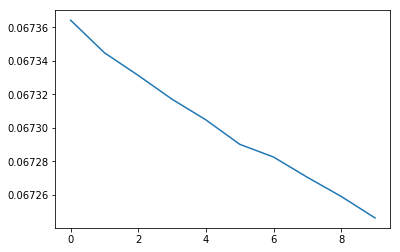

In [20]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Assume that we are on a CUDA machine, then this should print a CUDA device:
print(device)
model.to(device)

lr, epochs, batch_size = 1e-1 , 10 , 10
optimizer = torch.optim.SGD(model.parameters(), lr = lr )
accum=[]
i = 0
for k in range(epochs):
    localaccum = []
    for xy, xyz in iter(loader):
        i =  i+1
        local_xy = Variable(xy)
        #print(local_xy)
        local_xyz = Variable(xyz)
        local_xy = local_xy.to(device)
        output = model.forward(local_xy)
        output = output.to(device)
        #print(output)
        loss = criterion(output, torch.Tensor.new_zeros(output, output.size()))
        #print(local_xy, local_xyz)
        if (i%500 == 0): print("network loss -> ", loss)
        model.zero_grad()
        loss.backward()
        optimizer.step()
        localaccum.append(loss.data[0])
    accum.append(np.mean(localaccum))
plt.plot(accum);                                           

In [21]:
model.forward(torch.Tensor(obj).to(device), extract_z=True)


 vertexs_recovered: tensor([[ 0.7286, -0.4070, -0.7362,  0.8523,  0.9019, -0.2330, -0.5627,
          1.0255]], device='cuda:0')
 x[:,0,:]: tensor([[ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265]], device='cuda:0')
loss tensor(1.00000e-05 *
       1.7796, device='cuda:0')
z output vec: tensor([[-0.3924,  1.8242,  0.0910, -0.0000, -0.3879,  1.8287,  0.0955,
          0.0000,  0.0000, -0.0000, -0.0000,  0.0000,  0.0000,  1.4448,
          0.0000, -0.0000,  0.0000,  1.5308,  0.0020,  0.0030,  0.0042,
          0.0026, -0.0000,  0.0000, -0.0000,  0.0000,  0.0000,  0.0000]], device='cuda:0')


tensor([[ 1.0389,  1.1145,  0.7861,  0.7810,  1.2860,  1.2976,  0.9016,
          0.9744]], device='cuda:0')

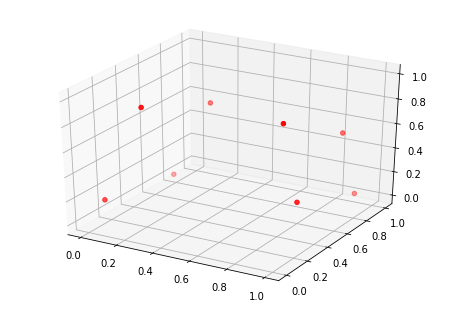

In [22]:
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.pyplot as plt
fig = plt.figure()
ax = Axes3D(fig)
x = [ 0.7319, -0.4006, -0.7319,  0.8529,  0.9055, -0.2269, -0.5582,
          1.0265 ]
y =  [ 0.1290, -0.0706, -0.1290,  0.1504, -0.8558, -1.0554, -1.1139,
         -0.8344 ]
z = [ 1.0389,  1.1145,  0.7861,  0.7810,  1.2860,  1.2976,  0.9016,
          0.9744]
x=[(i-min(x))/(max(x)-min(x)) for i in x]
y=[(i-min(y))/(max(y)-min(y)) for i in y]
z=[(i-min(z))/(max(z)-min(z)) for i in z]

verts = [list(zip(x, y,z))]
#ax.add_collection3d(Poly3DCollection(verts))
ax.scatter(x, y, z, c='r', marker='o')
plt.show()